In [1]:
from qutip import *
from matplotlib import cm
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
from scipy.optimize import curve_fit
from copy import copy

class 

class sideband:
    def __init__(self,**params) -> None:
        '''
        level,t_edge,|||
        w,yita,g,|||
        L,wd,phid,amp,sp,|||
        rho0,rho_tar|||

        (w+k)n-k/12(x**4)=wn-k/2*ad*ad*a*a
        '''

        self.params={
        # qcircuit
        'level':3,          'hascoupler':False,
        # qubtrit params,   GHz/2pi
        'w':[7,5,0],        'yita':[100,300,0],         'g':[100,0,0],
        # drive params,      GHz/2pi,rad,1
        # tp is time_pointer
        'wd':[5.15,6],      'phid':[0,0],               'sp_eff':[1,0],
        'sp_direct':None,   'arrow_ideal':[1,1,1],      'tp':0,

        # envelope,         ns,ns,GHz/2pi
        'L':100,            't_edge':10,               'amp':0.1,
        # simulate
        'Tstep':None,       'rho0':0,                  'rho_tar':None,
        'ksp':None,         'pre_scan':False,          'mix':False 
        }

        self.params.update(params)
        self.params0=copy(self.params)
        self.__setparams(self.params)
   
    def __setparams(self,dic):
        for p in dic:
            setattr(self,p,dic[p])
        
        # qcircuit
        global n
        n=self.level

        # ideal arrow/target state
        self.arrow_squ,self.arrow_norm,\
        self.p_ideal,self.t_coeff=self.ideal


        # qubtrit params,   GHz,MHz,MHz
        self.H0=self.__H0
        self.ee,self.es,self.proj=self.__eigen
        self.e1,self.e2=self.ee[2],self.ee[1]
        self.e11,self.e22=self.ee[self.to(1)],self.ee[self.to(2)]
        
        # params pre_guess
        if  self.pre_scan:
            self.ws_g,self.wp_g=self.wd[0],self.wd[1]
        else:
            self.ws_g=self.e11/2
            self.wp_g=(self.e22-self.e11)/2
        self.wd_g=[self.ws_g,self.wp_g]
        self.ks_g=1/(self.e1-self.ws_g)+1/(self.e1+self.ws_g)
        self.kp_g=1/(self.e1-self.wp_g)+1/(self.e1+self.wp_g)

        # drive
        self.ws,self.wp=self.wd[0],self.wd[1]
        self.envelope=self.__envelope
        self.up_edge,self.down_edge,self.plant=self.__envelope_slice
        self.ks,self.kp,self.sp=self.__sp
        self.DS,self.UDS,self.DDS,self.PDS=self.__DS
        self.HD=self.__HD

        # d
        self.ds_g=2*(self.sp[0]*self.amp*self.ks_g)**2*\
            self.yita[0]*self.g[0]/(self.e1-self.e2)
        # 差了4倍
        self.ds_g=self.ds_g/4

        self.dp_g=4*(self.sp[1]*self.amp*self.kp_g)**2*\
            self.yita[0]*self.g[0]/(self.e1-self.e2)
        # 差了2倍
        self.dp_g=self.dp_g/2
        self.d_eff_g=[self.ds_g,self.dp_g]
        
        self.T_g=8/(2*(self.amp*self.ks_g)**2*\
            self.yita[0]*self.g[0]/(self.e1-self.e2))
 

        # simulate
        if self.Tstep==None:    
            self.Tstep=int(self.L*10*5+1)
        self.H=[2*np.pi*self.H0,[2*np.pi*self.HD,self.DS]]
        self.H_up       =[2*np.pi*self.H0,[2*np.pi*self.HD,self.UDS]]
        self.H_down     =[2*np.pi*self.H0,[2*np.pi*self.HD,self.DDS]]
        self.H_plant    =[2*np.pi*self.H0,[2*np.pi*self.HD,self.PDS]]
        self.tlist=np.linspace(0,self.L,self.Tstep)
        if self.rho_tar==None:
            self.rho_tar=self.rho0+1
    
    def update(self,dic=(),**params):
        self.params.update(dic)
        self.params.update(params)
        self.__setparams(self.params)

    @property
    def ideal(self):
                # ideal arrow/target state
        am=np.linalg.norm(self.arrow_ideal)
        a_squ=[(i/am)**2 for i in self.arrow_ideal]
        a_nor=[i/am for i in self.arrow_ideal]
        x,y=a_nor[0],a_nor[1]
        fp=-(y**2+2*x-2)/(x**2-2*x+1)
        p_ide=np.sqrt(fp-1)
        t_coeff=np.arccos(1+x*fp-fp)/2/np.pi
        return a_squ,a_nor,p_ide,t_coeff


    @property
    def __envelope(self):
        return lambda t,args:\
            self.amp*(0.5*np.cos(np.pi*t/self.t_edge-np.pi)+0.5)\
        if 0<=t<=self.t_edge else\
            self.amp*(0.5*np.cos(np.pi*(t-self.L)/self.t_edge-np.pi)+0.5)\
        if (self.L-self.t_edge)<=t<=self.L else\
            self.amp\
        if self.t_edge<t<(self.L-self.t_edge) else 0
    @property
    def __envelope_slice(self):
        return lambda t,args:\
            self.amp*(0.5*np.cos(np.pi*(t-self.tp)/self.t_edge-np.pi  )+0.5),\
            lambda t,args:\
            self.amp*(0.5*np.cos(np.pi*(t-self.tp)/self.t_edge        )+0.5),\
            lambda t,args: self.amp

    
    @property 
    def __sp(self):
        sp_eff,         ks_g,       kp_g,       ws,         wp=\
        self.sp_eff,    self.ks_g,  self.kp_g,  self.ws,    self.wp
        ks,kp,sp=0,0,0
        sp=[0,0]
        # theoral:sp=[sp_eff[0],np.sqrt(sp_eff[1]*0.5)*(ks_g/kp_g)]

        ks=1/(self.e1-ws)+1/(self.e1+ws)
        kp=1/(self.e1-wp)+1/(self.e1+wp)
        if self.ksp==None:    
            ksp=0.5*(ks_g/kp_g)
        else:
            ksp=self.ksp
        self.ksp_g=ksp
        if self.sp_direct==None:
            sp[0]=sp_eff[0]
            sp[1]=np.sqrt(sp_eff[1])*ksp
        else:
            sp=self.sp_direct
        return ks,kp,sp
    @property
    def __DS(self):
        DS=lambda t,args:0
        UDS,DDS,PDS=lambda t,args:0,lambda t,args:0,lambda t,args:0
        def cos(sp,a,w,phi): 
            return lambda t,args:sp*a(t,args)*np.cos(2*np.pi*w*t+phi)
        def add(f1,f2):
            return lambda t,args:f1(t,args)+f2(t,args)

        for i in range(len(self.wd)):
            DS =add(cos(self.sp[i],self.envelope,
                       self.wd[i],self.phid[i]),DS)
        for i in range(len(self.wd)):
            UDS=add(cos(self.sp[i],self.up_edge,
                       self.wd[i],self.phid[i]),UDS)
        for i in range(len(self.wd)):
            DDS=add(cos(self.sp[i],self.down_edge,
                       self.wd[i],self.phid[i]),DDS)
        for i in range(len(self.wd)):
            PDS=add(cos(self.sp[i],self.plant,
                       self.wd[i],self.phid[i]),PDS)
        
        return DS,UDS,DDS,PDS
    @property
    def __HD(self):
        a=destroy(n)
        ad=create(n)
        I=qeye(n)
        D=tensor(a+ad,I)
        return D       
    @property
    def __H0(self):
        w,g,yita=self.w,self.g,self.yita
        a,ad,I=destroy(15),create(15),qeye(n)
        x=a+ad
        def trunc(x):
            return Qobj(x[:n,:n])

        h0=(w[0]+yita[0])*ad*a-yita[0]/12*(x**4)
        h1=(w[1]+yita[1])*ad*a-yita[1]/12*(x**4)

        h0,h1=trunc(h0),trunc(h1)
        G01=g[0]*tensor(trunc(x),trunc(x))

        H0=tensor(h0,I)+tensor(I,h1)+G01
        return H0 
            # return trunc(h0)
    @property
    def __eigen(self):
        to,L=self.to,self.L
        eigen=self.H0.eigenstates()
        ee=[e-eigen[0][0] for e in eigen[0]]
        es=eigen[1]
        proj=[s*s.dag() for s in es]
        xita1=2*np.pi*ee[to(1)]*L
        xita2=2*np.pi*ee[to(2)]*L
        self.state_mix=(es[0]+
                        np.exp(-1j*xita1)*es[to(1)]+
                        np.exp(-1j*xita2)*es[to(2)]).unit()
        self.rho_mix=self.state_mix*self.state_mix.dag()
        return ee,es,proj  
    def drive_sign_plot(self,target='DS'):
        if target=='DS':
            func=self.DS
        elif target=='envelope':
            func=self.envelope
        fix,ax=plt.subplots()
        ax.plot(self.tlist,list(map(func,self.tlist,self.tlist)))
    def to(self,x):
        #n=3,4,5 p22=p[8,11,12] ,
        #assume 11,22 setten at middle of exciting number subspace
        #without consider 30 exceed 04
        #assume w2=2w-yita,w3=3w-2yita
        if x==0:
            return 0
        elif x==1:
            return 4
        elif x==2:
            if n==3:
                return 8
            elif n==4:
                return 11
            elif n==5:
                return 12
            elif n>=6:
                return 13
    def g_Level(self,target=None,gstop=None):
        if gstop==None:
            gstop=self.g[0]
        z=[]
        glist=np.linspace(0,gstop,100)
        for p in glist:
            self.update(g=[p])
            ee=self.ee
            z.append(ee)
        z=np.transpose(z)
        fix,ax=plt.subplots()
        if target==None:
            ax.plot(glist,np.transpose(z))
        else:
            ax.plot(glist,z[self.to(target)])
    

    def result_norm(self,result):
        res=result
        res.expect=[[i/j for i,j in zip(res.expect[k],res.expect[3])] 
                    for k in range(len(result.expect))]
        return res
    def scan_wd(self,wstart,wstop,wstep,sp=0,runplot=False,plot=True):
        '''
        sp=0,wd=[w_scan,wp]
        sp=1,wd=[ws,w_scan]
        '''
        rho0,rho_tar=self.rho0,self.rho_tar
        wdlist=np.linspace(wstart,wstop,wstep)
        wd=self.wd
        z=[]
        for w in wdlist:
            wd[sp]=w
            # wdt=[lambda t,args:wd]
            self.update(wd=wd)
            result=self.run(plot=runplot)
            z.append(np.transpose(result.expect))
        z=np.transpose(z)
        print(shape(z))

        if plot:
            self.imshow([z[rho_tar],wstart,wstop,wstep],rho_tar)

        return [z,wstart,wstop,wstep,wdlist]
    def find_w_mat(self,input,target=None,plot=False):
        z,          wstart,     wstop,      wstep,      wdlist=\
        input[0],   input[1],   input[2],   input[3],   input[4]
        dom=wstop-wstart
        dpi=(wstop-wstart)/wstep
        error=list(np.min(z[-1],axis=0))
        w_arg=np.argmin(error,axis=0)
        wm_guess=wdlist[w_arg]
        isside= w_arg==0 or w_arg==wstep-1
        return [wm_guess,dom,dpi,isside]
    def GateProcess(self,result,population=True,bloch=True,show_list=[0,1,2,3,-1]):
        if population:
            fig, ax = plt.subplots()
            ax.plot(result.times ,
            # np.transpose([result.expect[p]]))
            # np.transpose([expect for expect in result.expect]))
            np.transpose([result.expect[i] for i in show_list]))
            ax.set_xlabel('t/ns')
            ax.set_ylabel('Population')
            ax.legend(['P00','P11','P22','tot','error'])
            plt.show()
        if bloch:
            b=Bloch()
            b.add_points([result.expect[0],result.expect[1],
                          result.expect[2]],'l')
            b.show()


    def run_lego(self,  res_pre=None,   enve_type='p',      L=None,
                        plot=False,     population=True,    bloch=False,):
        '''return result'''
        
        proj,to=self.proj,self.to
        rho0,rho_tar,mix=self.rho0,self.rho_tar,self.mix

        if plot:print(f'run start,T={L}')
        
        if res_pre==None:
            self.update(tp=0)
            rho0=proj[to(rho0)]
        else:
            self.update(tp=res_pre.times[-1])
            rho0=res_pre.final_state
            
        
        tlist=np.linspace(self.tp,self.tp+L,int(L*50)+1)
        arrow=self.arrow_squ
        op=Options(store_final_state=True)
        H=      self.H_down  if enve_type=='d' \
        else    self.H_up    if enve_type=='u' \
        else    self.H_plant if enve_type=='p' \
        else    self.H
        



        
        # rho_mix=self.state_mix*self.state_mix.dag()
        # e_ops=[proj[to(0)],proj[to(1)],proj[to(2)],rho_mix,rho_mix]
        e_ops=[proj[to(0)],proj[to(1)],proj[to(2)]]
        result=mesolve(H,rho0,tlist,None,e_ops,options=op)
        tot,error=[],[]
        
        tot=[i+j+k for i,j,k in 
             zip(result.expect[0],result.expect[1],result.expect[2])]
        leakage=[1-i for i in tot]
        coeff=np.abs(1-arrow[0])+np.abs(0-arrow[1])+np.abs(0-arrow[2])

        if mix:
            # ==max_delta_ijk
            # error=[np.abs(i-j)+np.abs(j-k)+np.abs(l) for i,j,k,l in 
            #        zip(result.expect[0],result.expect[1],result.expect[2],
            #            leakage)]

            error=[(np.abs(i-arrow[0])+np.abs(j-arrow[1])+np.abs(k-arrow[2])
                    +np.abs(l))/coeff for i,j,k,l in 
                    zip(result.expect[0],result.expect[1],result.expect[2],
                       leakage)]
        else:
            error=[t-p for t,p in zip(tot,result.expect[rho_tar])]
        
        # result.expect[3]=tot
        result.expect.append(tot)
        result.expect.append(leakage)
        result.expect.append(error)
        result.min=min(error)
        #expect[3]=tot,expect[-1]=error
        if res_pre!=None:
            tpm=copy(list(res_pre.times))
            tpm.extend(result. times)
            result.times=tpm
            for i in range(len(result.expect)):
                rpm=copy(list(res_pre.expect[i]))
                rpm.extend(result.expect[i])
                result.expect[i]=rpm

        
        if plot:
            self.GateProcess(result=result,
                             population=population,bloch=bloch)
            print('run end')

        return result



    def run(self,plot=False,population=True,bloch=False,
            norm=False,norm_plot=False):
        '''return result or [result,rrsult_norm]'''
        if plot:print(f'run start,T={self.L}')
        proj,to,tlist,H=self.proj,self.to,self.tlist,self.H
        rho0,rho_tar,mix=self.rho0,self.rho_tar,self.mix
        arrow=self.arrow_squ
        op=Options(store_final_state=True)

        rho0=proj[to(rho0)]
        # rho_mix=self.state_mix*self.state_mix.dag()
        # e_ops=[proj[to(0)],proj[to(1)],proj[to(2)],rho_mix,rho_mix]
        e_ops=[proj[to(0)],proj[to(1)],proj[to(2)]]
        result=mesolve(H,rho0,tlist,None,e_ops,options=op)
    
        # print(shape(result.times))
        tot,error=[],[]
        
        tot=[i+j+k for i,j,k in 
             zip(result.expect[0],result.expect[1],result.expect[2])]
        leakage=[1-i for i in tot]
        coeff=np.abs(1-arrow[0])+np.abs(0-arrow[1])+np.abs(0-arrow[2])

        if mix:
            # ==max_delta_ijk
            # error=[np.abs(i-j)+np.abs(j-k)+np.abs(l) for i,j,k,l in 
            #        zip(result.expect[0],result.expect[1],result.expect[2],
            #            leakage)]

            error=[(np.abs(i-arrow[0])+np.abs(j-arrow[1])+np.abs(k-arrow[2])
                    +np.abs(l))/coeff for i,j,k,l in 
                    zip(result.expect[0],result.expect[1],result.expect[2],
                       leakage)]
        else:
            error=[t-p for t,p in zip(tot,result.expect[rho_tar])]
        
        # result.expect[3]=tot
        result.expect.append(tot)
        result.expect.append(leakage)
        result.expect.append(error)
        result.min=min(error)
        #expect[3]=tot,expect[-1]=error
        
        if plot:
            self.GateProcess(result=result,
                             population=population,bloch=bloch)
            print('run end')
        if norm_plot:
            res=self.result_norm(result)
            self.GateProcess(result=res,
                             population=population,bloch=bloch)
        if norm:
            return [result,self.result_norm(result)]
        return result


    def run_fin(self,tstart=None,tstop=None,tstep=None,
                    plot=False,population=True,bloch=False):
        L,t_edge=self.L,self.t_edge
        rl=self.run_lego
        if tstart==None:
            tstart,tstop=2*t_edge,self.L
        if tstep==None:
            tstep=1*(int(self.L/t_edge))+1
        tplist=np.linspace(tstart,tstop,tstep)

        class output:
            pass
        times,expect=[],[]

        res=rl(enve_type='u',  L=t_edge)
        res_fin =rl(res_pre=res,    enve_type='d',  L=t_edge)

        for tp in tplist[1:]:
            tp_pre=res.times[-1]
            L=tp-tp_pre
            res     =rl(res_pre=res,    enve_type='p',  L=L-t_edge)
            res_fin =rl(res_pre=res,    enve_type='d',  L=t_edge)
            times.append(res_fin.times[-1])
            expect.append(np.transpose(res_fin.expect)[-1])
            
        expect=np.transpose(expect)

        output.times=times
        output.expect=expect

        if plot:
            self.GateProcess(result=output,
                             population=population,bloch=bloch)
            print('run end')
        return output


        
        

    def run_fin_old(self,tstart,tstop,tstep,
                plot=False,population=True,bloch=True,show=[0,1,2,-1]):
        t_fin_list=np.linspace(tstart,tstop,tstep)
        class output:
            pass
        output.times=t_fin_list
        output.expect=[]
        for t in t_fin_list:
            self.update(L=t)
            res=copy(self.run())
            output.expect.append(np.transpose(res.expect)[-1])
        output.expect=np.transpose(output.expect)
        if plot:
            self.GateProcess(result=output,
                             population=population,bloch=bloch)
            print('run end')
        return output
    

    def wd_fit(self,result,sp=0,plot=True,correct=1):
        '''
        single wave Rabi fit
        return [d_eff,F,t0,c,T]'''
        print(f'wd_fit start \n sp={sp}' )
        if correct!=1:
            print('correct!=1')
        edge_step=int(self.Tstep*self.t_edge/self.L)+2
        d_guess=self.d_eff_g[sp]
        P_tar=result.expect[sp+1]
        tlist=result.times
        def func(t,d_eff,F,t0):
            return F*(0.5*(1-np.cos(2*np.pi*d_eff*(t-t0))))
        guess=[d_guess*correct,0.8,self.t_edge/2]
        # print(f',sp={sp}' )
        bounds=([d_guess*0.5,   0,      0,         ],\
                [d_guess*(correct+1),     1.1,      self.t_edge])
        coeff, var_matrix = curve_fit(func,tlist,P_tar,guess,
                                      bounds=bounds,maxfev=10000)
        if plot==True:
            plt.plot(tlist, P_tar)
            plt.plot(tlist, func(tlist,*coeff),color='red')
            plt.xlabel('t')
            plt.ylabel('error')
            plt.title('Linear Fit')
            plt.show()
        T=1/coeff[0]
        coeff=list(coeff)
        coeff.append(T)
        print(f'guess value of [d_eff,F,t0]={guess}')
        print(f"fit coeff [d_eff,F,t0,T]={coeff}\n wd_fit end")
        return coeff

    def mix_wave_fit(self,result,plot=True):
        '''return [guess,coeff,T,p]\n
        guess=[d_eff,F,t0,p**2]\n
        coeff[i]=[d_eff,F,t0,p]
                '''
        print(f'mix_wave_fit start \n ' )
        edge_step=int(self.Tstep*self.t_edge/self.L)+2


        d_guess=self.d_eff_g[0]
        # error=result.expect[-1][edge_step:self.Tstep-edge_step]

        y=[result.expect[i] for i in [0,1,2]]
        tlist=result.times

        def func0(t,d_eff,F,t0,p2):
            return 1*((np.cos(2*np.pi*d_eff*(t-t0))+p2)**2)/((1+p2)**2)
        def func1(t,d_eff,F,t0,p2):
            return F*0.5*(1-np.cos(4*np.pi*d_eff*(t-t0)))
        def func2(t,d_eff,F,t0,p2):
            return F*((1-np.cos(2*np.pi*d_eff*(t-t0)))**2)
                # ((np.sqrt(p2)/(1+p2))**2)
        func=[func0,func1,func2]

        guess=[d_guess,0.5,self.t_edge/2,self.p_ideal**2]
        gue=copy(guess)
        # print(f',sp={sp}' )
        bounds=([d_guess*0.1,   0,    0,              0],\
                [d_guess*5,     1,    self.t_edge,    2])
        coeff=[0,0,0]
        print(f'guess={guess}')
        for i in [0,1,2]:
            coeff[i], var_matrix = curve_fit(func[i],tlist,
                                             y[i],gue,bounds=bounds)
            gue=copy(coeff[i])
            gue[1]=0.5
        print(type(coeff[0]))
        if plot==True:
            for i in [0,1,2]:
                plt.plot(tlist, np.transpose(y[i]))
                plt.plot(tlist, func[i](tlist,*coeff[i]),color='red')
                plt.xlabel('t/ns')
                plt.ylabel('P')
                plt.title('Linear Fit')
                plt.show()
                coeff[i]=list(coeff[i])
        
        coeff[0][3]=np.sqrt(coeff[0][3])
        coeff[1][3]=np.sqrt((1/coeff[1][1])-1)
        F2=coeff[2][1]
        coeff[2][3]=[(1+np.sqrt(1-4*F2))/(2*np.sqrt(F2)),
                     (1-np.sqrt(1-4*F2))/(2*np.sqrt(F2))]
        
        print('d_eff,F,t0,p2:\t\tguess\t\tcoeff')
        print(guess)
        for i in [0,1,2]:
            print(coeff[i])
        T=(1/coeff[0][0]+1/coeff[1][0]+1/coeff[2][0])/3
        p=coeff[0][3]
        # coeff=list(coeff)
        # coeff.append(T)
        # print(f'guess value of [d_eff,F,t0,p2]={guess}')
        print(f"\n mix_wave_fit end")
        # print(coeff)
        return [guess,coeff,T,p]


    ###############################################

    ###############################################

    def auto_scan_scope_error(self,sp=0,dpim=None,plot=True,dom=0.5):
        '''return [w,input]'''
        print(f'auto_scan_scope start \n sp={sp}' )
        if dpim==None:
            dpim=0.1*self.d_eff_g[sp]
        wsp,wd=self.wd_g,self.wd
        dw=self.e1-self.e2
        dpi0=0.02*dw
        dpi=dpi0
        w=[wsp[sp]-2*dpi,wsp[sp]-1*dpi,wsp[sp],wsp[sp]+1*dpi,wsp[sp]+2*dpi]
        error=[0,0,0,0,0]

        wm=w
        z,wdlist,iter_list=[],[],[]
        global iter_num
        iter_num=1
        print('iter_num=\n')
        def iter(i):
            global iter_num
            print(iter_num,end='\t')
            if iter_num%5==0:
                print('\n')
            iter_num=iter_num+1
            wd[sp]=w[i]
            self.update(wd=wd)
            result=self.run(plot=True)
            error[i]=np.min(result.expect[-1])
            wdlist.append(w[i])
            z.append(np.transpose(result.expect))

            iter_list.append(iter_num)
            

        # T=2*self.t_edge+0.5*self.T_g/4
        T=2*self.t_edge+0.25*1/self.d_eff_g[sp]
        self.update(L=T)
        print(f'T for scan:{T}')
        for i in [0,2,4]:
            iter(i)
            
        while dpi>dpim:
            # print(f'w--error:{[w,error]}')
            # print(f'dpi={dpi}')
            if error[0]<error[4]:
                iter(1)
                if error[1]<error[2] and error[1]<error[0]:
                    w=list(np.linspace(w[0],w[2],5))
                    error[0]=error[0]
                    error[4]=error[2]
                    error[2]=error[1]
                else:
                    iter(3)
                    j=np.argmin(error)
                    print(f'j={j}')
                    w=list(np.linspace(w[j-1],w[j+1],5))
                    error[0]=error[j-1]
                    error[4]=error[j+1]
                    error[2]=error[j]
            elif error[0]>=error[4]:
                iter(3)
                if error[3]<error[2] and error[3]<error[4]:
                    w=list(np.linspace(w[2],w[4],5))
                    error[0]=error[2]
                    error[4]=error[4]
                    error[2]=error[3]
                else:
                    iter(1)
                    j=np.argmin(error)
                    print(f'j={j}')
                    w=list(np.linspace(w[j-1],w[j+1],5))
                    error[0]=error[j-1]
                    error[4]=error[j+1]
                    error[2]=error[j]
            dpi=dpi/2


        # print([w[2],error[2]])
        z=np.transpose(z)
        wdlist_sort,zm=zip(*sorted(zip(
            wdlist,np.transpose(z[self.rho_tar]))))
        
        input=[np.transpose(zm),wsp[sp]-dpi0,wsp[sp]+dpi0,100]
        if plot:
            self.imshow(input=input)
            fix,ax=plt.subplots()
            ax.plot(iter_list,wdlist)
            ax.set_xlabel('iter/n')
            ax.set_ylabel('wd/GHz')
            plt.show()
        
        print(f'dpi={dpim},w_match={w[2]} \n auto_scan_scope end')
        return [w[2],input]

    def auto_scan_scope(self,sp=0,tar=None,T_coeff=0.1,dom=0.5,
                        dpim=1,plot=True,runplot=False):
        '''tar=0,1,2
        return [w,input]'''
        if plot:print(f'auto_scan_scope start \n sp={sp}' )
        dpim=dpim*0.01*self.d_eff_g[sp]
        if tar==None:
            tar=self.rho_tar
        wd,to=self.wd,self.to
        if self.pre_scan:
            wsp=self.wd
        else:
            wsp=self.wd_g
        # dw=self.e1-self.e2
        dwsp=np.abs(self.ws_g-self.wp_g)
        dpi0=dom*0.25*dwsp
        dpi=dpi0
        # w=[wsp[sp]-3*dpi,wsp[sp]-2*dpi,wsp[sp]-dpi,wsp[sp],wsp[sp]+dpi]
        w=list(np.linspace(wsp[sp]-2*dpi,wsp[sp]+2*dpi,5))
        P_tar=[0,0,0,0,0]

        wm=copy(w)
        z,wdlist,iter_list=[],[],[]
        global iter_num
        iter_num,dpi_num=1,1

        def iter(i):
            global iter_num
            if plot:print((dpi_num,iter_num),end=',')
            iter_num=iter_num+1
            wd[sp]=w[i]
            self.update(wd=wd)
            result=self.run(plot=runplot,bloch=False)

            P_tar[i]=np.max(result.expect[tar])
            wdlist.append(w[i])
            z.append(np.transpose(result.expect))

            iter_list.append(iter_num)
            
        # T=2*self.t_edge+0.5*self.T_g/4
        T=2*self.t_edge+T_coeff*1/self.d_eff_g[sp]

        # T=2*self.t_edge+1*1/self.d_eff_g[0]
        self.update(L=T)
        print(f'T for scan:{T}')
        print('iter_num=')
        for i in [0,2,4]:
            iter(i)
        while dpi>dpim:
            # print(f'w--error:{[w,error]}')
            # print(f'dpi={dpi}')
            if P_tar[0]>P_tar[4]:
                iter(1)
                if P_tar[1]>P_tar[2] and P_tar[1]>P_tar[0]:
                    w=list(np.linspace(w[0],w[2],5))
                    P_tar[0]=P_tar[0]
                    P_tar[4]=P_tar[2]
                    P_tar[2]=P_tar[1]
                else:
                    iter(3)
                    j=np.argmax(P_tar)
                    # print(f'j={j}')
                    if j!=0 and j!=4:
                        w=list(np.linspace(w[j-1],w[j+1],5))
                        P_tar[0]=P_tar[j-1]
                        P_tar[4]=P_tar[j+1]
                        P_tar[2]=P_tar[j]
                    elif j==0:
                        w=list(np.linspace(
                            wsp[sp]-(4+dpi_num)*dpi,
                            wsp[sp]-dpi_num*dpi,5))
                        P_tar[4]=P_tar[1]
                        P_tar[3]=P_tar[0]
                        for i in [0,2]:
                            iter(i)
                    else:
                        w=list(np.linspace(
                            wsp[sp]+dpi_num*dpi,
                            wsp[sp]+(4+dpi_num)*dpi,5))
                        P_tar[0]=P_tar[3]
                        P_tar[1]=P_tar[4]
                        for i in [2,4]:
                            iter(i)
                         
            elif P_tar[0]<=P_tar[4]:
                iter(3)
                if P_tar[3]>P_tar[2] and P_tar[3]>P_tar[4]:
                    w=list(np.linspace(w[2],w[4],5))
                    P_tar[0]=P_tar[2]
                    P_tar[4]=P_tar[4]
                    P_tar[2]=P_tar[3]
                else:
                    iter(1)
                    j=np.argmax(P_tar)
                    # print(f'j={j}')
                    if j!=0 and j!=4:
                        w=list(np.linspace(w[j-1],w[j+1],5))
                        P_tar[0]=P_tar[j-1]
                        P_tar[4]=P_tar[j+1]
                        P_tar[2]=P_tar[j]
                    elif j==0:
                        w=list(np.linspace(
                            wsp[sp]-(4+dpi_num)*dpi,
                            wsp[sp]-dpi_num*dpi,5))
                        P_tar[4]=P_tar[1]
                        P_tar[3]=P_tar[0]
                        for i in [0,2]:
                            iter(i)
                    else:
                        w=list(np.linspace(
                            wsp[sp]+dpi_num*dpi,
                            wsp[sp]+(4+dpi_num)*dpi,5))
                        P_tar[0]=P_tar[3]
                        P_tar[1]=P_tar[4]
                        for i in [2,4]:
                            iter(i)

            dpi=dpi/2
            dpi_num+=1
            if plot:
                if dpi_num%4==1:
                    print('\n')

        print('\n')
        # print([w[2],P_tar[2]])
        z=np.transpose(z)
        print(type(np.transpose(z[self.rho_tar])))
        print(wdlist)
        print(shape(zip(wdlist,np.transpose(z[self.rho_tar]))))
        print(zip(wdlist,np.transpose(z[self.rho_tar])))

        wdlist_sort,zm=zip(
            *sorted(zip(wdlist,list(np.transpose(z[self.rho_tar])))))
        
        input=[np.transpose(zm),wsp[sp]-dpi0,wsp[sp]+dpi0,100]
        if plot:
            self.imshow(input=input)
            fix,ax=plt.subplots()
            ax.plot(iter_list,wdlist)
            ax.set_xlabel('iter/n')
            ax.set_ylabel('wd/GHz')
            plt.show()
        
        print(
            f'dpi={dpim*1000}MHz,w_match={w[2]}GHz \n auto_scan_scope end')
        return [w[2],input]

    def auto_scan_amp(self,astart,astop,astep,
                      plot=True,mix=False,runplot=False):
        '''MIX: While wp far away from wp_mat, 
        wp only affect ws by delta_ws_p,
        therotically assumed as delta_wp_p which is affect of wp on itself.
        '''
        print(f'auto_scan_amp start \nastart,astop,astep=\
              {astart,astop,astep}')
        if mix:
            print(f'mix={mix},sp_direct=[1,1]')
        wd=self.wd_g
        alist=np.linspace(astart,astop,astep)
        wdlist,d_eff_list,T_list=[[],[]],[[],[]],[[],[]]
        print('+'*60)
        if mix:
            for sp in[0,1]:
                self.update(rho0=sp,rho_tar=sp+1)
                for amp in alist:
                    print(f'auto_scan_amp \tsp={sp} \tamp={amp}')    
                    self.update(amp=amp)
                    wd_m=wd
                    wd_m[sp]=self.auto_scan_scope(
                        sp=sp,plot=True,runplot=runplot)[0]
                    wdlist[sp].append(wd_m[sp])
                    self.update(L=1/self.d_eff_g[sp],wd=wd_m) 
                    #auto_scan_scope改变了wd，因此改变了T_g
                    res=self.run(plot=True,bloch=False)
                    coeff=self.wd_fit(res,sp=sp)
                    d_eff_list[sp].append(coeff[0])
                    T_list[sp].append(coeff[-1])
                    print('+'*60)
        else:
            for sp in [0,1]:
                self.update(sp_direct=[1-sp,sp],rho0=sp,rho_tar=sp+1)
                for amp in alist:
                    print(f'auto_scan_amp ,sp={sp} ,amp={amp}')    
                    self.update(amp=amp)
                    wd_m=wd
                    wd_m[sp]=self.auto_scan_scope(sp=sp,plot=True)[0]
                    wdlist[sp].append(wd_m[sp])

                    self.update(L=self.T_g/2,wd=wd_m)   
                    #auto_scan_scope改变了wd，因此改变了T_g
                    res=self.run(plot=True,bloch=False)
                    coeff=self.wd_fit(res,sp=sp)
                    d_eff_list[sp].append(coeff[0])
                    T_list[sp].append(coeff[-1])
                    print('+'*60)
        wdlist=np.transpose(wdlist)
        d_eff_list=np.transpose(d_eff_list)
        T_list=np.transpose(T_list)
        
        if plot:
            fig,ax=plt.subplots()
            ax.plot(alist,wdlist)
            ax.set_xlabel('amp/2pi/GHz')
            ax.set_ylabel('w_match/2pi/GHz')
            ax.legend(['s','p'])
            plt.show()            
            fig,ax=plt.subplots()
            ax.plot(alist,d_eff_list)
            ax.set_xlabel('amp/2pi/GHz')
            ax.set_ylabel('d_eff/2pi/GHz')
            ax.legend(['s','p'])
            plt.show()
            fig,ax=plt.subplots()
            ax.plot(alist,T_list)
            ax.set_xlabel('amp/2pi/GHz')
            ax.set_ylabel('T/ns')
            ax.legend(['s','p'])
            plt.show()
        print(f'auto_scan_amp end')
        print('+'*60)
        return [alist,wdlist,d_eff_list,T_list]


    def auto_scan_mix_wave_wd_sp(self,amp,sp_direct,dom=0.8,plot=True,runplot=False,
                                 
                                 correct=2,single_wave_scan=False,suggest=True):
        '''return [w_mat_mix,sp_direct_suggest1,L_g,result,fit_result,p_cost]'''
        if plot:print('auto_scan_mix_wave_wd start')
        if plot:print(f'amp={amp}\t\tsp_direct={sp_direct}')
        w_mat_single,w_mix_drag,w_mat_mix=[0,0],[0,0],[0,0]
        d_eff_mix,wm,sp_direct_suggest,coeff=[0,0],[0,0],[0,0],[0,0]
        L_g=0
        #++++++++++++++++++++++
        if single_wave_scan:
            for sp in [0,1]:
                sp_single=[0,0]
                sp_single[sp]=sp_direct[sp]
                self.update(amp=amp,sp_direct=copy(sp_single),mix=False,
                        pre_scan=False,rho0=sp,rho_tar=sp+1)
                print(self.sp)
                w_mat_single[sp]=self.auto_scan_scope(
                    sp=sp,runplot=runplot,dom=0.8)[0]
                wm=[0,0]
                wm[sp]=w_mat_single[sp]
                self.update(wd=copy(wm),L=self.T_g/2)
                result=self.run(plot=True)
        else:
            w_mat_single=self.wd_g
        #++++++++++++++++++++++++++++
        # wd_mix_mat scan
        self.update(sp_dircet=sp_direct,mix=False,wd=copy(w_mat_single))

        d_eff=self.d_eff_g
        # for i in [0,1]:
        w_mix_drag[0]=w_mat_single[0]+0*d_eff[0]
        # print(f'{w_mix_drag[0]},{w_mat_single[0]},{5*d_eff[0]}')
        w_mix_drag[1]=w_mat_single[1]-0*d_eff[1]
            #要确保sp只有一个在共振，事实上应该再加一个拉开到非共振的ws
            #与此时共振的wp的拟合
        for sp in [1,0]:
            self.update(amp=amp,sp_direct=sp_direct,wd=copy(w_mix_drag),
                        pre_scan=True,rho0=sp,rho_tar=sp+1)
            T_coeff=[0.05,0.02]
            w_mat_mix[sp]=self.auto_scan_scope(plot=False,
                sp=sp,runplot=runplot,dom=dom,T_coeff=T_coeff[sp])[0]
            if suggest:    
                wm[1-sp]=w_mix_drag[1-sp]
                wm[sp]=w_mat_mix[sp]
                self.update(wd=copy(wm),L=self.T_g/2)
                result=self.run_fin(plot=True)
                coeff[sp]=self.wd_fit(result,sp=sp,correct=sp*correct+(1-sp))
                d_eff_mix[sp]=coeff[sp][0]
        if suggest:
            # estimate p1 by d_eff
            L_g=1.3*coeff[0][-1]
            p_eff1=d_eff_mix[1]/d_eff_mix[0]
            p_ideal=self.p_ideal
            sp_direct_suggest1=[
                sp_direct[0],sp_direct[1]*np.sqrt(p_ideal/p_eff1)]
            
            # estimate p2 by mix wave drive curve_fit
            self.update(amp=amp,sp_direct=sp_direct,wd=copy(w_mat_mix),
                        pre_scan=True,rho0=0,rho_tar=1,L=L_g,mix=True)
            result=self.run_fin(plot=True)
            fit_result=self.mix_wave_fit(result)
            p_eff2=fit_result[-1]
            
            L_g=1/fit_result[1][0][0]
            sp_direct_suggest2=[
                sp_direct[0],sp_direct[1]*np.sqrt(p_ideal/p_eff2)]
            if plot:
                print(f'\nsp_direct_input={sp_direct}')
                print(f'\np_eff1={p_eff1}')
                print(f'suggest set sp_direct1 as:{sp_direct_suggest1}--recommend')
                print(f'\np_eff2={p_eff2}')
                print(f'suggest set sp_direct2 as:{sp_direct_suggest2}')
                print(f'wd_mat_mix={w_mat_mix}\nend')
            p_cost=(np.abs(p_ideal-p_eff1)+np.abs(p_ideal-p_eff2))/2
        self.update(dic=self.params0)
        if suggest:
            return [w_mat_mix,sp_direct_suggest1,L_g,result,fit_result,p_cost]
        else:
            return w_mat_mix



    def auto_opti_sp_direct(self,amp,sp_direct=[1,0.5],p_thre=0.15,error_thre=1,
                            correct=2,single_wave_scan=False,
                            tstep=10,dpim=0.0001,iter_plot=True,
                            runplot1=False,runplot2=False,runplot3=True,):
        auto_result=self.auto_scan_mix_wave_wd_sp(amp,correct=correct,
                            sp_direct=copy(sp_direct),runplot=runplot1)
        p_cost=auto_result[-1]
        while p_cost>p_thre:
            sp_direct=auto_result[1]
            auto_result=self.auto_scan_mix_wave_wd_sp(amp,correct=correct,
                                        sp_direct=copy(sp_direct),runplot=runplot1)
            p_cost=auto_result[-1]
        
        # 大周期为T，零点位置
        # T=au
        L_g=auto_result[2]
        t1=L_g*self.t_coeff
        ##################


        ##################
        p_g=sp_direct[1]
        pdom,tdom=0.15,0.1
        plist=list(np.linspace(p_g*(1-pdom),p_g*(1+pdom),5))
        dpi=2*pdom
        error=[0]*5
        T=[0]*5
        sp_list=[]
        tstart=t1*(1-tdom)
        tstop=t1*(1+tdom)
        tstep=2*int(tstop-tstart)
        pm=copy(plist)
 
        z,iter_list=[],[]
        global iter_num
        iter_num=1

        def iter(i):
            global iter_num
            print(iter_num,end=',')
            iter_num=iter_num+1

            sp_d=[1,pm[i]]
            wd_mat=self.auto_scan_mix_wave_wd_sp(amp,sp_d,runplot=runplot2,
                                            correct=correct,suggest=False)
            self.update(amp=amp,wd=wd_mat,sp_direct=sp_d,rho0=0,mix=True)
            result=self.run_fin(tstart=tstart,tstop=tstop,tstep=tstep
                                ,plot=runplot3,bloch=False)#plot=True)
            error[i]=np.min(result.expect[-1])
            T[i]=result.times[np.argmin(result.expect[-1])]

            sp_list.append(sp_d[1])
            z.append(np.transpose(result.expect))
            iter_list.append(iter_num)
            
        # T=2*self.t_edge+0.5*self.T_g/4
        # T=2*self.t_edge+T_coeff*1/self.d_eff_g[sp]

        # T=2*self.t_edge+1*1/self.d_eff_g[0]
        print('iter_num=')
        for i in [0,2,4]:
            iter(i)

        dpi_num=1
        while dpi>dpim:
            # print(f'w--error:{[w,error]}')
            # print(f'dpi={dpi}')
            if error[0]<error[4]:
                iter(1)
                if error[1]<error[2] and error[1]<error[0]:
                    pm=list(np.linspace(pm[0],pm[2],5))
                    error[0]=error[0]
                    error[4]=error[2]
                    error[2]=error[1]
                else:
                    iter(3)
                    j=np.argmin(error)
                    # print(f'j={j}')
                    pm=list(np.linspace(pm[j-1],pm[j+1],5))
                    error[0]=error[j-1]
                    error[4]=error[j+1]
                    error[2]=error[j]
            elif error[0]>=error[4]:
                iter(3)
                if error[3]<error[2] and error[3]<error[4]:
                    pm=list(np.linspace(pm[2],pm[4],5))
                    error[0]=error[2]
                    error[4]=error[4]
                    error[2]=error[3]
                else:
                    iter(1)
                    j=np.argmin(error)
                    # print(f'j={j}')
                    pm=list(np.linspace(pm[j-1],pm[j+1],5))
                    error[0]=error[j-1]
                    error[4]=error[j+1]
                    error[2]=error[j]
            dpi=dpi/2

                # print([w[2],error[2]])
        z=np.transpose(z)
        wdlist_sort,zm=zip(*sorted(zip(
            sp_list,list(np.transpose(z[-1])))))
        
        input=[np.transpose(zm),plist[0],plist[4],100]
        if iter_plot:
            self.imshow(input=input)
            fix,ax=plt.subplots()
            ax.plot(iter_list,sp_list)
            ax.set_xlabel('iter/n')
            ax.set_ylabel('wd/GHz')
            plt.show()
        
        print(f'dpi={dpim},sp_match={[1,pm[2]]},T={T[2]} \n auto_scan_scope end')
        return [pm[2],input]

# qpt_plot_combined
    def state_phase_scan(self,rho,step=50,plot=True):
        phase_list1=np.linspace(0,1,step)
        phase_list2=copy(phase_list1)
        p=[]
        def F(x,y):
            xita1=2*np.pi*self.ee[self.to(1)]*self.L+x
            xita2=2*np.pi*self.ee[self.to(2)]*self.L+y
            state_mix=(self.es[0]+
                np.exp(-1j*xita1)*self.es[self.to(1)]+
                np.exp(-1j*xita2)*self.es[self.to(2)]).unit()
            rho_mix=state_mix*state_mix.dag()
            return np.abs(np.trace(rho_mix*rho))
        z = np.zeros((step,step))
        # phase_matrix=list(copy(z))
        for i in range(step):
            p.append([])
            for j in range(step):
                x=2*np.pi*phase_list1[i]
                y=2*np.pi*phase_list2[j]
                z[i][j]=F(x,y)
                # z[i][j]=3*i+j
                p[i].append([x,y])

        if plot:
            plt.imshow(z,extent=[0,2*np.pi,2*np.pi,0])
            plt.colorbar()
            plt.show()
        
        
        
        
        row, col = np.where(z == np.max(z))
        if plot:
            print(f'F={np.max(z)}')
            print(row,col)
            print(f'phase_1,2={p[row[0]][col[0]]}')
        return [p[row[0]][col[0]],np.max(z)]
        # print(z)


    def scan_phid_statephase(self,step=20,plot=True):
        phase_list=np.linspace(0,1,step)
        zs,zp=[],[]
        F=[[],[]]
        for p in phase_list:
            self.update(phid=[0,2*np.pi*p])
            res=self.run(plot=False)
            fs=res.final_state
            phase_res=self.state_phase_scan(fs,plot=False)
            zm=[p/2/np.pi for p in phase_res[0]]#.append(phase_res[1])
            F[0].append(phase_res[1])
            zs.append(zm)
        if plot:
            fix,ax=plt.subplots()
            ax.plot(phase_list,zs)
            ax.set_xlabel('w_s/2pi/rad')
            ax.set_ylabel('phase_1,2/rad')
            ax.legend(['phase_1','phase_2'])
            plt.show()

        for p in phase_list:
            self.update(phid=[2*np.pi*p,0])
            res=self.run(plot=False)
            fs=res.final_state
            phase_res=self.state_phase_scan(fs,plot=False)
            zm=[p/2/np.pi for p in phase_res[0]]#.append(phase_res[1])
            F[1].append(phase_res[1])
            zp.append(zm)
        if plot:
            fix,ax=plt.subplots()
            ax.plot(phase_list,zp)
            ax.set_xlabel('w_p/2pi/rad')
            ax.set_ylabel('phase_1,2/rad')
            ax.legend(['phase_1','phase_2'])
            plt.show()

            fix,ax=plt.subplots()
            ax.plot(phase_list,np.transpose(F))
            ax.set_xlabel('w_p/2pi/rad')
            ax.set_ylabel('F')
            ax.legend(['F_1','F_2'])
            plt.show()


    def imshow(self,input,target=0):
        z,wstart,wstop,wstep=input[0],input[1],input[2],input[3]
        # print(shape(z))
        # plt.imshow(z[target],
        # extent=[wstart,wstop,self.tlist[-1],self.tlist[0]],
        # aspect=(wstop-wstart)/(self.tlist[-1]-self.tlist[0]),
        # interpolation='none')
        plt.imshow(z,extent=[0,wstop-wstart,self.tlist[-1],self.tlist[0]],
        aspect=(wstop-wstart)/(self.tlist[-1]-self.tlist[0]),
        interpolation='none')
        plt.colorbar()
        plt.show()




c:\Users\1163080609\anaconda3\Lib\site-packages\qutip\__init__.py:65: UserWarning: The new version of Cython, (>= 3.0.0) is not supported.
  warnings.warn(


(<Figure size 800x400 with 2 Axes>,
 array([<Axes: xlabel='Fock number', ylabel='Occupation probability'>,
        <Axes: title={'center': 'Wigner function'}, xlabel='$\\rm{Re}(\\alpha)$', ylabel='$\\rm{Im}(\\alpha)$'>],
       dtype=object))

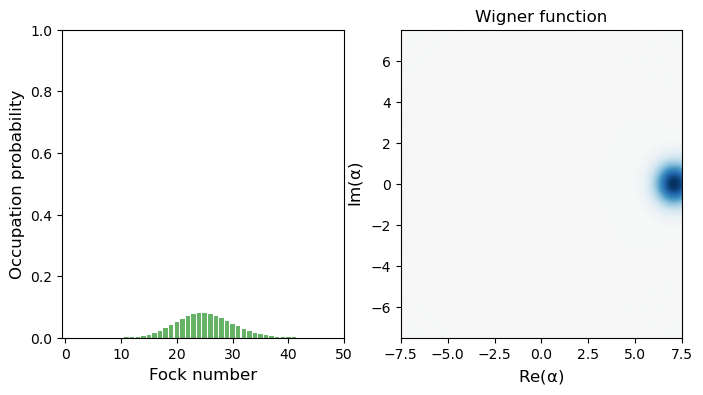

In [24]:
n=10

# a=create(10)
f=coherent(50,5)
plot_wigner_fock_distribution(f)
# f


In [10]:
# wd=[4.453915088240761,4.27546558679307]
# sp=[1, 0.5857191329272378]
# L=305
amp=0.13
sp_match=[1, 0.58781640625]
L=306.3153958210565
wd=[4.453933927926302,4.275361968522592]
# wdm=(5.956000029067557+5.731319558030517)/2
# wd=[wdm ,5.731319558030517 ]#single wave
# 5.738450530011672 
# wd=[5.956000029067557 ,5.731319558030517 ]#single wave
# wd=[5.960313438079269 ,5.738864629361385 ]#mix wave,single swap 11-22,sp=[1,1]，T~~140ns
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
# wd=[5.9550457117450755,5.738864629361385 ]#mix wave,in-step swap[1,1]
a=sideband( level=4, t_edge=10,  w=[5,4],        yita=[0.25,0.25],  g=[0.15],
            L=1000,   wd=wd,     phid=[0,0],     amp=0.2,         sp_direct=[1,0.46617831709480284],
            rho0=0,  )
a.update(amp=amp,wd=wd,sp_direct=sp_match,L=L,mix=True,phid=[0,0])


run start,T=306.3153958210565


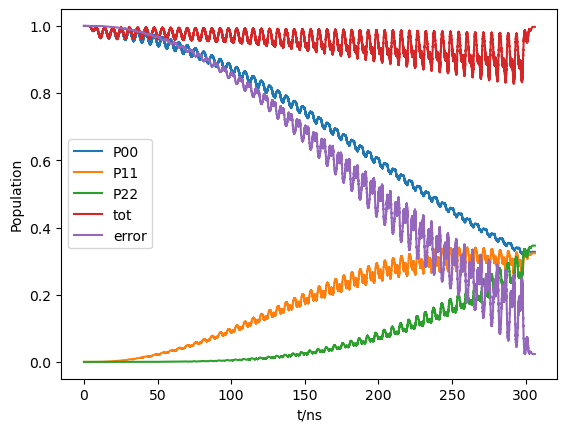

run end


Result object with mesolve data.
--------------------------------
expect = True
num_expect = 3, num_collapse = 0

In [57]:
a.run(plot=True)

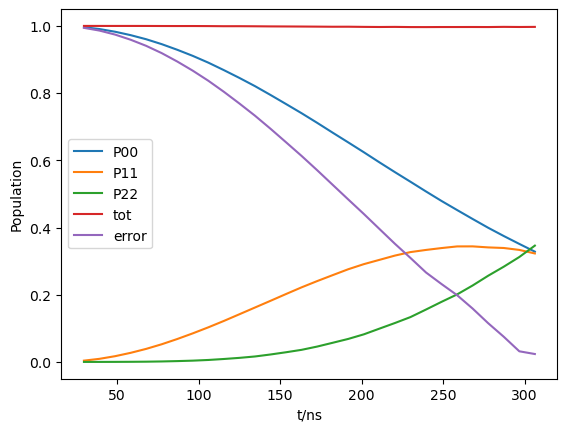

run end


__main__.sideband.run_fin.<locals>.output

In [58]:
# r=a.run_lego(L=10,plot=True,enve_type='u')
# rr=a.run_lego(r,L=282,plot=True)
# rrr=a.run_lego(rr,L=10,plot=True,enve_type='d')
a.run_fin(plot=True)

In [1]:
wd=[5,2,1,3,4]
z=[['x'],['y'],['z'],['u'],['v']]
zz=[55,22,11,33,21]
a=zip(wd,zz)
print(a)

NameError: name 'b' is not defined

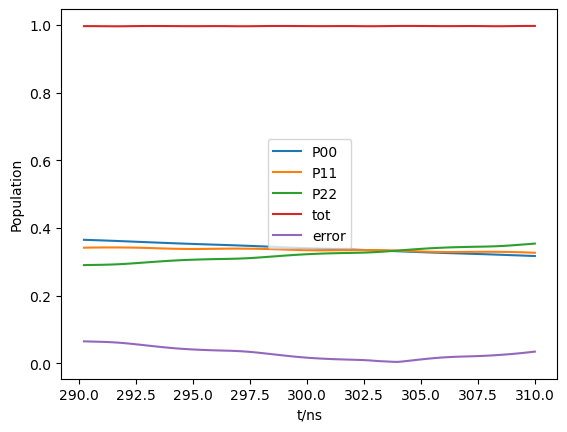

run end


TypeError: type 'output' is not subscriptable

In [64]:
# r=a.run_lego(L=10,plot=True,enve_type='u')
# rr=a.run_lego(r,L=282,plot=True)
# rrr=a.run_lego(rr,L=10,plot=True,enve_type='d')
r=a.run_fin(290,310,100,plot=True)


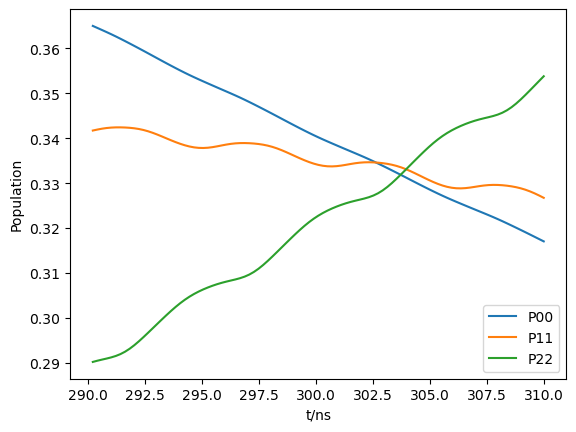

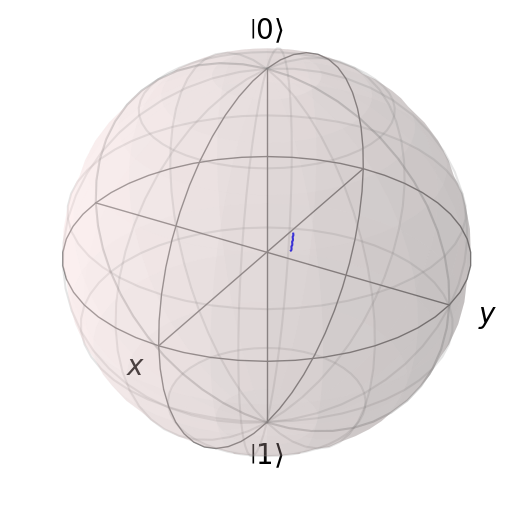

In [71]:
rr=copy(r)
rr.expect=[rr.expect[i] for i in [0,1,2]]
a.GateProcess(rr,show_list=[0,1,2])

run start,T=302


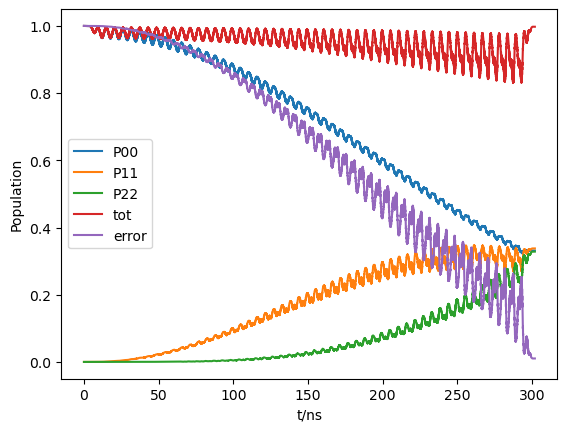

run end


In [4]:
wd=[4.453915088240761,4.27546558679307]
sp=[1, 0.5857191329272378]
L=1502
amp=0.13
a.update(amp=amp,wd=wd,sp_direct=sp,L=L,mix=True,phi0=[0,0])
# a.run_fin(300,305,5,True,True,True,[3,4])
res=a.run(plot=True)
# a.arrow_ideal



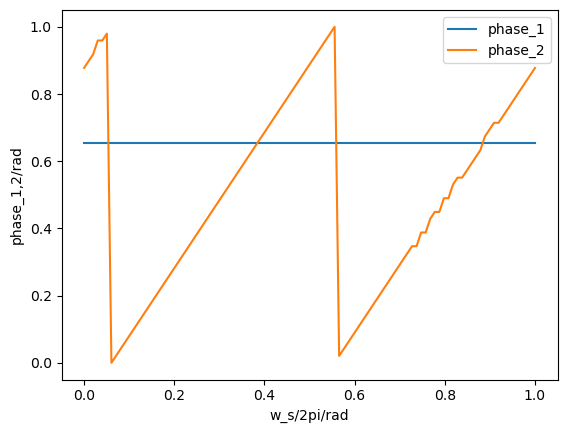

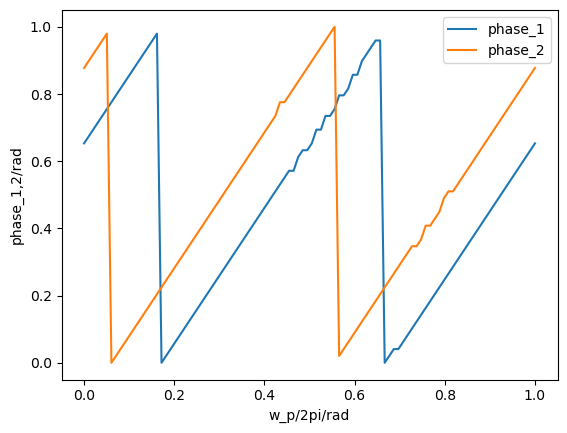

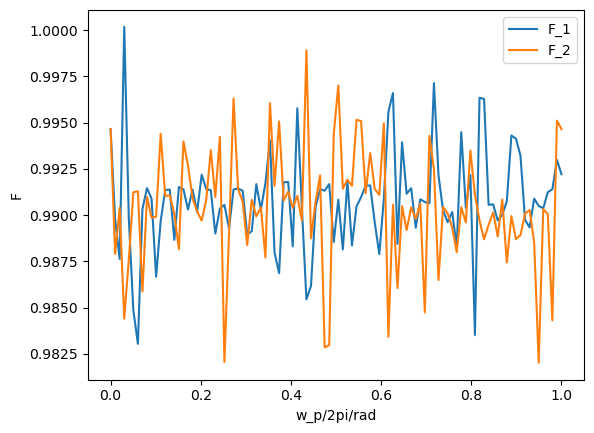

In [ ]:
a.scan_phid_statephase(step=100,plot=True)

In [ ]:
fs=res.final_state
# plot_expectation_values(res,['P']*7)
a.to(2)
# fs=a.es[11]

rho_mix=a.rho_mix
# plot_fock_distribution(fs)
plot_wigner_fock_distribution(fs)
plot_wigner_fock_distribution(rho_mix)
tracedist(fs,rho_mix)
# plot_
# plot_

NameError: name 'res' is not defined

auto_scan_mix_wave_wd start
amp=0.2		sp_direct=[1, 0.58]
T for scan:29.585200102267642
iter_num=


<class 'numpy.ndarray'>
[4.189029109529345, 4.266196461506724, 4.343363813484103, 4.227612785518035, 4.304780137495413, 4.285488299501069, 4.295134218498241, 4.275842380503897, 4.290311258999655, 4.280665340002483, 4.2878997792503615, 4.286694039375715, 4.289105519125008, 4.287296909313039, 4.2875983442817, 4.286995474344376, 4.287447626797369, 4.2871461918287075, 4.287372268055203, 4.287221550570873, 4.2873345886841205]
()
dpi=0.020865500758057678MHz,w_match=4.287334588684121GHz 
 auto_scan_scope end


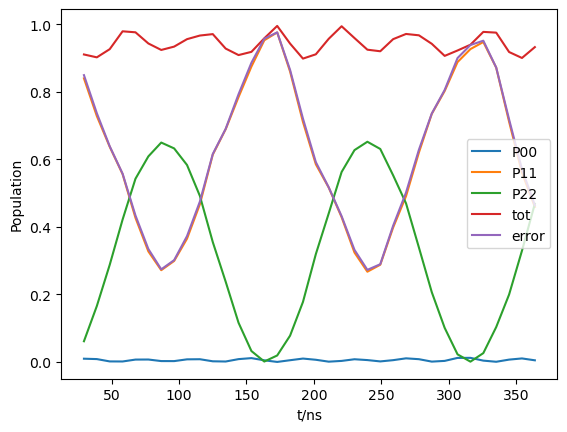

run end
wd_fit start 
 sp=1
correct!=1


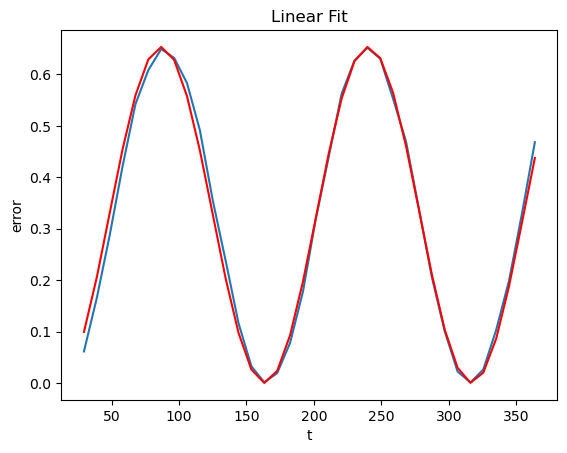

guess value of [d_eff,F,t0]=[0.004405504381810832, 0.8, 5.0]
fit coeff [d_eff,F,t0,T]=[0.0065145273047658965, 0.6535756548820467, 9.999999999999998, 153.50307907504205]
 wd_fit end
T for scan:38.191380516478816
iter_num=


In [11]:
a.auto_opti_sp_direct(0.2,[1,0.58])


auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.5]
auto_scan_scope start 
 sp=1
T for scan:31.464751340098967
iter_num=
1,run start,T=31.464751340098967


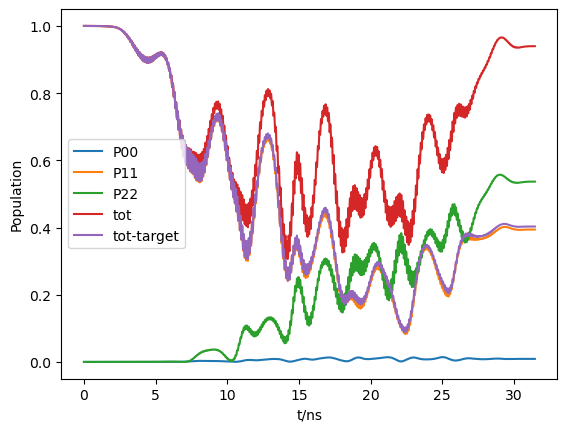

run end
2,run start,T=31.464751340098967


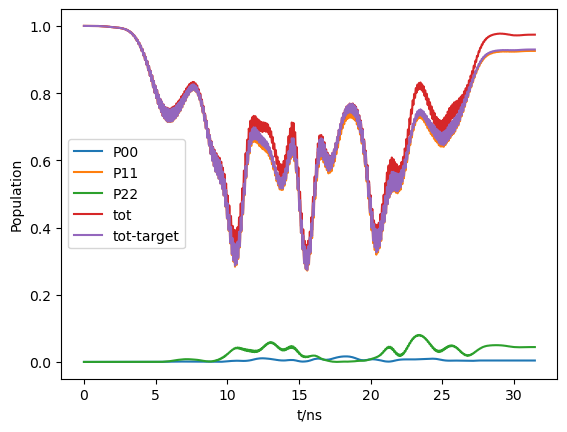

run end
3,run start,T=31.464751340098967


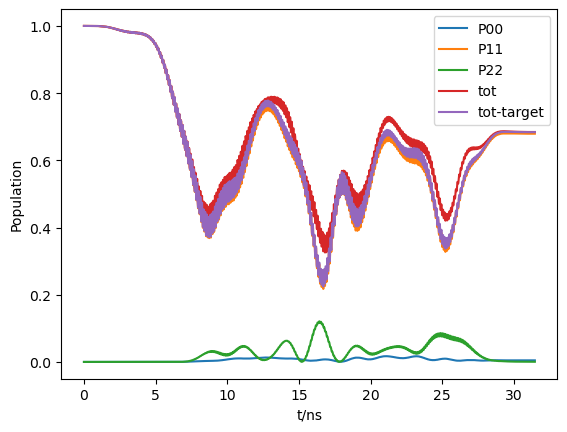

run end
4,run start,T=31.464751340098967


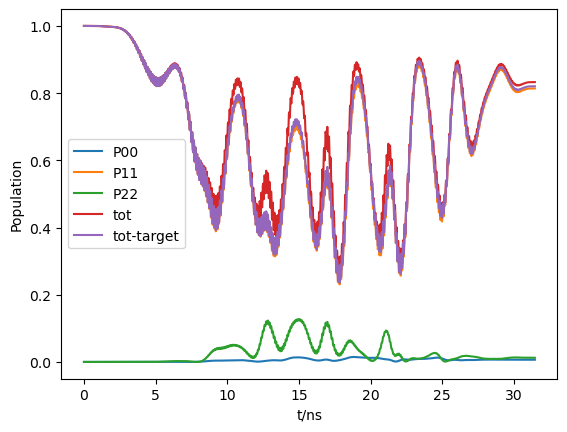

run end
5,run start,T=31.464751340098967


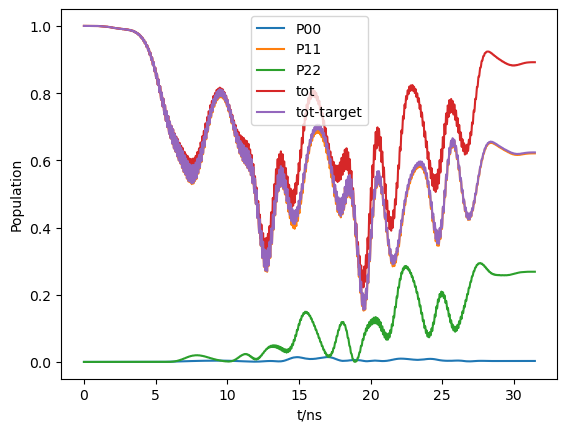

run end
6,run start,T=31.464751340098967


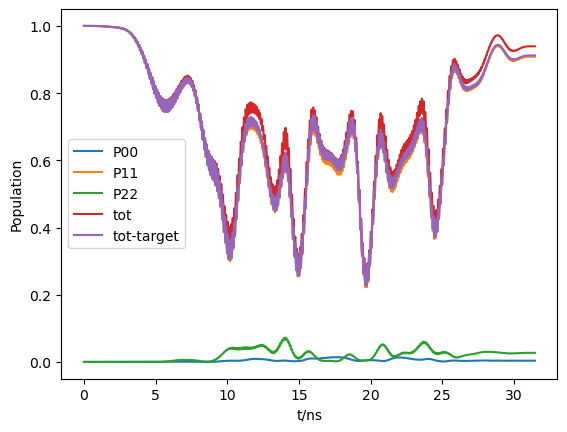

run end
7,run start,T=31.464751340098967


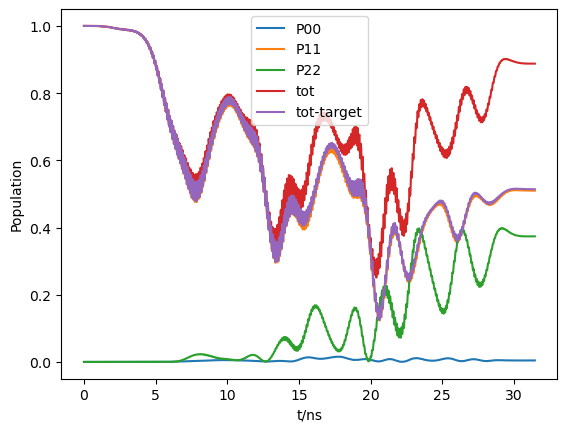

run end
8,run start,T=31.464751340098967


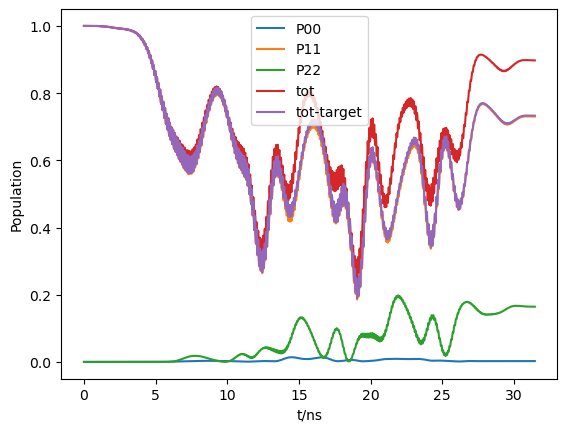

run end
9,run start,T=31.464751340098967


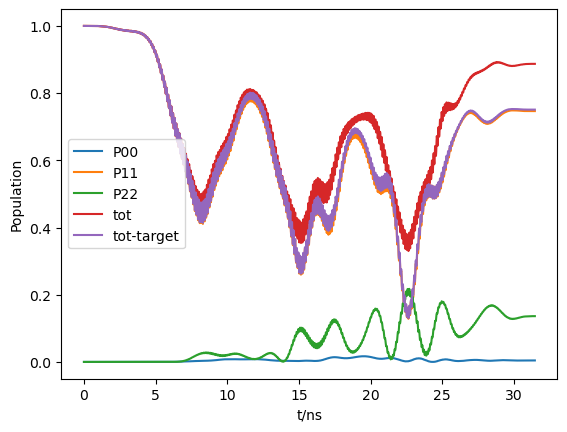

run end
10,run start,T=31.464751340098967


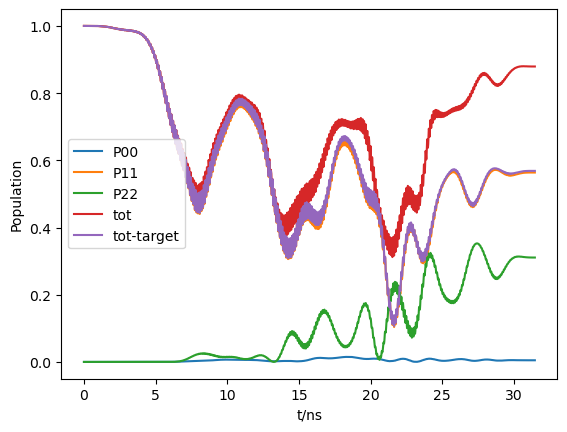

run end
11,run start,T=31.464751340098967


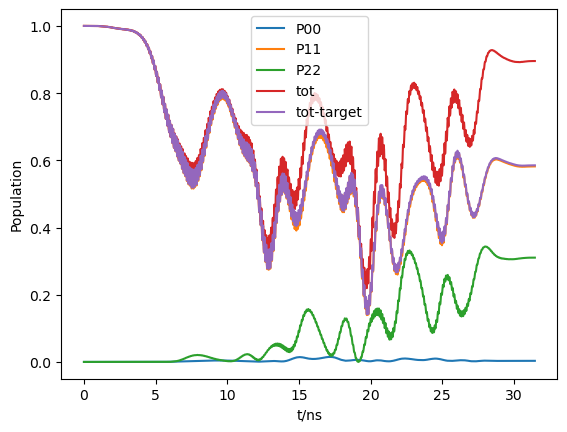

run end
12,run start,T=31.464751340098967


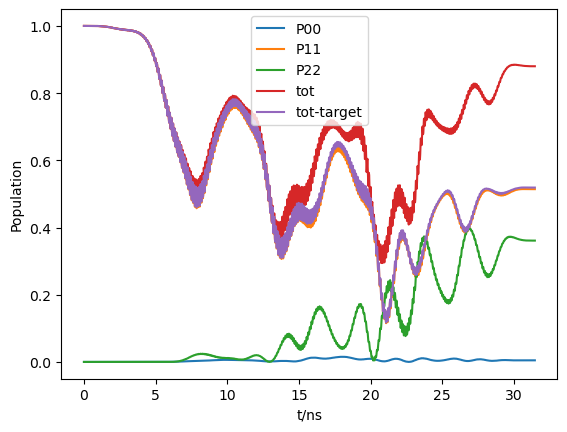

run end
13,run start,T=31.464751340098967


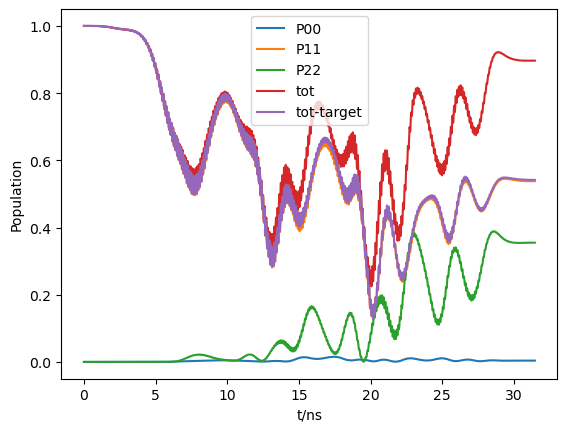

run end
14,run start,T=31.464751340098967


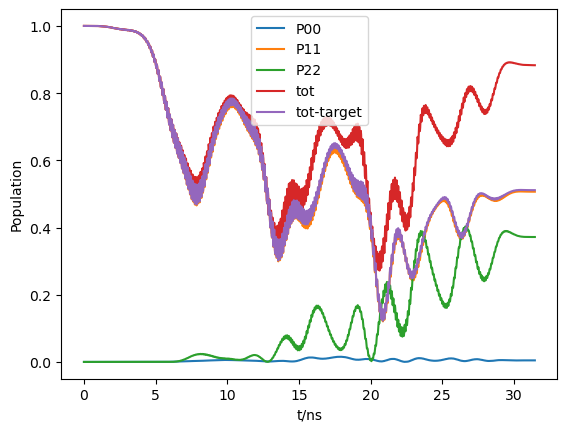

run end
15,run start,T=31.464751340098967


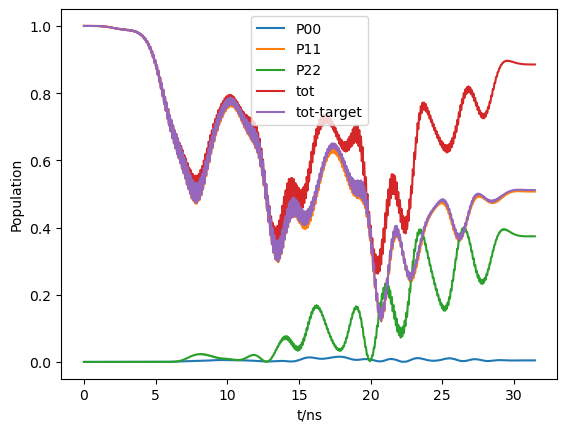

run end
16,run start,T=31.464751340098967


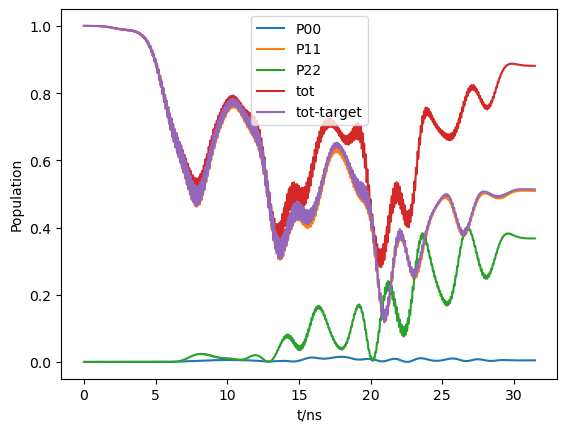

run end
17,run start,T=31.464751340098967


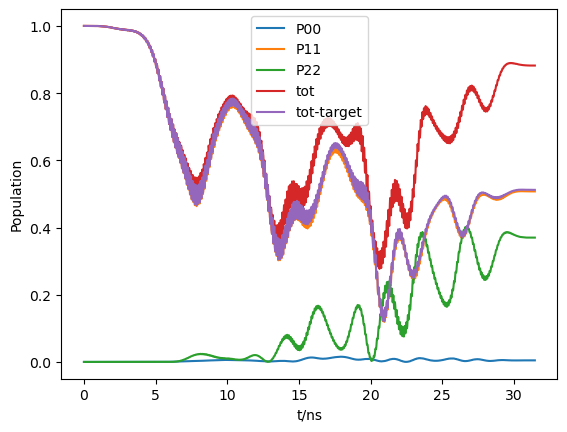

run end
18,run start,T=31.464751340098967


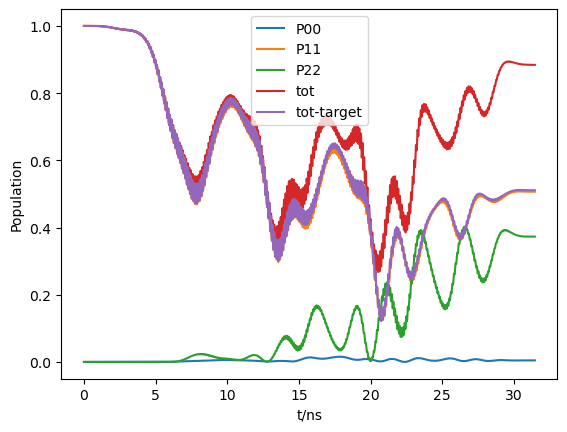

run end




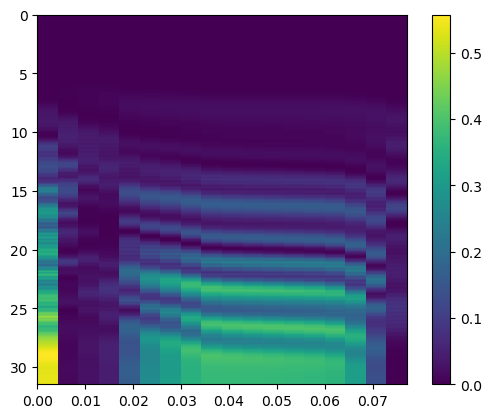

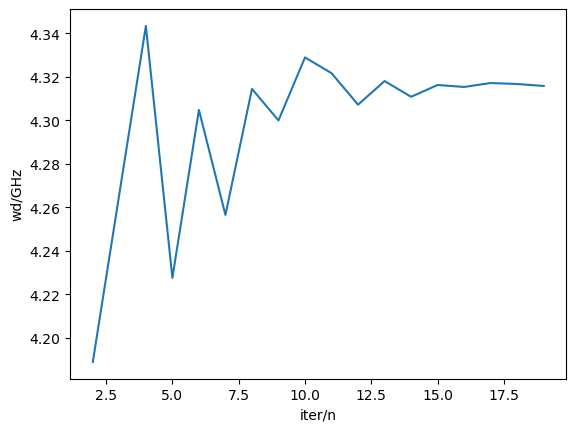

dpi=0.1744477434067694MHz,w_match=4.316234666304556GHz 
 auto_scan_scope end
run start,T=161.70116014647843


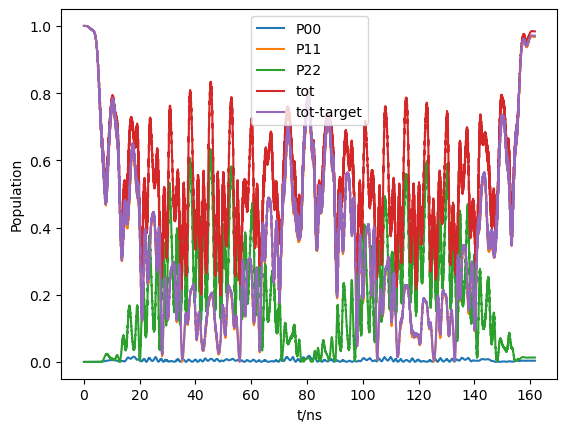

run end
wd_fit start 
 sp=1
correct!=1


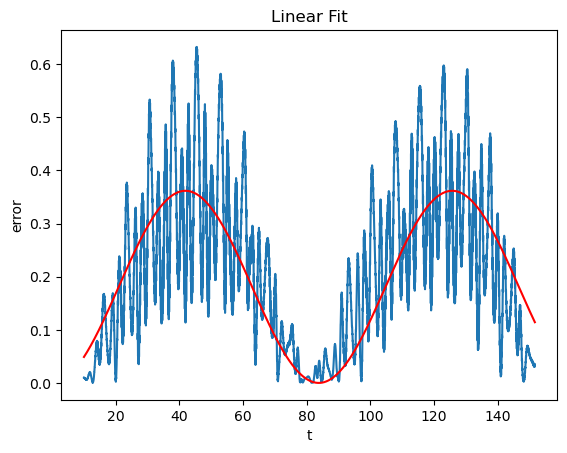

guess value of [d_eff,F,t0]=[0.007956247940668487, 0.8, 5.0]
fit coeff [d_eff,F,t0,T]=[0.011934371911002729, 0.3617143822766298, 5.0810997305096086e-20, 83.79159016136106]
 wd_fit end
auto_scan_scope start 
 sp=0
T for scan:36.170116014647846
iter_num=
1,run start,T=36.170116014647846


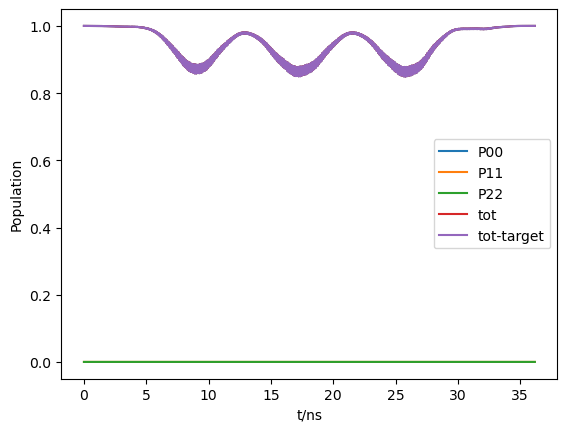

run end
2,run start,T=36.170116014647846


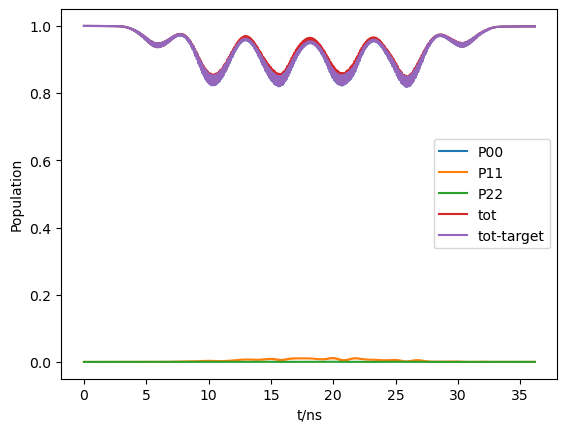

run end
3,run start,T=36.170116014647846


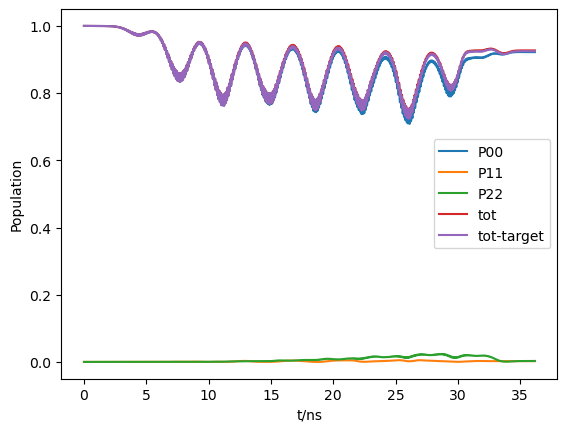

run end
4,run start,T=36.170116014647846


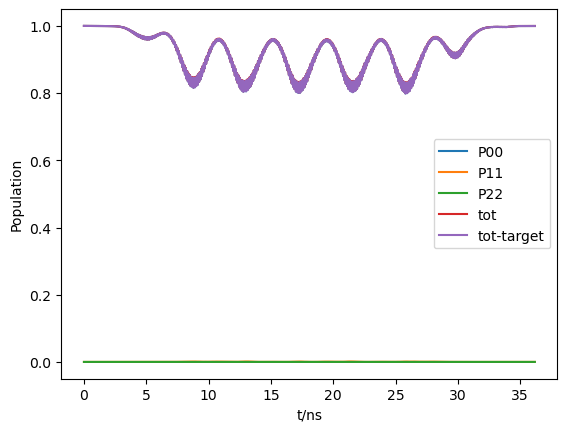

run end
5,run start,T=36.170116014647846


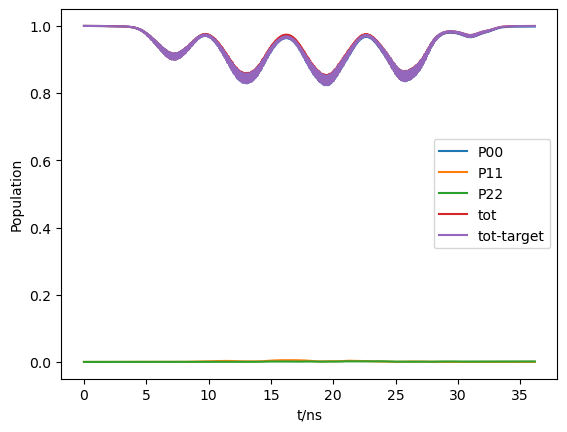

run end
6,run start,T=36.170116014647846


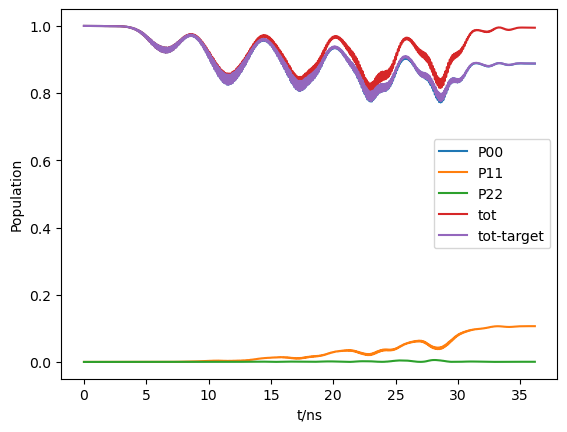

run end
7,run start,T=36.170116014647846


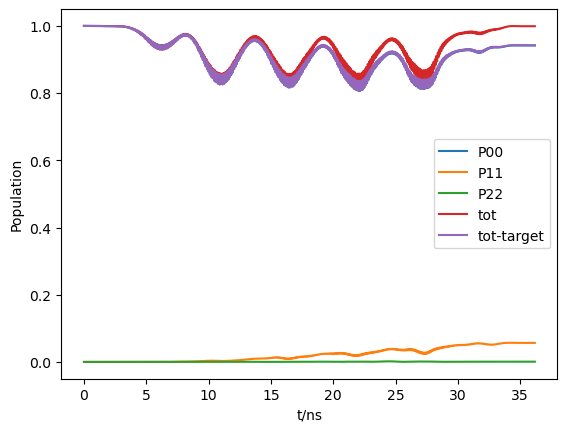

run end
8,run start,T=36.170116014647846


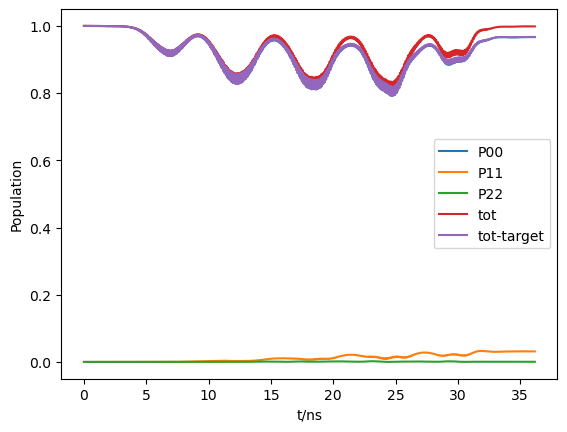

run end
9,run start,T=36.170116014647846


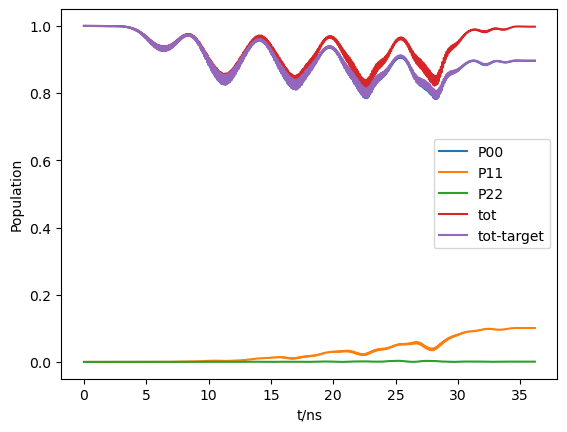

run end
10,run start,T=36.170116014647846


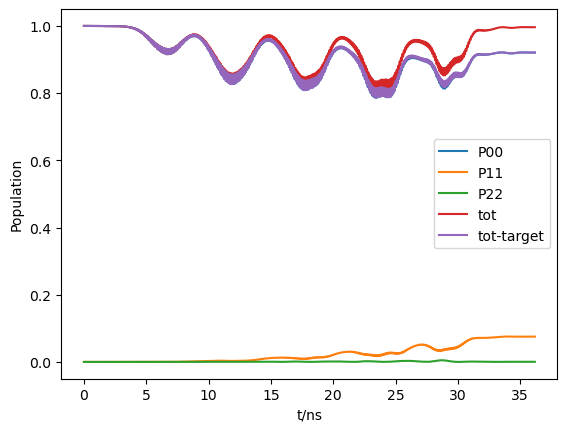

run end
11,run start,T=36.170116014647846


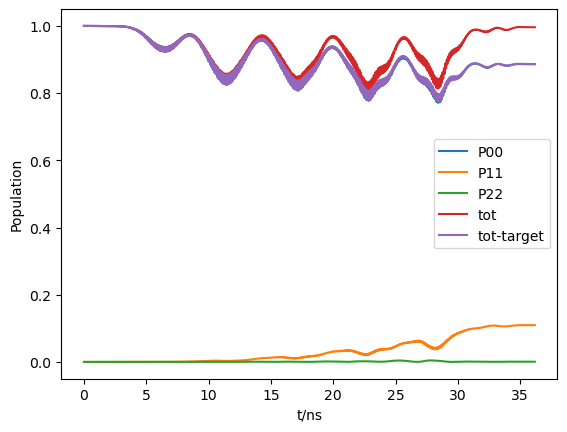

run end
12,run start,T=36.170116014647846


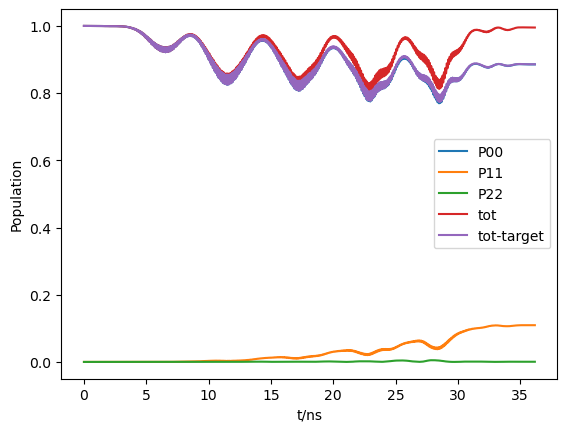

run end
13,run start,T=36.170116014647846


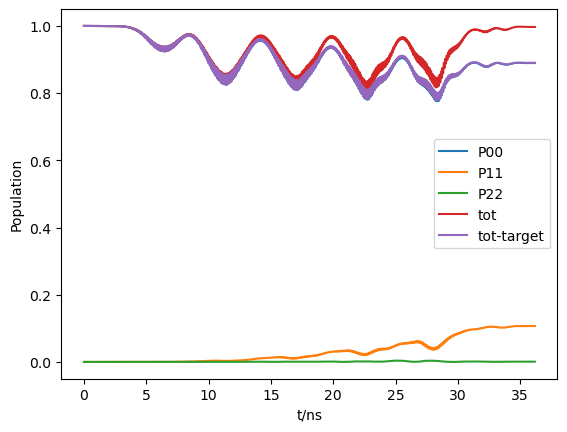

run end
14,run start,T=36.170116014647846


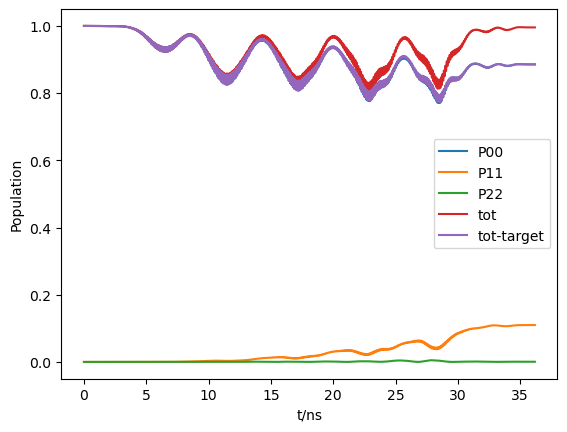

run end




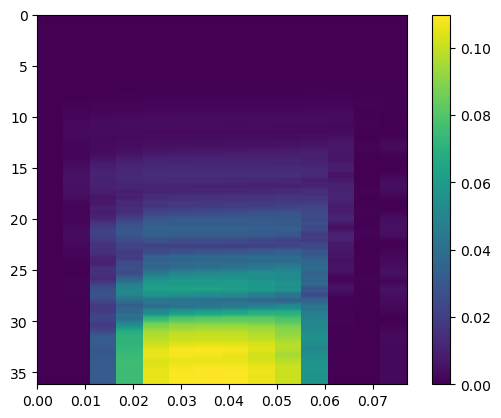

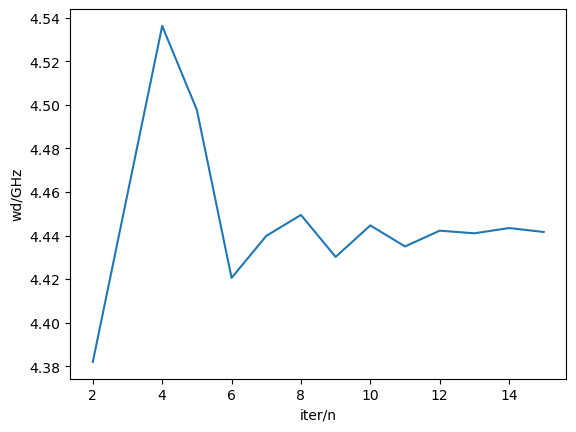

dpi=0.3092123764276463MHz,w_match=4.441631613267798GHz 
 auto_scan_scope end
run start,T=171.7598001115776


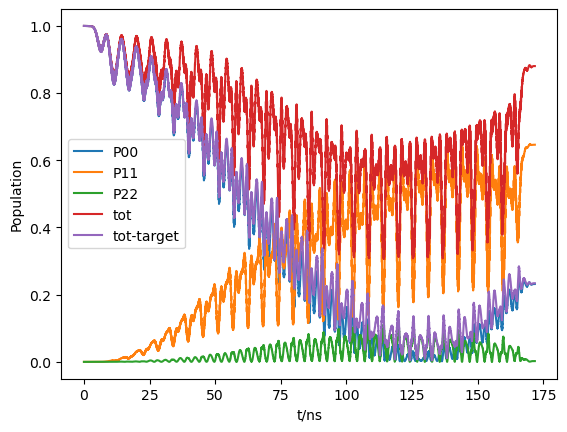

run end
wd_fit start 
 sp=0


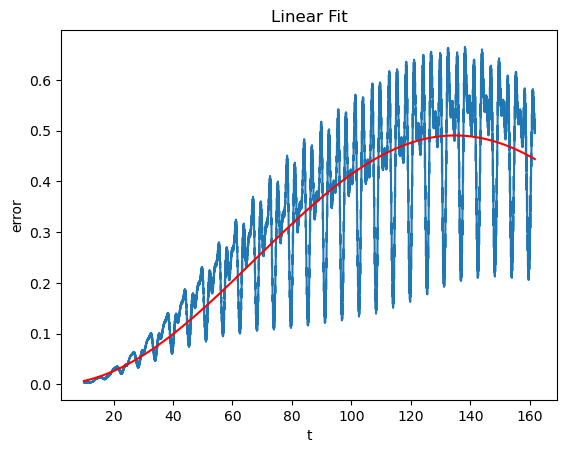

guess value of [d_eff,F,t0]=[0.0058220840927294334, 0.8, 5.0]
fit coeff [d_eff,F,t0,T]=[0.0037086929433698635, 0.4905765122635703, 4.348354369657047e-17, 269.6367737285257]
 wd_fit end
run start,T=350.52780584708347


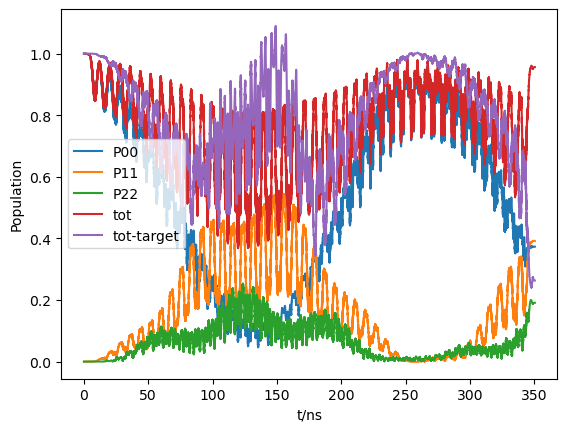

run end


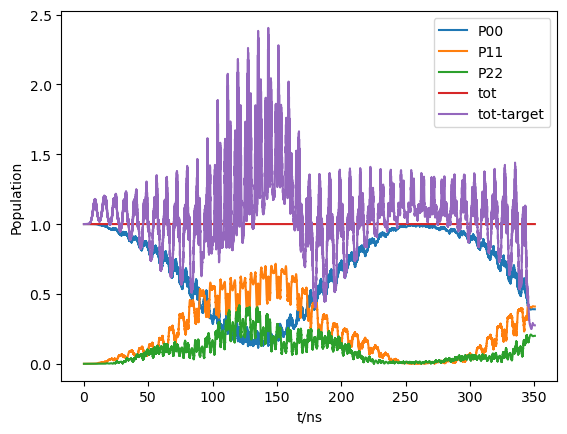

mix_wave_fit start 
 
guess=[0.0058220840927294334, 0.5, 5.0, 1.8660254037844386]
<class 'numpy.ndarray'>


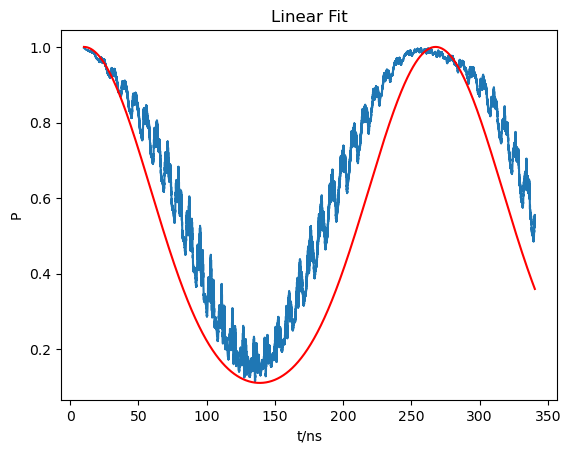

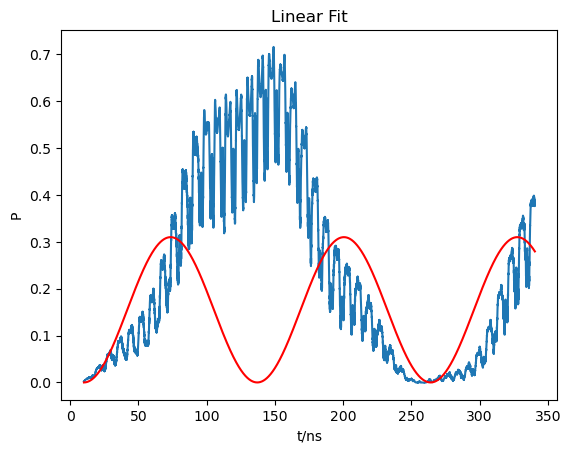

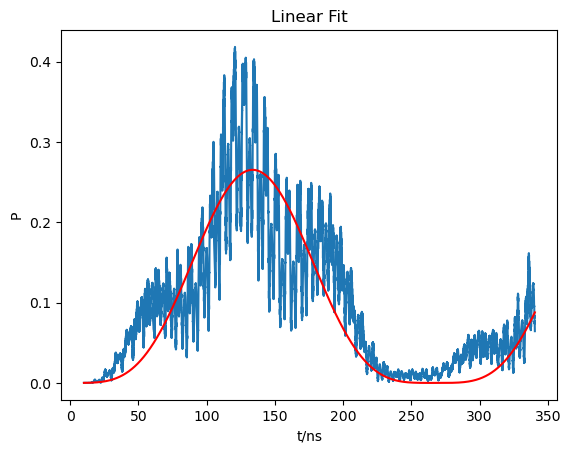

d_eff,F,t0,p2:		guess		coeff
[0.0058220840927294334, 0.5, 5.0, 1.8660254037844386]
[0.003879712036611318, 0.0002908810840700493, 9.99999907114572, 1.4142135607454378]
[0.003935719943811964, 0.310073596028367, 9.999999073835074, 1.4916570670981228]
[0.0037419520545133576, 0.06631898824964905, 0.00024739711848679823, [3.60579046558416, 0.2773317000931151]]

 mix_wave_fit end

sp_direct_input=[1, 0.5]

p_eff1=3.2179455385591162
suggest set sp_direct1 as:[1, 0.3257692195877502]--recommend

p_eff2=1.4142135607454378
suggest set sp_direct2 as:[1, 0.4914076279934966]
wd_mat_mix=[4.441631613267798, 4.316234666304556]
end


[[4.441631613267798, 4.316234666304556],
 [1, 0.3257692195877502],
 257.75108837032053,
 [Result object with mesolve data.
  --------------------------------
  expect = True
  num_expect = 3, num_collapse = 0,
  Result object with mesolve data.
  --------------------------------
  expect = True
  num_expect = 3, num_collapse = 0],
 [[0.0058220840927294334, 0.5, 5.0, 1.8660254037844386],
  [[0.003879712036611318,
    0.0002908810840700493,
    9.99999907114572,
    1.4142135607454378],
   [0.003935719943811964,
    0.310073596028367,
    9.999999073835074,
    1.4916570670981228],
   [0.0037419520545133576,
    0.06631898824964905,
    0.00024739711848679823,
    [3.60579046558416, 0.2773317000931151]]],
  259.6914678469048,
  1.4142135607454378],
 1.9001082917356769]

In [ ]:
a.auto_scan_mix_wave_wd_sp(0.3,single_wave_scan=False,sp_direct=[1, 0.5],dom=0.8,runplot=True,)

auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.35]
auto_scan_scope start 
 sp=1
T for scan:75.01470667270397
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,



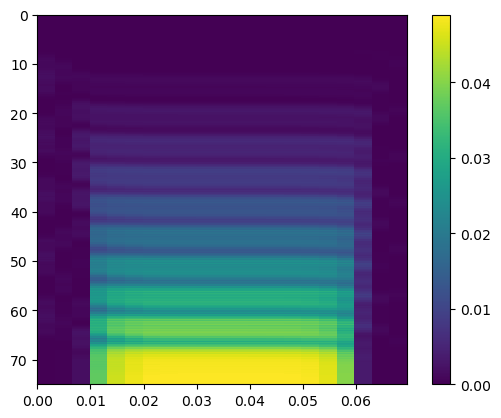

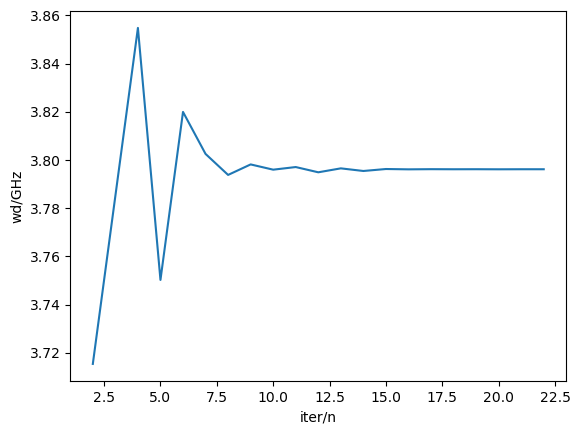

dpi=0.0036353915542956397MHz,w_match=3.7961302652723052GHz 
 auto_scan_scope end
run start,T=1024.0494643798584


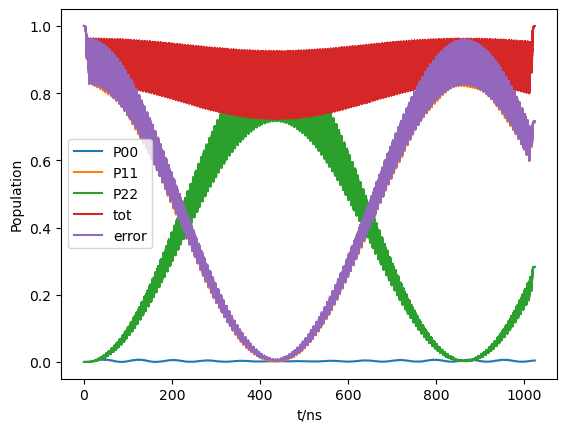

run end
wd_fit start 
 sp=1
correct!=1


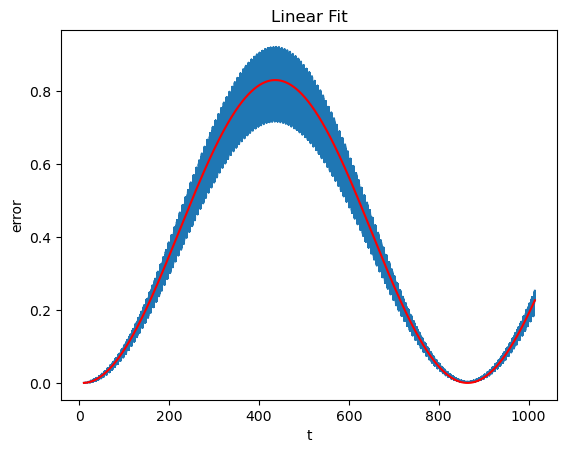

guess value of [d_eff,F,t0]=[0.0016623484927353713, 0.8, 5.0]
fit coeff [d_eff,F,t0,T]=[0.0011675079131770554, 0.8305813492141899, 7.665637466628355, 856.5252438236345]
 wd_fit end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,



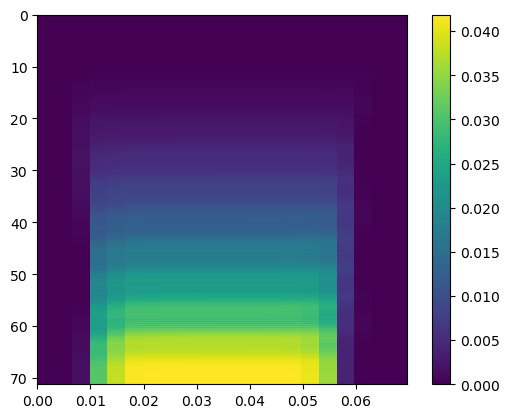

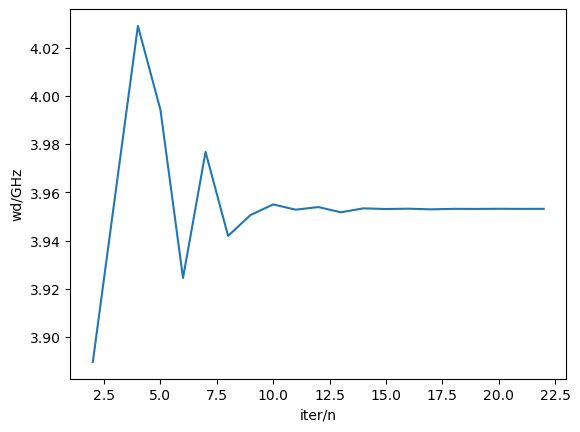

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end
run start,T=1035.0022635018545


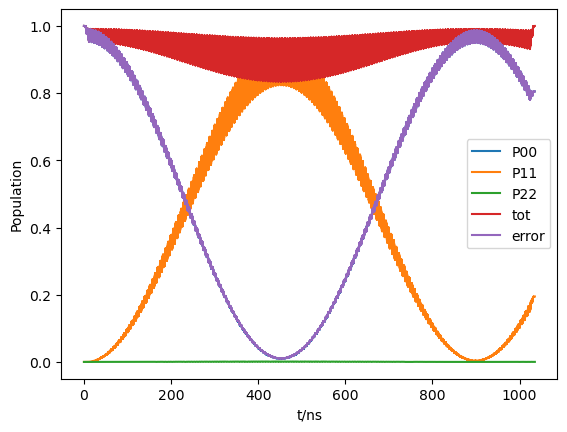

run end
wd_fit start 
 sp=0


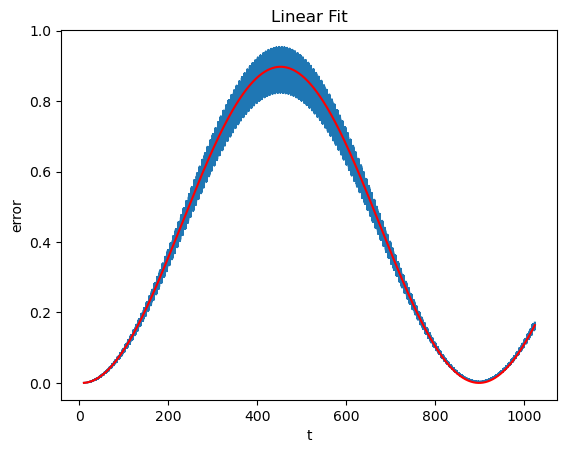

guess value of [d_eff,F,t0]=[0.0009661532429983315, 0.8, 5.0]
fit coeff [d_eff,F,t0,T]=[0.0011195076708739662, 0.8972500143903165, 6.092249108941864, 893.2497972249979]
 wd_fit end
run start,T=1161.2247363924973


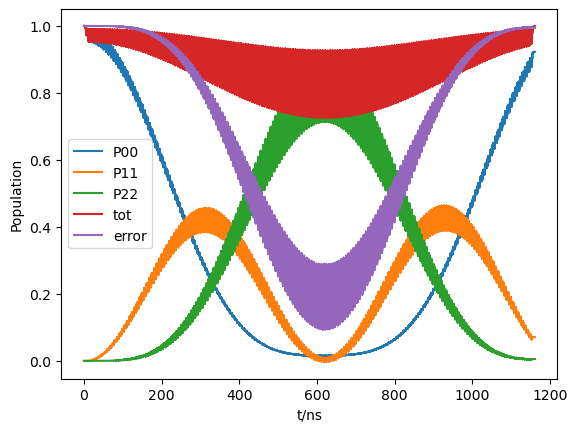

run end


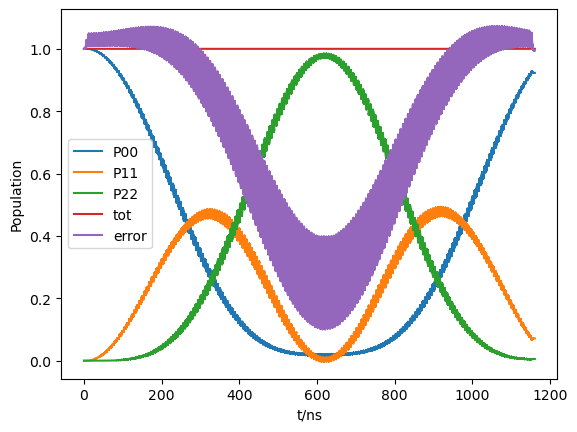

mix_wave_fit start 
 
guess=[0.0009661532429983315, 0.5, 5.0, 1.0]
<class 'numpy.ndarray'>


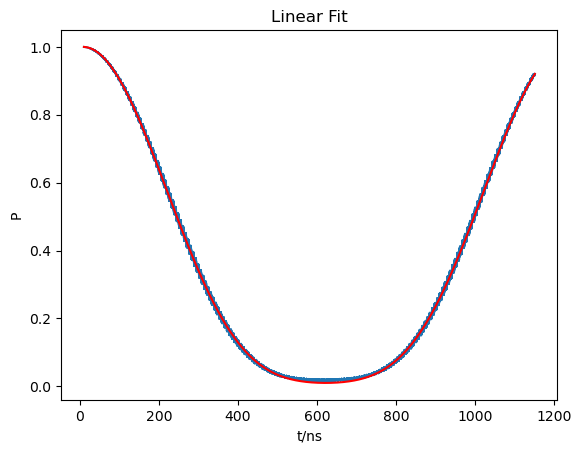

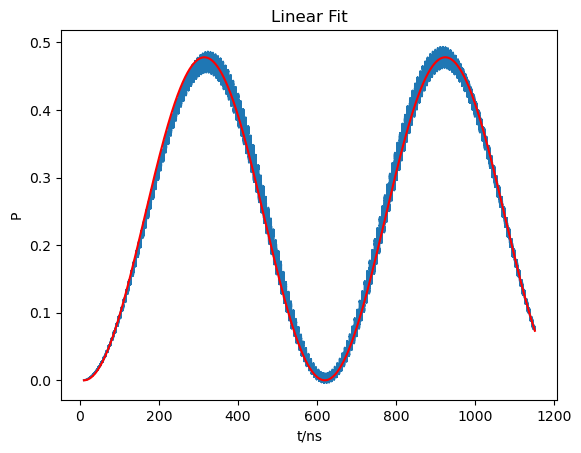

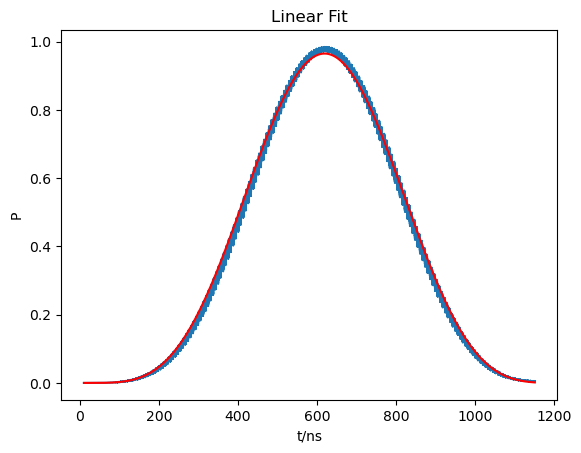

d_eff,F,t0,p2:		guess		coeff
[0.0009661532429983315, 0.5, 5.0, 1.0]
[0.000814931924956934, 0.9994233909742272, 7.748146197025997, 1.1058689720452668]
[0.0008201911533242674, 0.4781241396183408, 9.999996678357594, 1.044752138845403]
[0.0008209916095495126, 0.2413623132645474, 9.999996610268978, [1.2069114324158514, 0.8285612126469952]]

 mix_wave_fit end

sp_direct_input=[1, 0.35]

p_eff1=1.0428762067039852
suggest set sp_direct1 as:[1, 0.3427296400121016]--recommend

p_eff2=1.1058689720452668
suggest set sp_direct2 as:[1, 0.3328252047491393]
wd_mat_mix=[3.9531324481919174, 3.7961302652723052]
end
auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3427296400121016]
auto_scan_scope start 
 sp=1
T for scan:77.37352860776194
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,



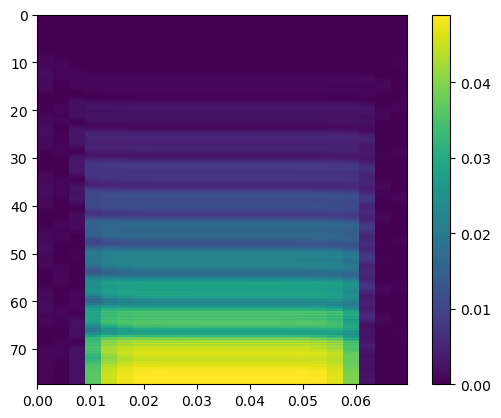

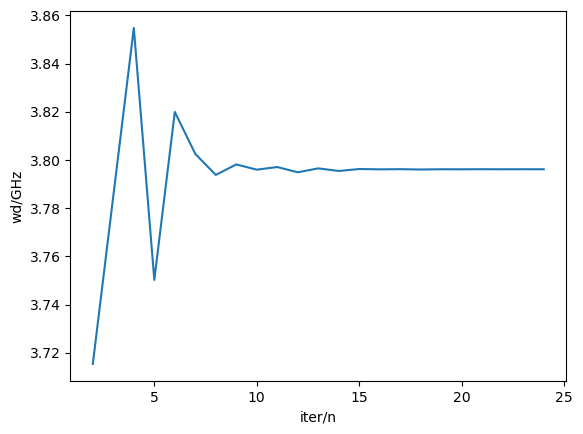

dpi=0.0034859281772141593MHz,w_match=3.7961217563606766GHz 
 auto_scan_scope end
run start,T=1024.0494643798584


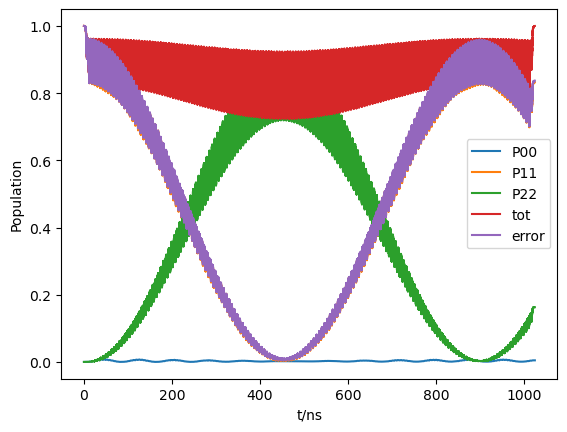

run end
wd_fit start 
 sp=1
correct!=1


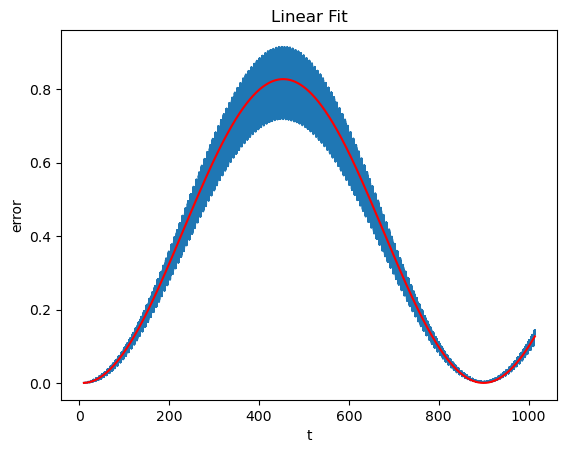

guess value of [d_eff,F,t0]=[0.0015939839165686094, 0.8, 5.0]
fit coeff [d_eff,F,t0,T]=[0.0011207197868072923, 0.82768635513758, 7.490371312479628, 892.2837017527825]
 wd_fit end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,



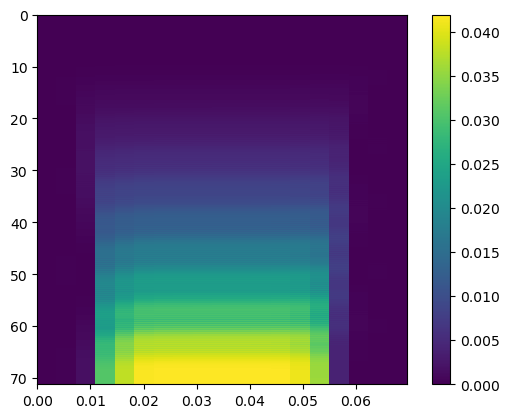

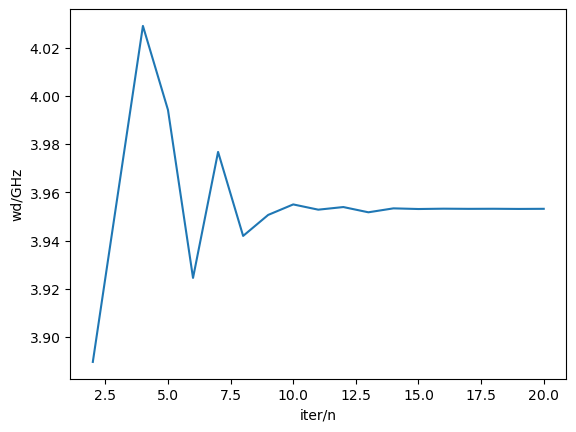

dpi=0.009765153293699322MHz,w_match=3.953149466015175GHz 
 auto_scan_scope end
run start,T=1035.0022635018545


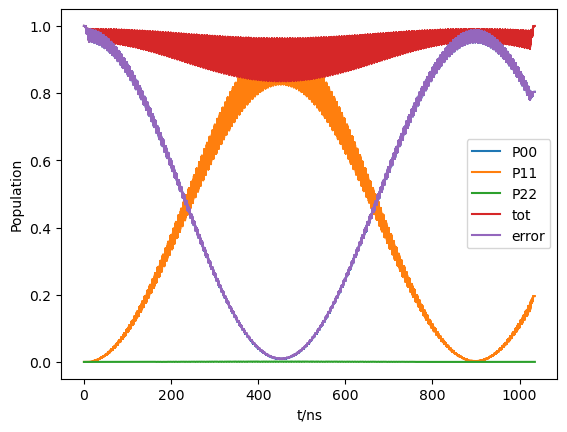

run end
wd_fit start 
 sp=0


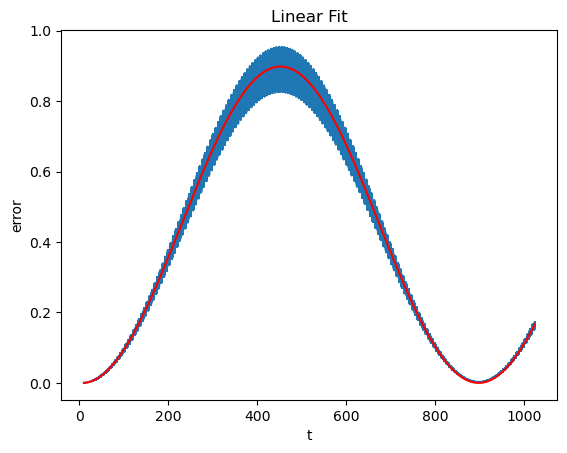

guess value of [d_eff,F,t0]=[0.0009661814618806467, 0.8, 5.0]
fit coeff [d_eff,F,t0,T]=[0.0011204390193368084, 0.8980896439496783, 6.128852597677641, 892.5072964630448]
 wd_fit end
run start,T=1160.2594854019583


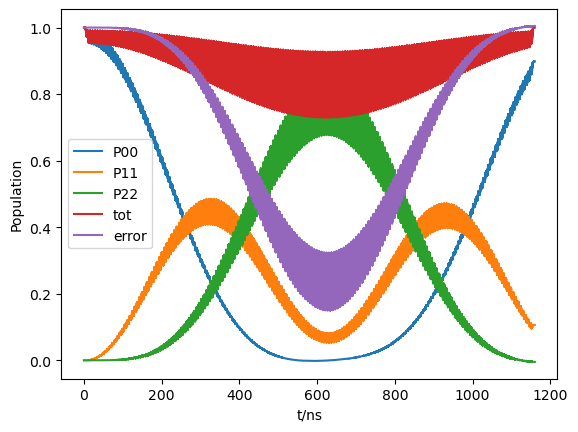

run end


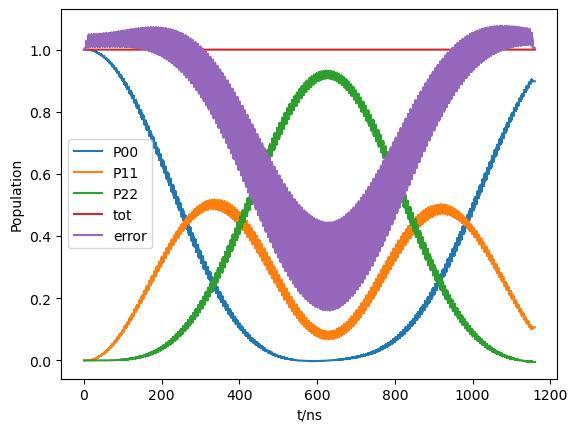

mix_wave_fit start 
 
guess=[0.0009661814618806467, 0.5, 5.0, 1.0]
<class 'numpy.ndarray'>


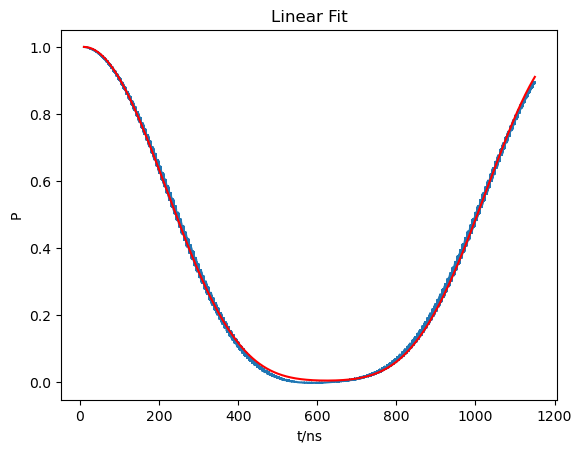

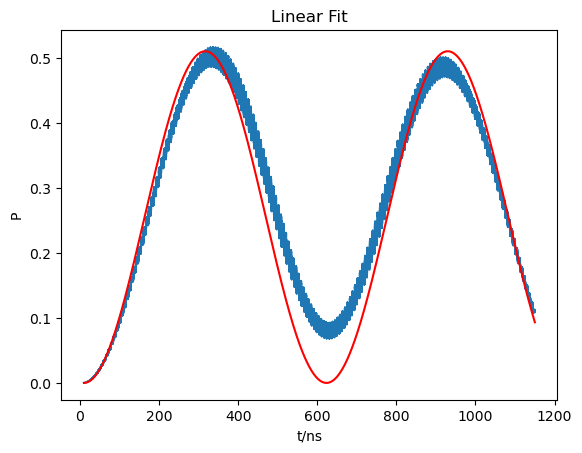

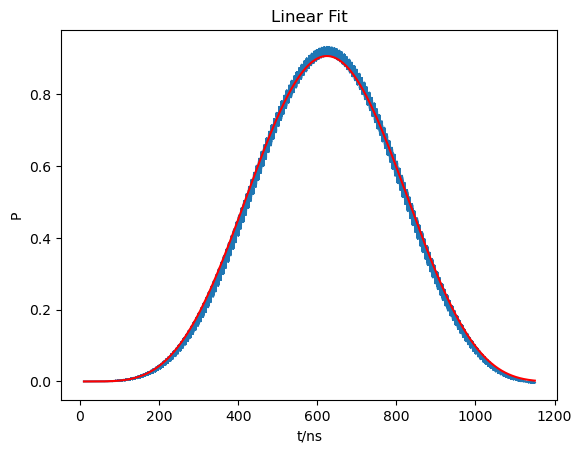

d_eff,F,t0,p2:		guess		coeff
[0.0009661814618806467, 0.5, 5.0, 1.0]
[0.0008143506028329598, 0.996502840179248, 9.644441776013576, 1.0723724139917954]
[0.000815341760188206, 0.510842473283269, 9.999999734813041, 0.9785451545108464]
[0.000813810246779782, 0.22670830328388245, 9.999999595855614, [1.3706422659653072, 0.7295849725571729]]

 mix_wave_fit end

sp_direct_input=[1, 0.3427296400121016]

p_eff1=1.0002505870160163
suggest set sp_direct1 as:[1, 0.3426867062820141]--recommend

p_eff2=1.0723724139917954
suggest set sp_direct2 as:[1, 0.3309625454061058]
wd_mat_mix=[3.953149466015175, 3.7961217563606766]
end
iter_num=
1,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3187385652112545]
auto_scan_scope start 
 sp=1
T for scan:86.33544757516701
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,



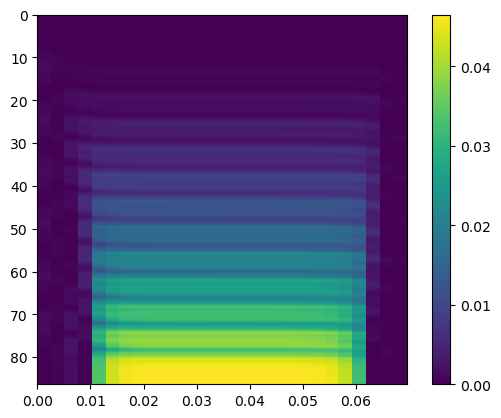

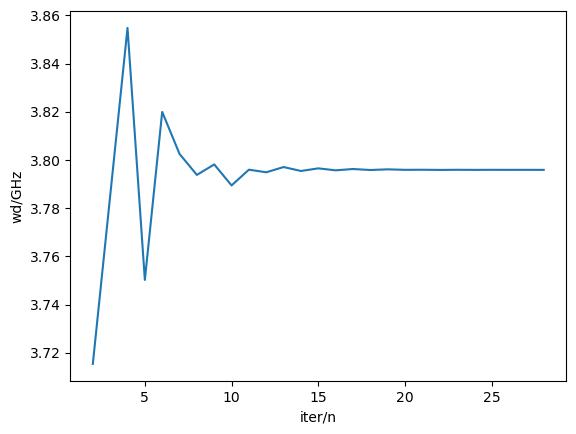

dpi=0.0030149792804725264MHz,w_match=3.7958792523792555GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



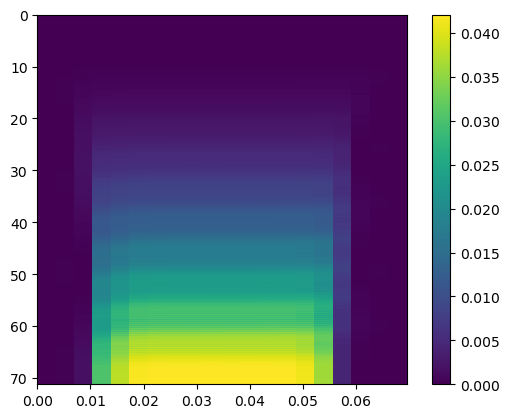

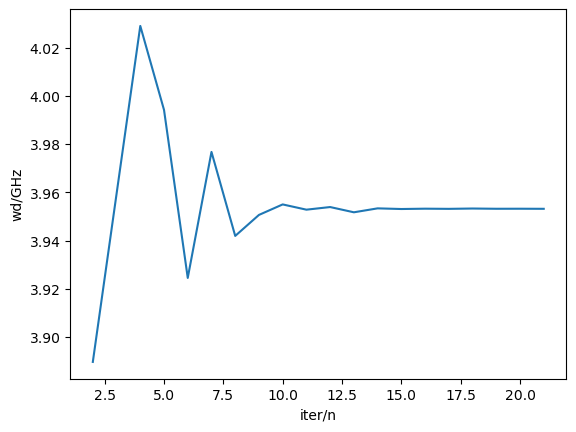

dpi=0.009765153293699322MHz,w_match=3.953166483838433GHz 
 auto_scan_scope end


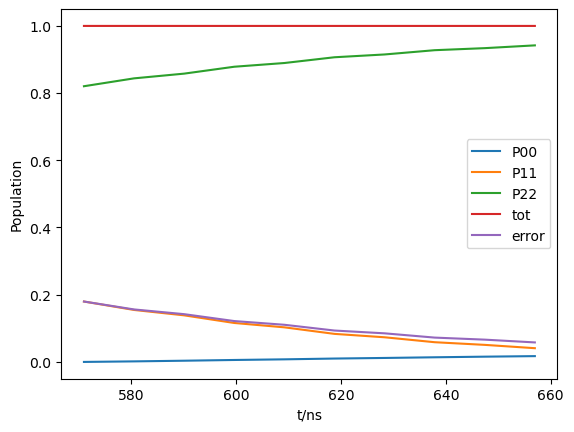

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3427296400121016]
auto_scan_scope start 
 sp=1
T for scan:77.37352860776194
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,



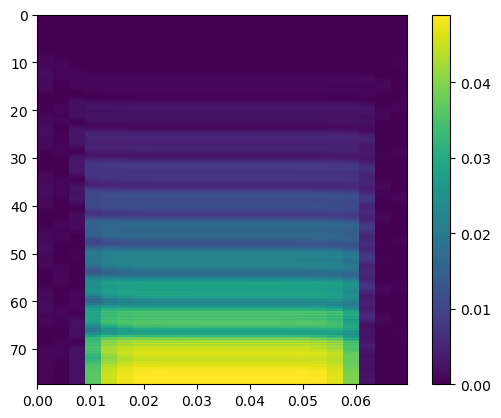

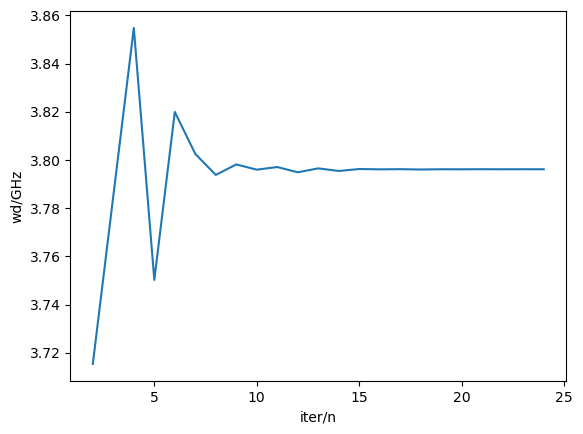

dpi=0.0034859281772141593MHz,w_match=3.7961217563606766GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,



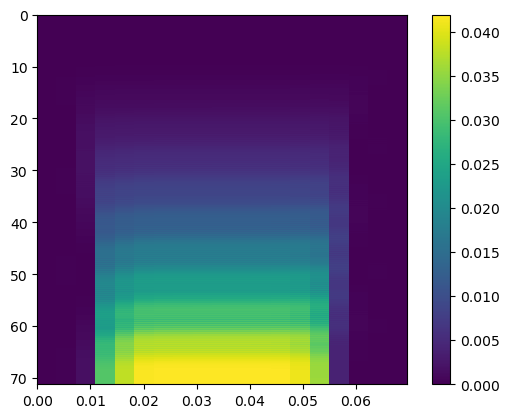

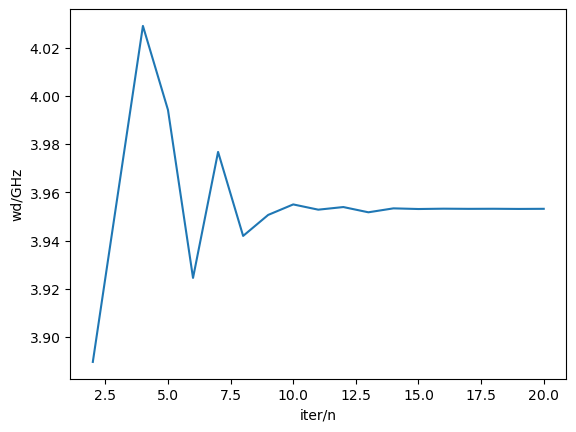

dpi=0.009765153293699322MHz,w_match=3.953149466015175GHz 
 auto_scan_scope end


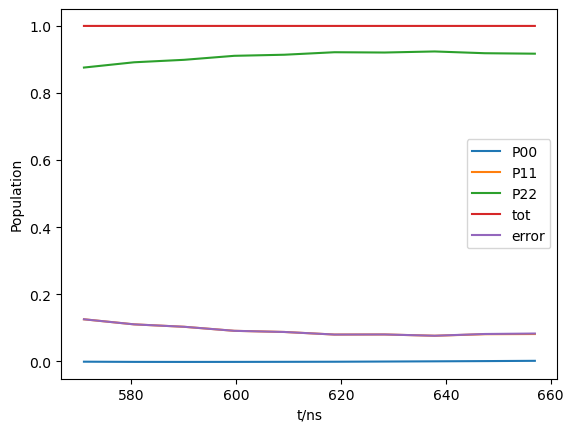

run end
20,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3667207148129487]
auto_scan_scope start 
 sp=1
T for scan:70.1122618637103
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,



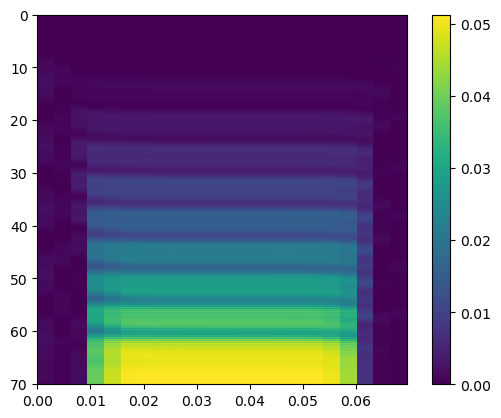

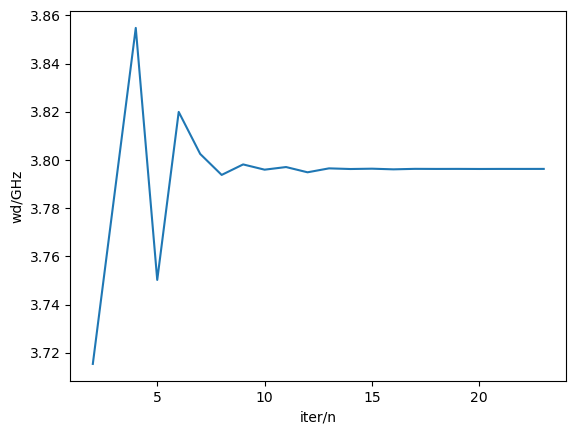

dpi=0.003991039170092491MHz,w_match=3.796270662314181GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,



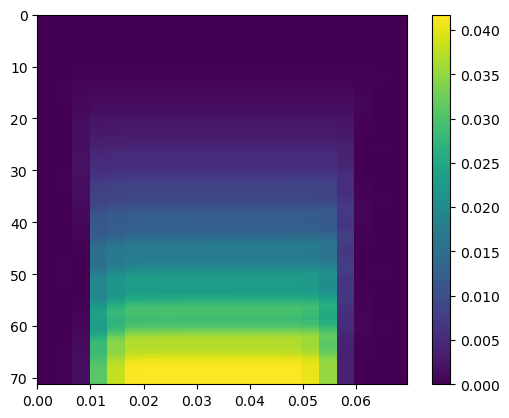

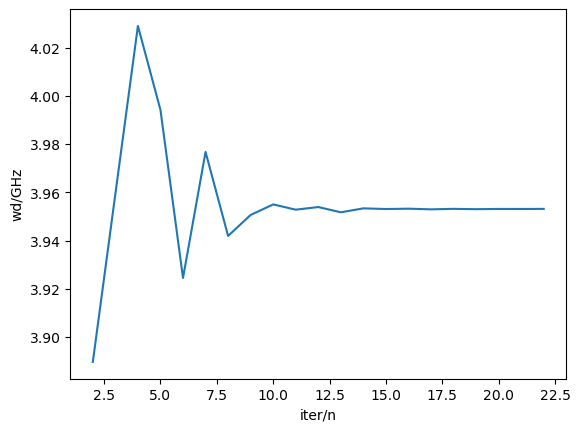

dpi=0.009765153293699322MHz,w_match=3.953098412545402GHz 
 auto_scan_scope end


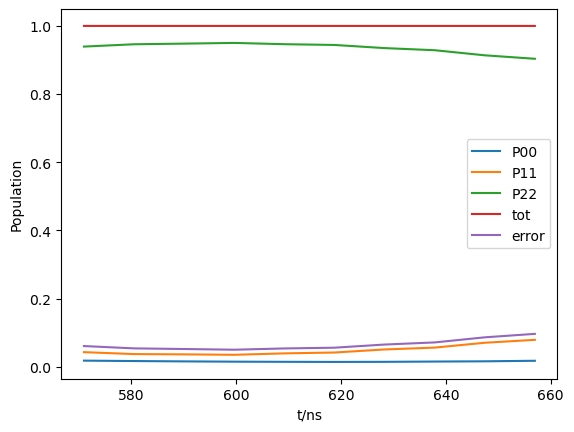

run end
22,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3547251774125252]
auto_scan_scope start 
 sp=1
T for scan:73.55880287312371
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,



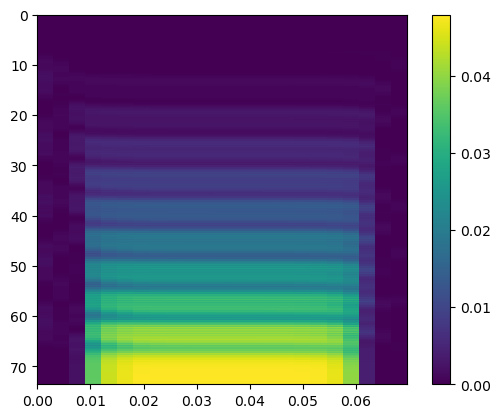

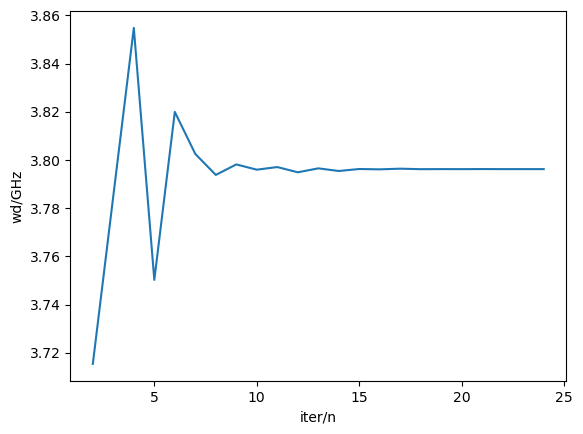

dpi=0.0037342134116362382MHz,w_match=3.796185573197893GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



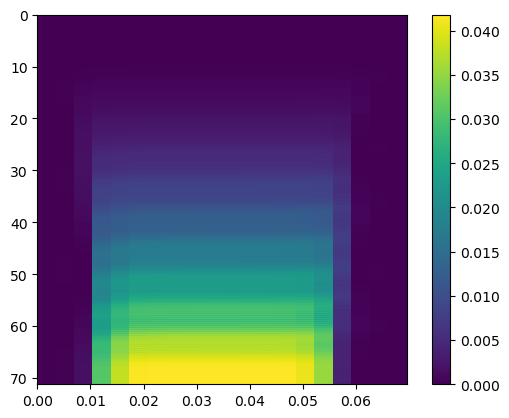

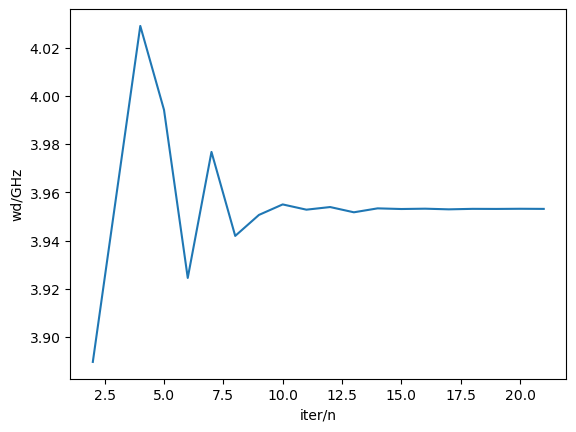

dpi=0.009765153293699322MHz,w_match=3.9531154303686598GHz 
 auto_scan_scope end


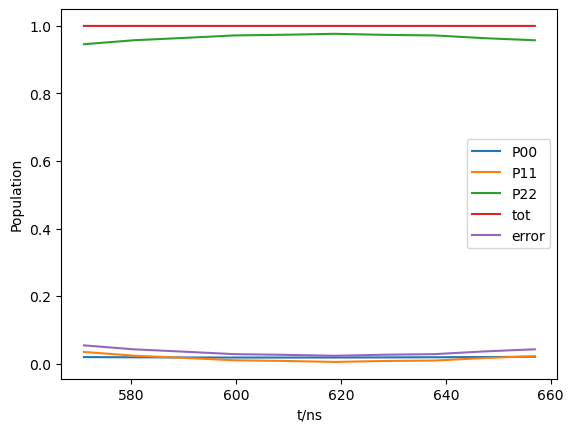

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3607229461127369]
auto_scan_scope start 
 sp=1
T for scan:71.79255689847108
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,



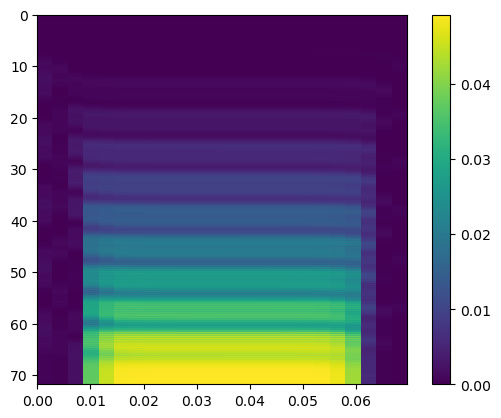

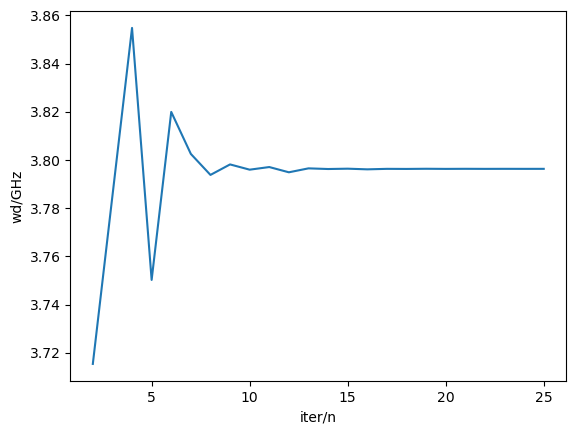

dpi=0.003861558725360092MHz,w_match=3.796296189049068GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



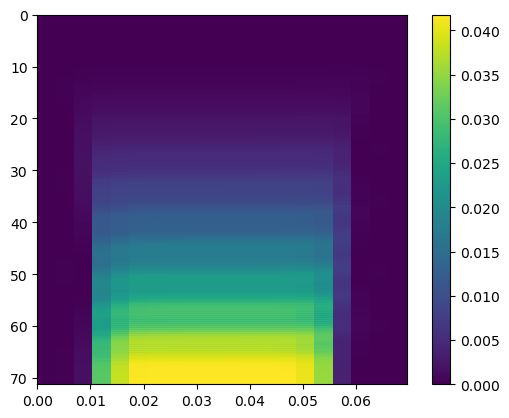

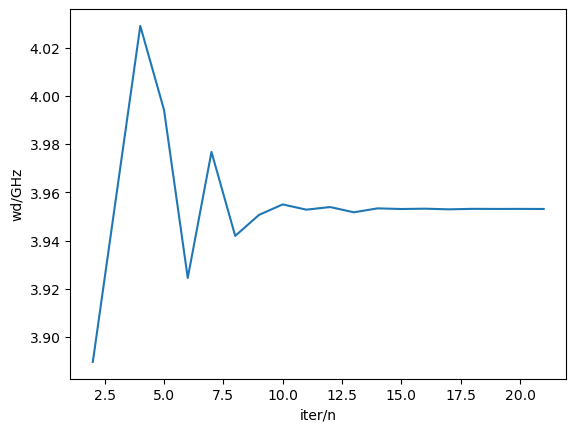

dpi=0.009765153293699322MHz,w_match=3.953098412545402GHz 
 auto_scan_scope end


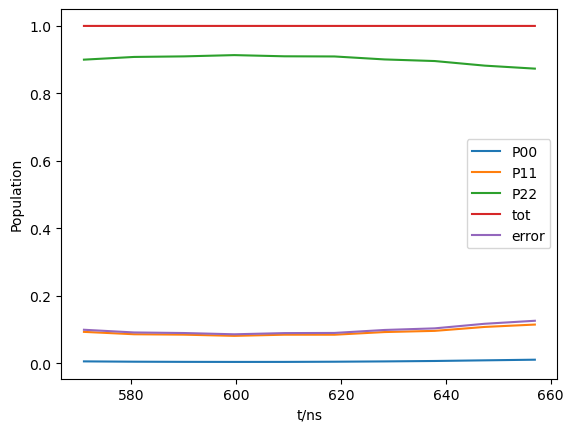

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3487274087123134]
auto_scan_scope start 
 sp=1
T for scan:75.41696344222972
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,



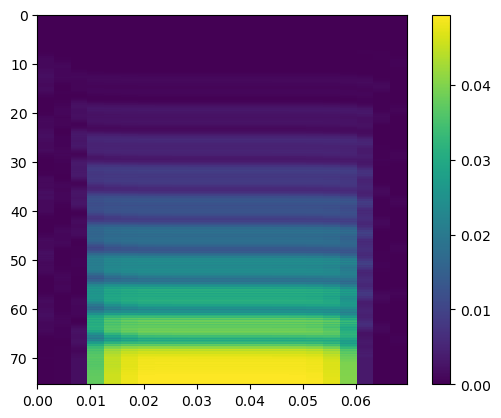

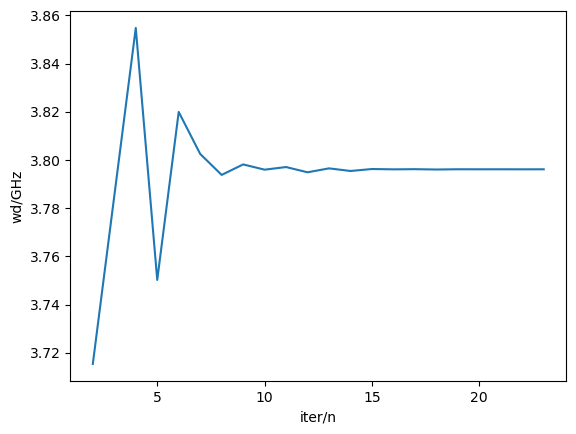

dpi=0.003609003228920927MHz,w_match=3.796113247449048GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,



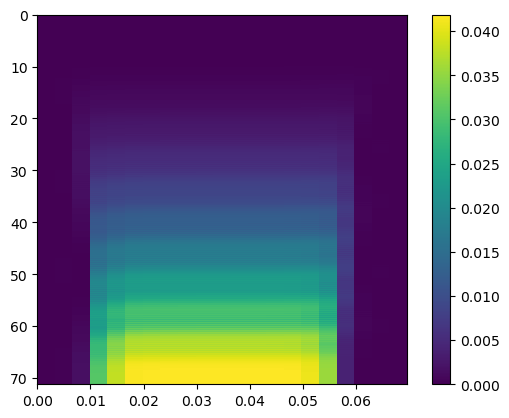

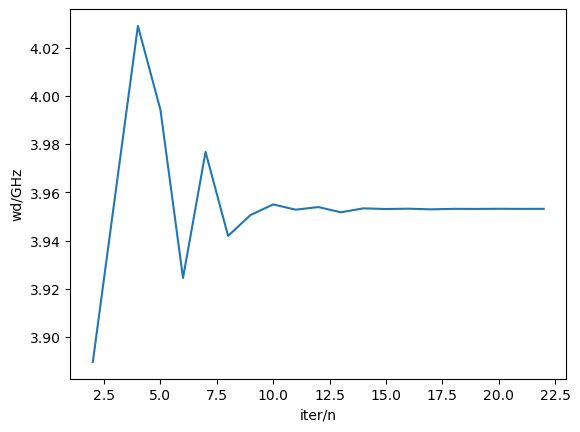

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


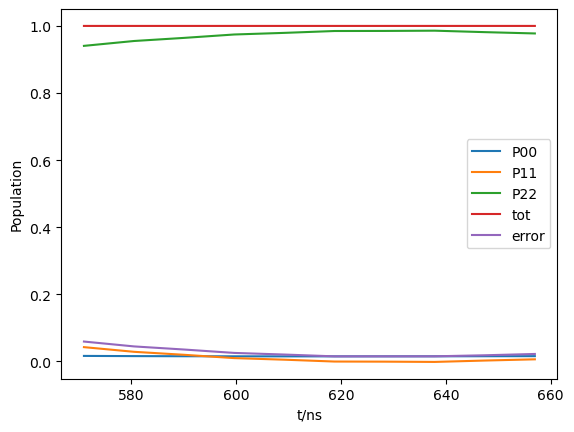

run end
22,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3517262930624193]
auto_scan_scope start 
 sp=1
T for scan:74.47600117643827
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,



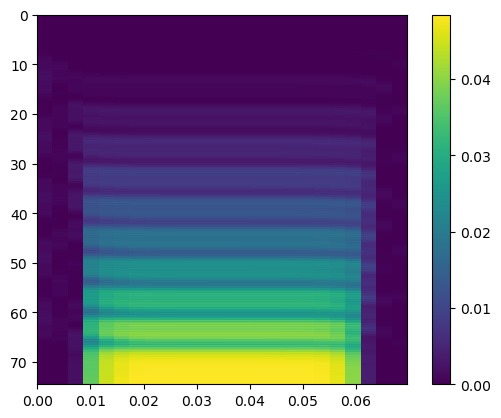

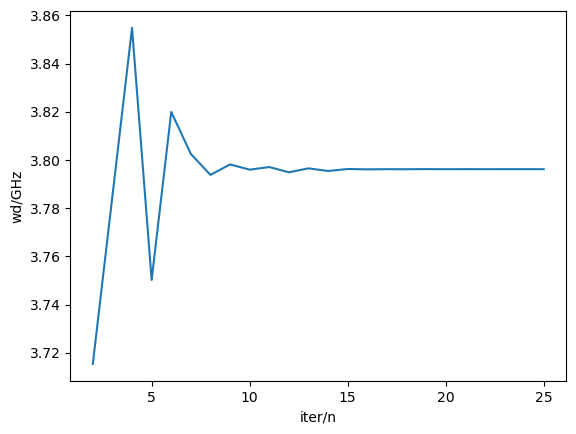

dpi=0.0036713414289025158MHz,w_match=3.796155792007192GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,



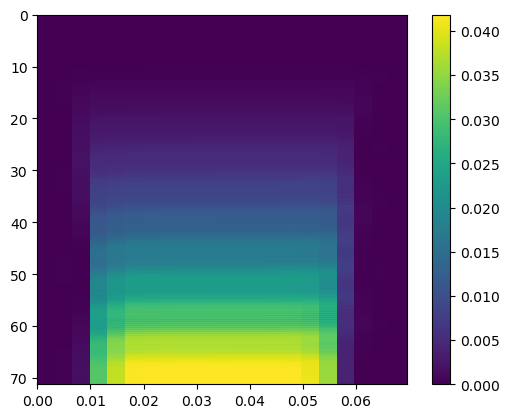

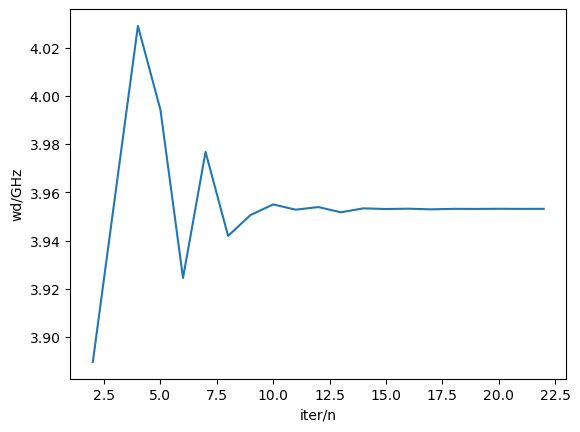

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


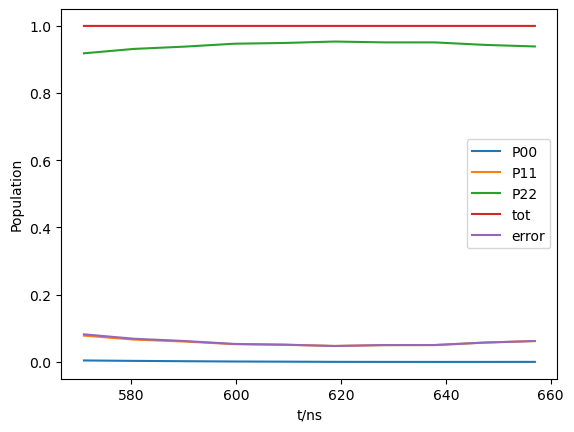

run end
22,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.34572852436220747]
auto_scan_scope start 
 sp=1
T for scan:76.38251776043823
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,



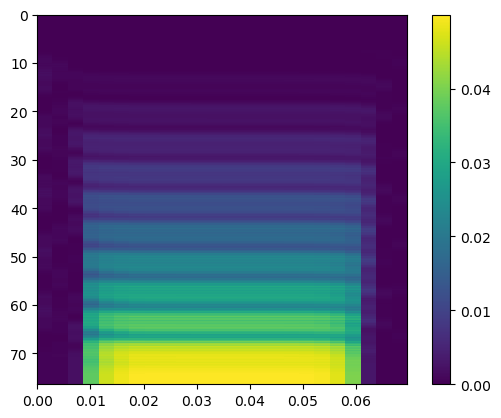

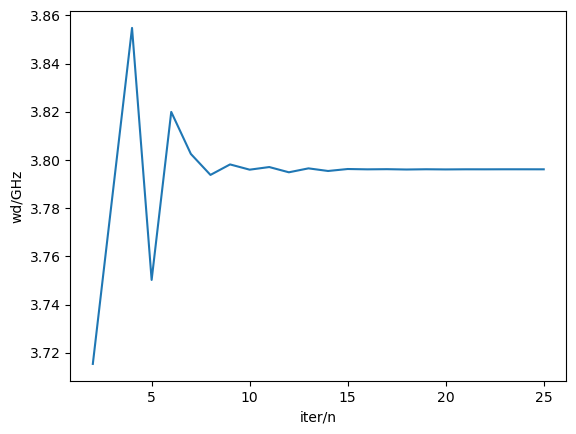

dpi=0.0035471988116914754MHz,w_match=3.7961089929932332GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



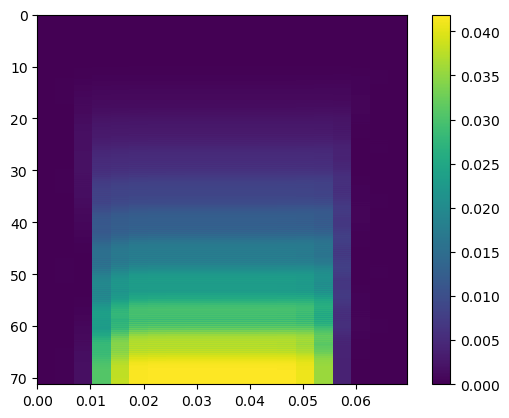

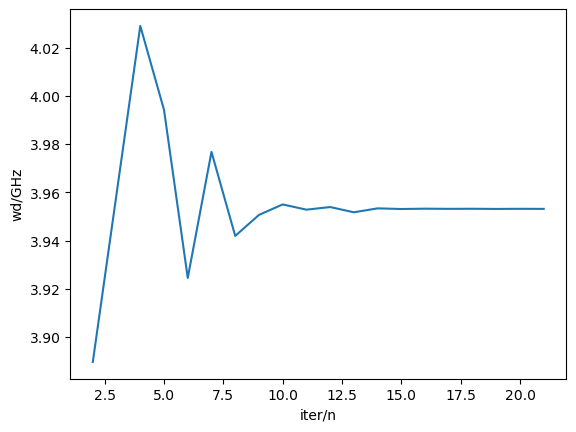

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


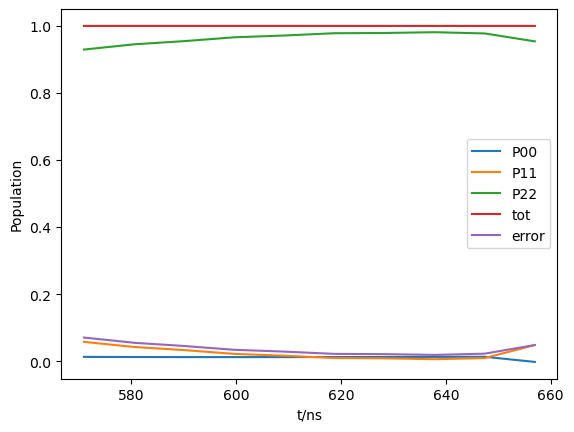

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3472279665372604]
auto_scan_scope start 
 sp=1
T for scan:75.89661343991457
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,



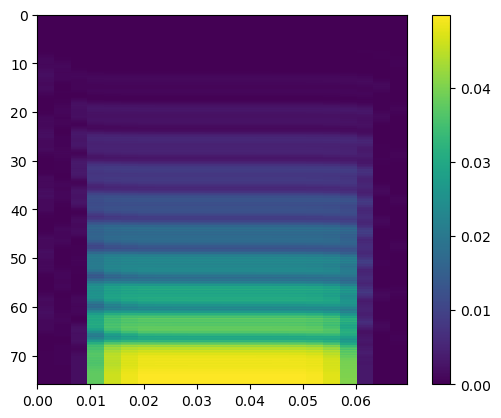

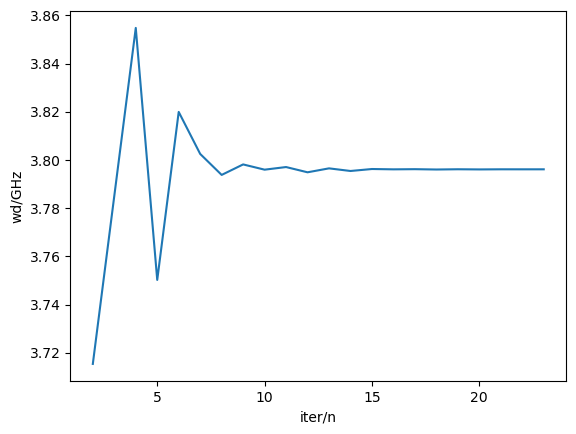

dpi=0.003578034297462184MHz,w_match=3.7961047385374185GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



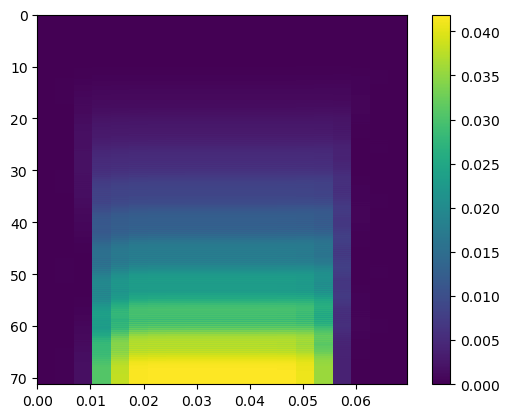

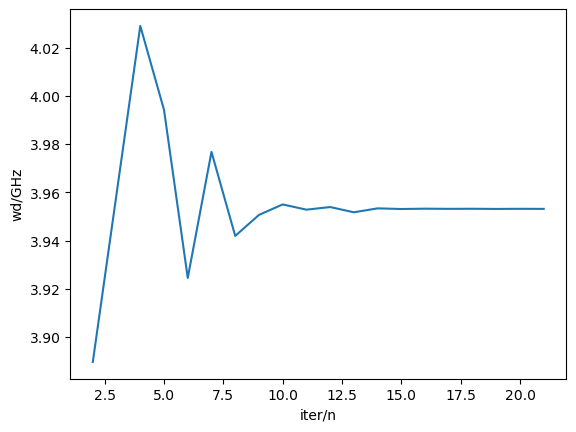

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


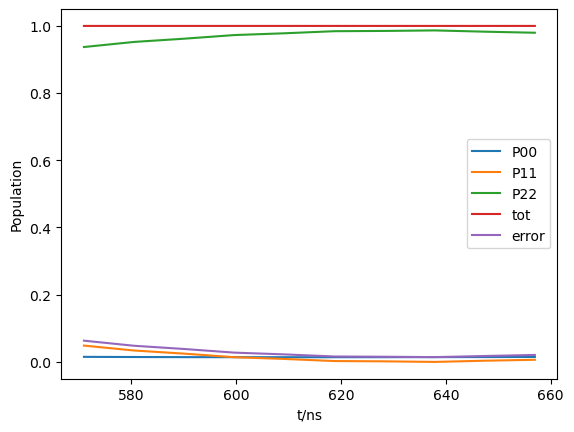

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3479776876247869]
auto_scan_scope start 
 sp=1
T for scan:75.65601338456507
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,



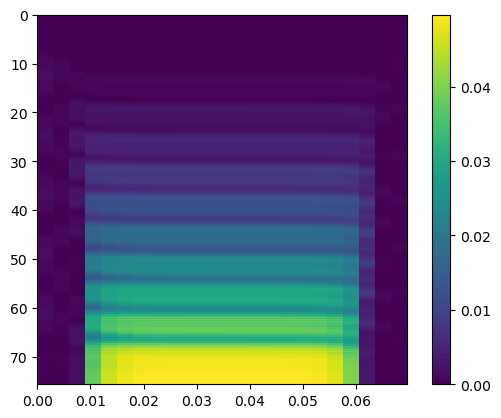

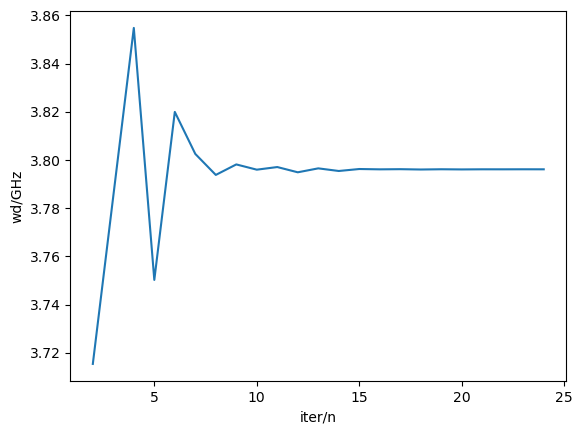

dpi=0.003593502082480551MHz,w_match=3.7961047385374185GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



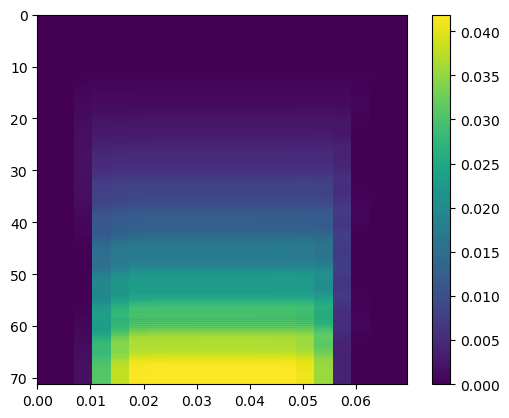

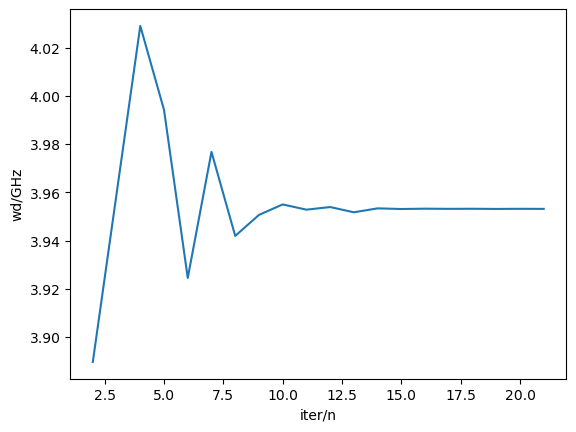

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


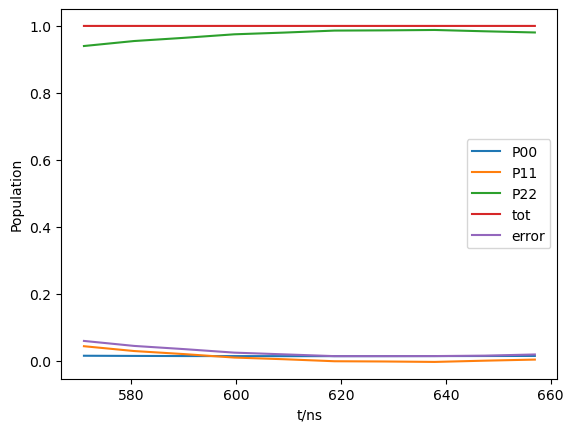

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.34647824544973393]
auto_scan_scope start 
 sp=1
T for scan:76.13877703952684
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,



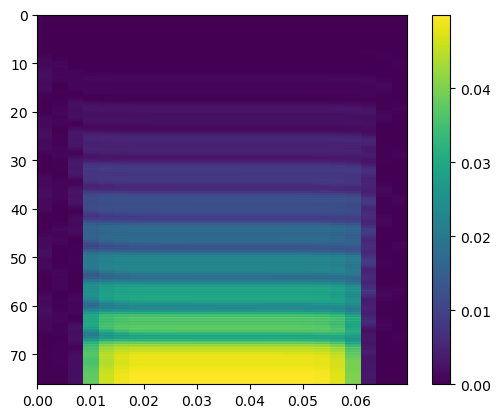

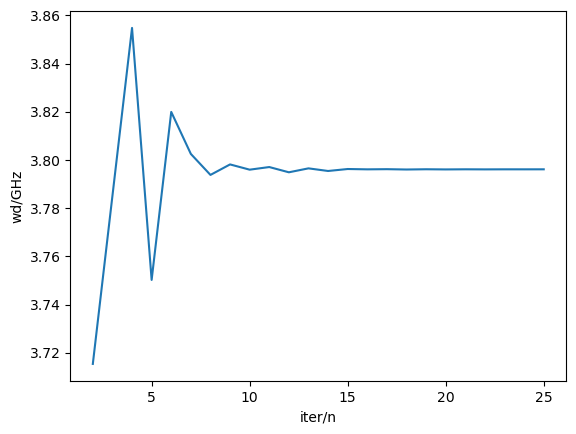

dpi=0.0035625998738658252MHz,w_match=3.7961047385374185GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



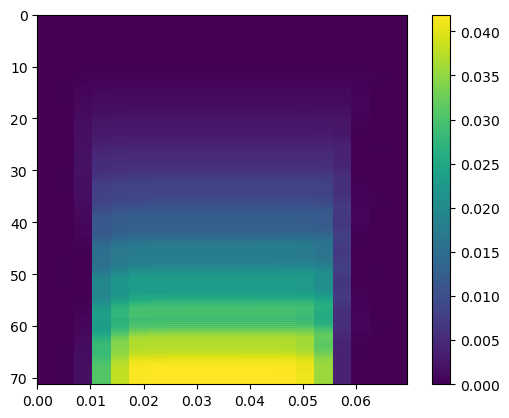

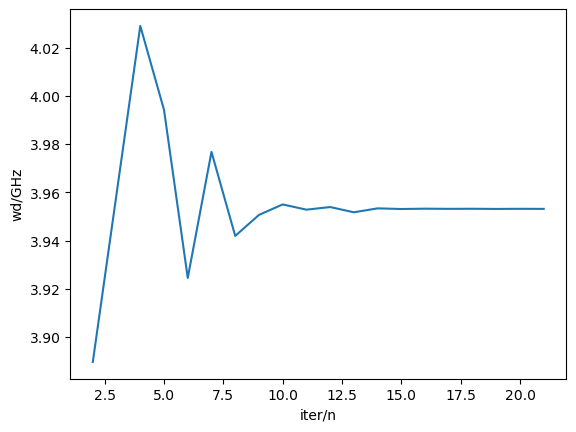

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


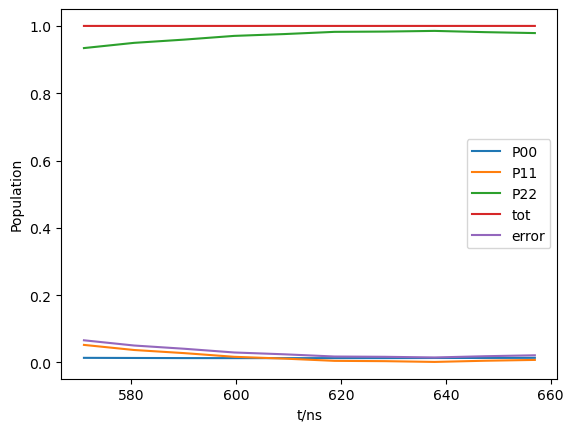

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3476028270810237]
auto_scan_scope start 
 sp=1
T for scan:75.77611881205482
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,



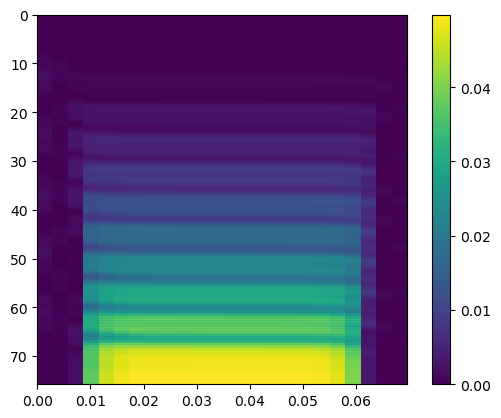

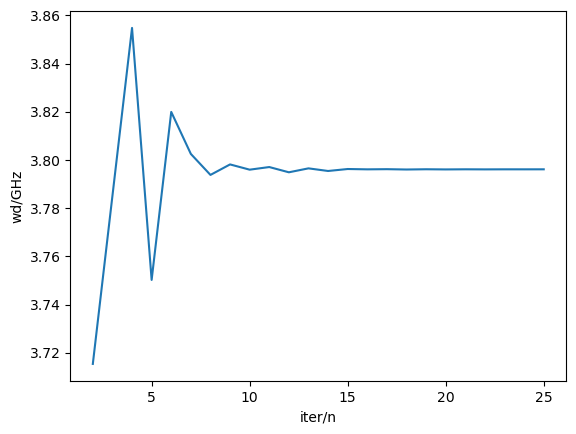

dpi=0.0035857640197936164MHz,w_match=3.7961047385374185GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



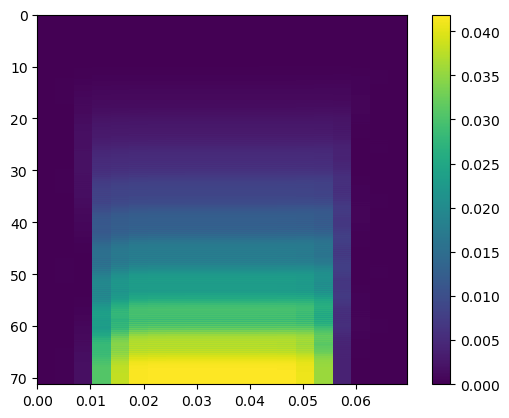

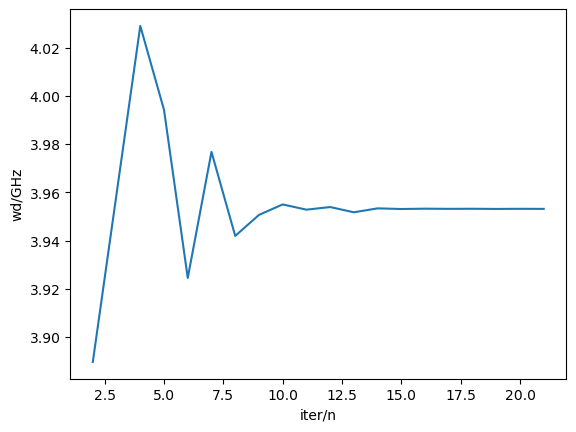

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


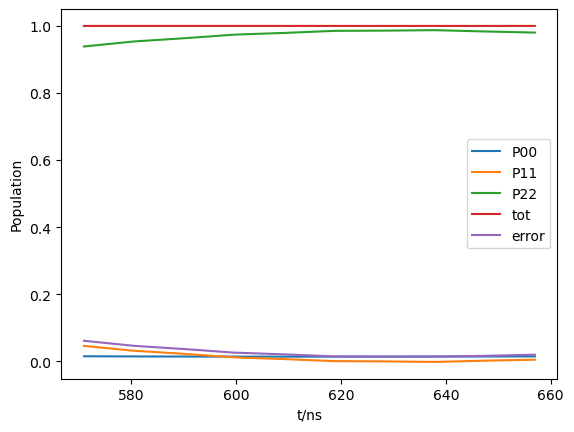

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.34685310599349717]
auto_scan_scope start 
 sp=1
T for scan:76.01749895156217
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,



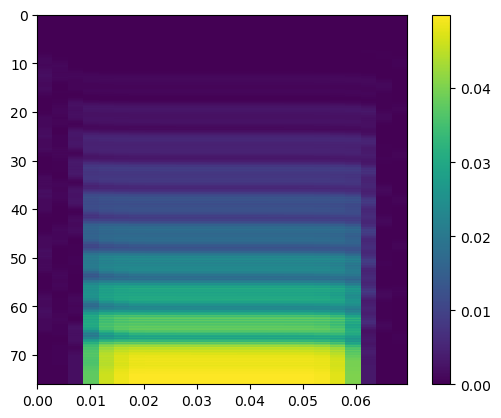

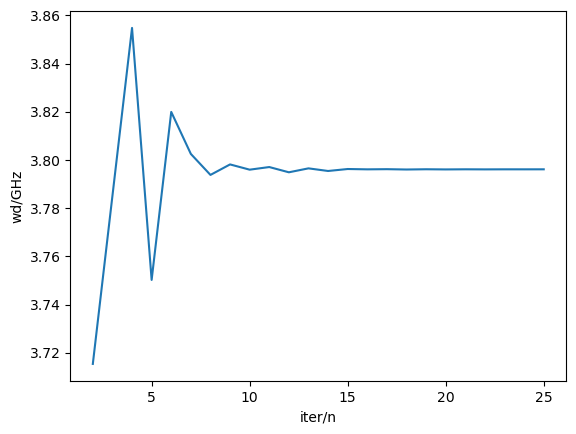

dpi=0.0035703129154862527MHz,w_match=3.796100484081604GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



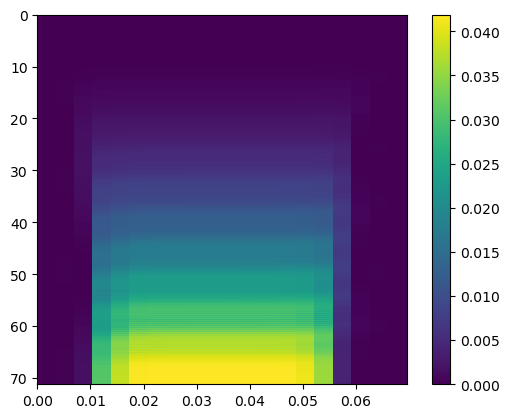

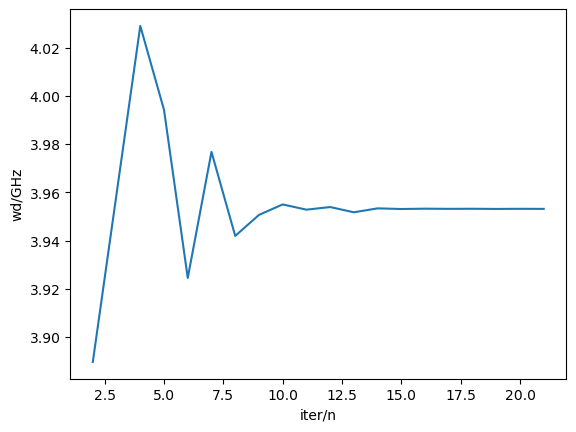

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


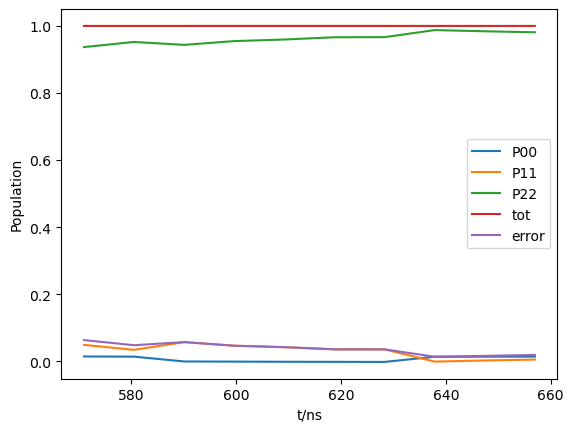

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3470405362653788]
auto_scan_scope start 
 sp=1
T for scan:75.95700722969605
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,



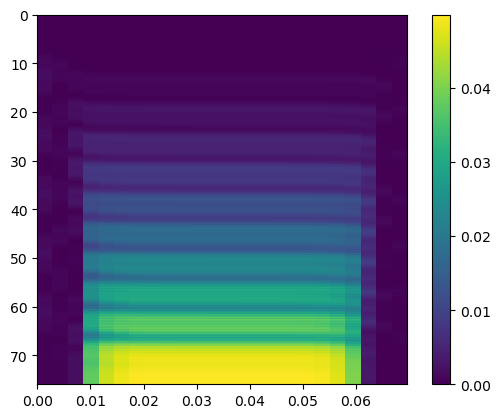

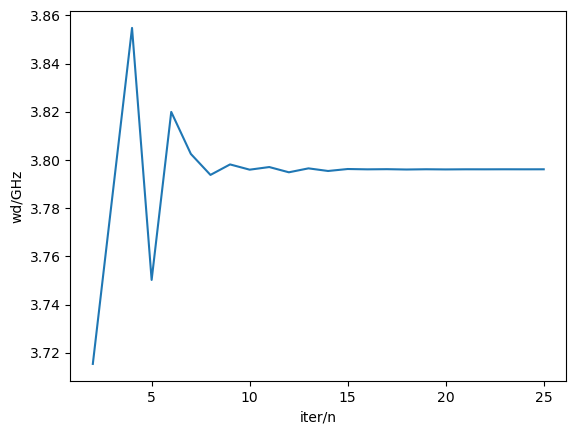

dpi=0.0035741725639297805MHz,w_match=3.7961089929932332GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



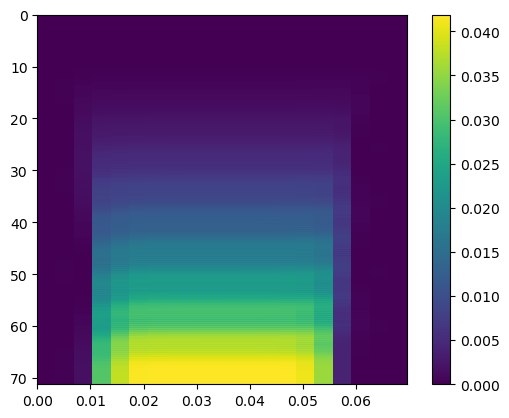

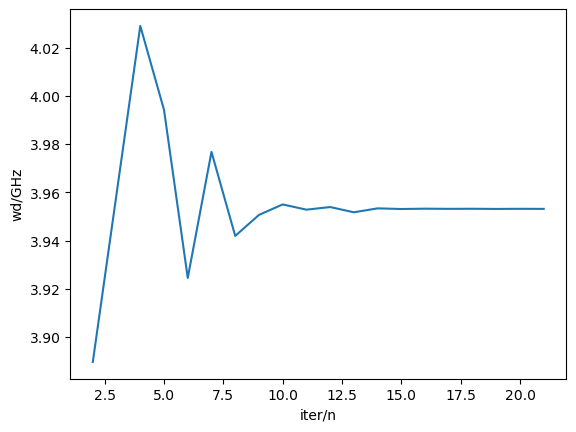

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


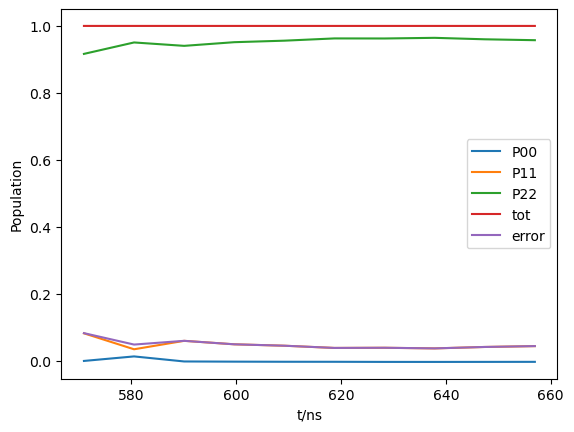

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.34666567572161555]
auto_scan_scope start 
 sp=1
T for scan:76.07808881736425
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,



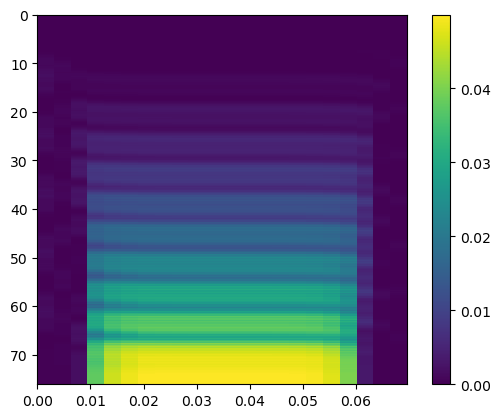

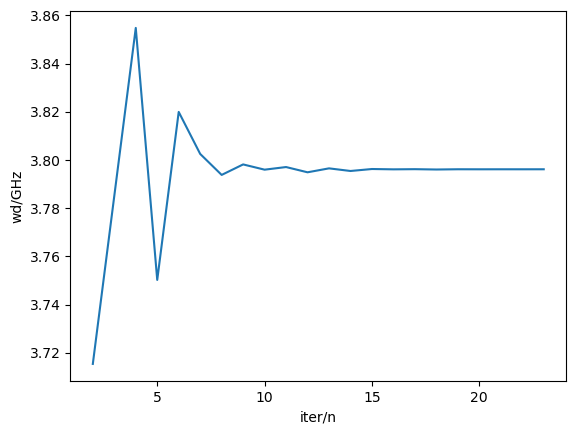

dpi=0.003566455352131601MHz,w_match=3.7961175019048623GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



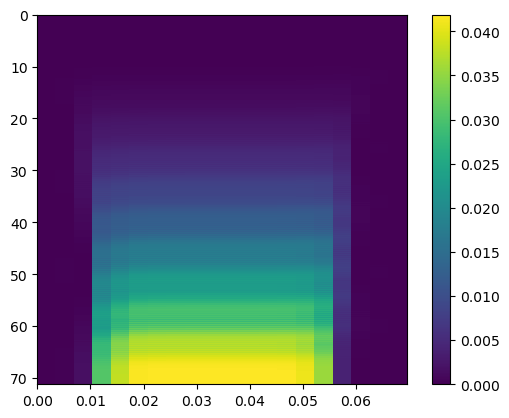

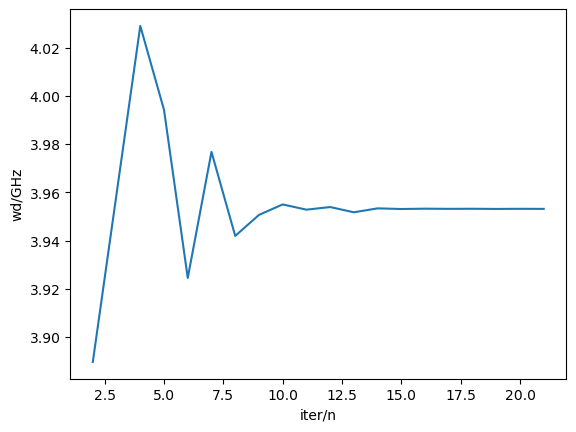

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


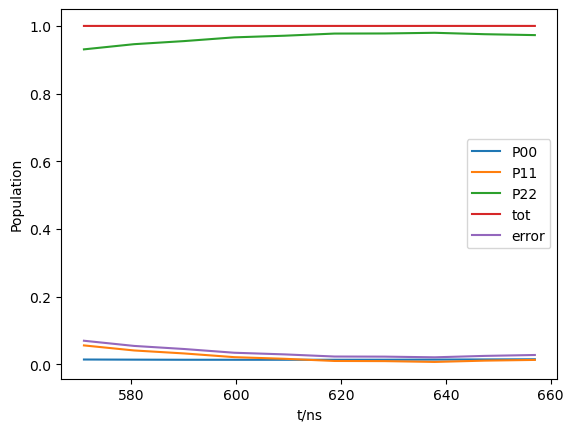

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.34675939085755636]
auto_scan_scope start 
 sp=1
T for scan:76.04778160320812
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,



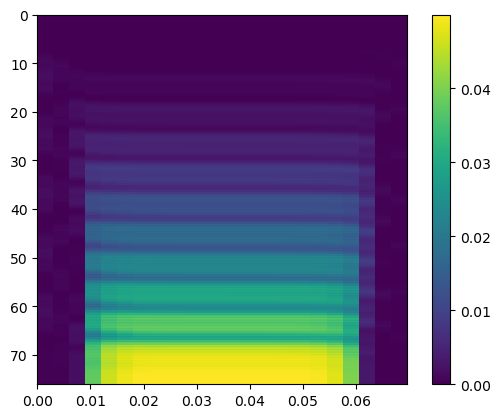

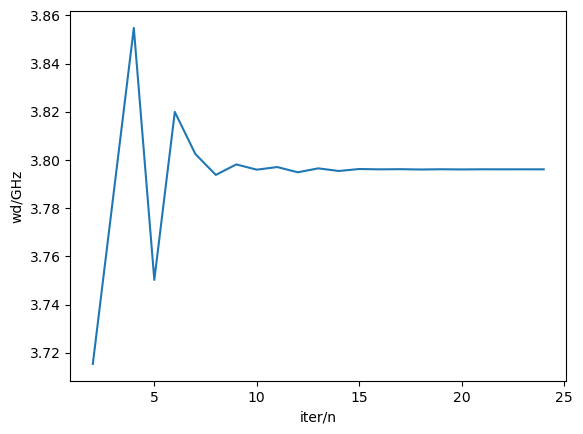

dpi=0.003568383873172818MHz,w_match=3.796100484081604GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



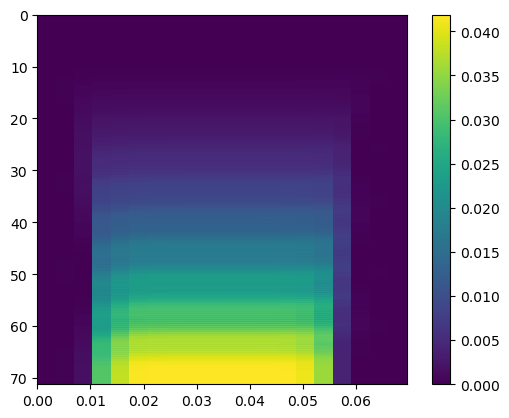

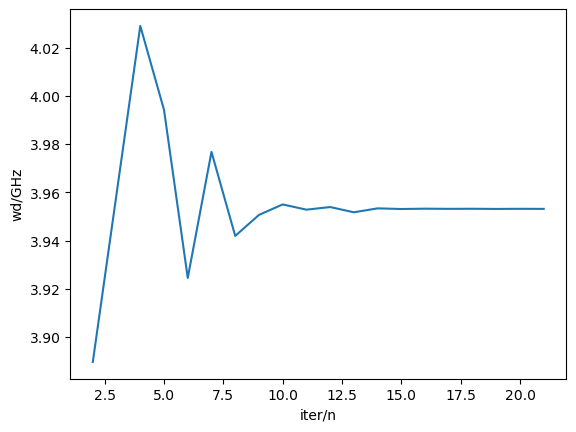

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


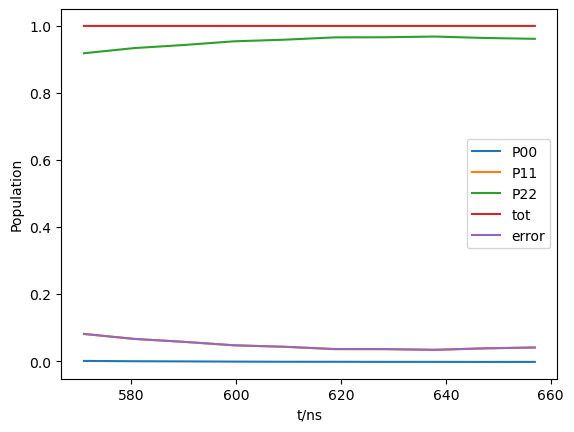

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.346946821129438]
auto_scan_scope start 
 sp=1
T for scan:75.98724083589121
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,



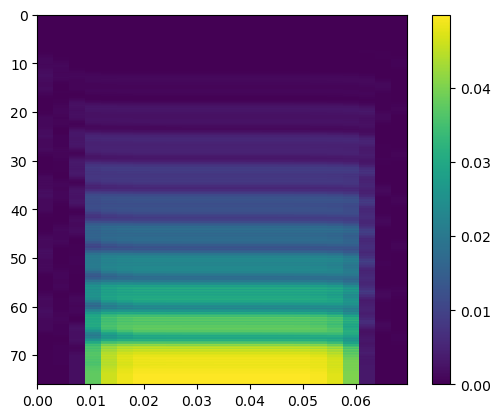

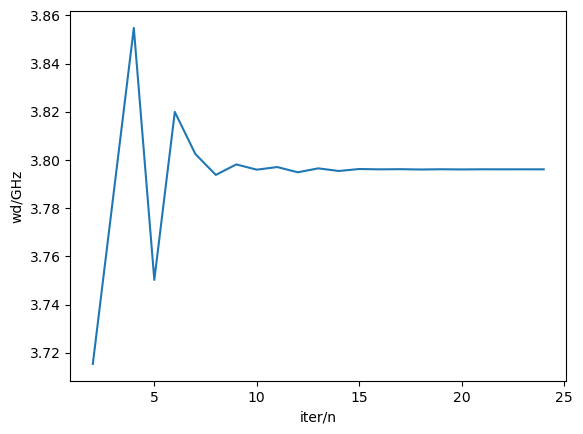

dpi=0.003572242479071908MHz,w_match=3.796100484081604GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



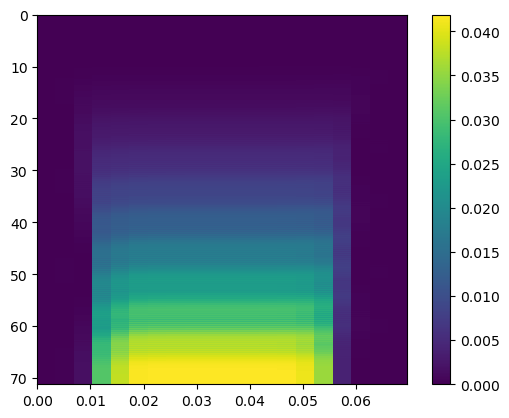

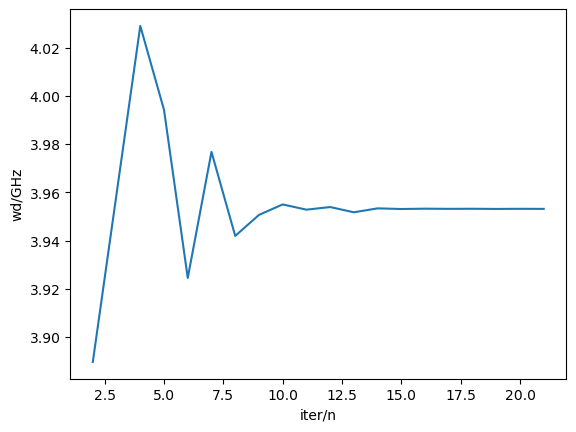

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


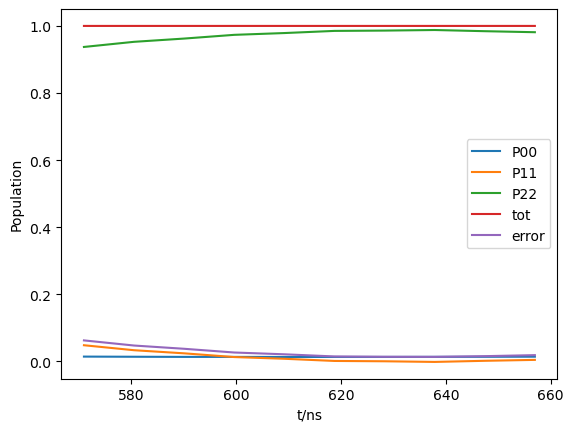

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.3468999635614676]
auto_scan_scope start 
 sp=1
T for scan:76.00236682838687
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,



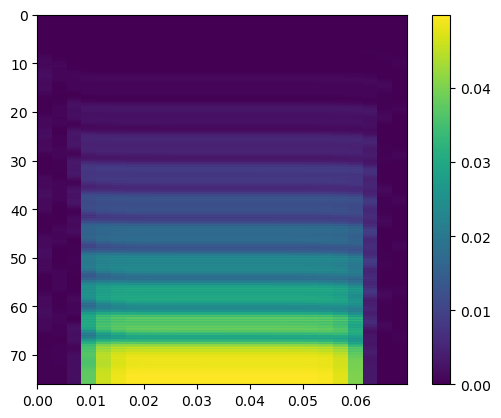

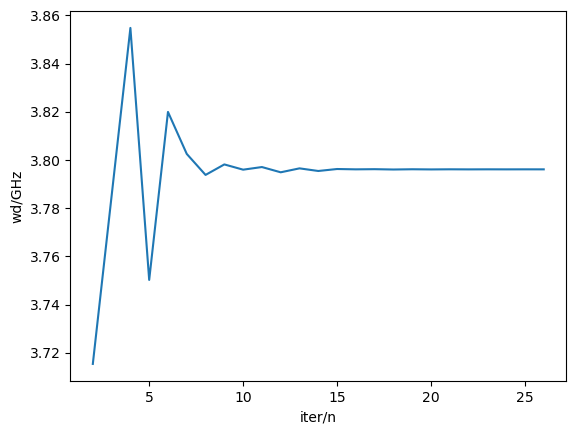

dpi=0.003571277632120053MHz,w_match=3.7960919751699755GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



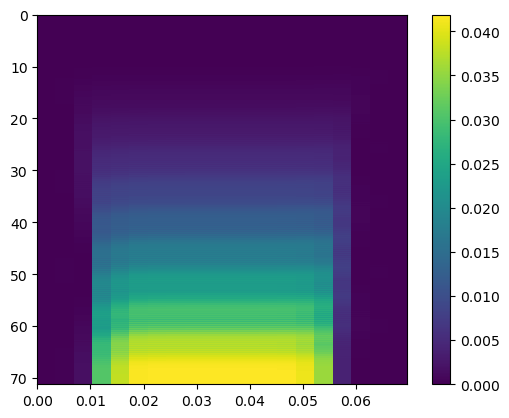

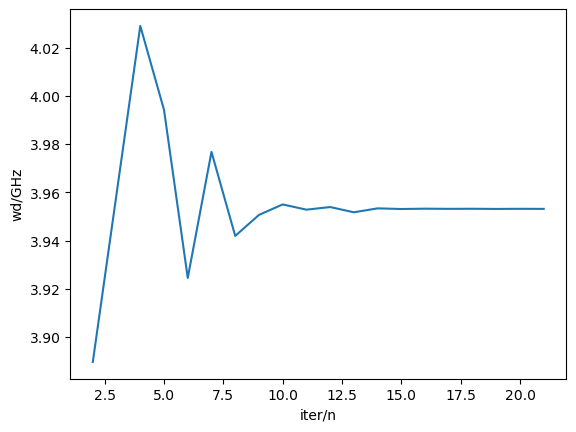

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


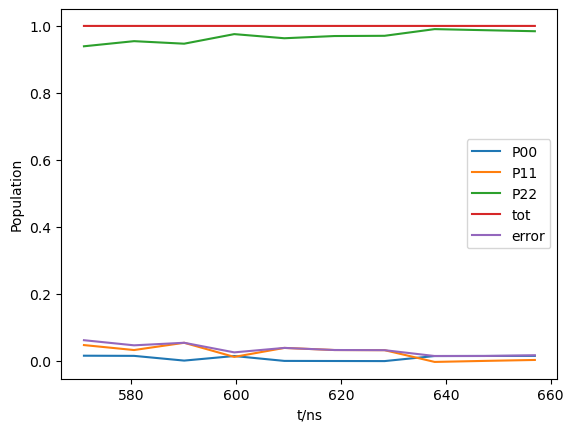

run end
21,auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.34680624842552676]
auto_scan_scope start 
 sp=1
T for scan:76.03263720873068
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,



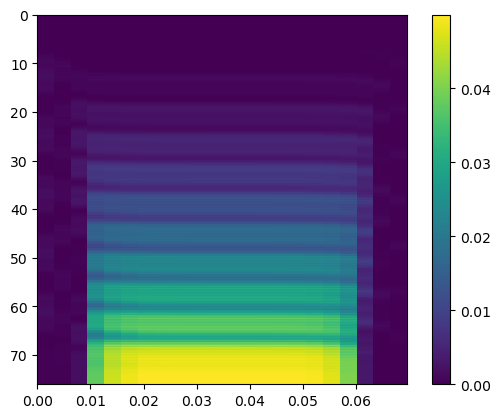

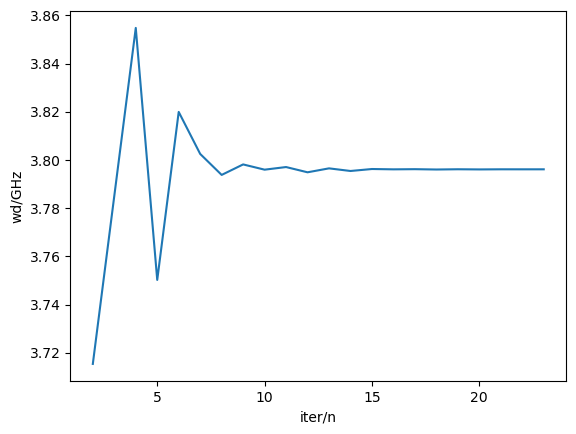

dpi=0.0035693483291705072MHz,w_match=3.7961047385374185GHz 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:71.20247321899292
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,



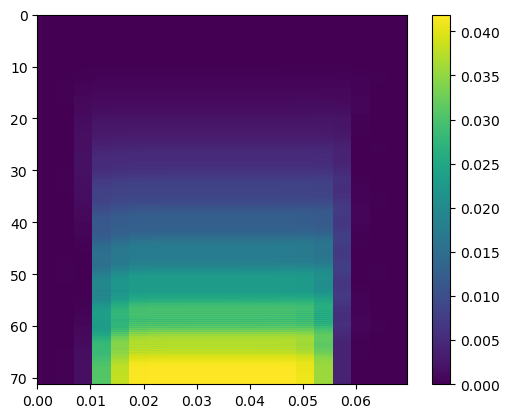

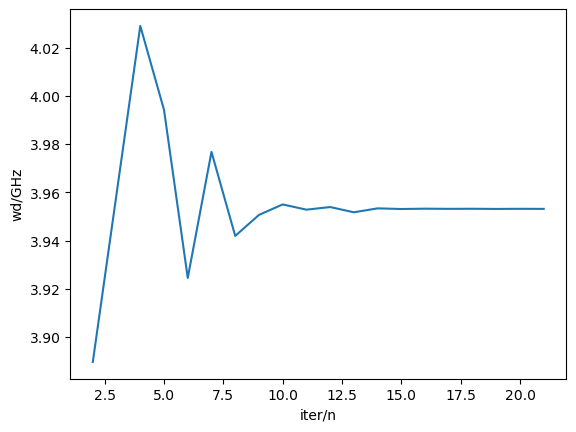

dpi=0.009765153293699322MHz,w_match=3.9531324481919174GHz 
 auto_scan_scope end


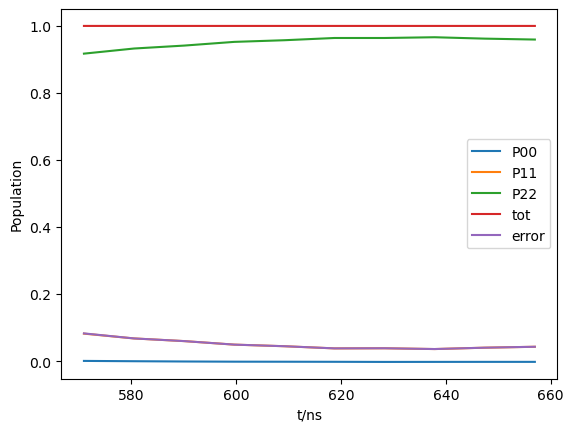

run end


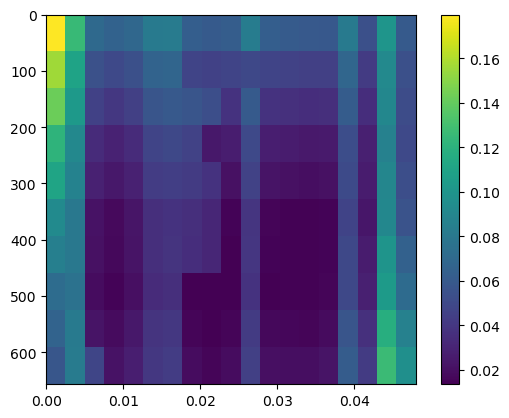

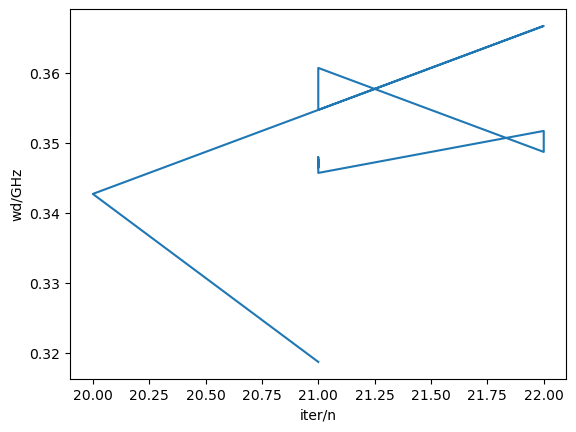

dpi=0.0005,sp_match=[1, 0.34685310599349717],T=637.8634001588543 
 auto_scan_scope end


In [19]:
# wdm=(5.956000029067557+5.731319558030517)/2
# wd=[wdm ,5.731319558030517 ]#single wave
# 5.738450530011672 
# wd=[5.956000029067557 ,5.731319558030517 ]#single wave
wd=[5.960313438079269 ,5.738864629361385 ]#mix wave,single swap 11-22,sp=[1,1]，T~~140ns
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
# wd=[5.9550457117450755,5.738864629361385 ]#mix wave,in-step swap[1,1]
a=sideband( level=4, t_edge=10,  w=[5,3],        yita=[0.25,0.25],  g=[0.15],
            L=1000,  wd=wd,     phid=[0,0],     amp=0.3,         sp_direct=[1, 0.39920692123873897],
            rho0=0,  arrow_ideal=[0,0,1])
# res=a.run(plot=True,norm_plot=True)
# res=a.run_fin(10,300,30,True)
# coeff=a.wd_fit(res,1)
# a.auto_scan_scope(sp=1,runplot=True)
# auto_result=a.auto_scan_mix_wave_wd_sp(amp=0.3,sp_direct=[1, 0.35],correct=3.5,dom=0.5)#,runplot=True)
# a.d_eff_g
auto=a.auto_opti_sp_direct(0.3,[1,0.35],correct=4.5,)




auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.39920692123873897]
3.9593269358577157,3.9593269358577157,0.004882576646849661
auto_scan_scope start 
 sp=1
T for scan:125.72039439177466
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,

dpi=0.004729456439096499MHz,w_match=3.796619527690964GHz 
 auto_scan_scope end
run start


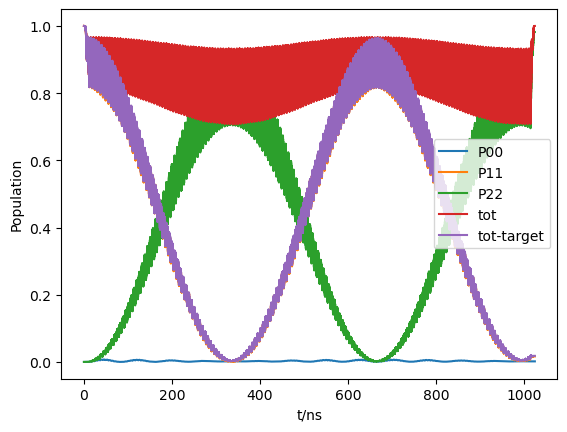

run end
wd_fit start 
 sp=1
correct!=1


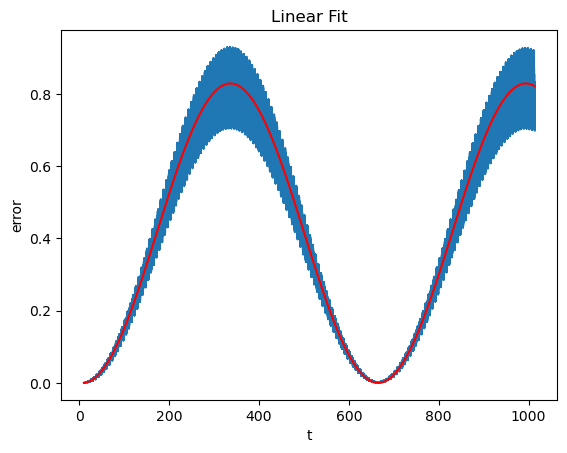

guess value of [d_eff,F,t0]=[0.0016832439316309664, 1, 5.0]
fit coeff [d_eff,F,t0,T]=[0.001520263851039864, 0.8290305816302009, 7.227872344136942, 657.7805552082276]
 wd_fit end
auto_scan_scope start 
 sp=0
T for scan:122.40494643798584
iter_num=
1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,

dpi=0.009765153293699322MHz,w_match=3.952979287782598GHz 
 auto_scan_scope end
run start


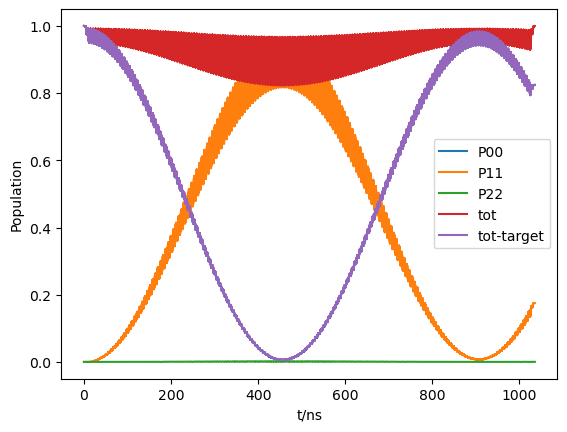

run end
wd_fit start 
 sp=0


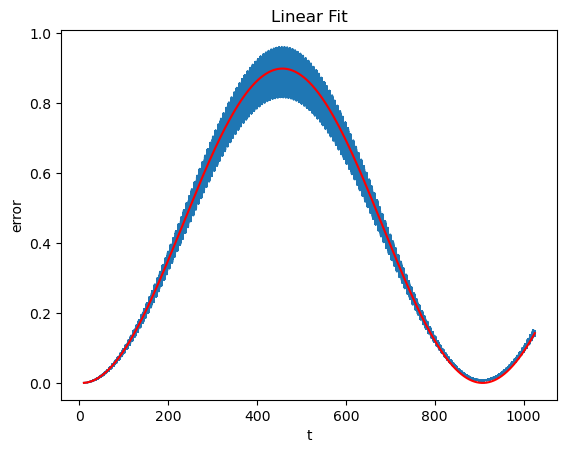

guess value of [d_eff,F,t0]=[0.0009658993341443035, 1, 5.0]
fit coeff [d_eff,F,t0,T]=[0.0011089861512416034, 0.898855028208883, 6.014117908996492, 901.72451556804]
 wd_fit end
run start


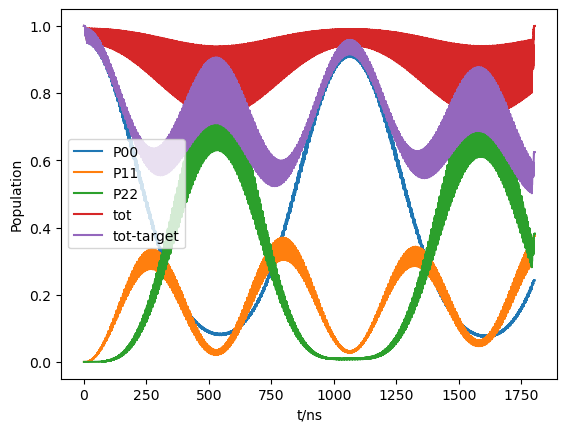

run end


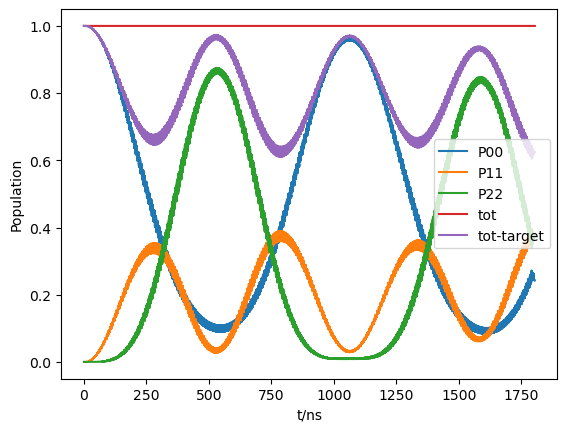

mix_wave_fit start 
 
guess=[0.0009658993341443035, 0.5, 5.0, 1.8660254037844386]
<class 'numpy.ndarray'>


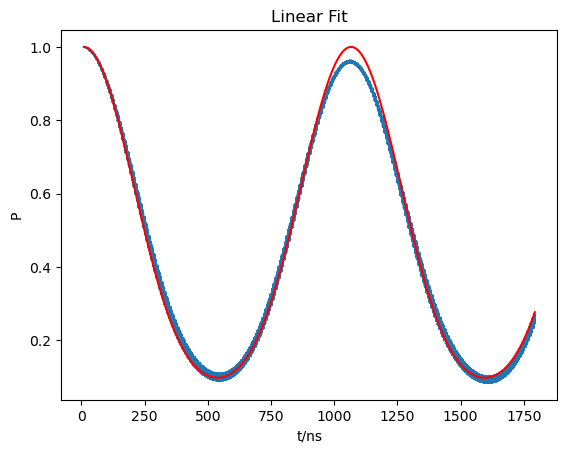

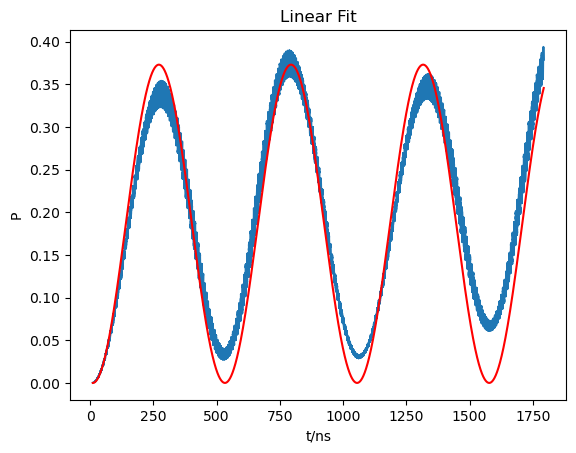

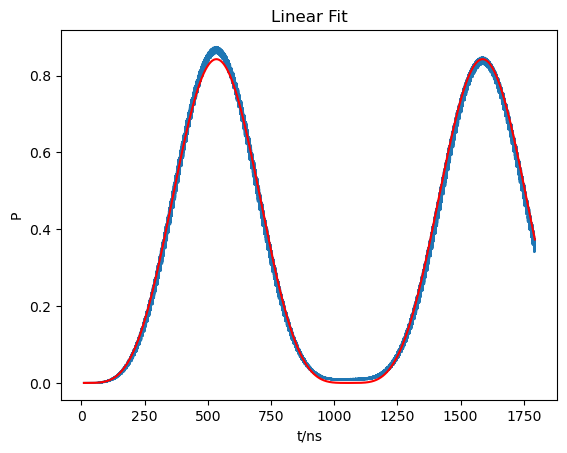

d_eff,F,t0,p2:		guess		coeff
[0.0009658993341443035, 0.5, 5.0, 1.8660254037844386]
[0.0009465184174841176, 0.9999128448106885, 9.999998743783825, 1.3809420148381453]
[0.0009567671217576997, 0.3731311232566058, 9.999999346353734, 1.2961570200093402]
[0.0009497338507260329, 0.21072464087608453, 7.3327487488976955, [1.5209320651725304, 0.6574915625087848]]

 mix_wave_fit end

sp_direct_input=[1, 0.39920692123873897]

p_eff1=1.3708591846145244
suggest set sp_direct1 as:[1, 0.39850247878085504]

p_eff2=1.3809420148381453
suggest set sp_direct2 as:[1, 0.39704499757482764]


In [ ]:
# wdm=(5.956000029067557+5.731319558030517)/2
# wd=[wdm ,5.731319558030517 ]#single wave
# 5.738450530011672 
# wd=[5.956000029067557 ,5.731319558030517 ]#single wave
wd=[5.960313438079269 ,5.738864629361385 ]#mix wave,single swap 11-22,sp=[1,1]，T~~140ns
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
# wd=[5.9550457117450755,5.738864629361385 ]#mix wave,in-step swap[1,1]
a=sideband( level=4, t_edge=10,  w=[5,3],        yita=[0.25,0.25],  g=[0.15],
            L=1000,   wd=wd,     phid=[0,0],     amp=0.3,         sp_direct=[1, 0.39920692123873897],
            rho0=0,  )
# res=a.run(plot=True,norm_plot=True)
# res=a.run_fin(10,300,30,True)
# coeff=a.wd_fit(res,1)
# a.auto_scan_scope(sp=1,runplot=True)
auto_result=a.auto_scan_mix_wave_wd_sp(amp=0.3,sp_direct=[1, 0.39920692123873897],correct=3.5)#,runplot=True)
# a.d_eff_g

auto_scan_mix_wave_wd start
amp=0.3		sp_direct=[1, 0.46617831709480284]
[1, 0]
auto_scan_scope start 
 sp=0
T for scan:110.04671591687448
iter_num=
1,run start


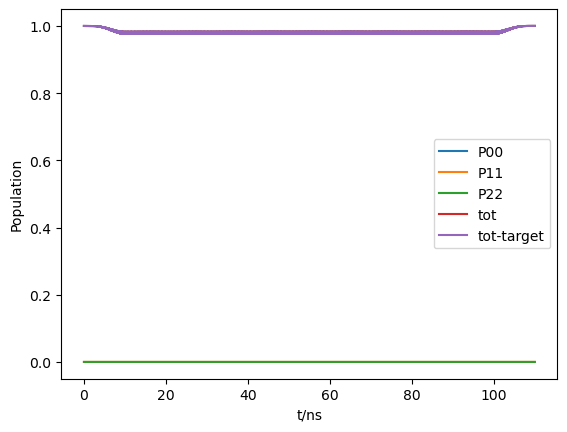

run end
2,run start


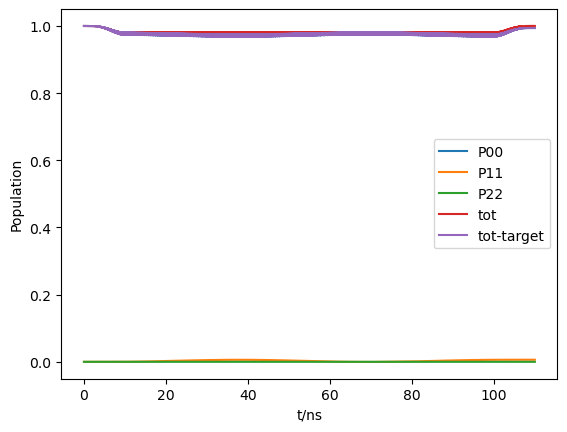

run end
3,run start


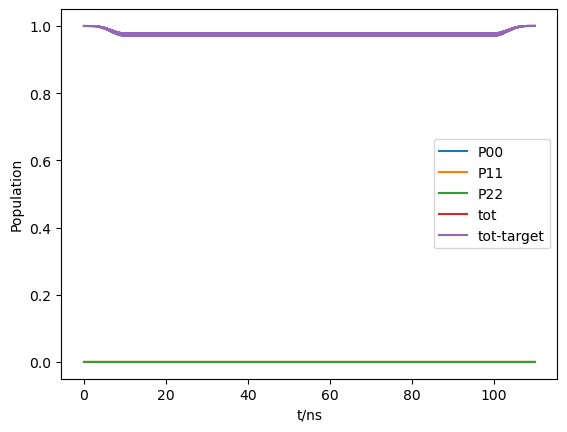

run end
4,run start


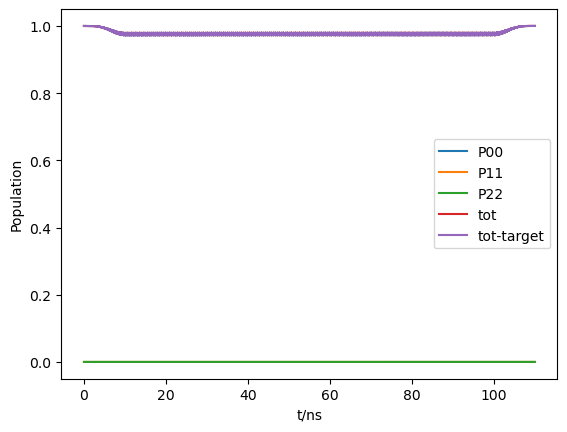

run end
5,run start


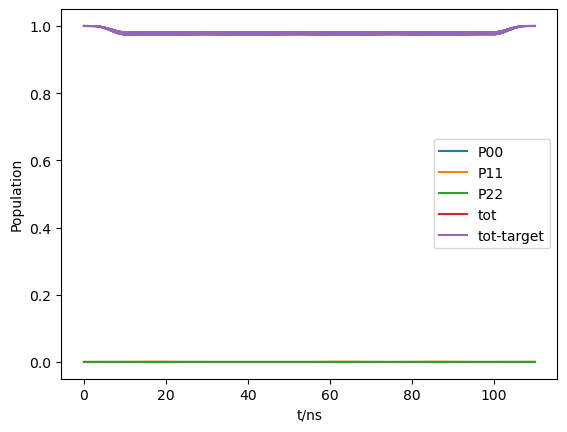

run end
6,run start


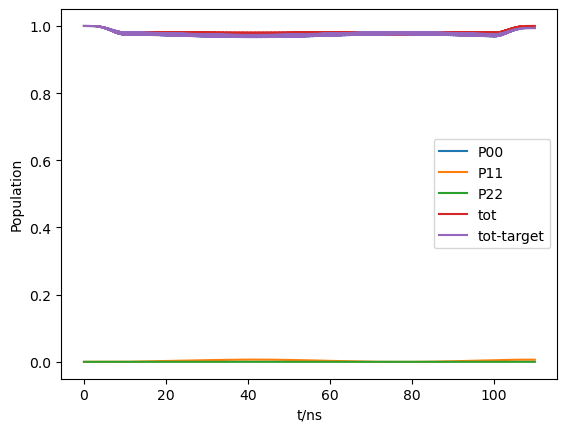

run end
7,run start


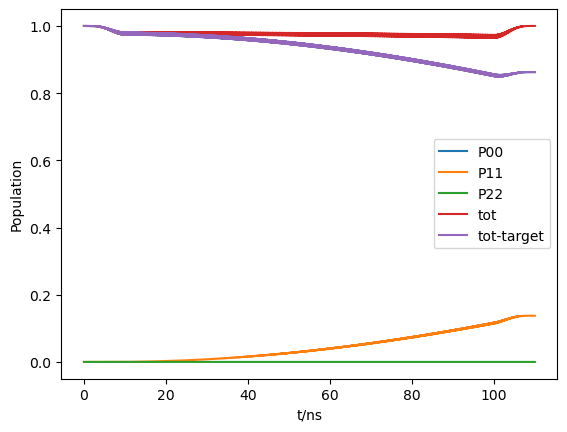

run end
8,run start


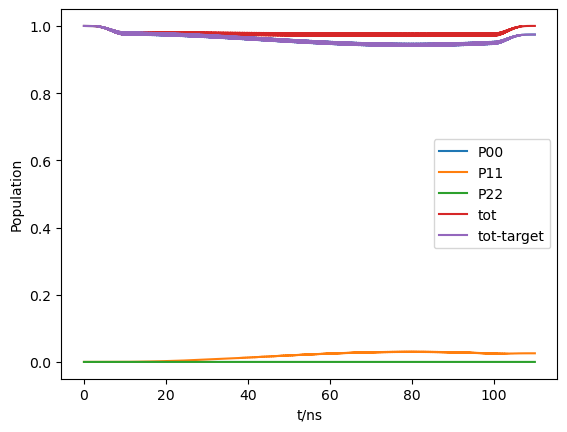

run end
9,run start


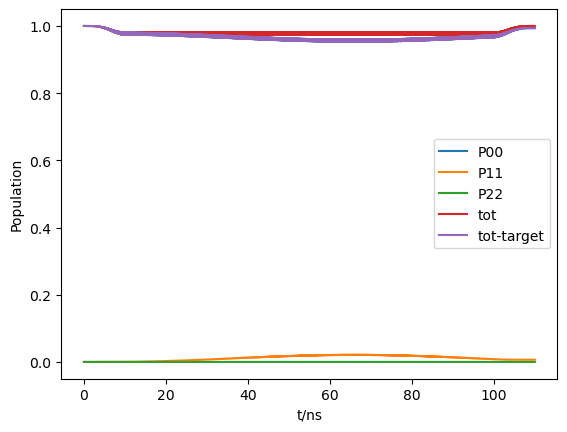

run end
10,run start


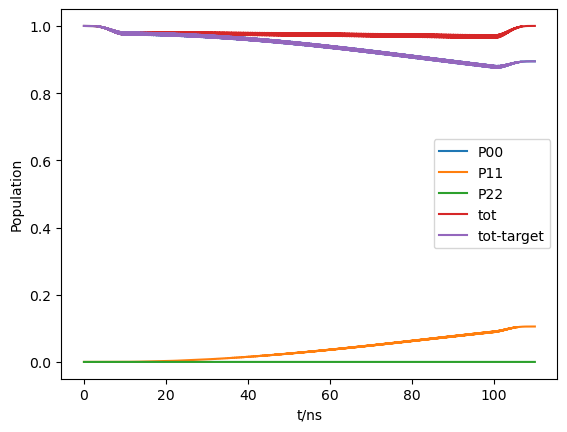

run end
11,run start


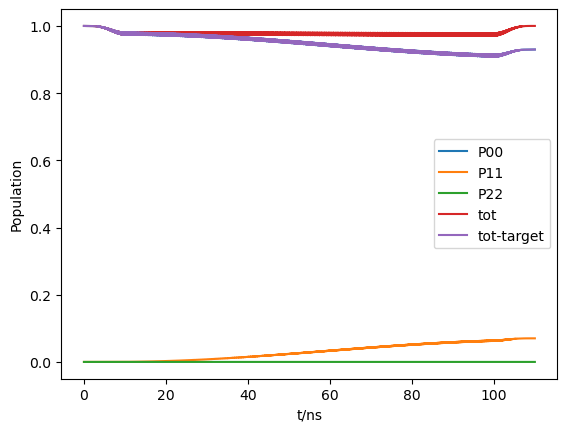

run end
12,run start


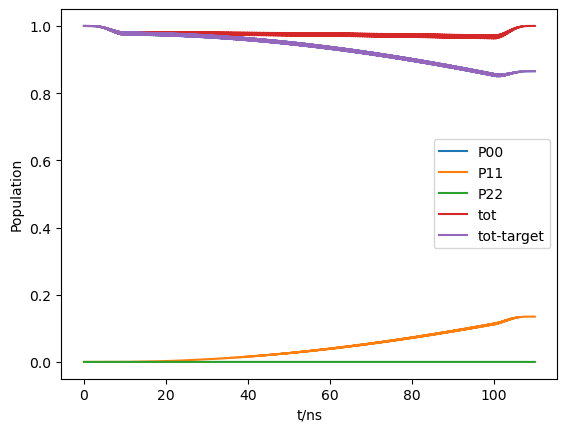

run end
13,run start


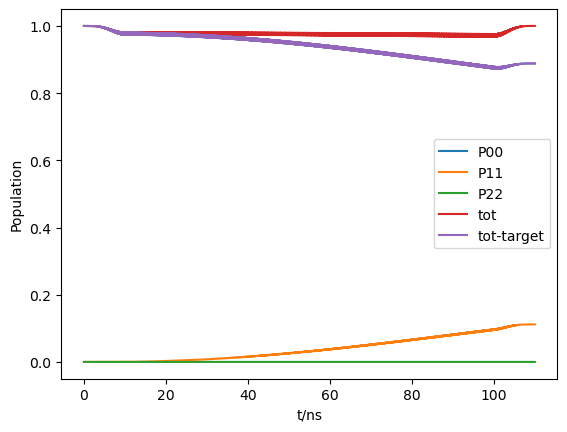

run end
14,run start


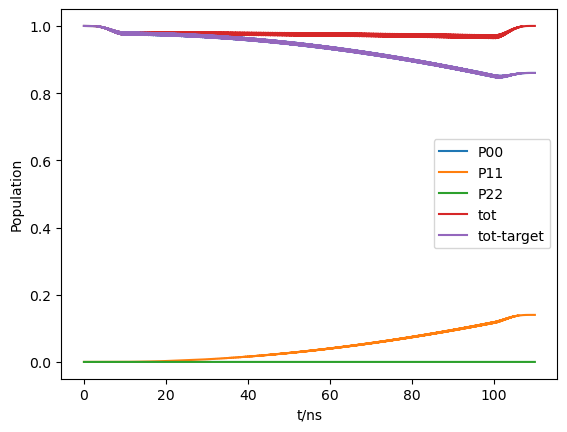

run end
15,run start


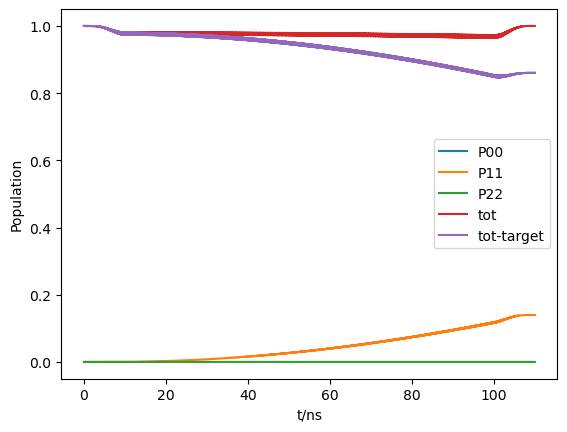

run end
16,run start


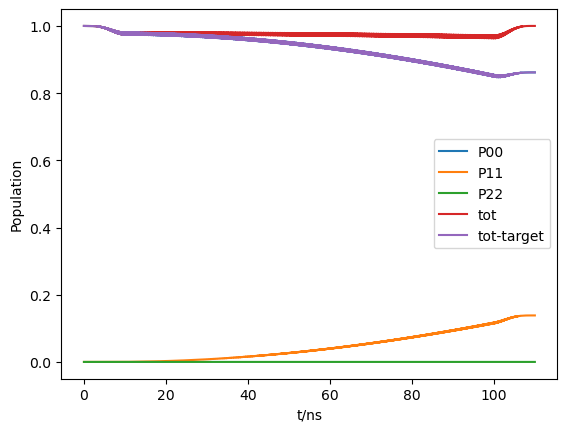

run end
17,run start


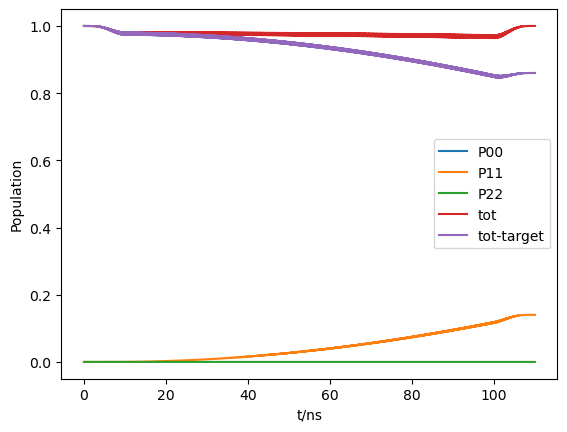

run end
18,run start


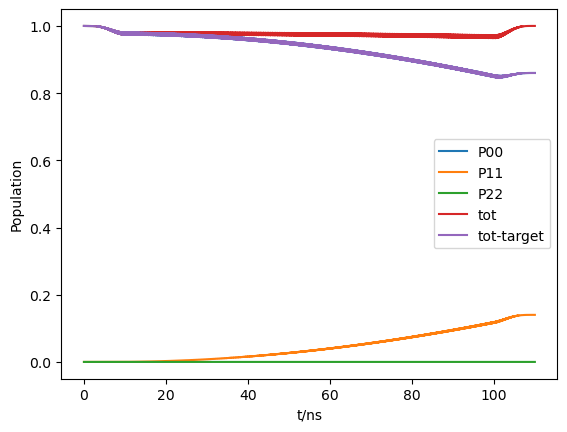

run end




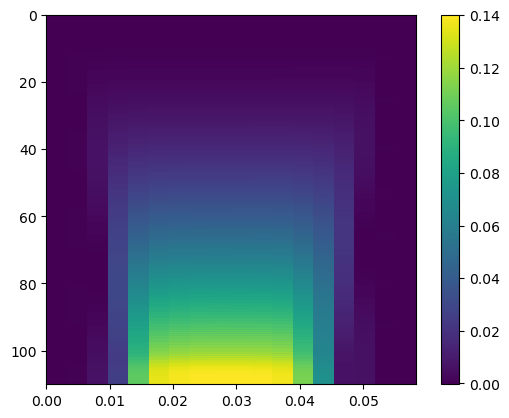

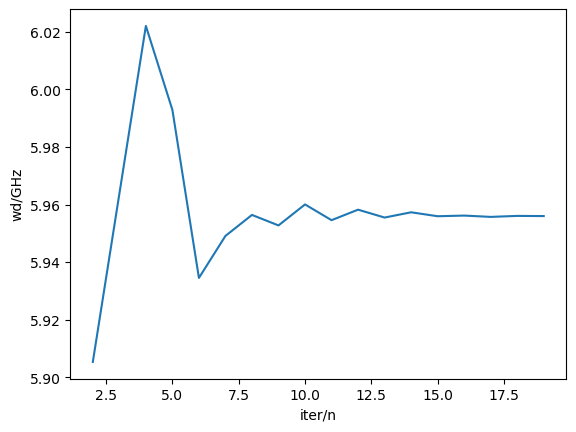

dpi=5.55267335303565e-05,w_match=5.955985846947992 
 auto_scan_scope end
[0, 0.46617831709480284]
auto_scan_scope start 
 sp=1
T for scan:170.7452681099978
iter_num=
1,run start


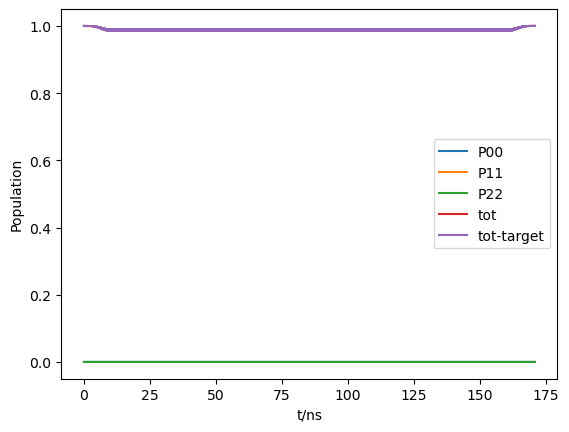

run end
2,run start


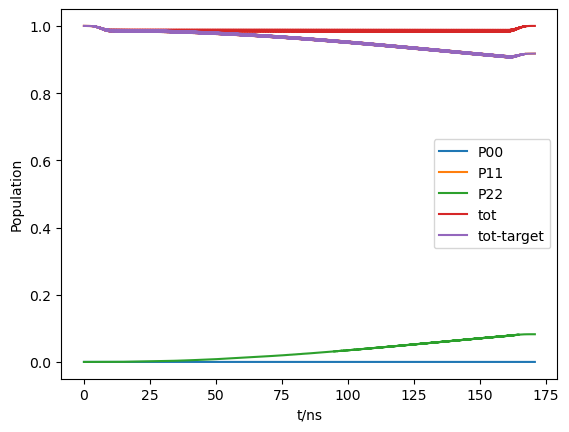

run end
3,run start


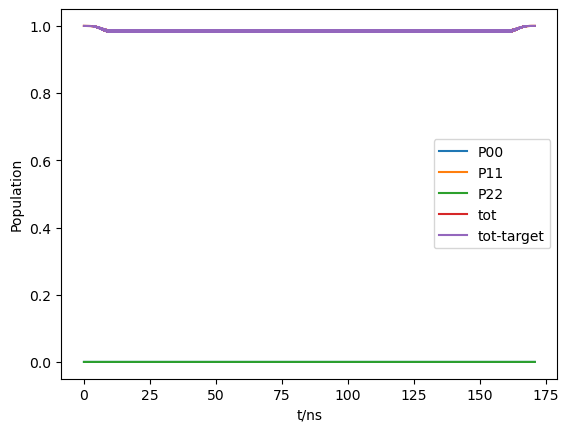

run end
4,run start


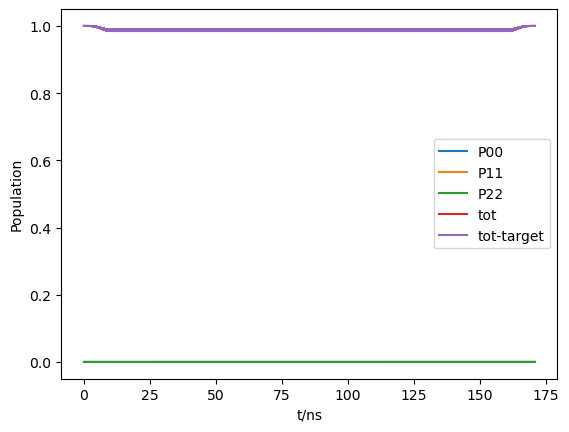

run end
5,run start


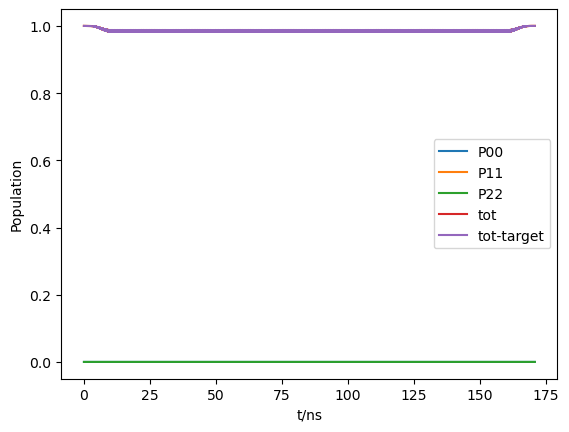

run end
6,run start


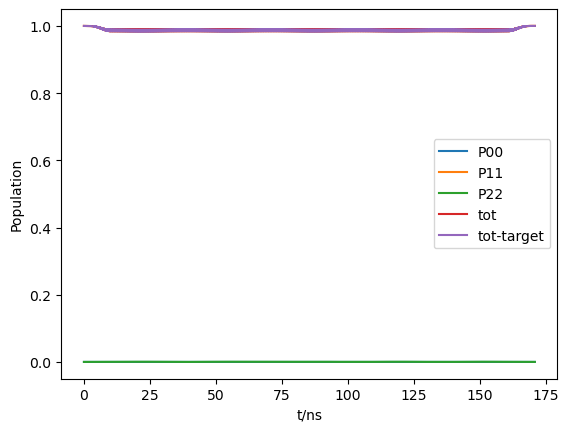

run end
7,run start


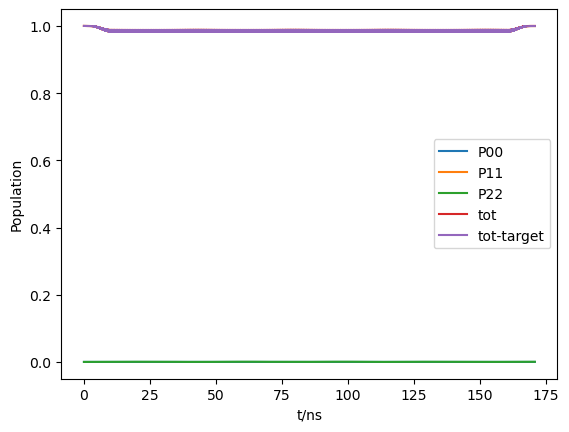

run end
8,run start


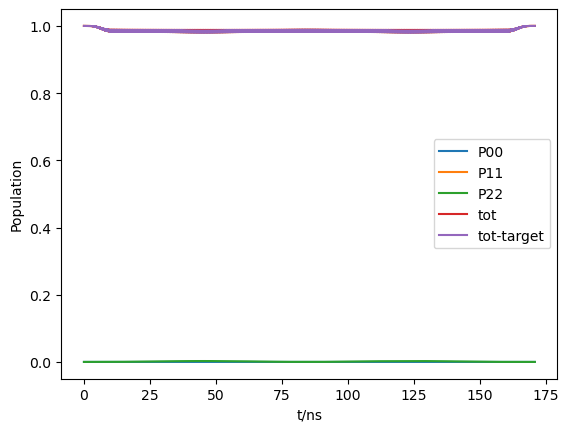

run end
9,run start


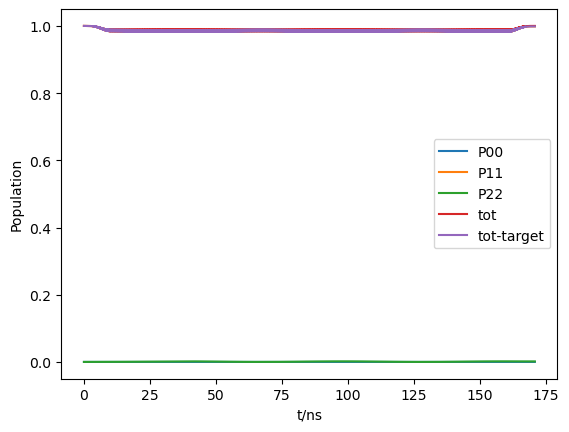

run end
10,run start


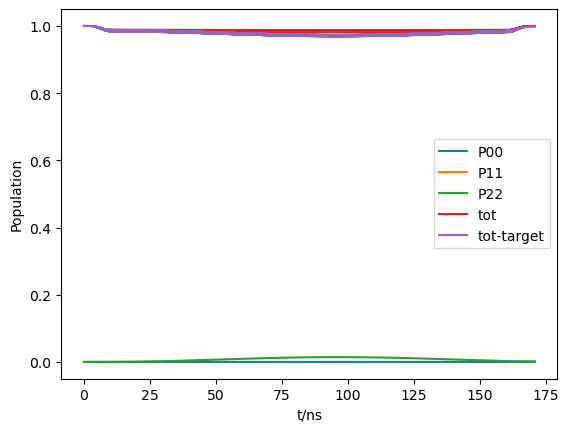

run end
11,run start


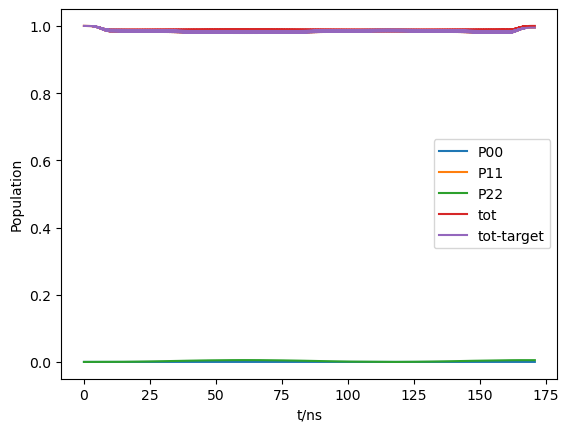

run end
12,run start


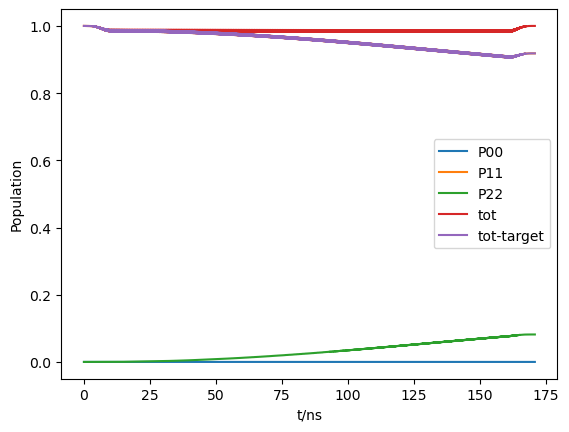

run end
13,run start


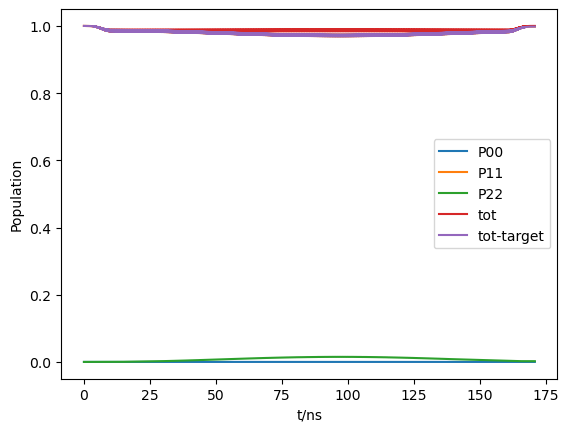

run end
14,run start


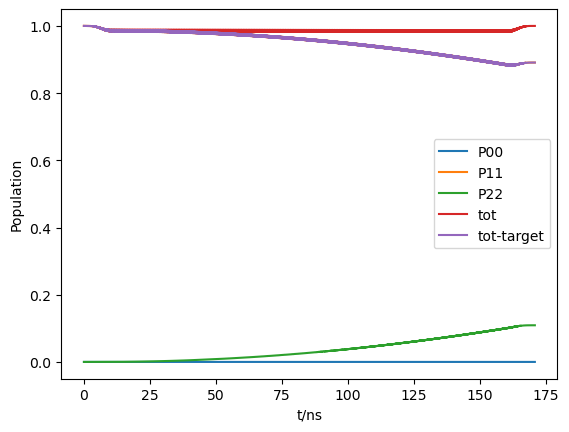

run end
15,run start


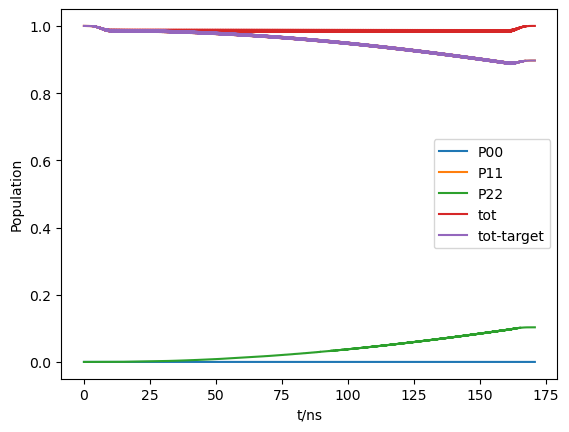

run end
16,run start


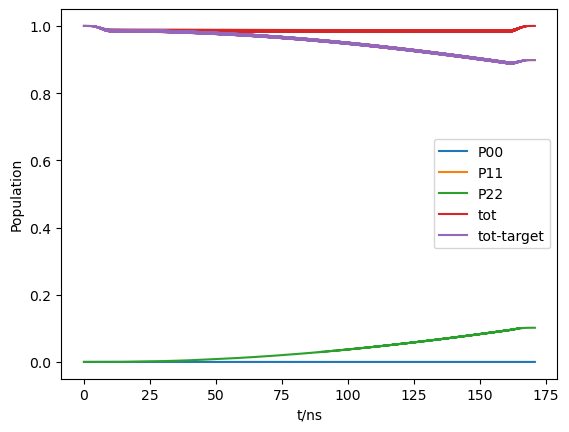

run end
17,run start


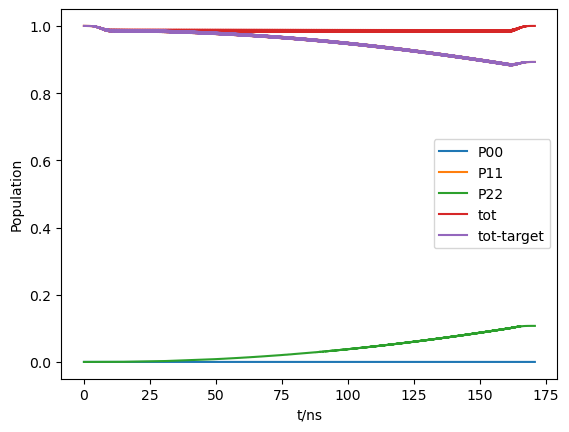

run end
18,run start


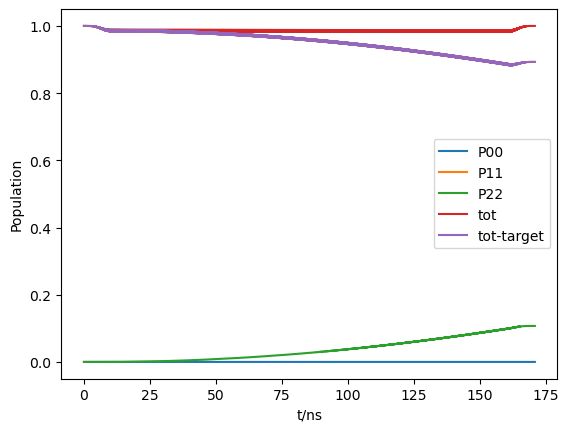

run end
19,run start


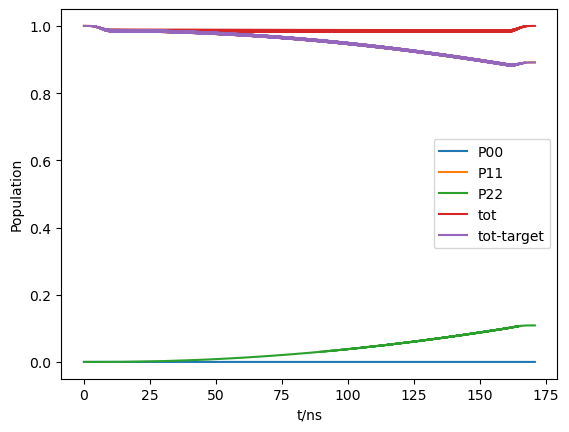

run end
20,run start


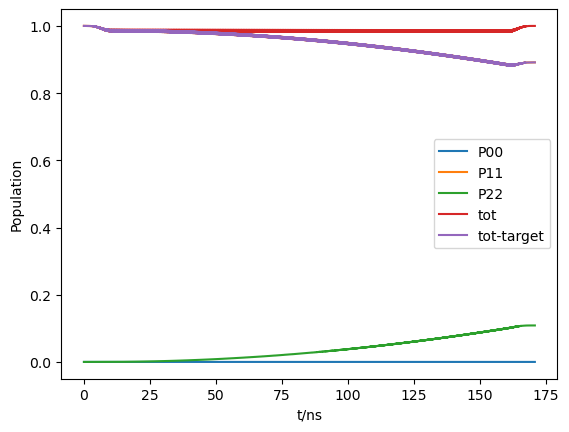

run end
21,run start


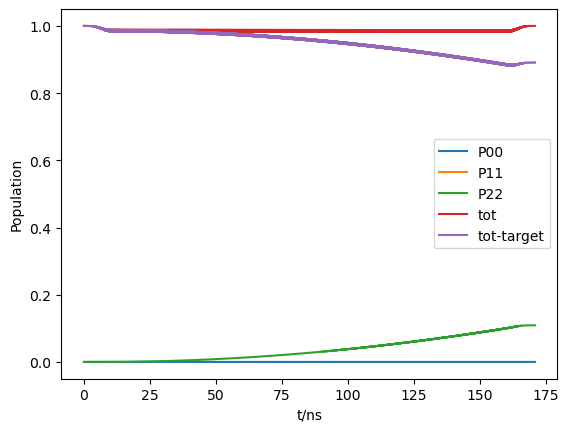

run end
22,run start


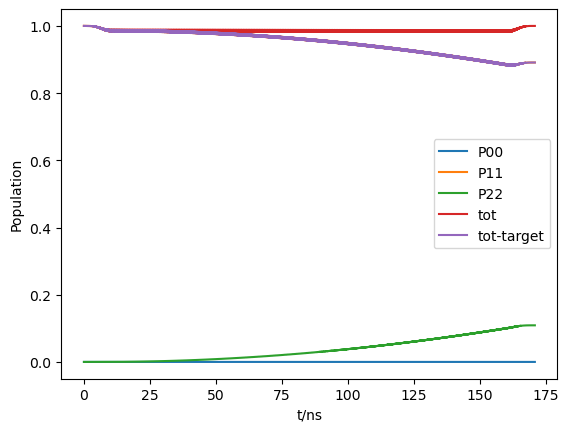

run end




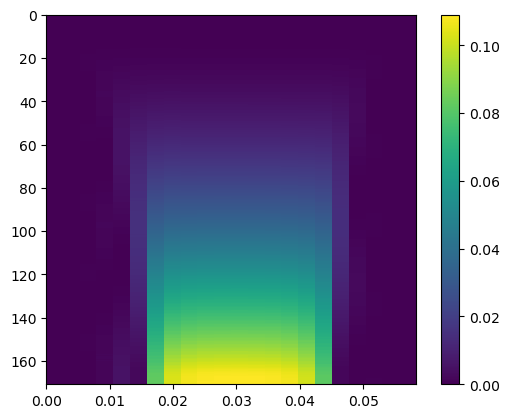

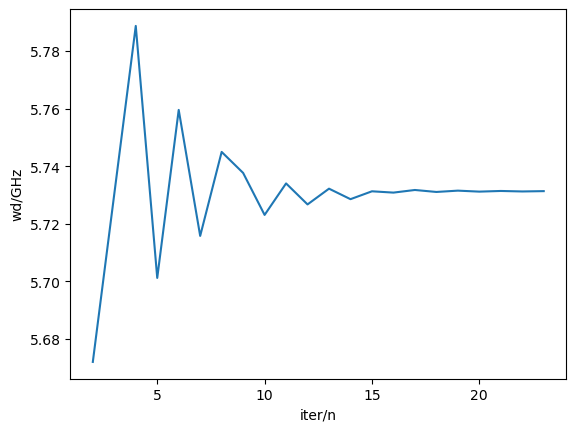

dpi=3.3168536980885753e-05,w_match=5.731311261251076 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:111.29944515620504
iter_num=
1,run start


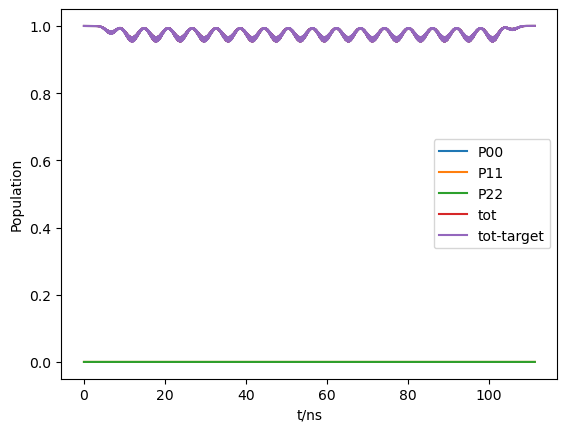

run end
2,run start


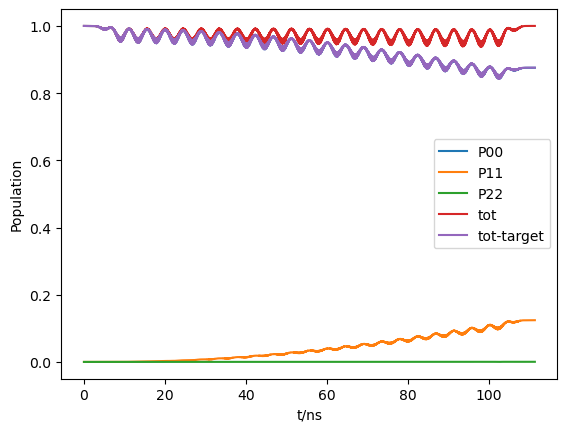

run end
3,run start


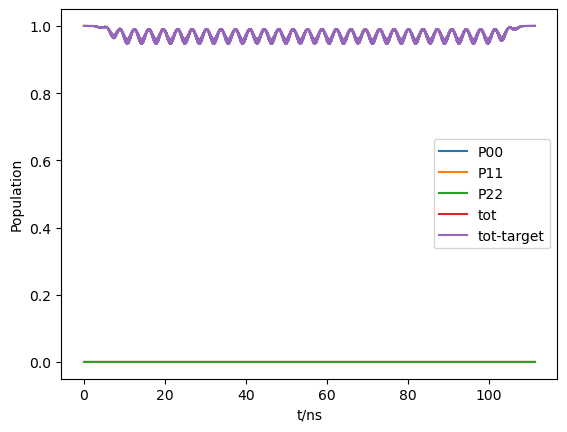

run end
4,run start


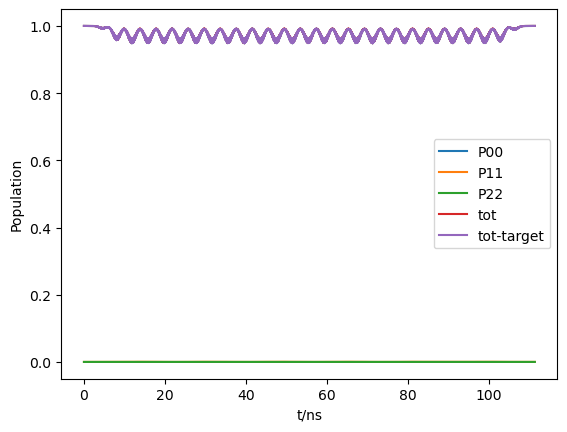

run end
5,run start


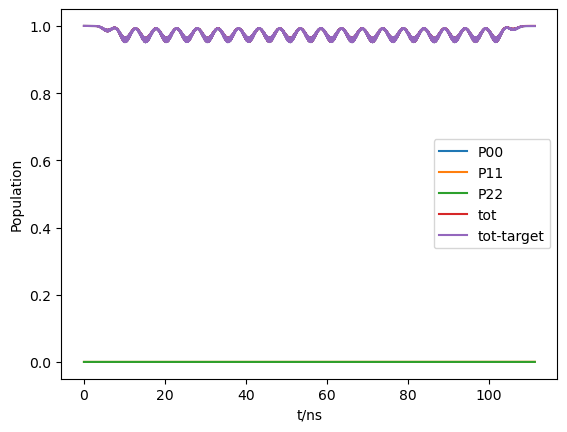

run end
6,run start


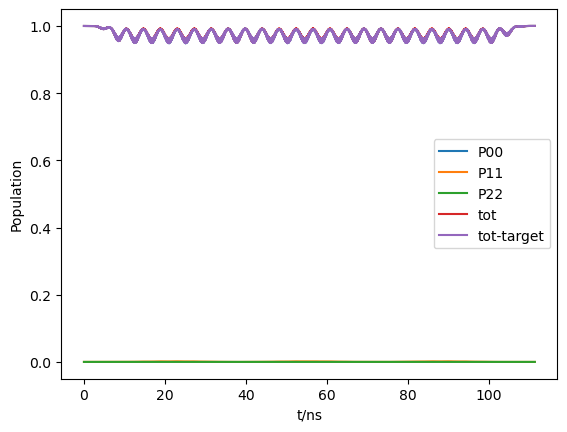

run end
7,run start


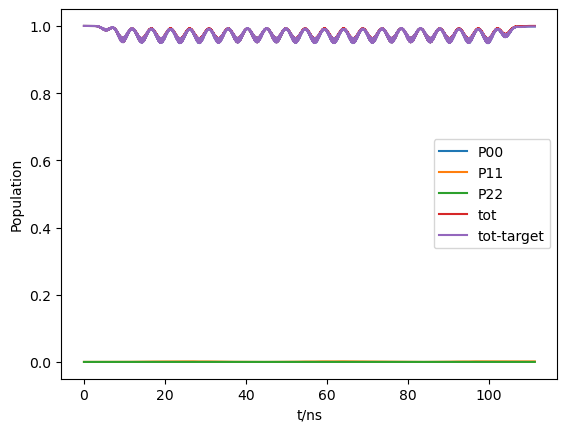

run end
8,run start


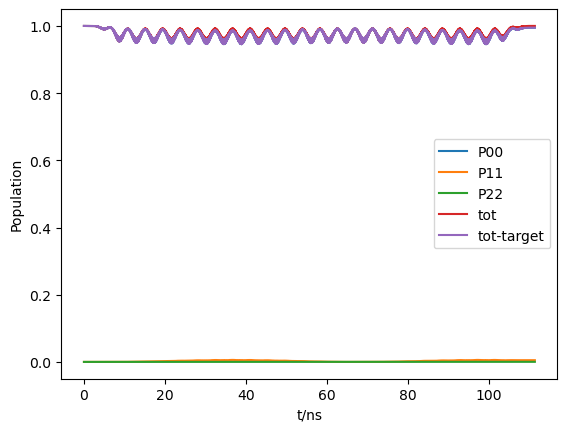

run end
9,run start


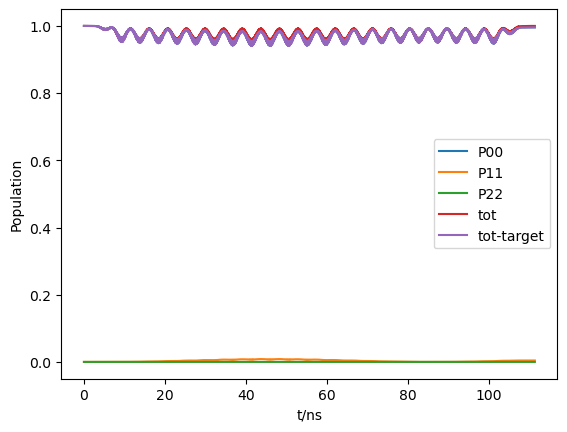

run end
10,run start


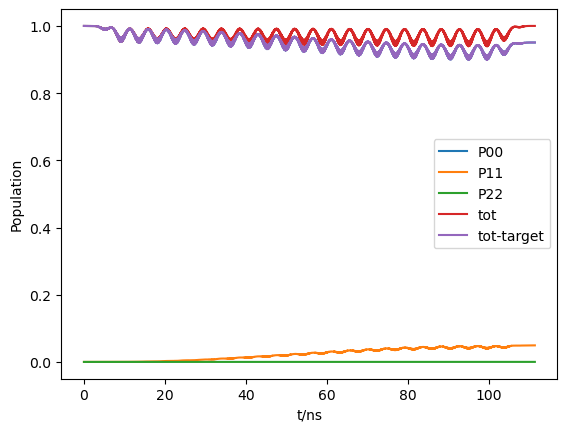

run end
11,run start


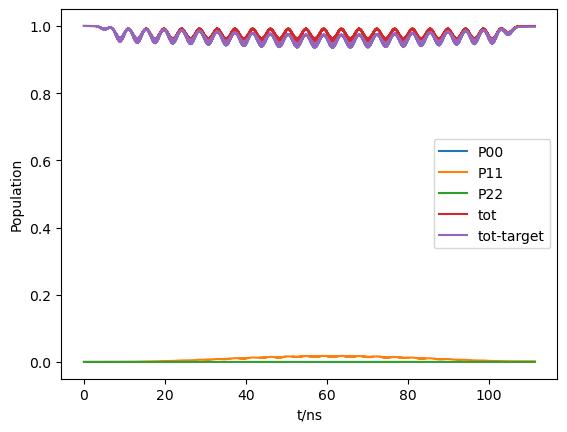

run end
12,run start


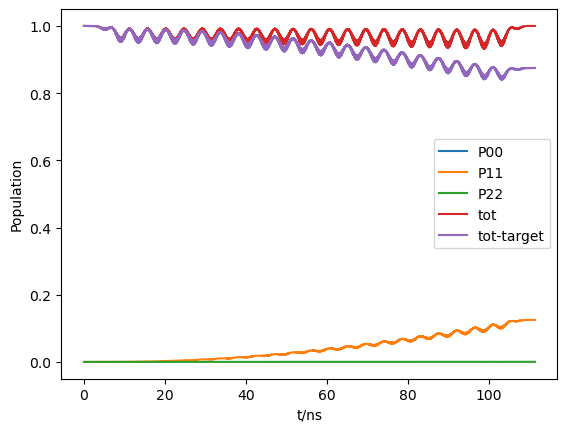

run end
13,run start


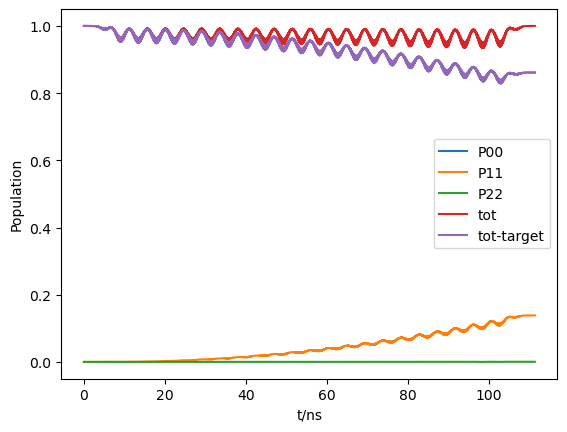

run end
14,run start


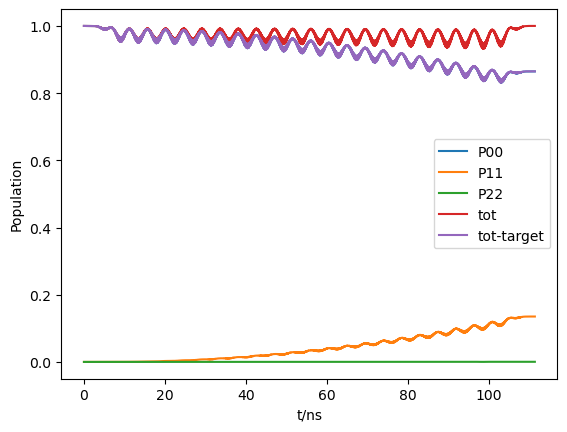

run end
15,run start


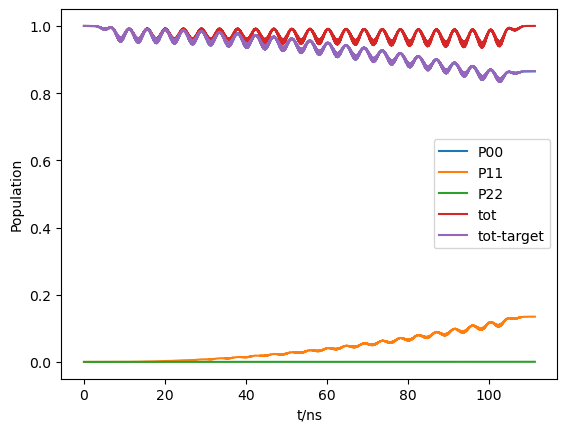

run end
16,run start


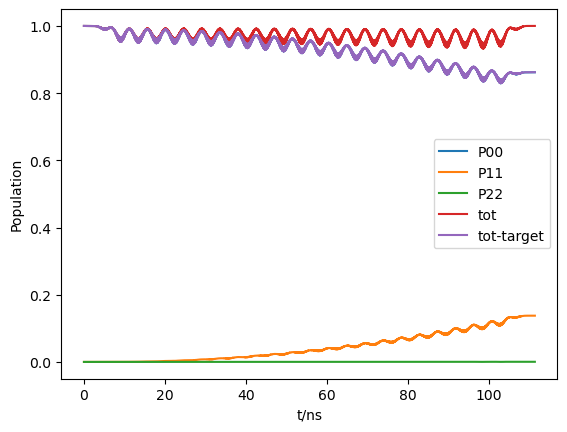

run end
17,run start


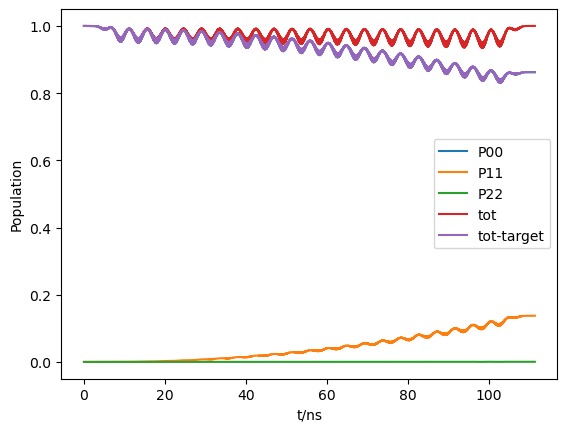

run end
18,run start


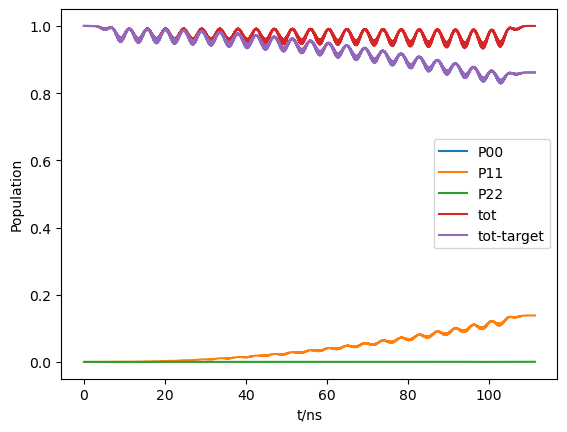

run end
19,run start


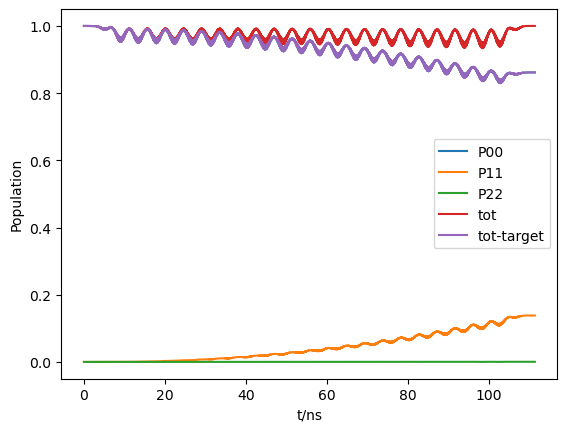

run end
20,run start


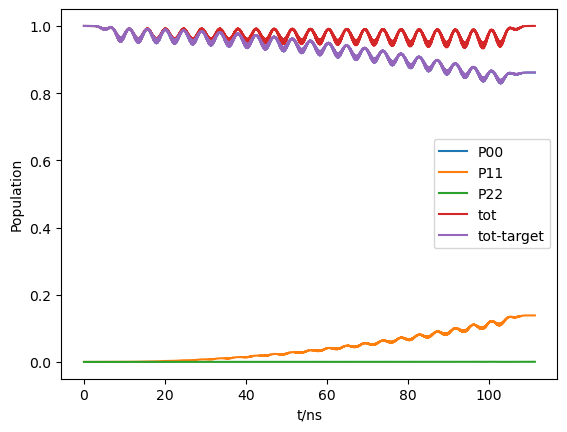

run end
21,run start


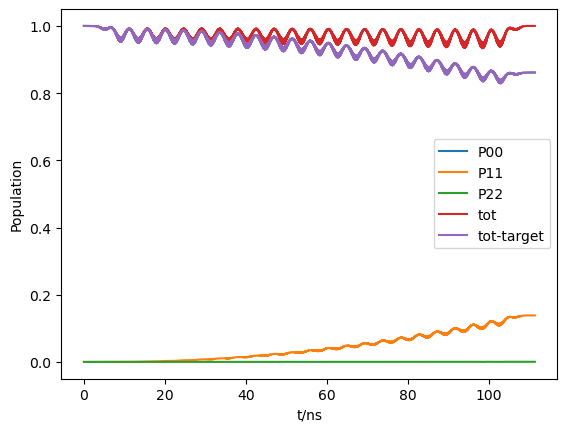

run end




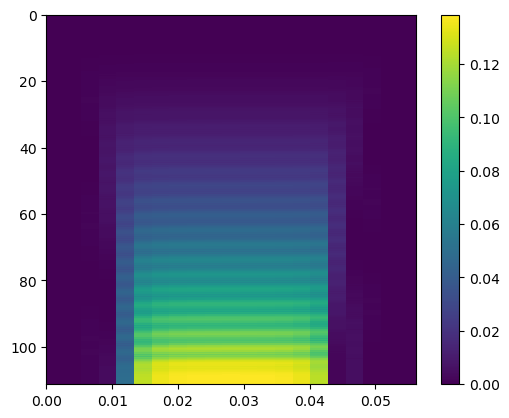

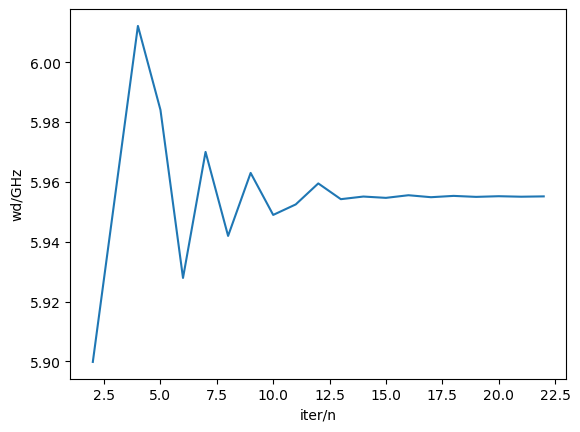

dpi=5.476484541001816e-05,w_match=5.955108211847612 
 auto_scan_scope end
run start


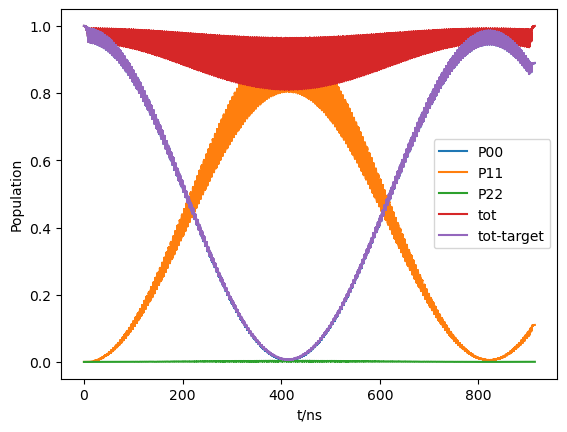

run end
wd_fit start 
 sp=0


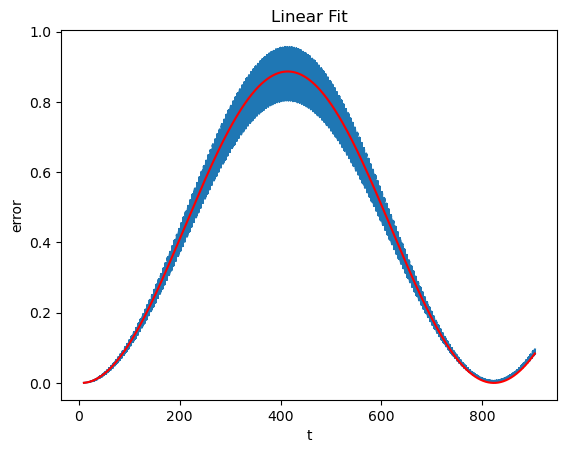

guess value of [d_eff,F,t0]=[0.001093578730239453, 1, 5.0]
fit coeff [d_eff,F,t0,T]=[0.0012231772873561473, 0.8868187557876596, 5.440520882580945, 817.5429762609991]
 wd_fit end
auto_scan_scope start 
 sp=1
T for scan:170.547894094992
iter_num=
1,run start


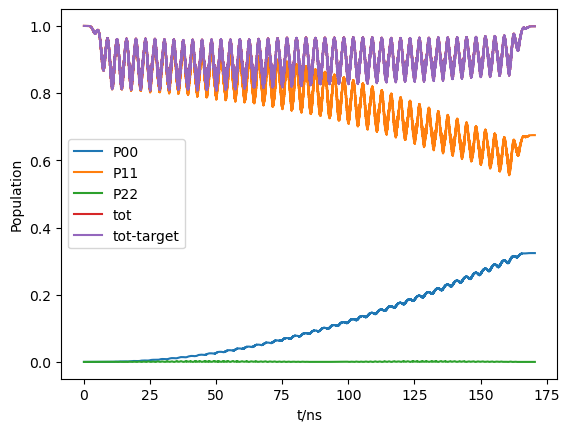

run end
2,run start


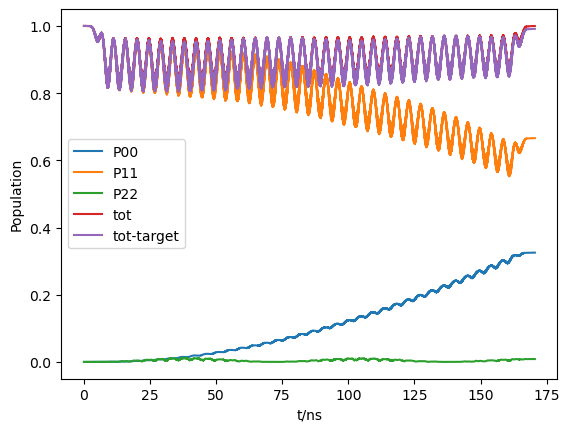

run end
3,run start


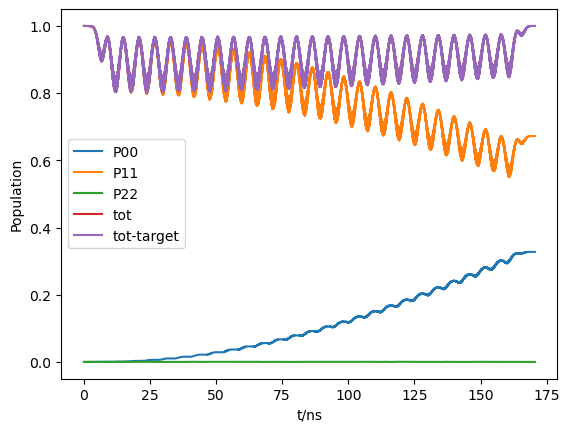

run end
4,run start


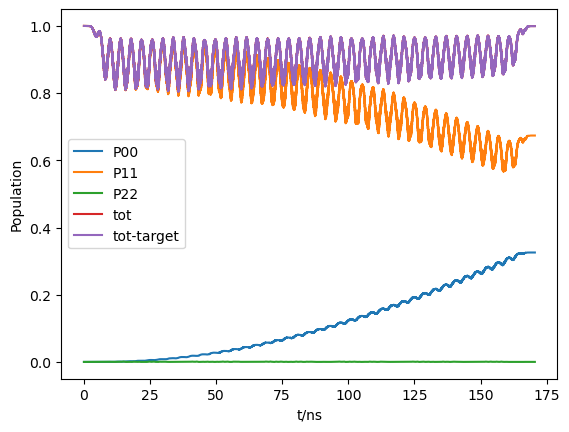

run end
5,run start


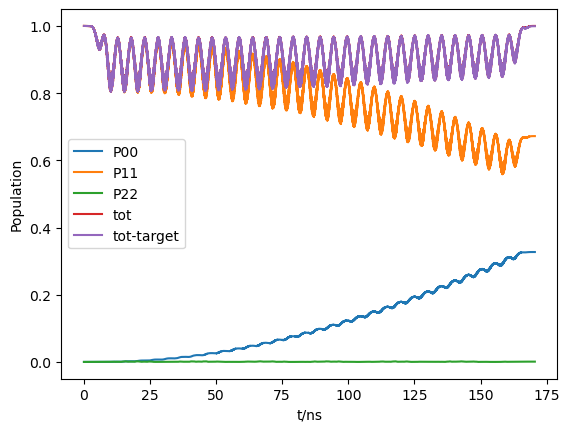

run end
6,run start


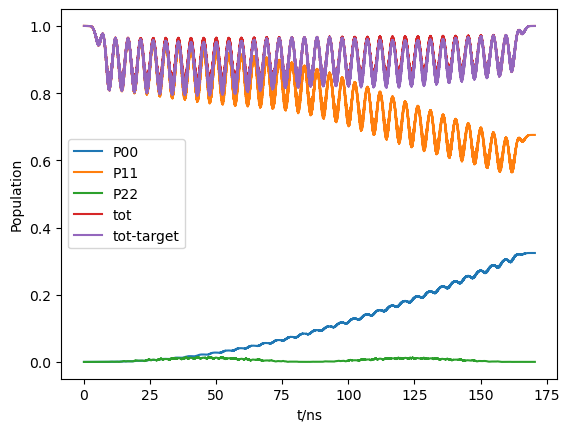

run end
7,run start


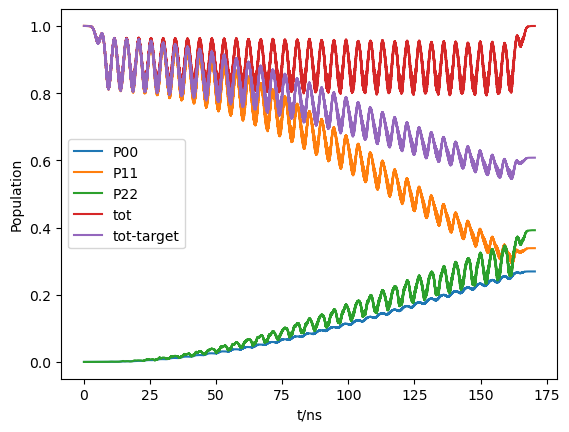

run end
8,run start


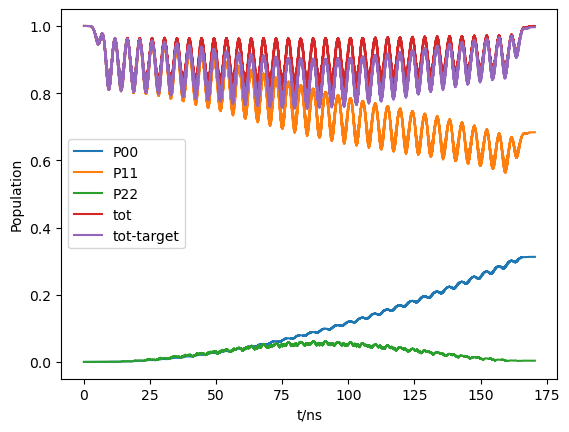

run end
9,run start


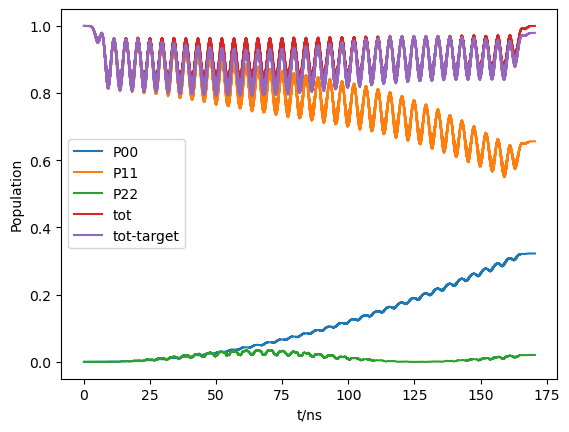

run end
10,run start


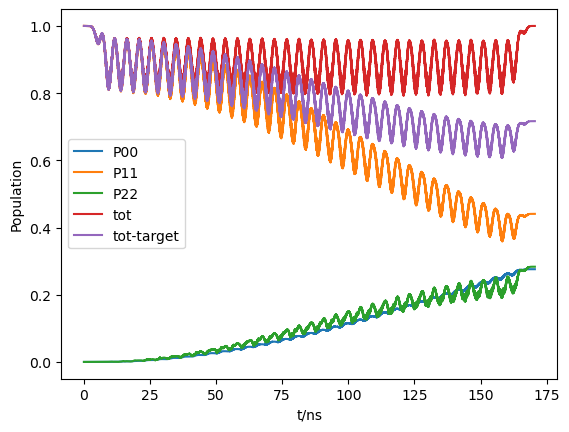

run end
11,run start


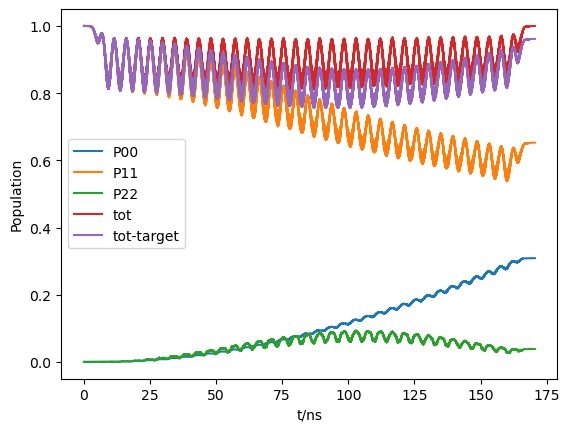

run end
12,run start


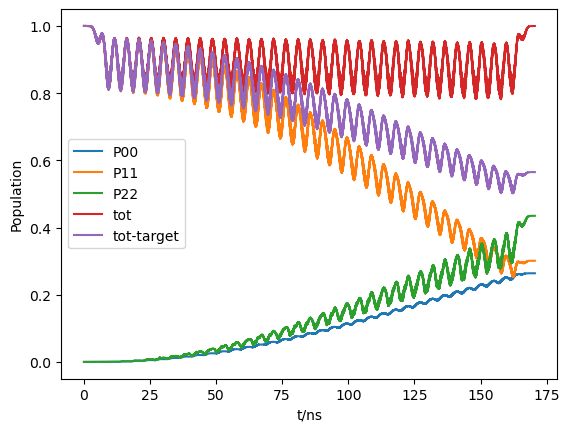

run end
13,run start


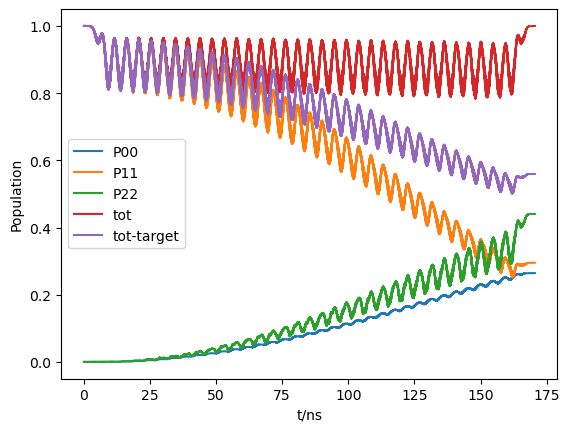

run end
14,run start


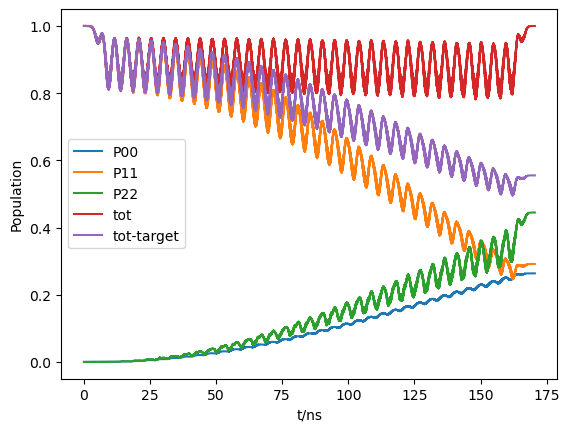

run end
15,run start


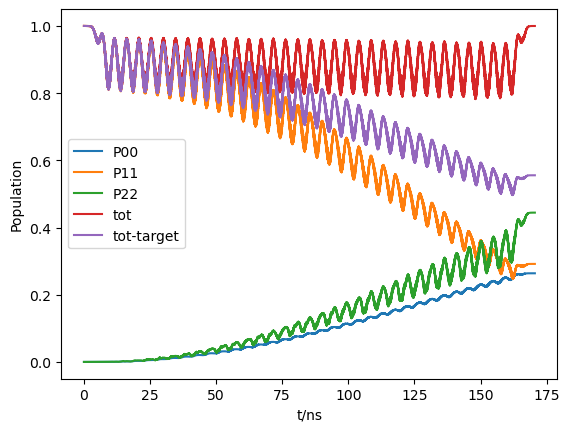

run end
16,run start


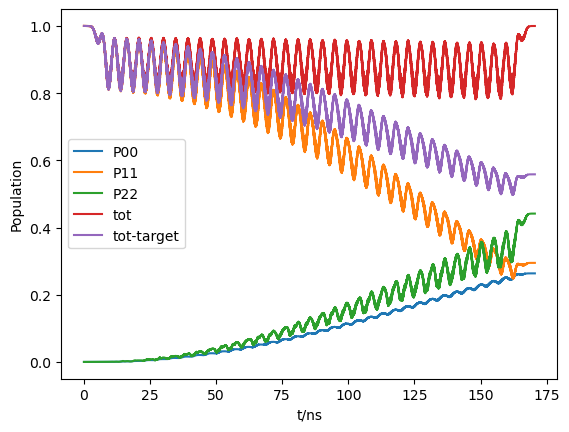

run end
17,run start


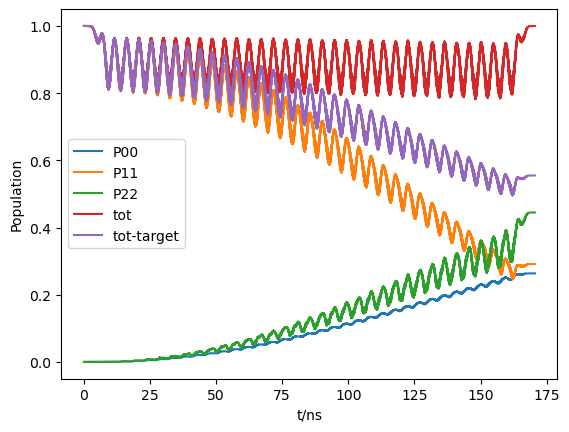

run end




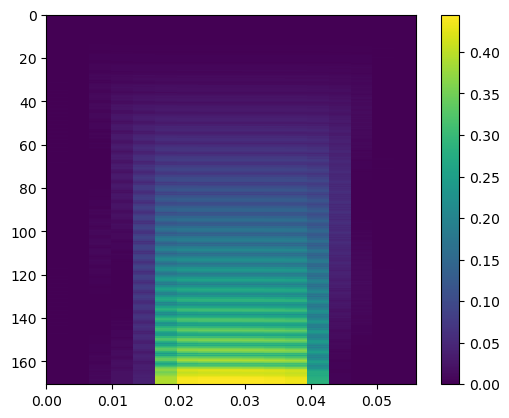

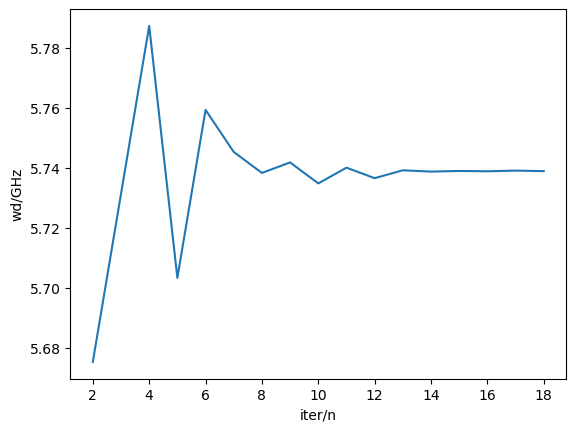

dpi=3.3212022194379716e-05,w_match=5.738905933158527 
 auto_scan_scope end
run start


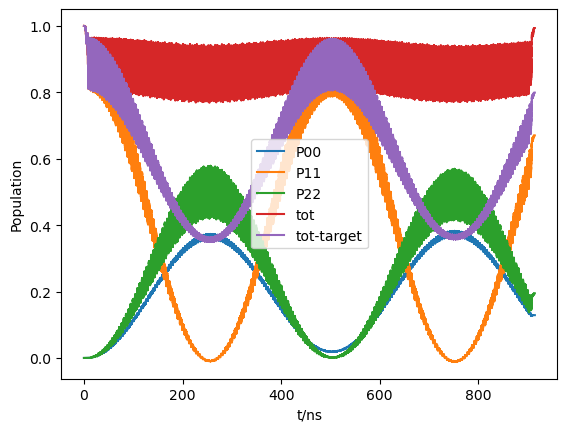

run end
wd_fit start 
 sp=1
correct!=1


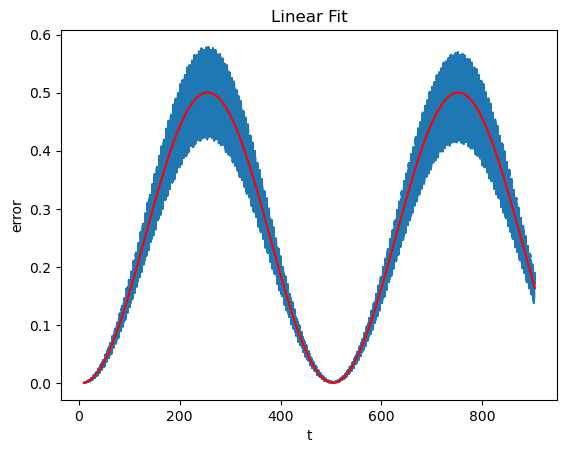

guess value of [d_eff,F,t0]=[0.001343123028971842, 1, 5.0]
fit coeff [d_eff,F,t0,T]=[0.0020120298252140414, 0.5004196475198258, 6.787419568645956, 497.0105251265941]
 wd_fit end

p_eff=1.6449208516313851
suggest set sp_direct as:[1, 0.4248239128903297]
run start


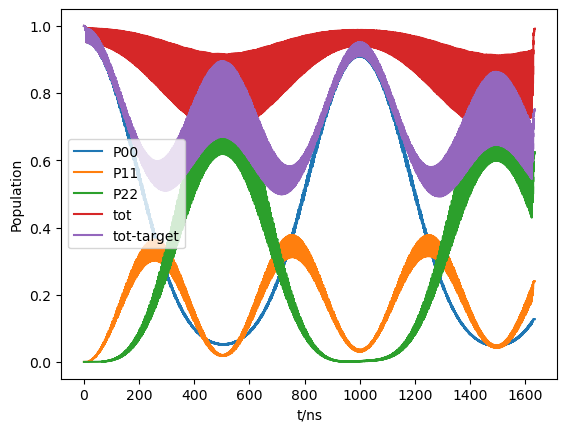

run end


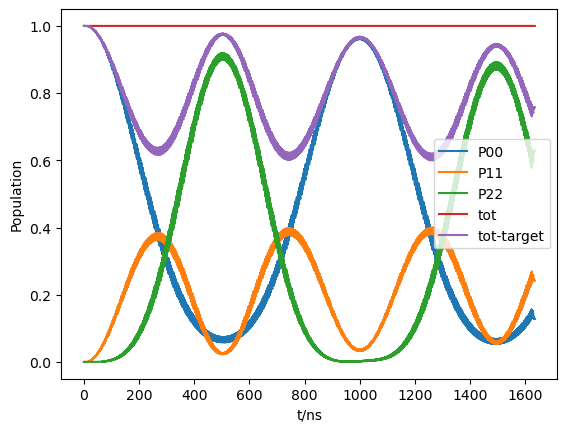

In [ ]:
# wdm=(5.956000029067557+5.731319558030517)/2
# wd=[wdm ,5.731319558030517 ]#single wave
# 5.738450530011672 
wd=[5.956000029067557 ,5.731319558030517 ]#single wave
# wd=[5.940313438079269 ,5.738864629361385 ]#mix wave,single swap 11-22,sp=[1,1]，T~~140ns
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
wd=[5.9550457117450755,5.738864629361385 ]#mix wave,in-step swap[1,1]
a=sideband( level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
            L=1000,   wd=wd,     phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
            rho0=0,  )
# res=a.run(plot=True,norm_plot=True)
# a.auto_scan_scope(sp=1,runplot=True)
auto_result=a.auto_scan_mix_wave_wd_sp(amp=0.3,sp_direct=[1,0.46617831709480284])
# a.d_eff_g

auto_scan_mix_wave_wd start
amp=0.2		sp_direct=[1, 0.46617831709480284]
[1, 0]
auto_scan_scope start 
 sp=0
T for scan:222.60511081296755
iter_num=
1,run start


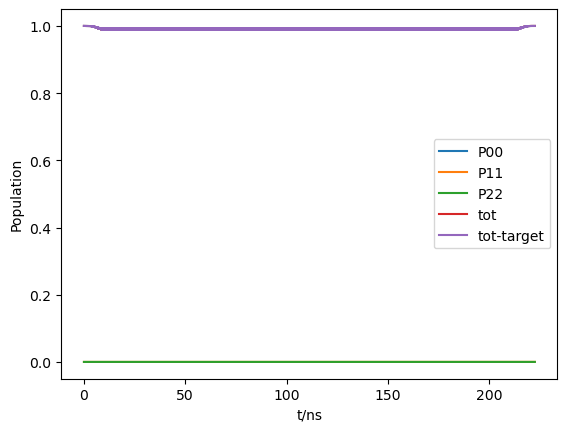

run end
2,run start


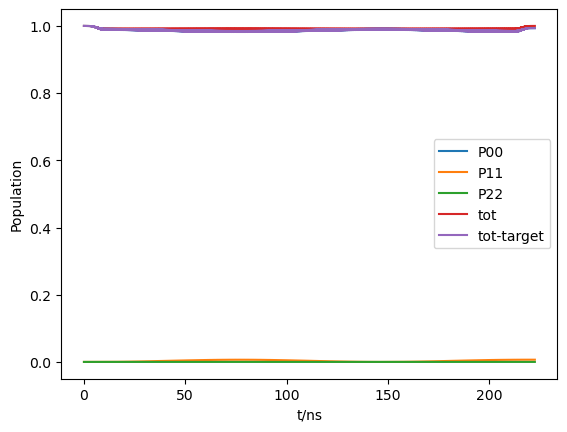

run end
3,run start


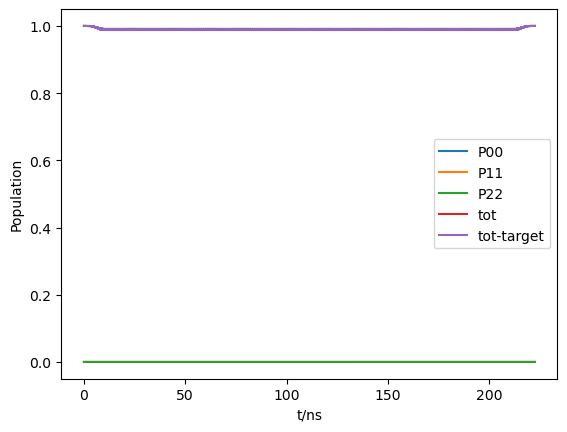

run end
4,run start


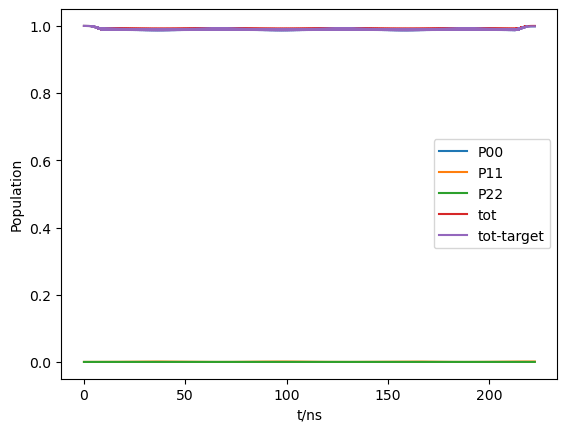

run end
5,run start


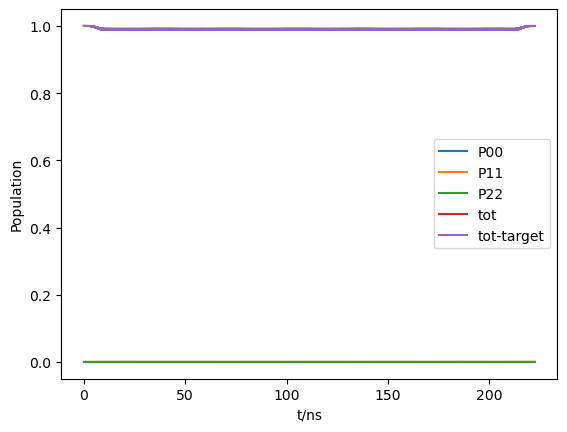

run end
6,run start


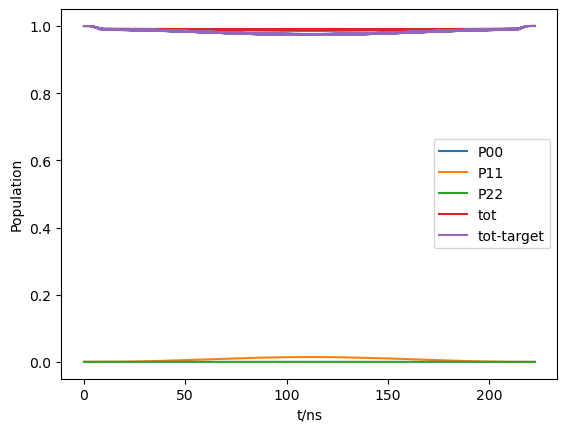

run end
7,run start


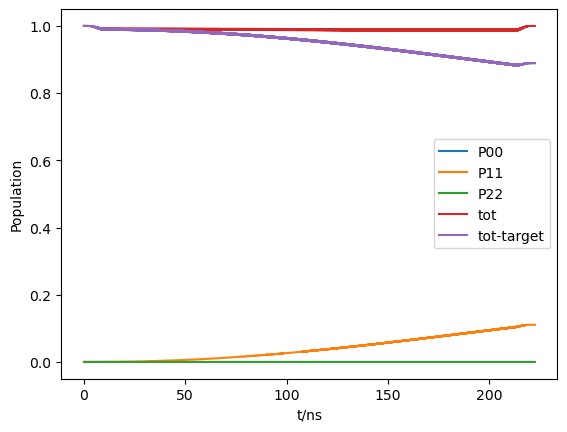

run end
8,run start


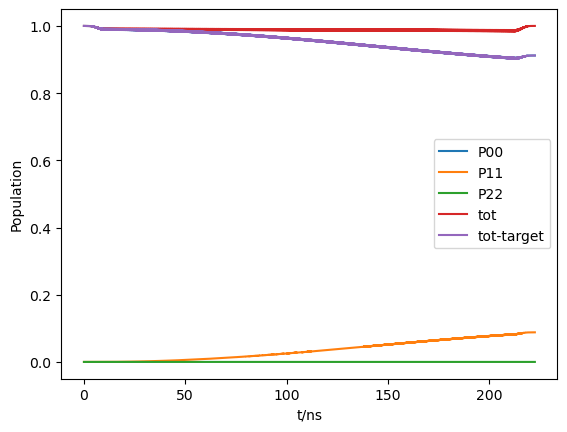

run end
9,run start


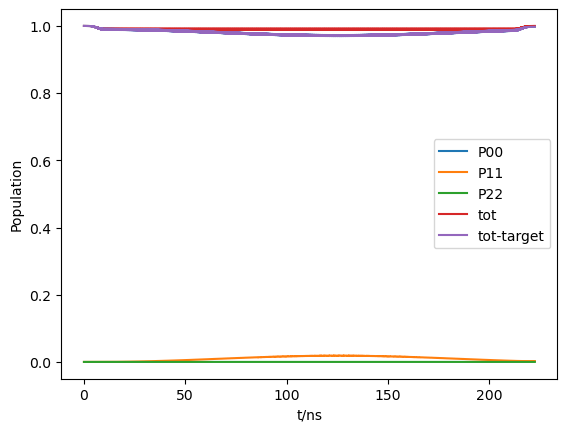

run end
10,run start


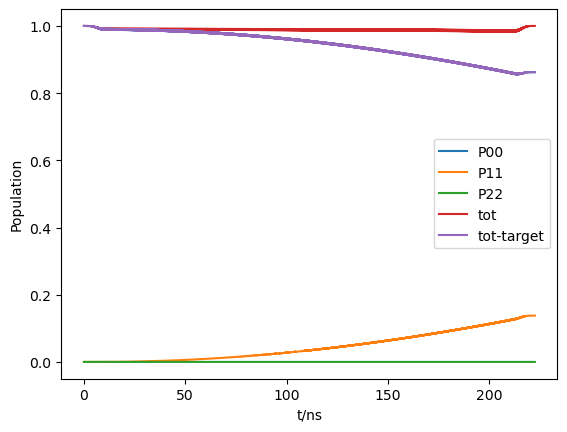

run end
11,run start


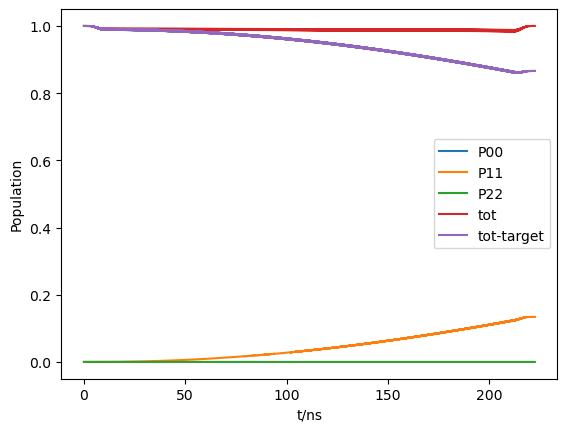

run end
12,run start


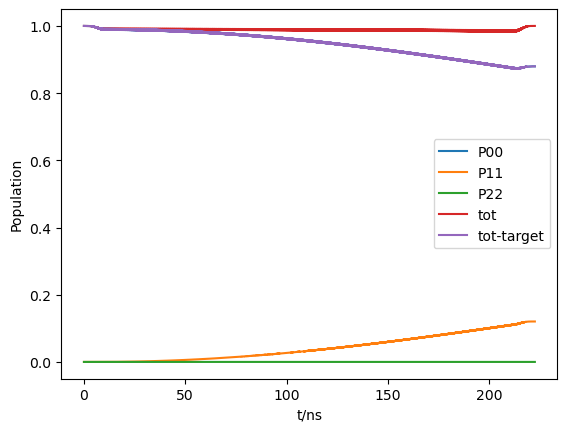

run end
13,run start


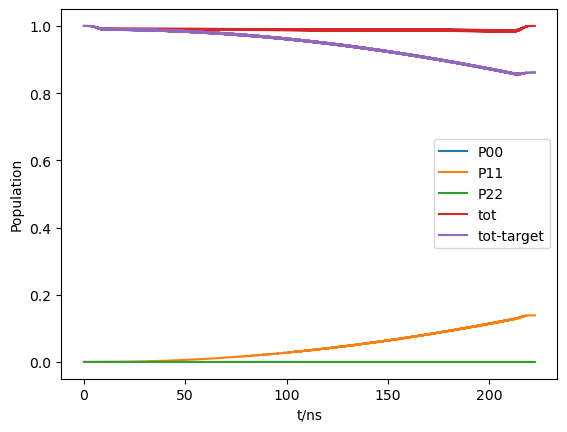

run end
14,run start


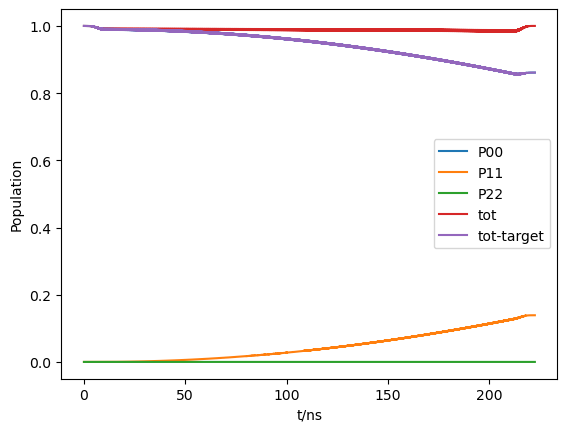

run end
15,run start


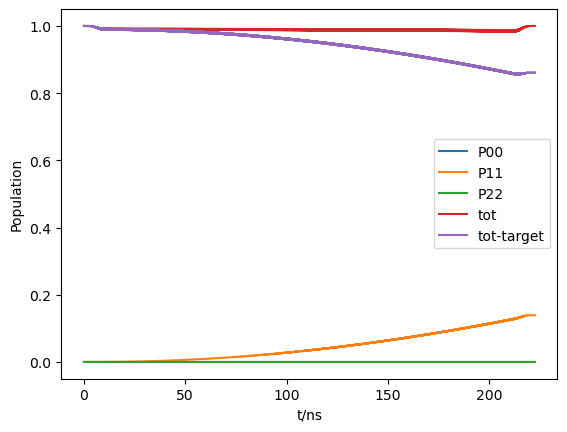

run end




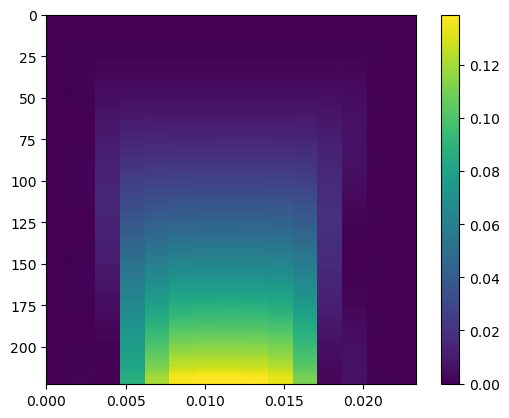

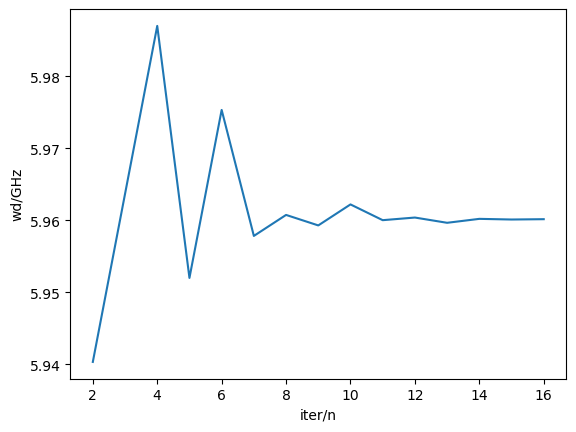

dpi=2.4678548235714005e-05,w_match=5.960166104131808 
 auto_scan_scope end
[0, 0.46617831709480284]
auto_scan_scope start 
 sp=1
T for scan:359.17685324749493
iter_num=
1,run start


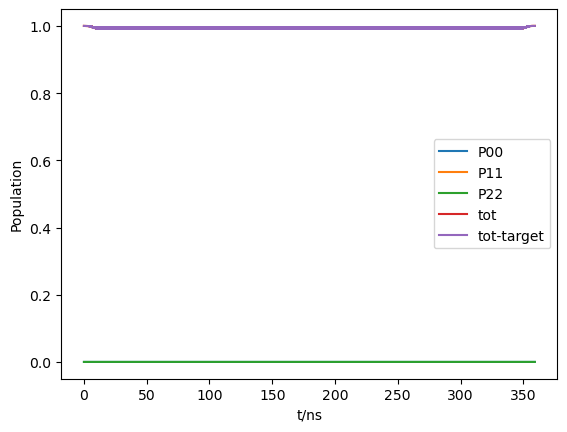

run end
2,run start


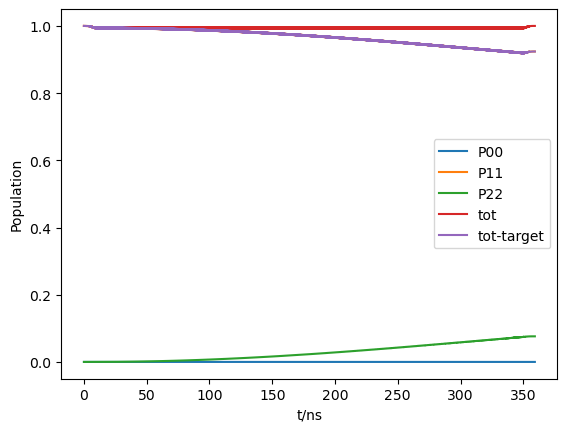

run end
3,run start


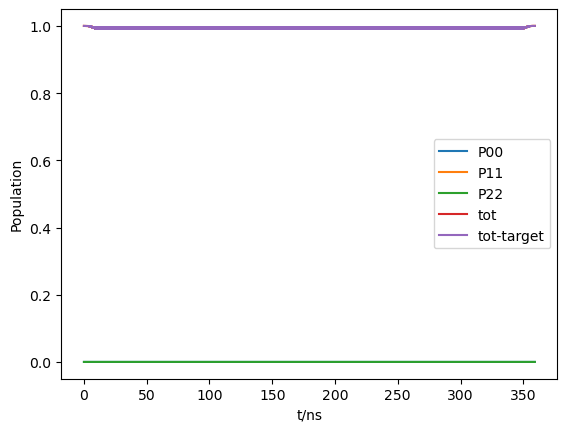

run end
4,run start


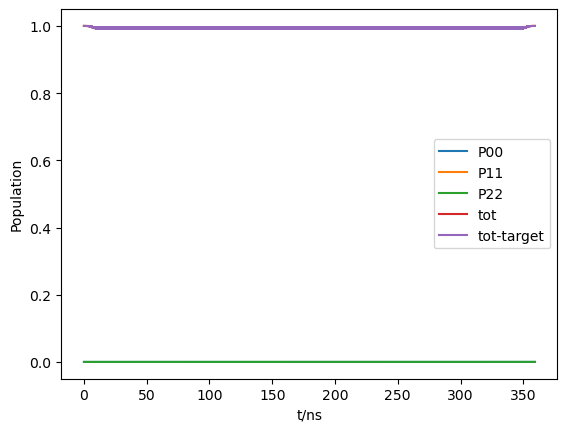

run end
5,run start


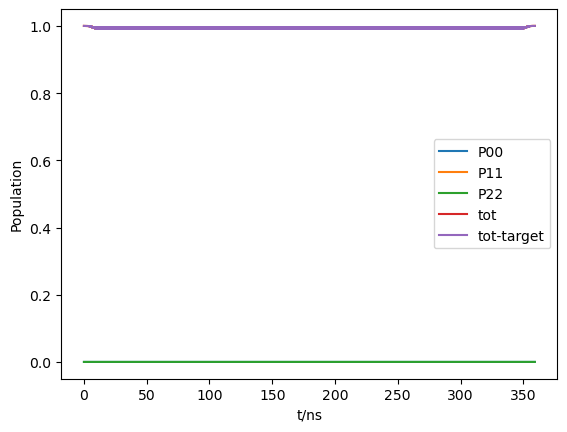

run end
6,run start


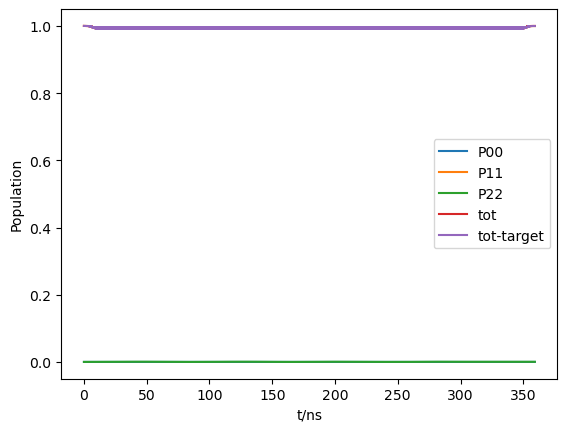

run end
7,run start


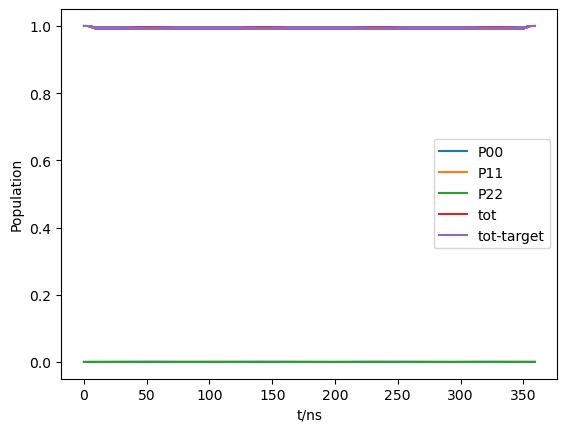

run end
8,run start


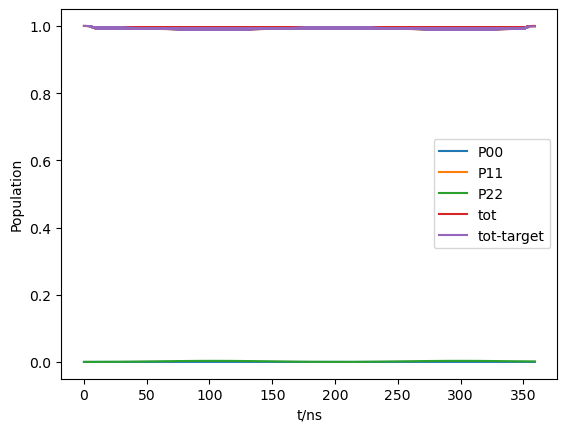

run end
9,run start


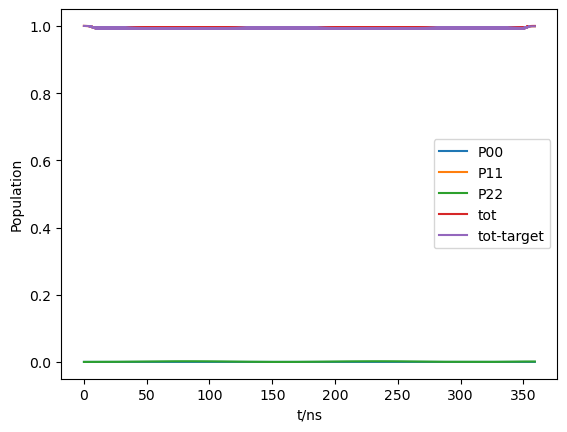

run end
10,run start


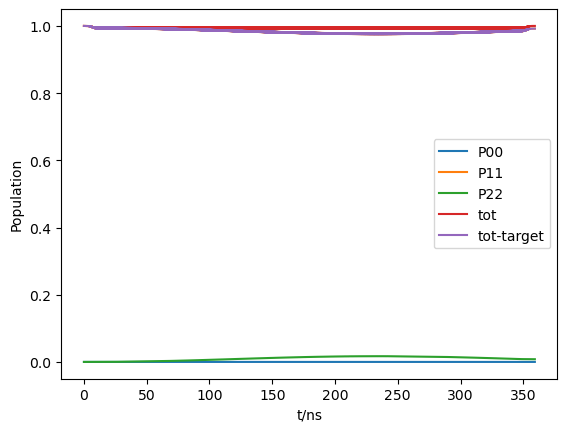

run end
11,run start


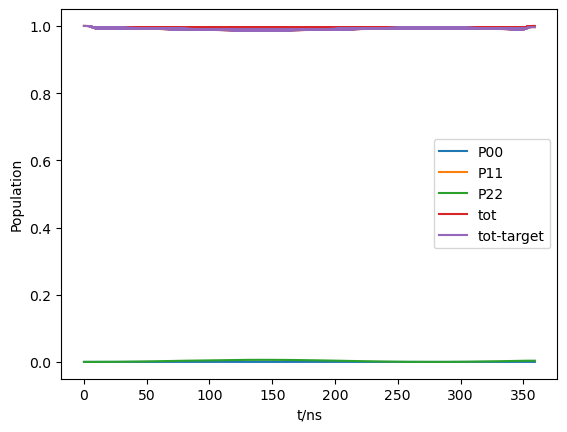

run end
12,run start


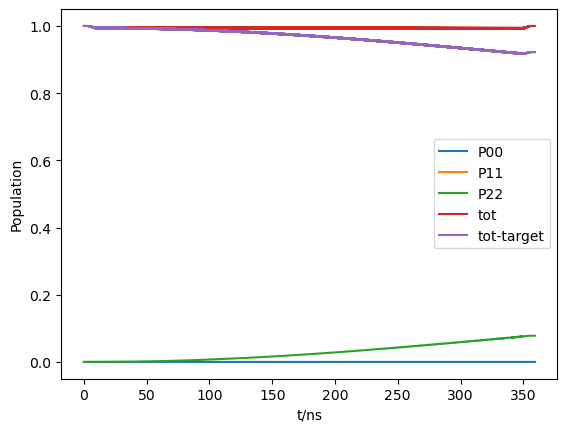

run end
13,run start


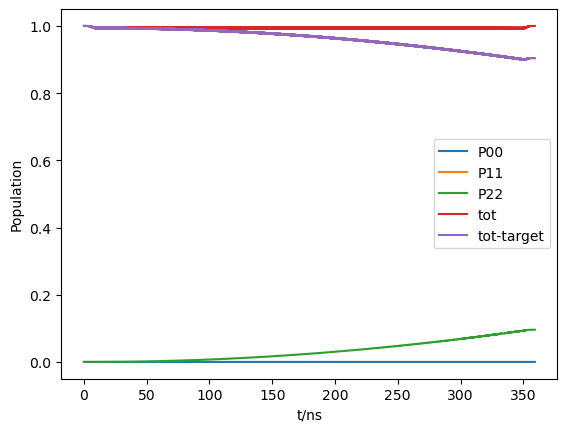

run end
14,run start


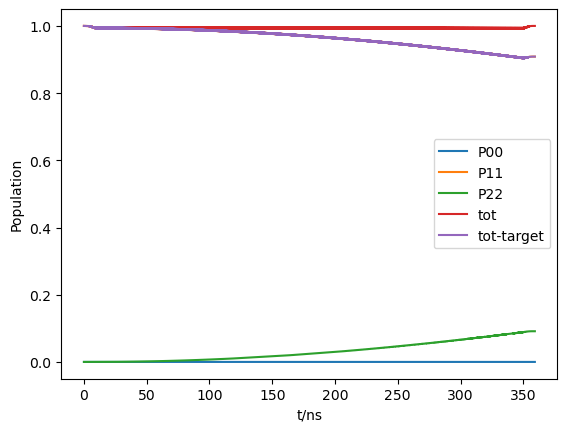

run end
15,run start


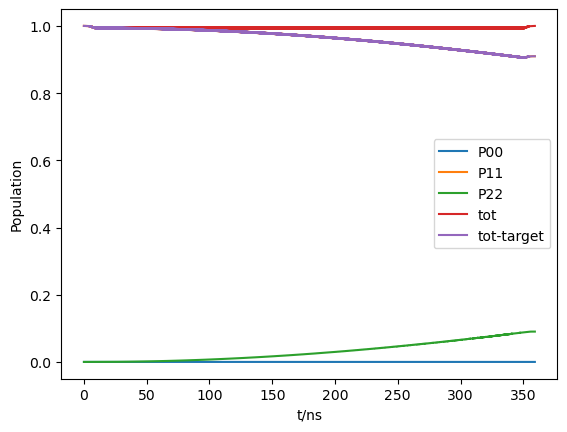

run end
16,run start


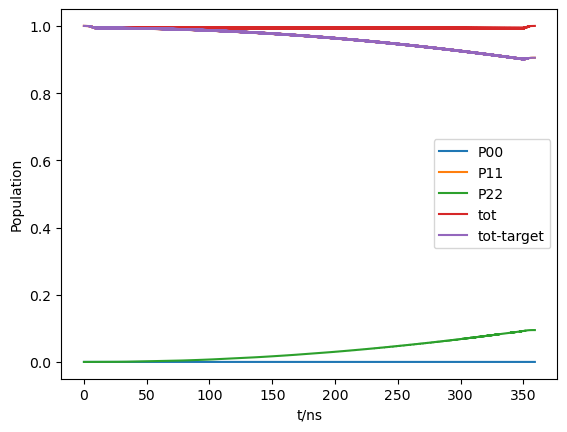

run end
17,run start


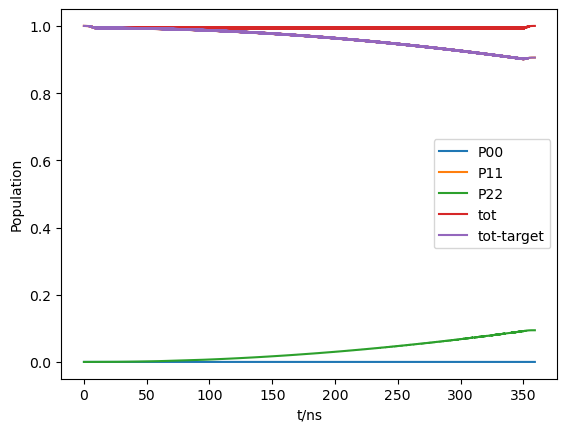

run end
18,run start


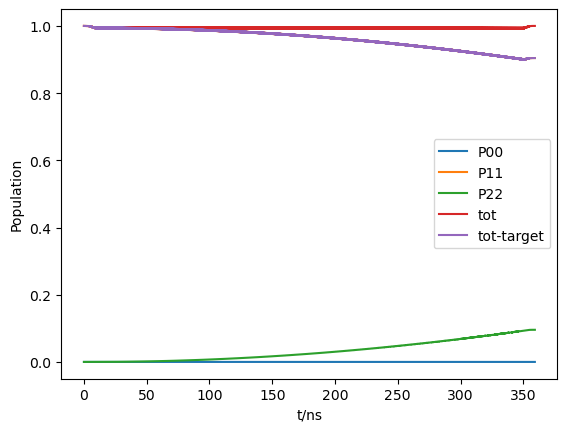

run end
19,run start


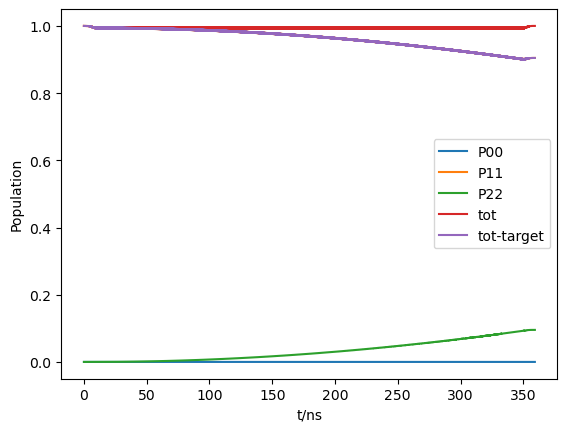

run end
20,run start


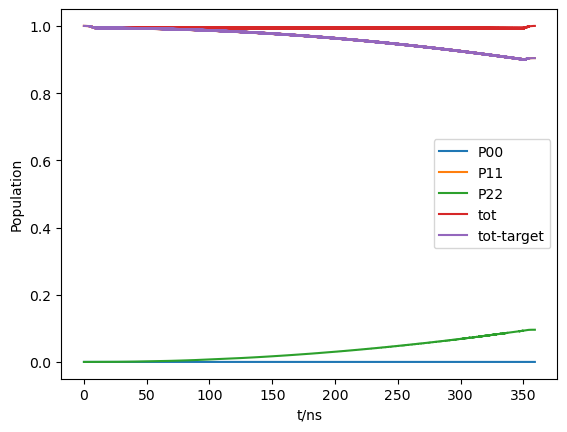

run end
21,run start


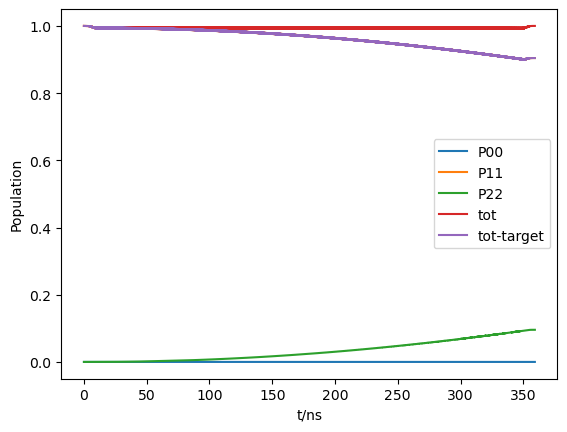

run end




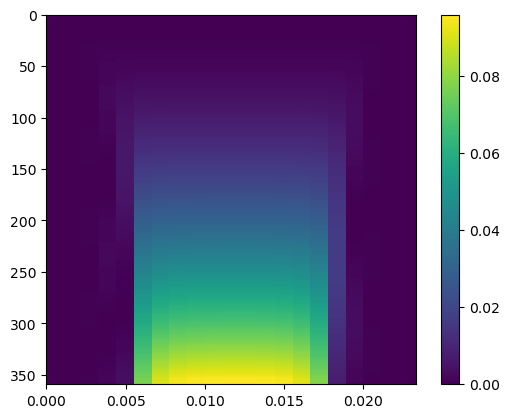

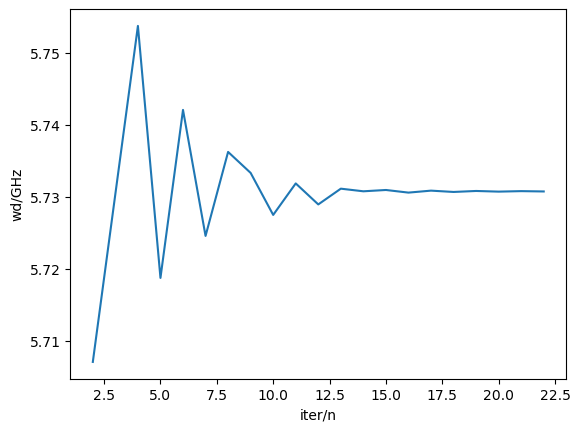

dpi=1.4741571991504786e-05,w_match=5.73076452461668 
 auto_scan_scope end
auto_scan_scope start 
 sp=0
T for scan:223.8892817699061
iter_num=
1,run start


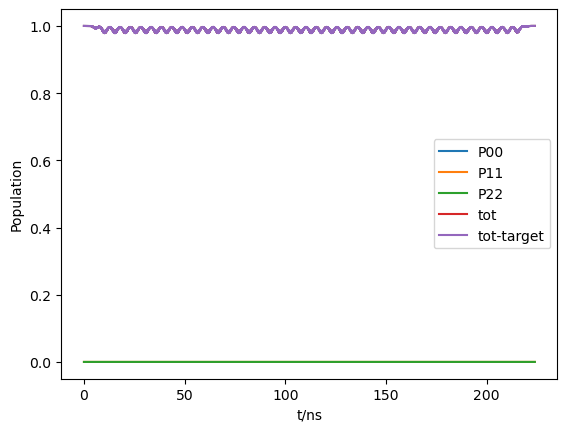

run end
2,run start


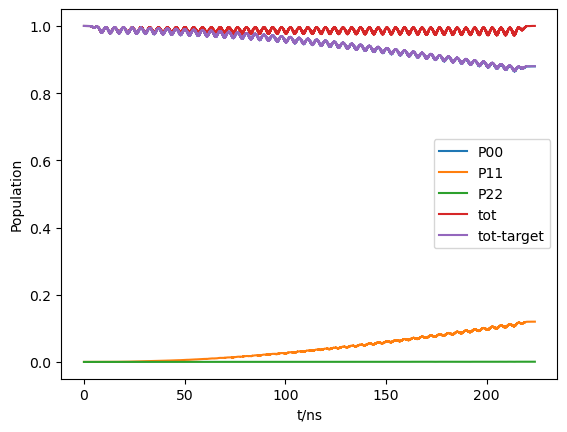

run end
3,run start


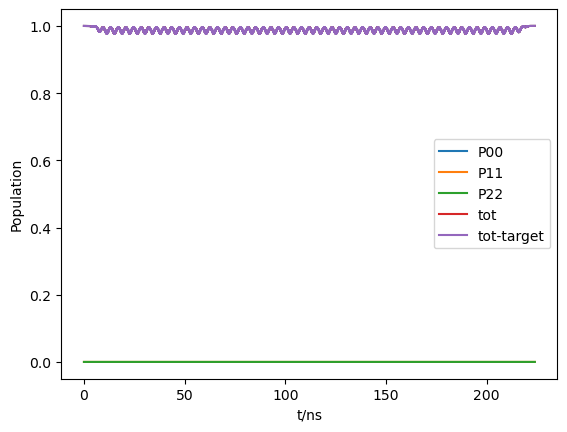

run end
4,run start


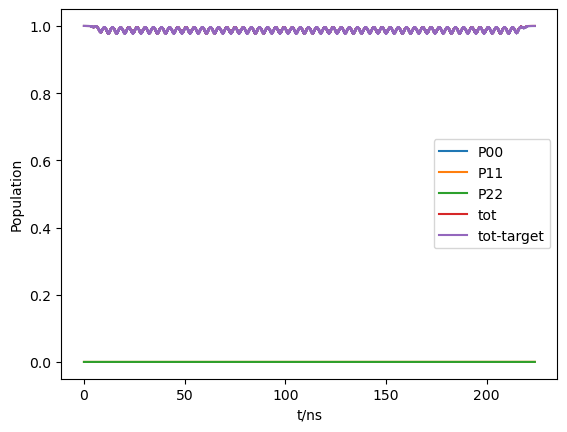

run end
5,run start


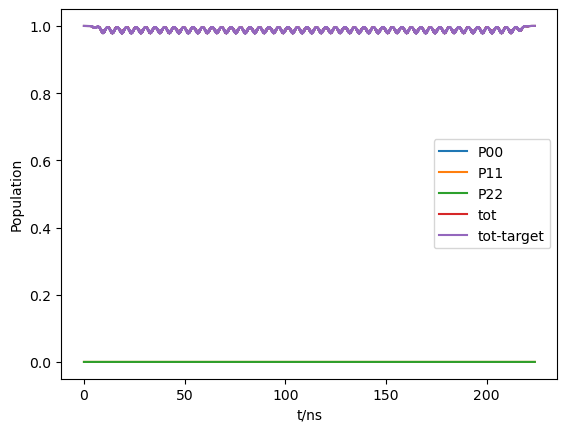

run end
6,run start


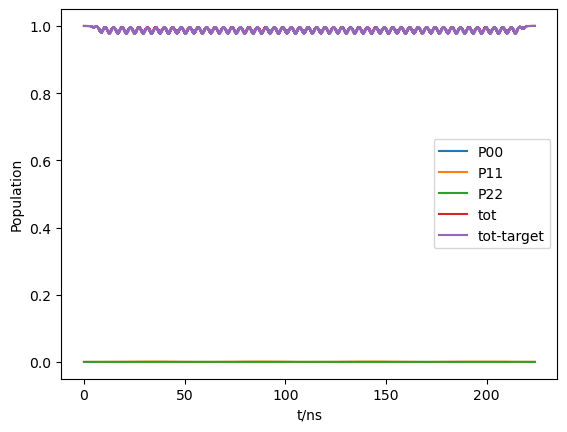

run end
7,run start


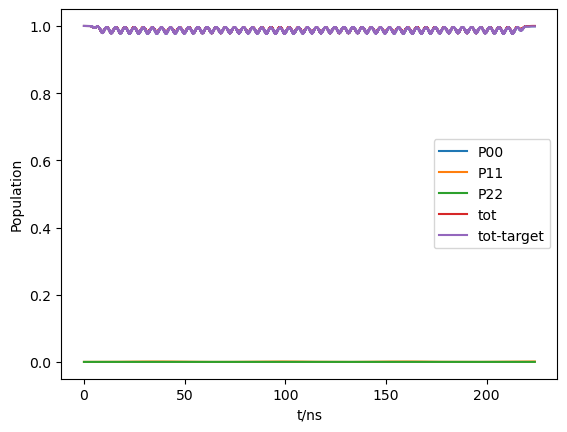

run end
8,run start


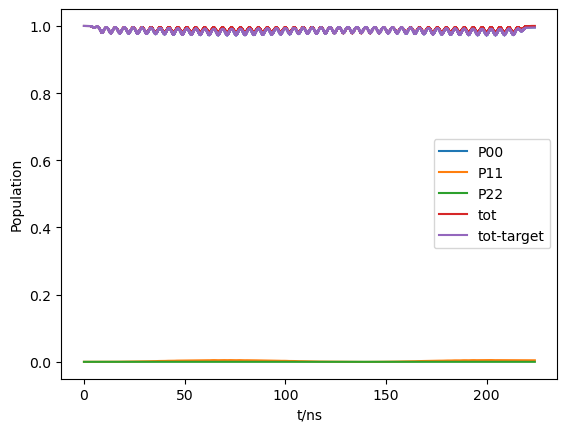

run end
9,run start


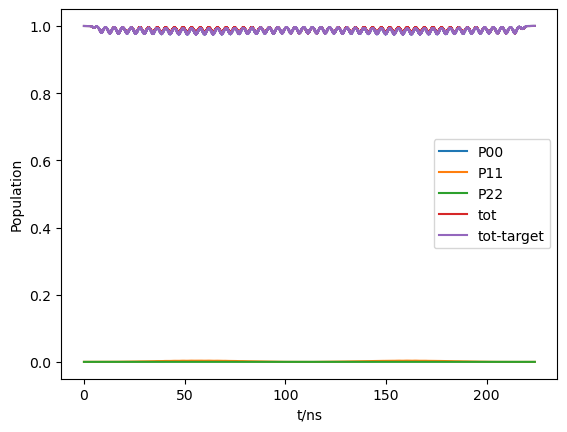

run end
10,run start


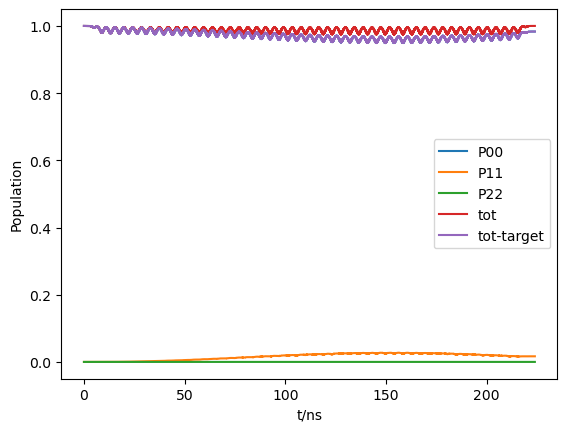

run end
11,run start


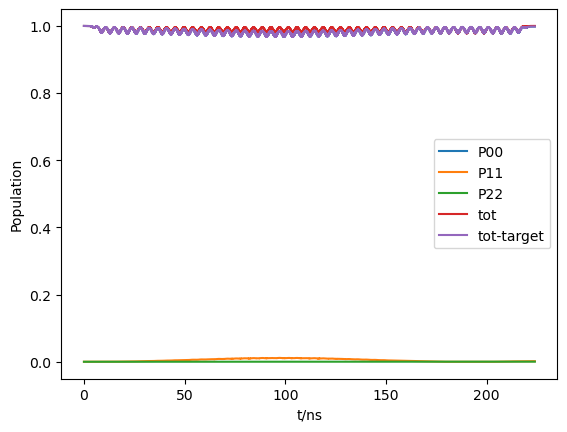

run end
12,run start


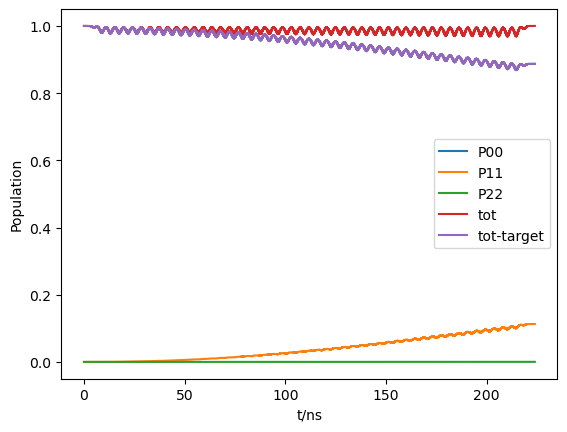

run end
13,run start


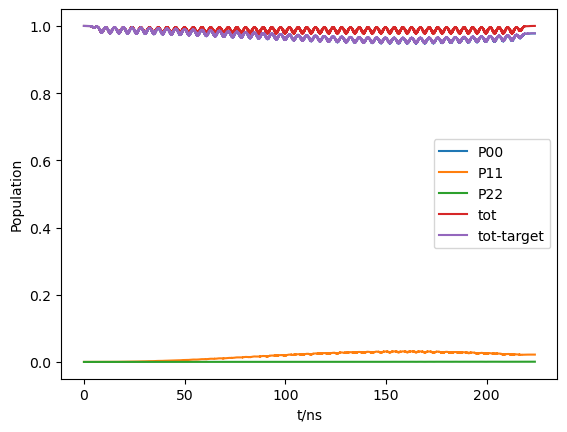

run end
14,run start


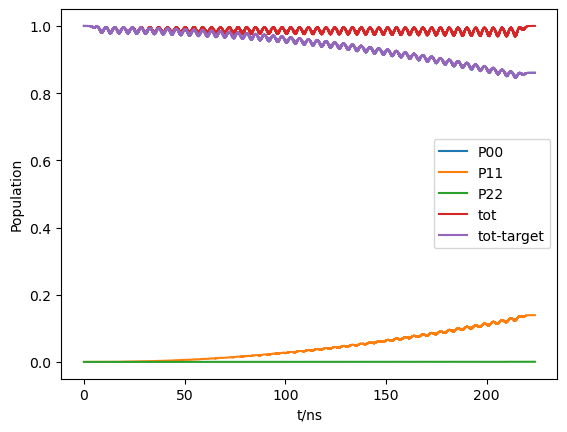

run end
15,run start


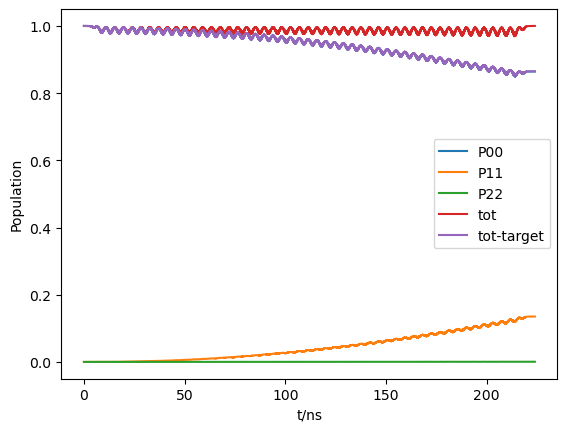

run end
16,run start


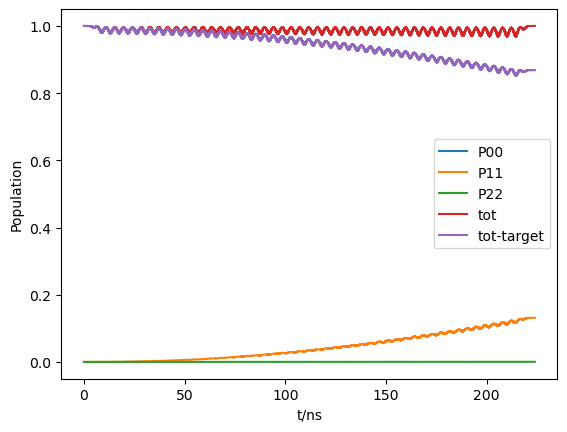

run end
17,run start


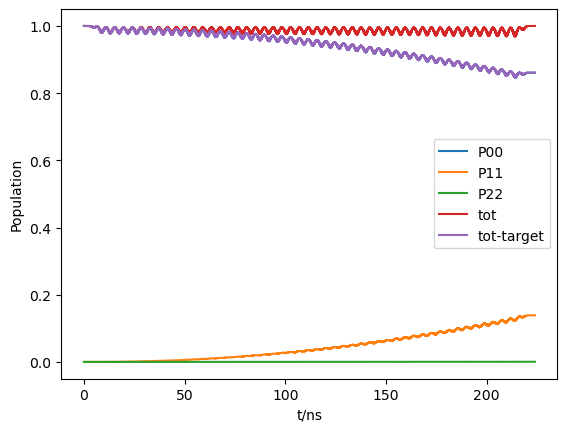

run end
18,run start


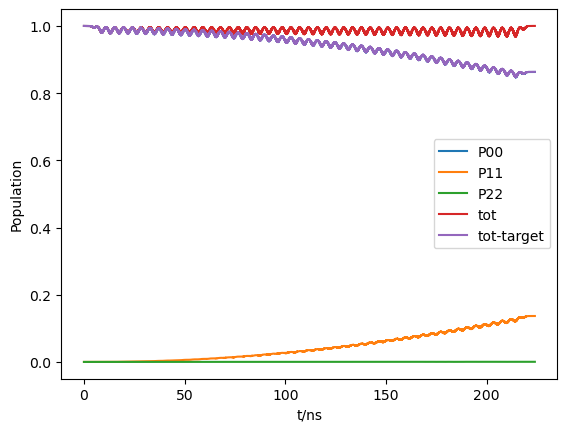

run end
19,run start


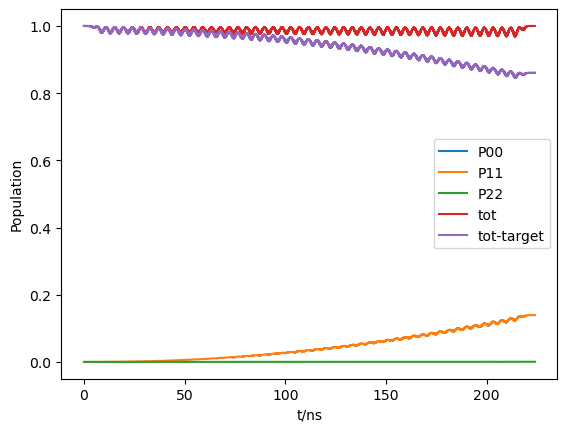

run end
20,run start


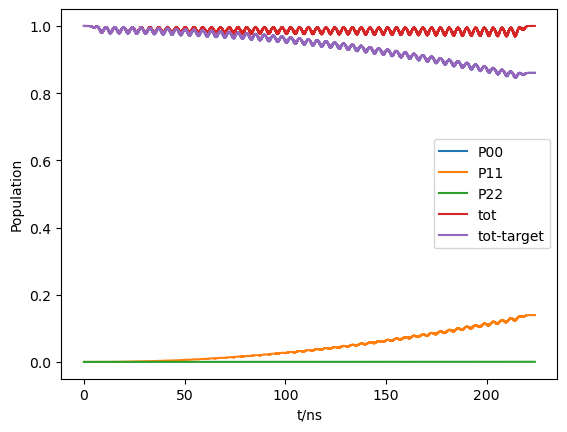

run end




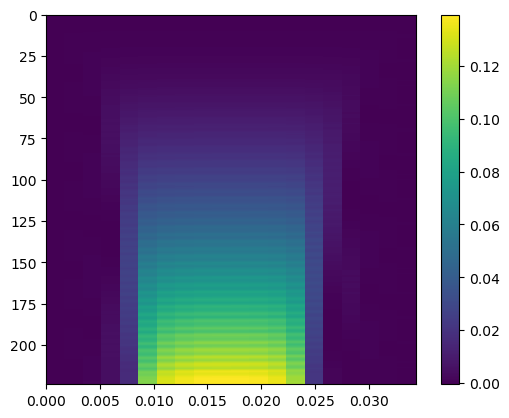

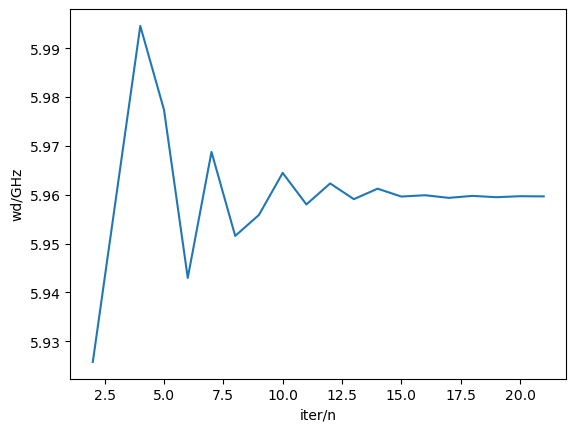

dpi=2.4523113508451216e-05,w_match=5.95966204792682 
 auto_scan_scope end
run start


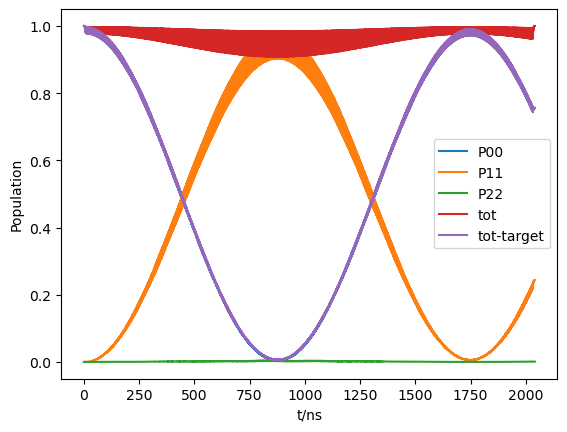

run end
wd_fit start 
 sp=0


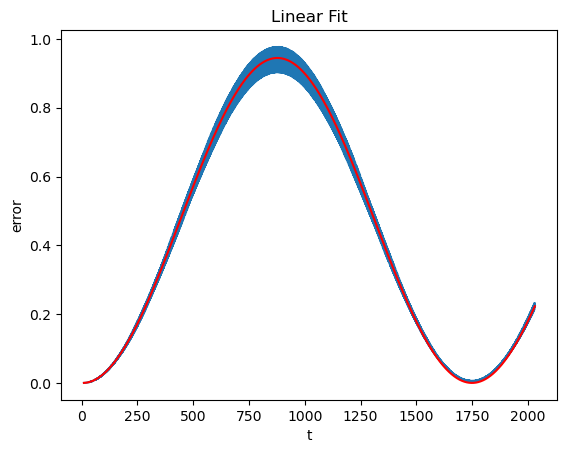

guess value of [d_eff,F,t0]=[0.000490018181580678, 1, 5.0]
fit coeff [d_eff,F,t0,T]=[0.0005733572281300349, 0.9446998242161747, 4.89335549890653, 1744.113357149837]
 wd_fit end
auto_scan_scope start 
 sp=1
T for scan:358.99919019764025
iter_num=
1,run start


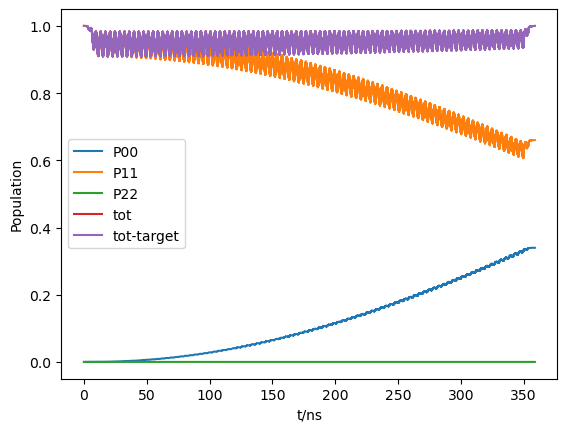

run end
2,run start


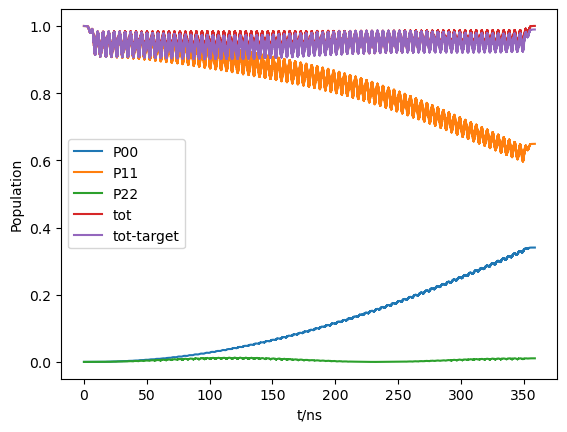

run end
3,run start


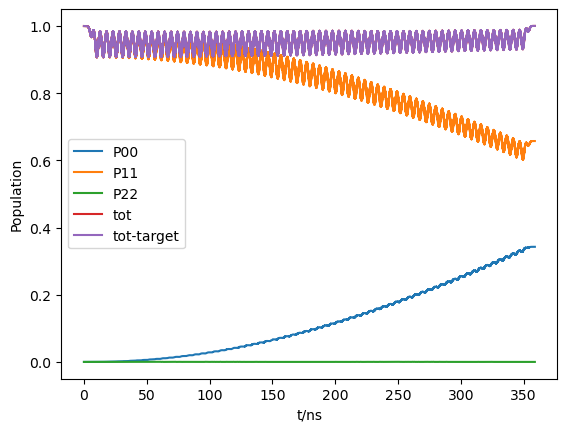

run end
4,run start


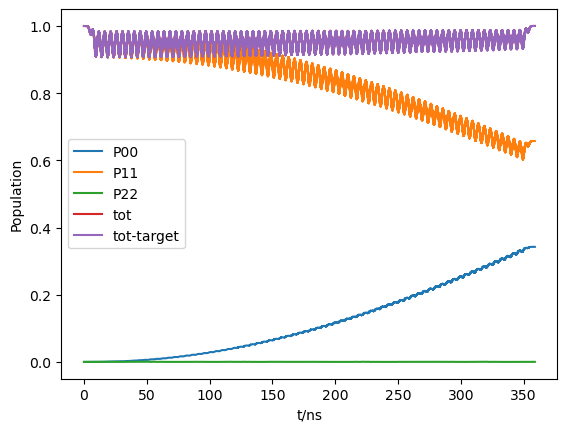

run end
5,run start


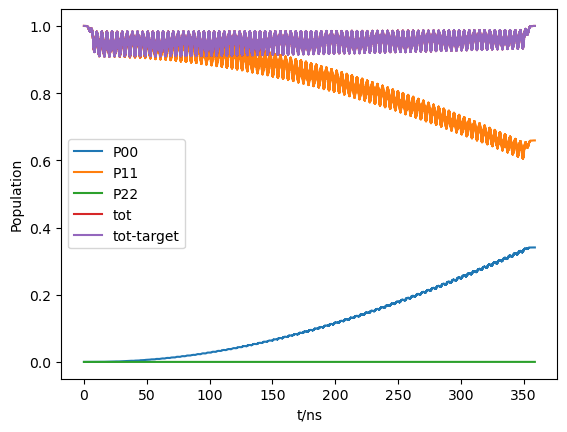

run end
6,run start


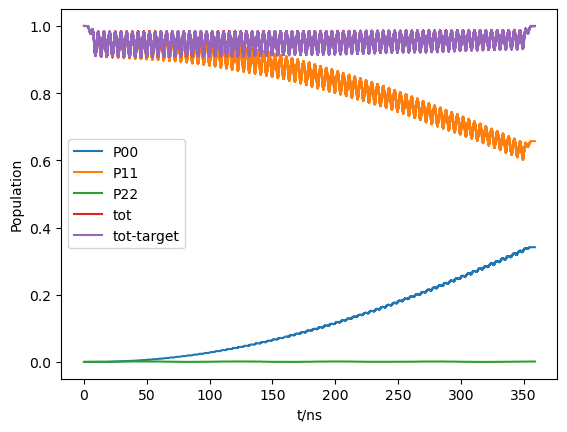

run end
7,run start


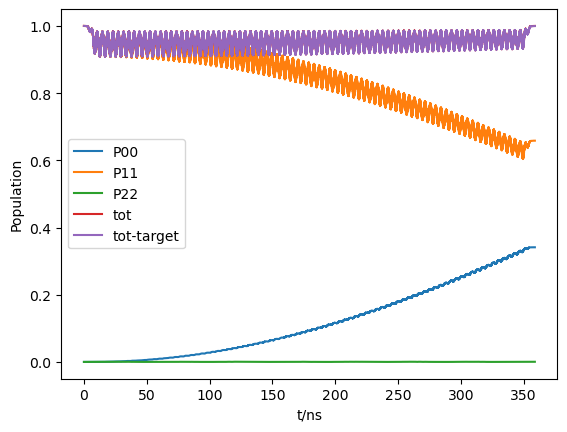

run end
8,run start


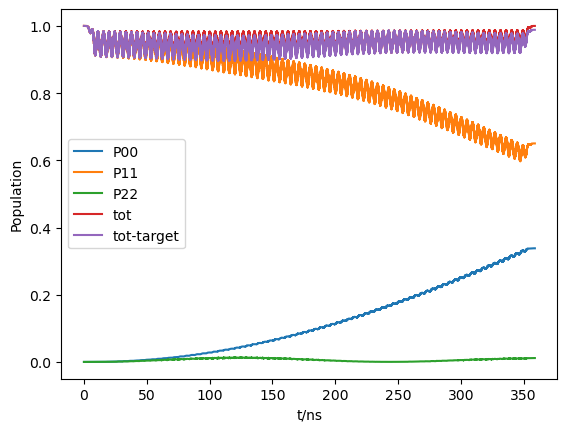

run end
9,run start


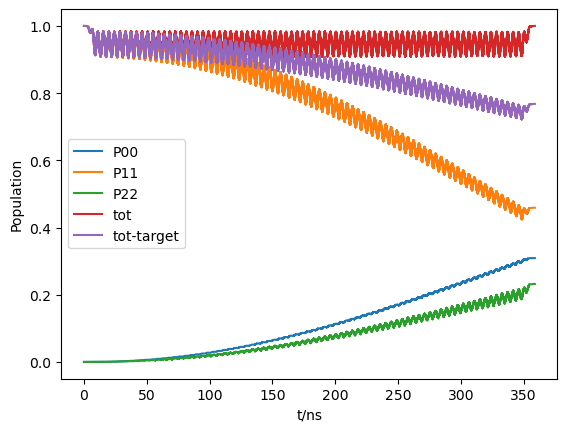

run end
10,run start


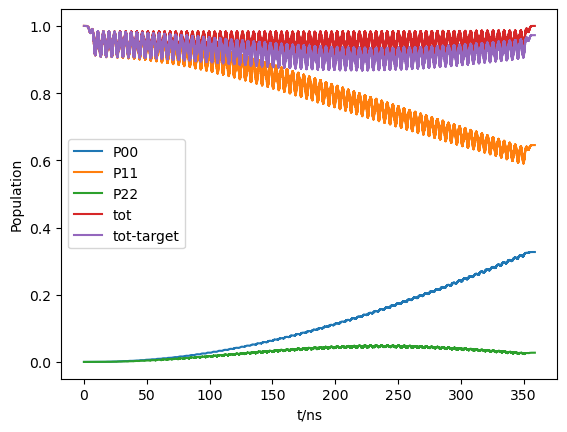

run end
11,run start


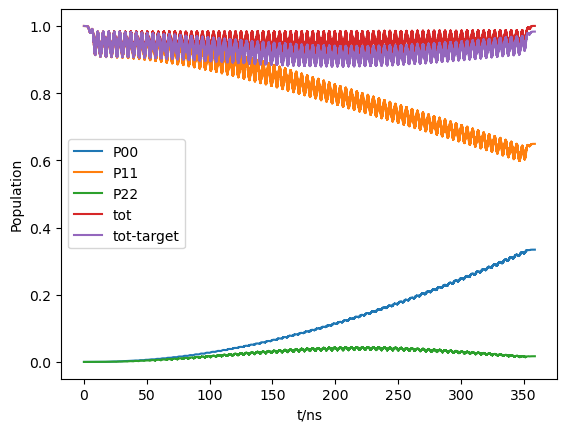

run end
12,run start


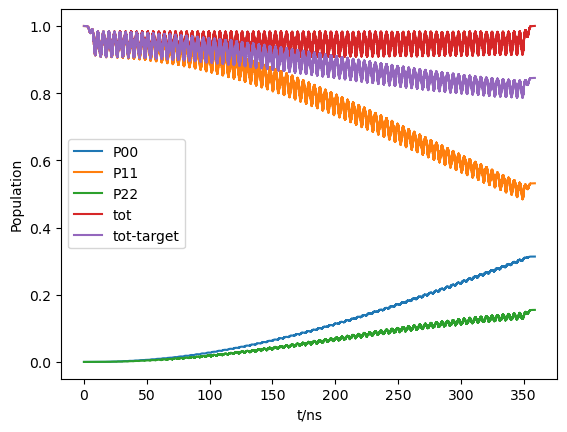

run end
13,run start


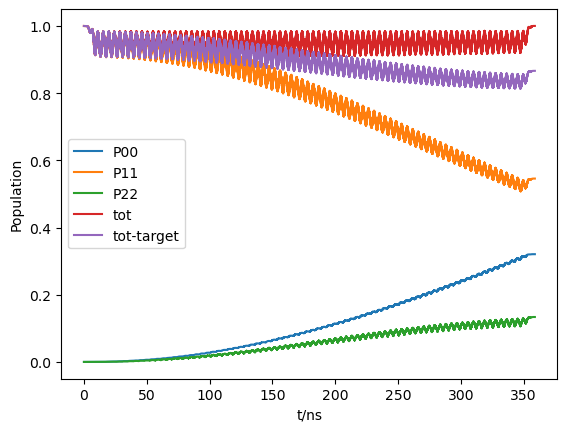

run end
14,run start


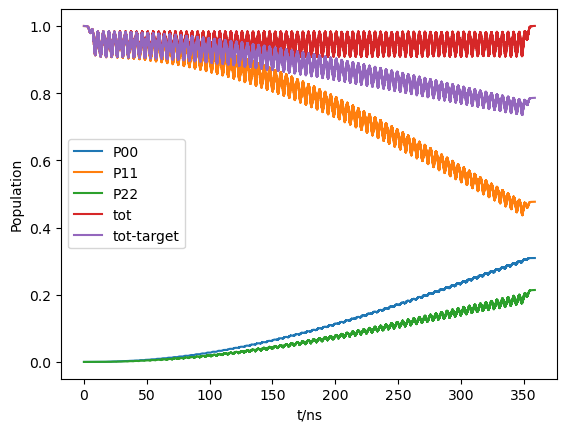

run end
15,run start


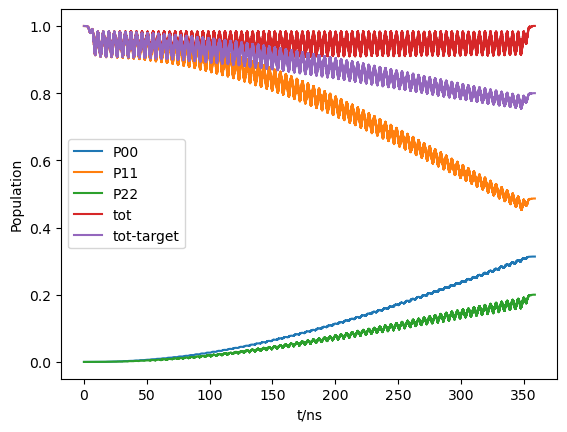

run end
16,run start


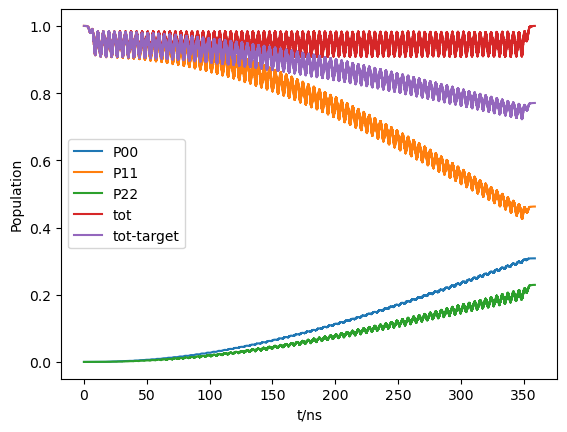

run end
17,run start


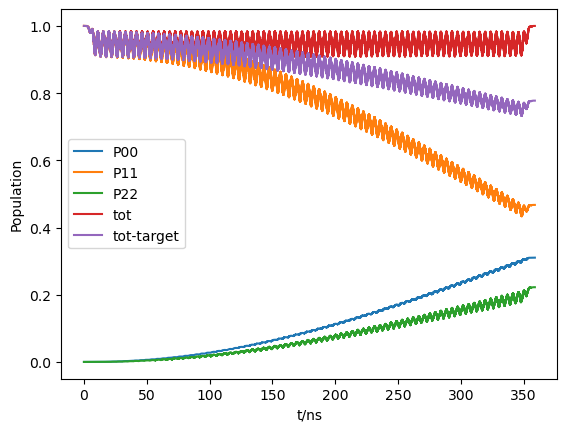

run end
18,run start


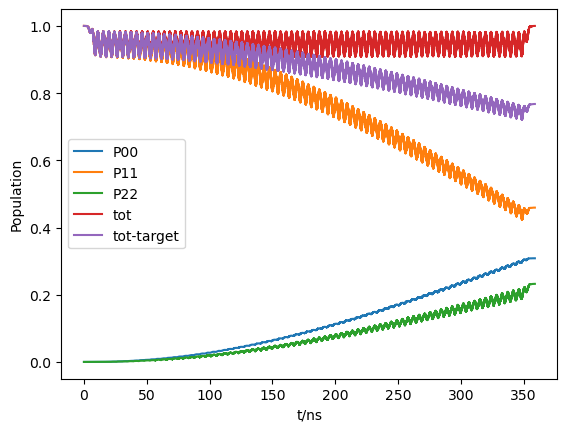

run end
19,run start


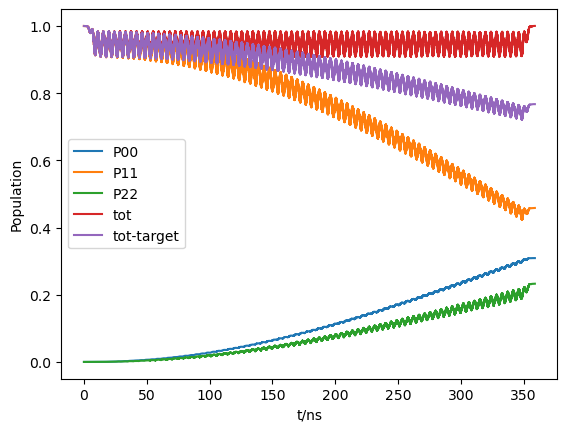

run end
20,run start


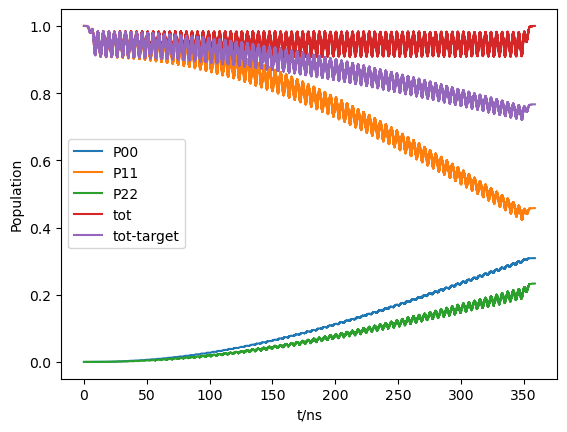

run end




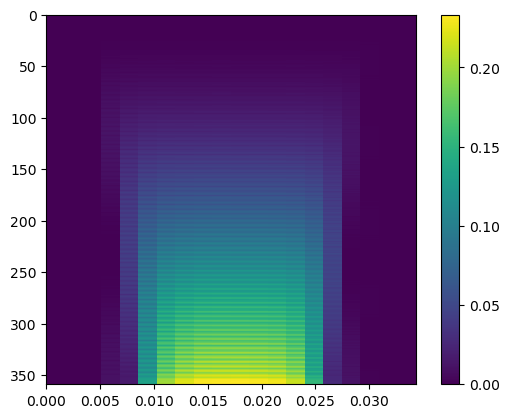

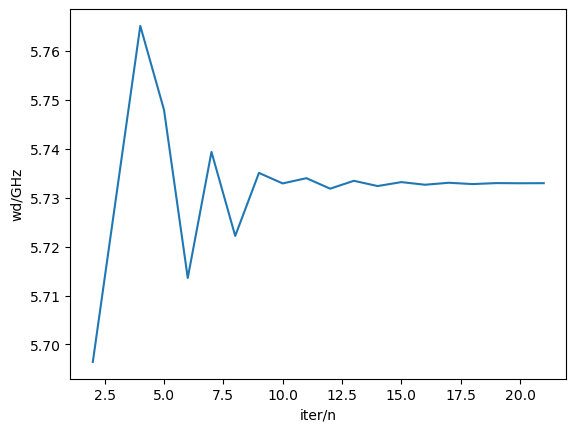

dpi=1.4749297769959112e-05,w_match=5.732960733763674 
 auto_scan_scope end
run start


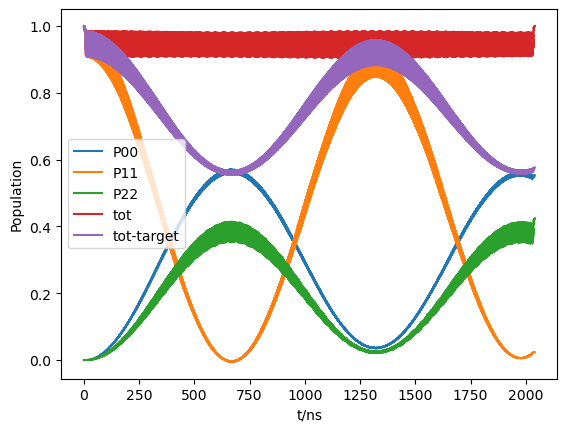

run end
wd_fit start 
 sp=1
correct!=1


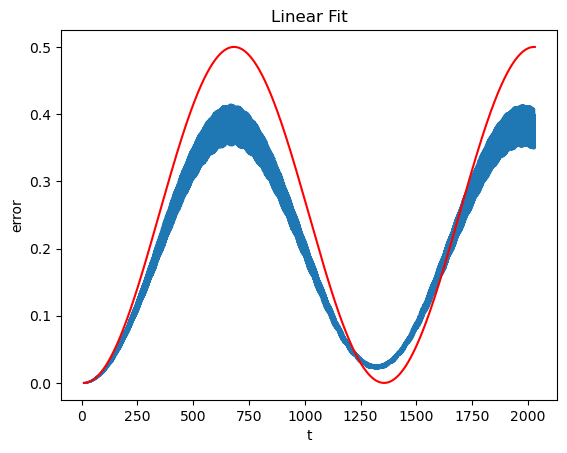

guess value of [d_eff,F,t0]=[0.0005918395212882132, 1, 5.0]
fit coeff [d_eff,F,t0,T]=[0.0007434259939436979, 0.5000000000000794, 9.99999999981516, 1345.123802700573]
 wd_fit end

p_eff=1.2966192060895971
suggest set sp_direct as:[1, 0.47849260756113543]
run start


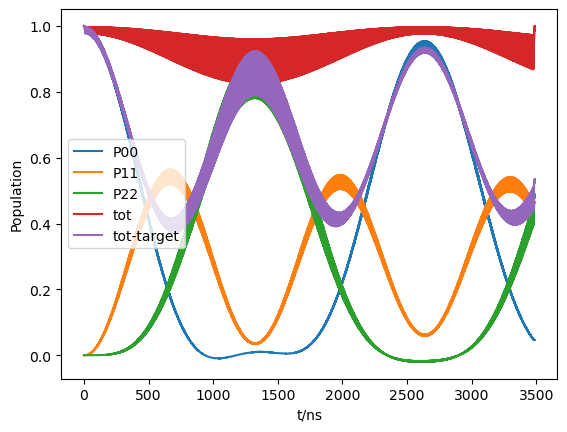

run end


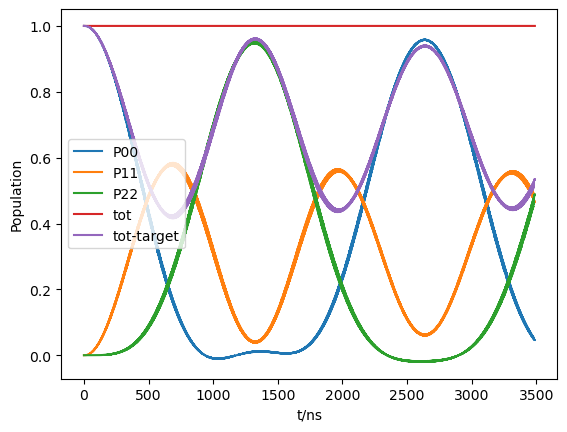

In [ ]:
# wdm=(5.956000029067557+5.731319558030517)/2
# wd=[wdm ,5.731319558030517 ]#single wave
# 5.738450530011672 
wd=[5.956000029067557 ,5.731319558030517 ]#single wave
# wd=[5.940313438079269 ,5.738864629361385 ]#mix wave,single swap 11-22,sp=[1,1]，T~~140ns
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
wd=[5.9550457117450755,5.738864629361385 ]#mix wave,in-step swap[1,1]
a=sideband( level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
            L=1000,   wd=wd,     phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
            rho0=0,  )
# res=a.run(plot=True,norm_plot=True)
# a.auto_scan_scope(sp=1,runplot=True)
auto_result=a.auto_scan_mix_wave_wd_sp(amp=0.2,sp_direct=[1,0.46617831709480284])
# a.d_eff_g

run start


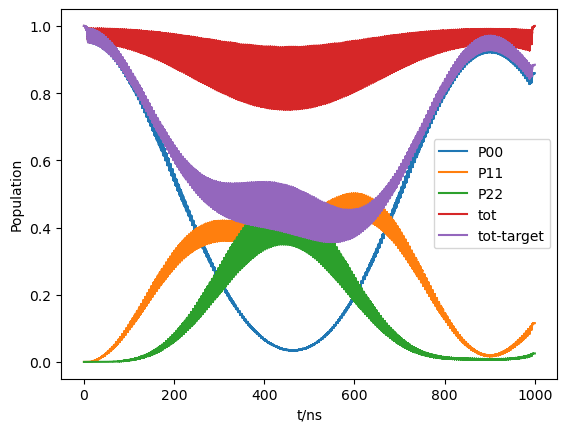

run end


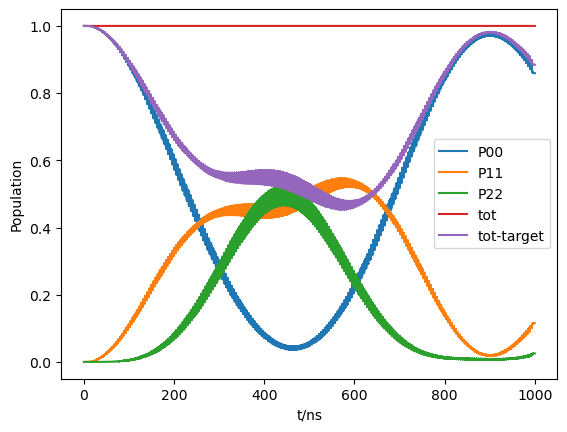

In [ ]:
# DONE
# wdm=(5.956000029067557+5.731319558030517)/2
# wd=[wdm ,5.731319558030517 ]#single wave
# 5.738450530011672 
# wd=[5.956000029067557 ,5.731319558030517 ]#single wave
# wd=[5.940313438079269 ,5.738864629361385 ]#mix wave,single swap 11-22,sp=[1,1]，T~~140ns
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
wd=[5.9550457117450755,5.738864629361385 ]#mix wave,in-step swap[1,1]
a=sideband( level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
            L=1000,   wd=wd,     phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
            rho0=0,  pre_scan=True,              mix=False)
res=a.run(plot=True,norm_plot=True)
# a.auto_scan_scope(sp=1,runplot=True)

run start


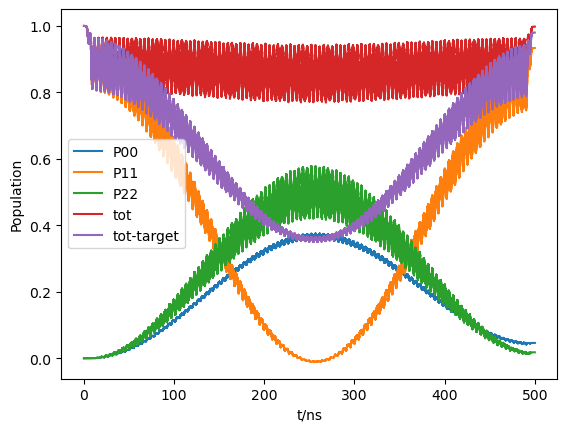

run end


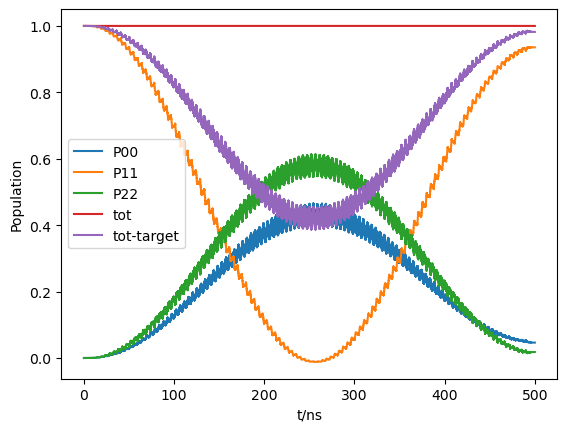

In [ ]:
# wdm=(5.956000029067557+5.731319558030517)/2
# wd=[wdm ,5.731319558030517 ]#single wave
wd=[5.9550457117450755+0*0.00125 ,5.738864629361385 ]#single wave#tist
# 5.738450530011672 
# wd=[5.956000029067557 ,5.731319558030517 ]#single wave
# wd=[5.940313438079269 ,5.738864629361385 ]#mix wave,single swap 11-22,sp=[1,1]，T~~140ns
# wd=[5.9550457117450755,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
# wd=[5.9550457117450755,5.738864629361385 ]#mix wave,in-step swap[1,1]
a=sideband( level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
            L=500,   wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
            rho0=1,  pre_scan=True,              mix=False)
res=a.run(plot=True,norm_plot=True)
# a.auto_scan_scope(sp=1,runplot=True)

run start


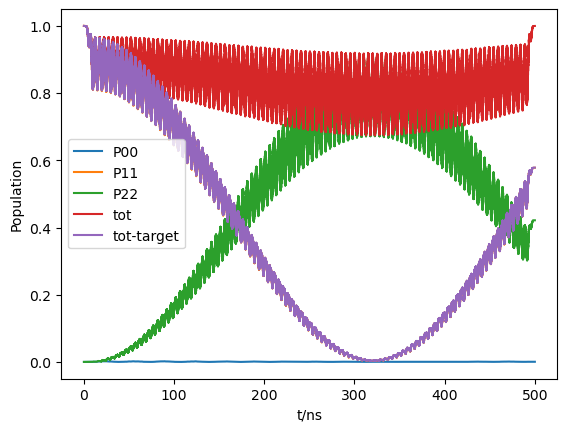

run end


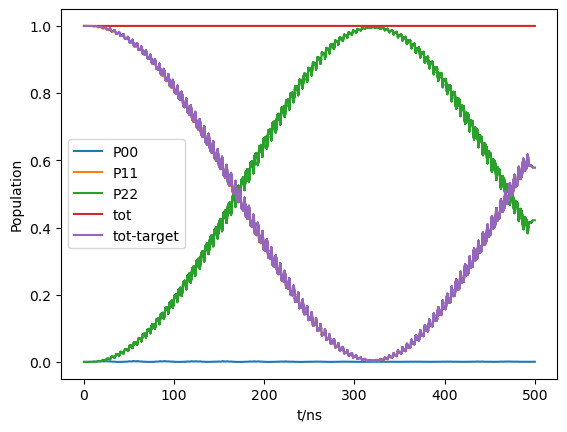

In [ ]:
# wdm=(5.956000029067557+5.731319558030517)/2
# wd=[wdm ,5.731319558030517 ]#single wave
wd=[5.940313438079269 ,5.738864629361385 ]#tist
# 5.738450530011672 
# wd=[5.956000029067557 ,5.731319558030517 ]#single wave
# wd=[5.940313438079269 ,5.738864629361385 ]#mix wave,single swap 11-22,sp=[1,1]，T~~140ns
# wd=[5.9550457117450755,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
# wd=[5.9550457117450755,5.738864629361385 ]#mix wave,in-step swap[1,1]
a=sideband( level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
            L=500,   wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
            rho0=1,  pre_scan=True,              mix=False)
res=a.run(plot=True,norm_plot=True)
# a.auto_scan_scope(sp=1,runplot=True)

auto_scan_scope start 
 sp=1
T for scan:321.09219488680117
iter_num=
1,run start


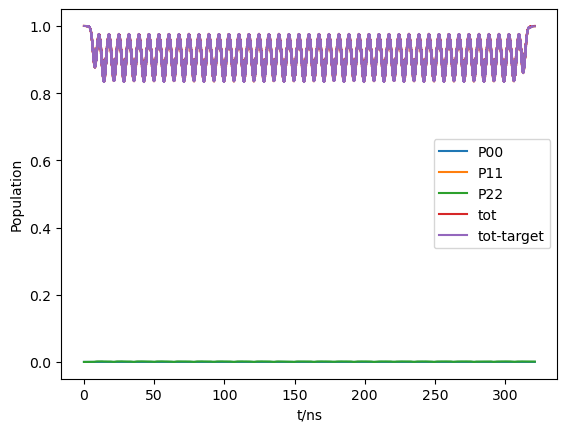

run end
2,run start


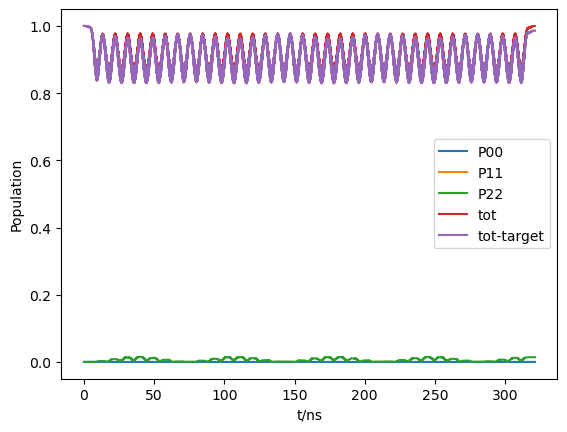

run end
3,run start


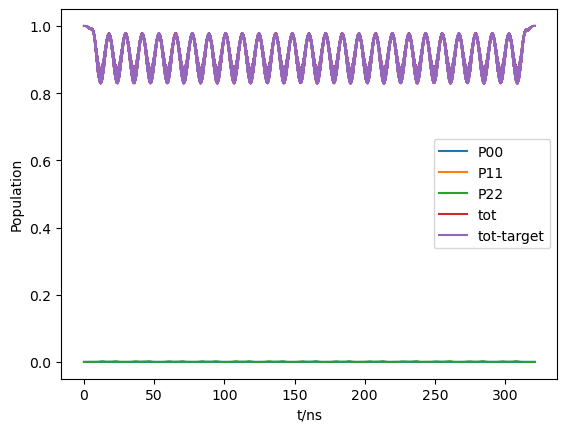

run end
4,run start


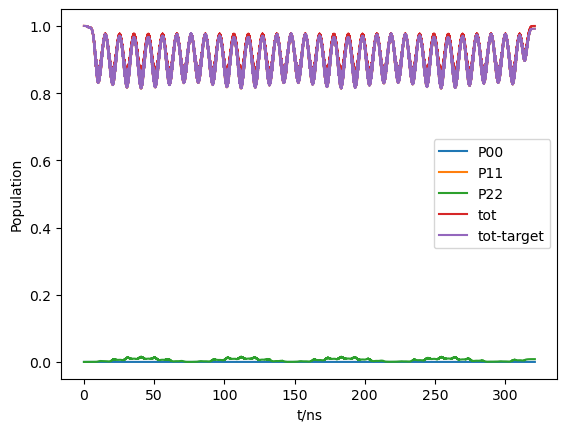

run end
5,run start


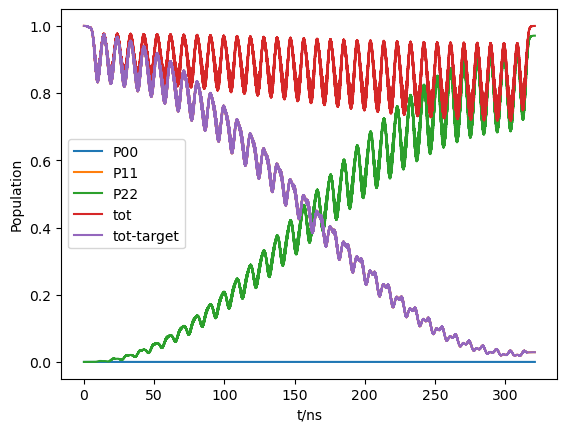

run end
6,run start


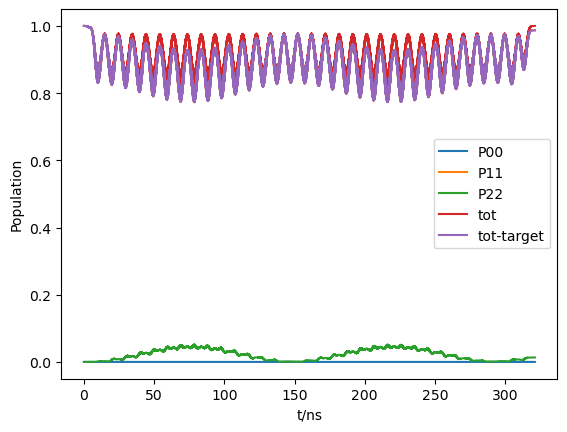

run end
7,run start


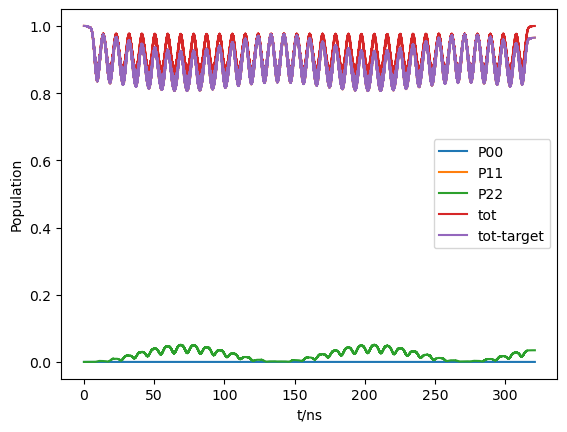

run end
8,run start


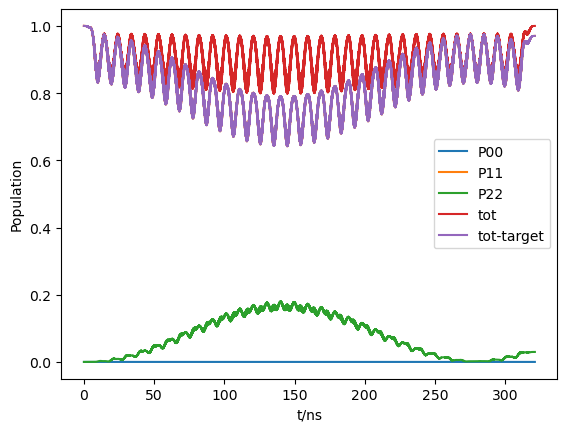

run end
9,run start


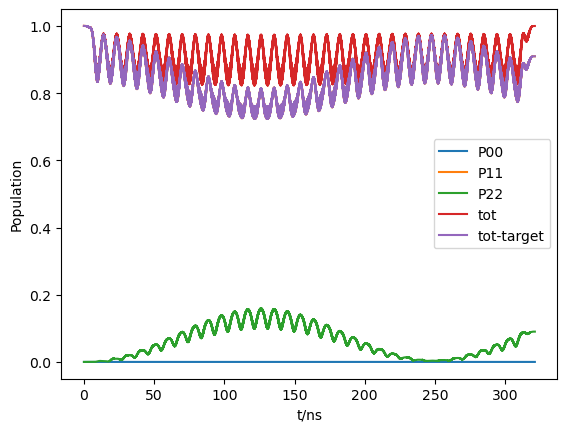

run end
10,run start


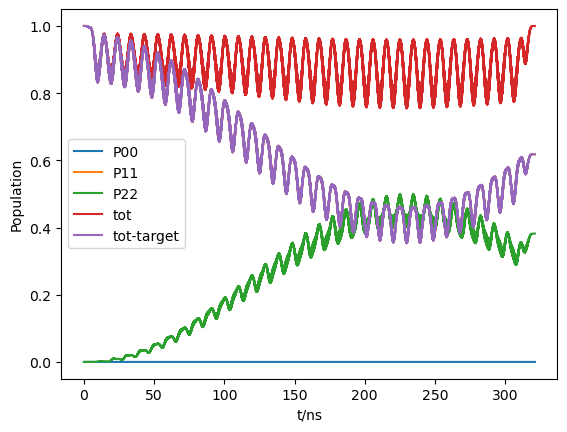

run end
11,run start


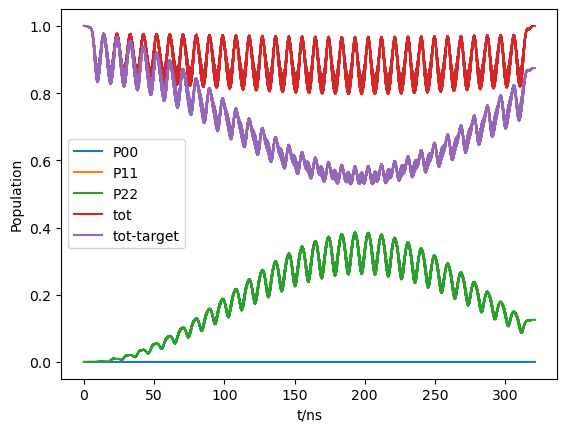

run end
12,run start


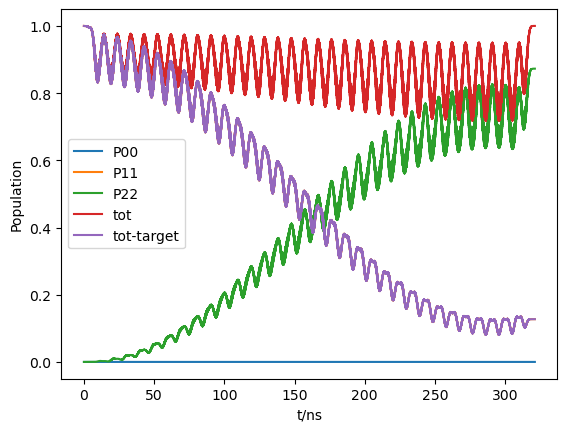

run end
13,run start


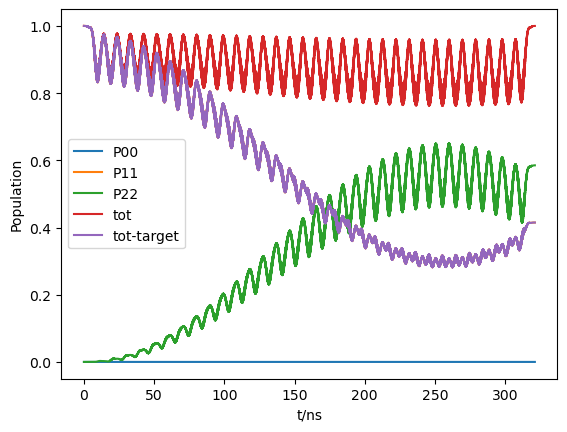

run end
14,run start


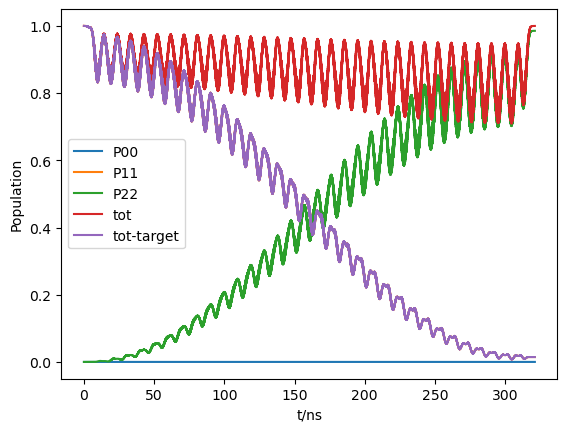

run end
15,run start


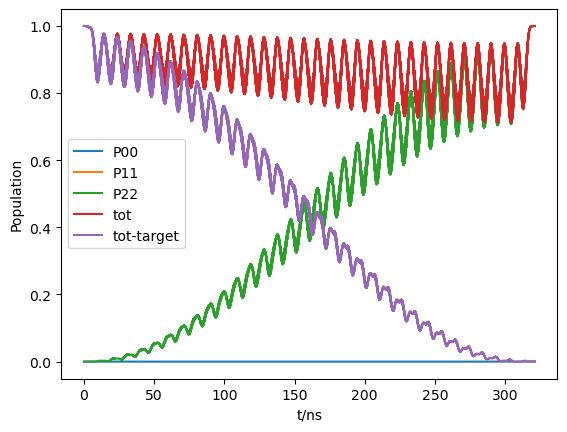

run end




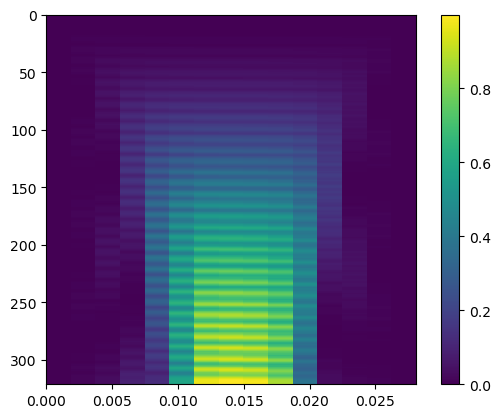

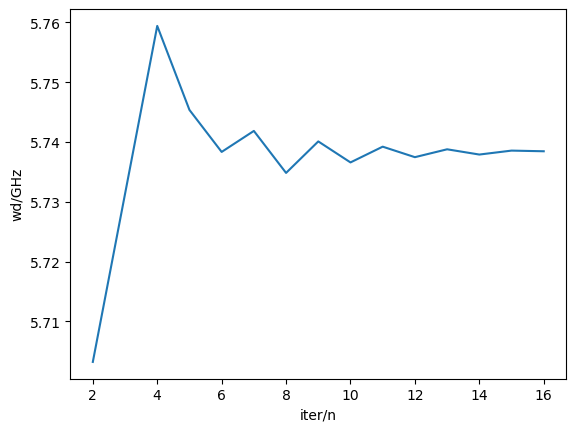

dpi=6.642483710851162e-05,w_match=5.738450530011672 
 auto_scan_scope end


[5.738450530011672,
 [array([[-3.63664993e-19, -3.63664993e-19, -3.63664993e-19, ...,
          -3.63664993e-19, -3.63664993e-19, -3.63664993e-19],
         [-1.31750019e-19, -4.76849771e-19, -3.66937320e-19, ...,
          -1.61730353e-19, -5.41406255e-19, -1.72490319e-19],
         [-2.40471330e-19, -3.02559507e-19, -3.45963328e-19, ...,
          -2.91759837e-19, -3.38141508e-19, -2.03039753e-19],
         ...,
         [ 1.02480499e-03,  1.40244915e-02,  3.46726750e-02, ...,
           1.31319815e-02,  8.23987141e-03,  3.69540438e-05],
         [ 1.02480501e-03,  1.40244915e-02,  3.46726750e-02, ...,
           1.31319815e-02,  8.23987142e-03,  3.69540421e-05],
         [ 1.02480501e-03,  1.40244915e-02,  3.46726750e-02, ...,
           1.31319815e-02,  8.23987142e-03,  3.69540421e-05]]),
  5.717277028590702,
  5.7453620874703315,
  100]]

In [ ]:
wdm=(5.956000029067557)
wd=[wdm ,5.731319558030517 ]#single wave
5.738450530011672 
# wd=[5.956000029067557 ,5.731319558030517 ]#single wave
# wd=[5.940313438079269 ,5.738864629361385 ]#mix wave,single swap 11-22,sp=[1,1]，T~~140ns
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
# wd=[5.9550457117450755,5.738864629361385]#mix wave,in-step swap[1,1]
a=sideband( level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
            L=500,   wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
            rho0=1,  pre_scan=True,              mix=False)
# a.run(plot=True)
a.auto_scan_scope(sp=1,runplot=True)


++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++

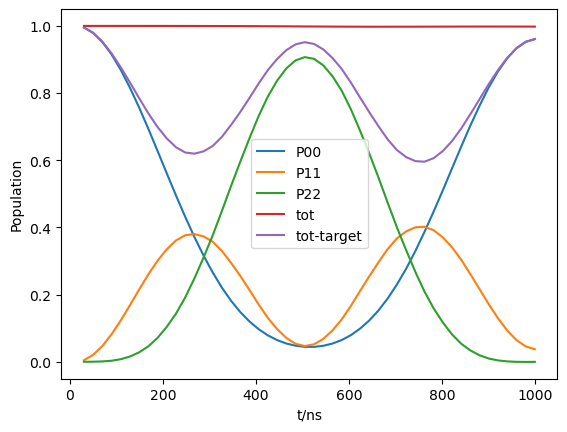

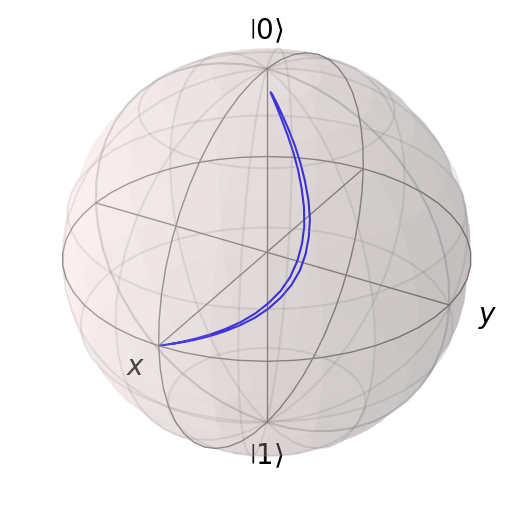

run end


__main__.sideband.run_fin.<locals>.output

In [ ]:
# wd=[5.944786800528401 ,5.752985543492477 ]#single wave
wd=[5.9550457117450755,5.738864629361385]#mix wave,in-step swap[1,1]
# wd=[5.940313438079269 ,5.748154312047415 ]#mix wave,single swap 11-22,sp=[1,1]
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
a=sideband(level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
           L=3000,  wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
           rho0=0,  rho_tar=1,  pre_scan=True)
# a.auto_scan_scope(sp=0,runplot=True)
# a.run(True)
a.run_fin(30,1000,50,True)
# a.d_eff_g
# a.s_g
# a.amp

run start


c:\Users\1163080609\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


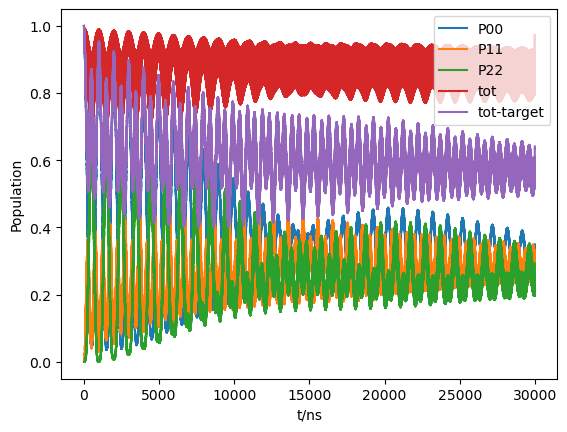

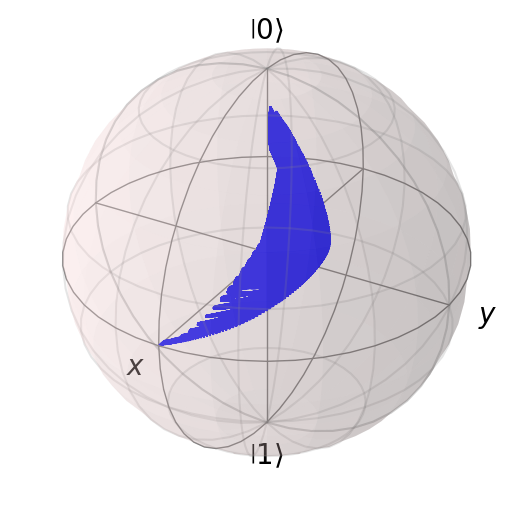

run end


In [ ]:
# wd=[5.944786800528401 ,5.752985543492477 ]#single wave
wd=[5.9550457117450755,5.738864629361385]#mix wave,in-step swap[1,1]
# wd=[5.940313438079269 ,5.748154312047415 ]#mix wave,single swap 11-22,sp=[1,1]
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
a=sideband(level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
           L=30000,  wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
           rho0=0,  rho_tar=1,  pre_scan=True)
# a.auto_scan_scope(sp=0,runplot=True)
res=a.run(True)
# a.d_eff_g
# a.s_g
# a.amp

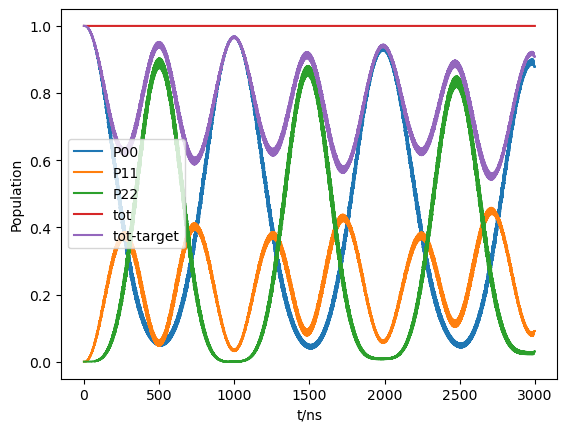

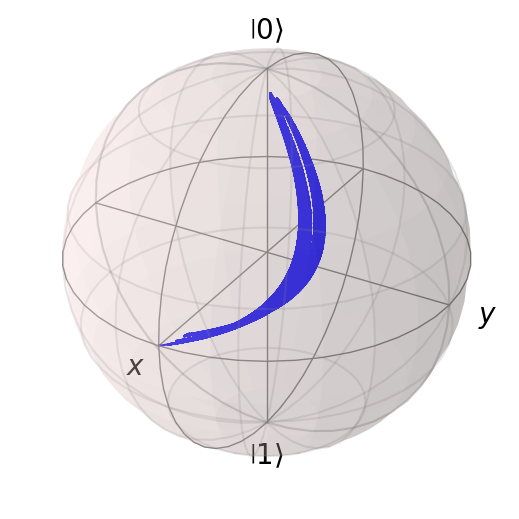

In [ ]:
# wd=[5.944786800528401 ,5.752985543492477 ]#single wave
wd=[5.9550457117450755,5.738864629361385]#mix wave,in-step swap[1,1]
# wd=[5.940313438079269 ,5.748154312047415 ]#mix wave,single swap 11-22,sp=[1,1]
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
a=sideband(level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
           L=3000,  wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
           rho0=0,  rho_tar=1,  pre_scan=True)
# a.auto_scan_scope(sp=0,runplot=True)
res=a.run(plot=False,norm_plot=True)
# a.d_eff_g
# a.s_g
# a.amp

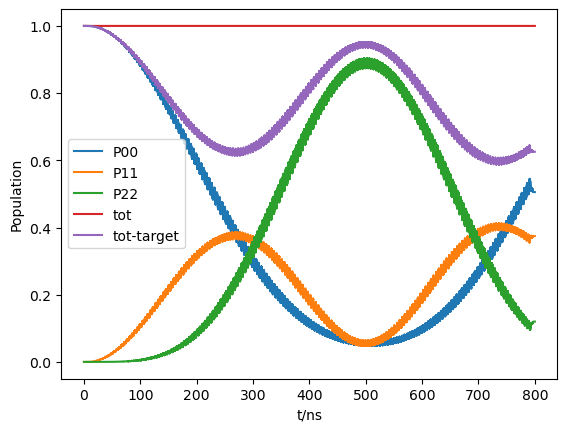

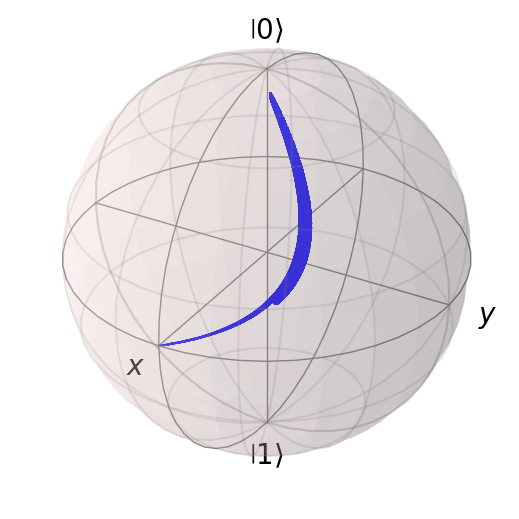

mix_wave_fit start 
 sp=
<class 'numpy.ndarray'>


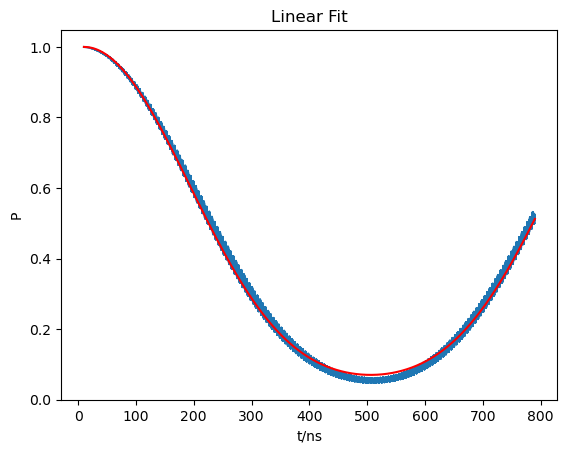

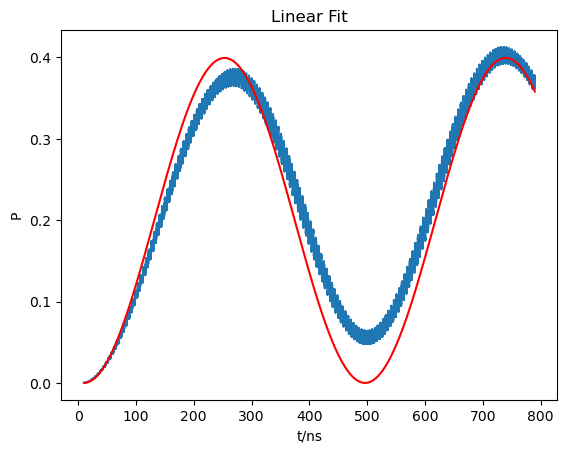

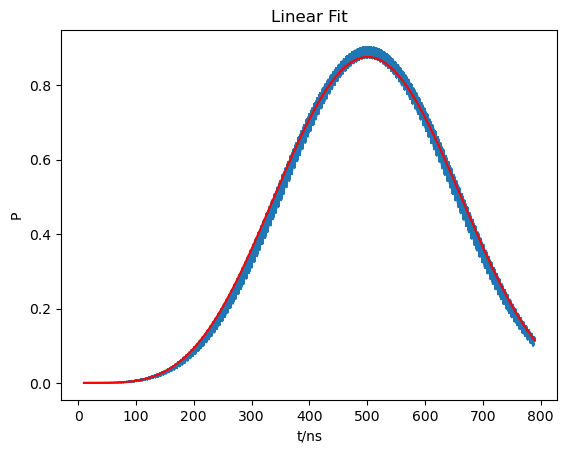

d_eff,F,t0,p2:		guess		coeff
[0.0010934565354116786, 0.5, 5.0, 1.366]
[0.0010082549578765113, 1.8934293871675223e-06, 9.999999975758023, 1.3121004857392298]
[0.0010283306283725019, 0.3993724361326639, 9.99999839122238, 1.2263476006151273]
[0.0010188408470429605, 0.21913959594095464, 9.999611548056848, [1.4433612478210123, 0.6928272471702162]]

 mix_wave_fit end


''

In [ ]:
# wd=[5.944786800528401 ,5.752985543492477 ]#single wave
wd=[5.9550457117450755,5.738864629361385]#mix wave,in-step swap[1,1]
# wd=[5.940313438079269 ,5.748154312047415 ]#mix wave,single swap 11-22,sp=[1,1]
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
a=sideband(level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
           L=800,  wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
           rho0=0,  rho_tar=1,  pre_scan=True)
res=a.run(plot=False,norm_plot=True)
gc=a.mix_wave_fit(res)


# p-fit
# 1236,1287,1362---500
# 1208,1288,1076---400
# 1213,1288,nan ---300
# 1275,1263,1425---600
# 1312,1226,1443---800
# 1341,1218,1444---1000

run start


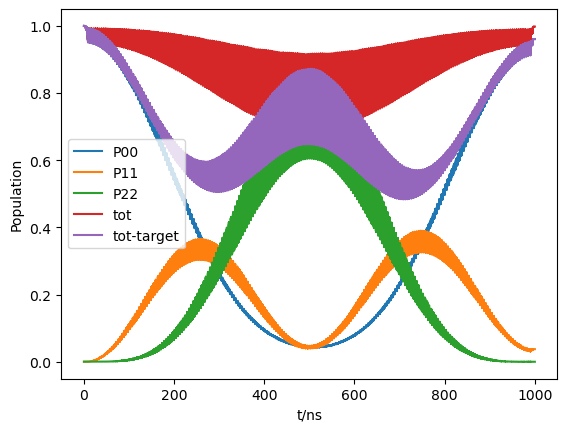

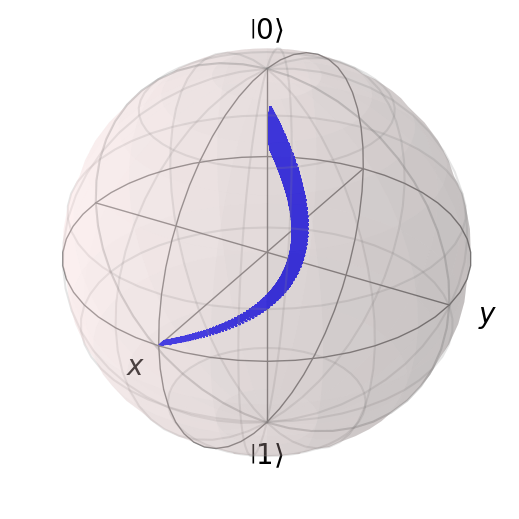

run end


Result object with mesolve data.
--------------------------------
expect = True
num_expect = 3, num_collapse = 0

In [ ]:
# wd=[5.944786800528401 ,5.752985543492477 ]#single wave
wd=[5.9550457117450755,5.738864629361385]#mix wave,in-step swap[1,1]
# wd=[5.940313438079269 ,5.748154312047415 ]#mix wave,single swap 11-22,sp=[1,1]
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
a=sideband(level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
           L=1000,  wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
           rho0=0,  rho_tar=1,  pre_scan=True)
# a.auto_scan_scope(sp=0,runplot=True)
a.run(True)
# a.d_eff_g
# a.s_g
# a.amp

run start


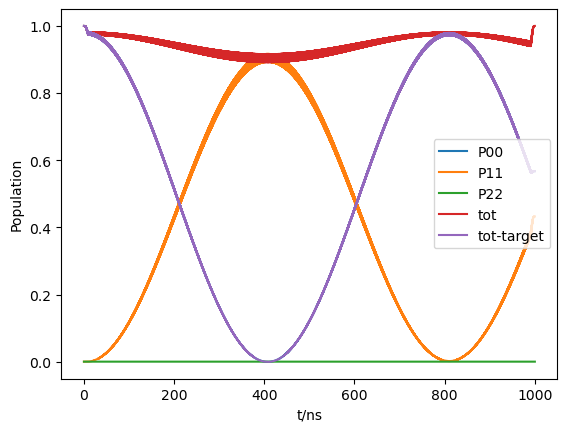

run end
run start


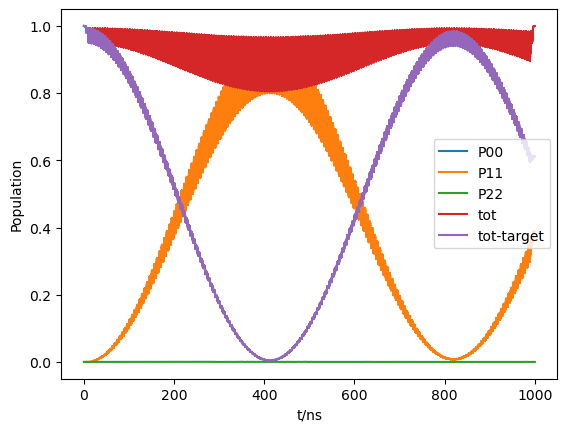

run end


Result object with mesolve data.
--------------------------------
expect = True
num_expect = 3, num_collapse = 0

In [ ]:
wd=[5.956000029067557 ,5.752985543492477 ]#single wave
# wd=[5.9550457117450755,5.738864629361385]#mix wave,in-step swap[1,1]
# wd=[5.940313438079269 ,5.748154312047415 ]#mix wave,single swap 11-22,sp=[1,1]
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
a=sideband(level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
           L=1000,  wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0*0.46617831709480284],
           rho0=0,  rho_tar=1,  pre_scan=True)
# a.auto_scan_scope(sp=0,runplot=True)
a.run(True,bloch=False)
# a.ksp_g
# a.d_eff_g
# a.s_g
# a.amp

# wd=[5.944786800528401 ,5.752985543492477 ]#single wave
# wd=[5.9550457117450755,5.738864629361385]#mix wave,in-step swap[1,1]
# wd=[5.940313438079269 ,5.748154312047415 ]#mix wave,single swap 11-22,sp=[1,1]
wd=[5.956000029067557 ,5.731319558030517 ]#single wave
wd=[5.940313438079269 ,5.738864629361385 ]#mix wave,single swap 11-22,sp=[1,1]，T~~140ns
wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
a=sideband(level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
           L=1000,  wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
           rho0=0,  rho_tar=1,  pre_scan=True)
# a.auto_scan_scope(sp=0,runplot=True)
a.run(True,bloch=False)
# a.ksp_g
# a.d_eff_g
# a.s_g
# a.amp

run start


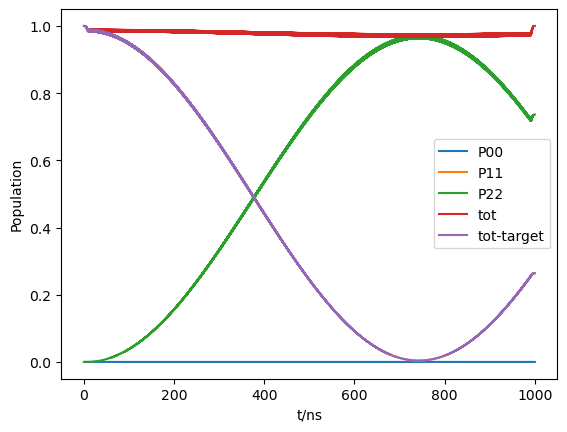

run end
run start


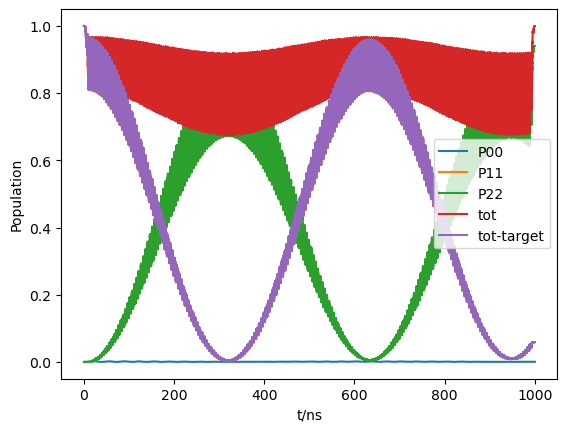

run end


Result object with mesolve data.
--------------------------------
expect = True
num_expect = 3, num_collapse = 0

In [ ]:
wd=[5.956000029067557 ,5.731319558030517 ]#single wave
# wd=[5.9550457117450755,5.738864629361385]#mix wave,in-step swap[1,1]
# wd=[5.940313438079269 ,5.748154312047415 ]#mix wave,single swap 11-22,sp=[1,1]
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
a=sideband(level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
           L=1000,  wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[0,0.46617831709480284],
           rho0=1,  rho_tar=2,  pre_scan=True)
# a.auto_scan_scope(sp=1,runplot=True)
a.run(True,bloch=False)
# a.ksp_g
# a.d_eff_g
# a.s_g
# a.amp



# wd=[5.944786800528401 ,5.752985543492477 ]#single wave
# wd=[5.9526748296470355,5.748154312047415]#mix wave,[1,1]
wd=[5.956000029067557 ,5.731319558030517 ]#single wave
wd=[5.940313438079269 ,5.738864629361385 ]#mix wave,single swap 11-22,sp=[1,1]，T~~140ns
a=sideband(level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
           L=1000,   wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
           rho0=1,  rho_tar=2,  pre_scan=True)
# a.auto_scan_scope(sp=1,runplot=True)
a.run(True,bloch=False)
# a.d_eff_g
# a.s_g
# a.amp

auto_scan_scope start 
 sp=1
T for scan:311.764409826674
iter_num=
1,run start


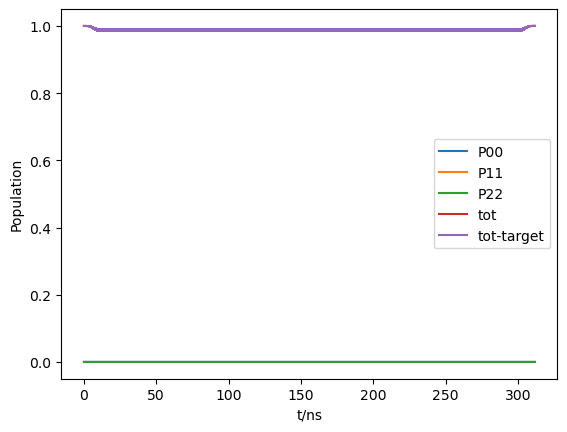

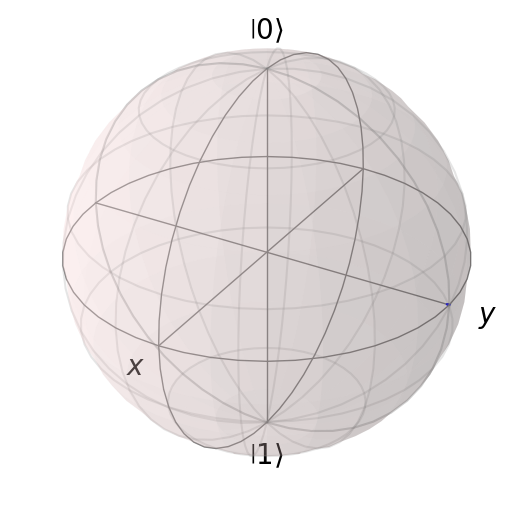

run end
2,run start


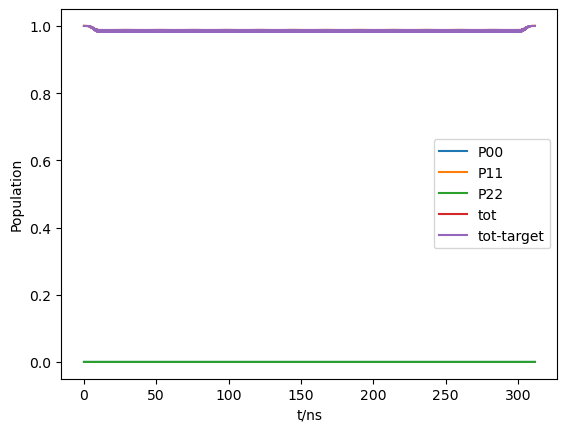

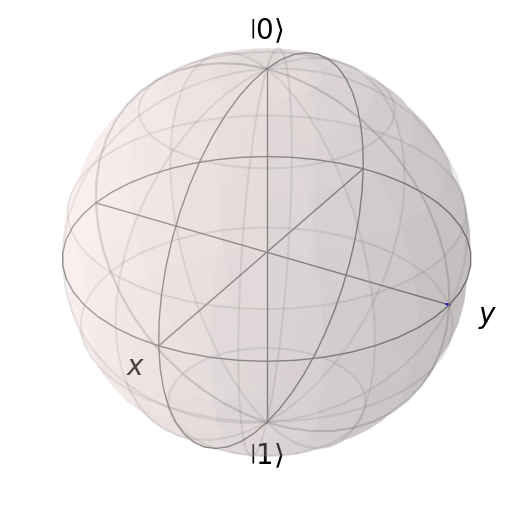

run end
3,run start


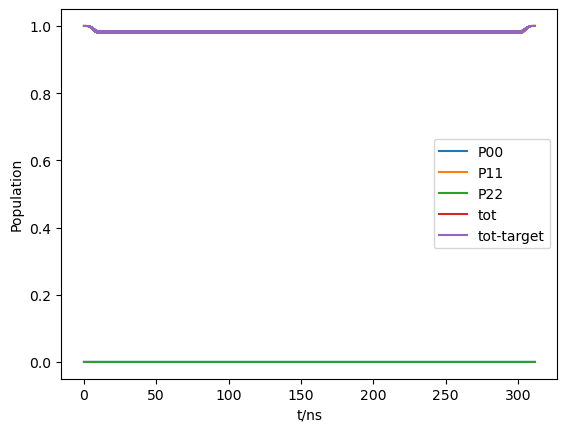

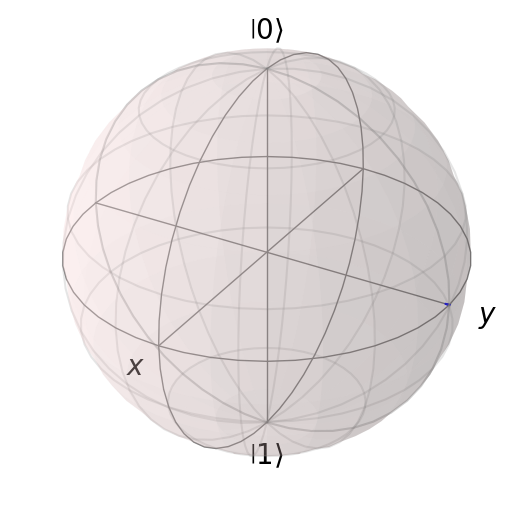

run end
4,run start


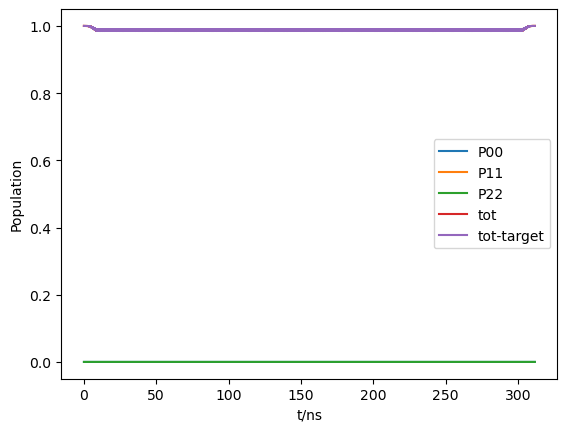

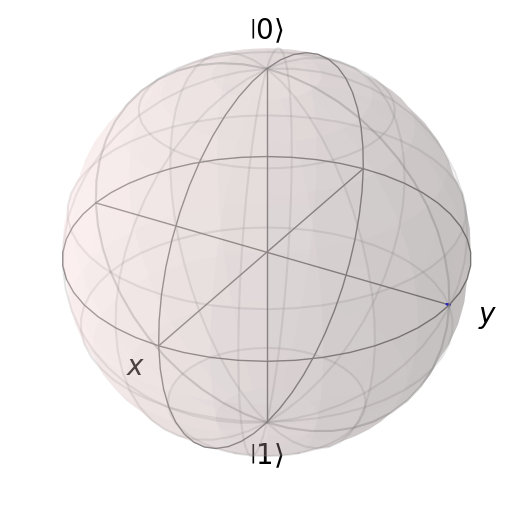

run end
5,run start


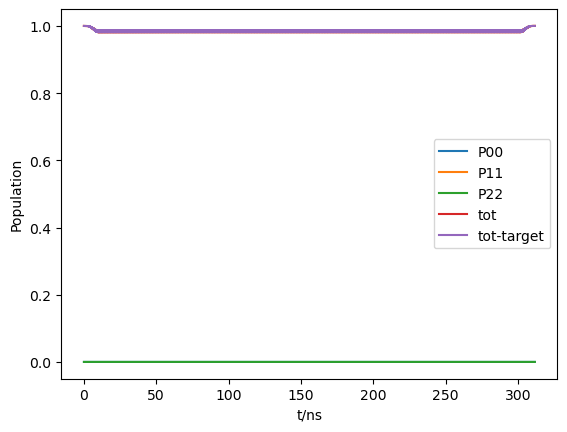

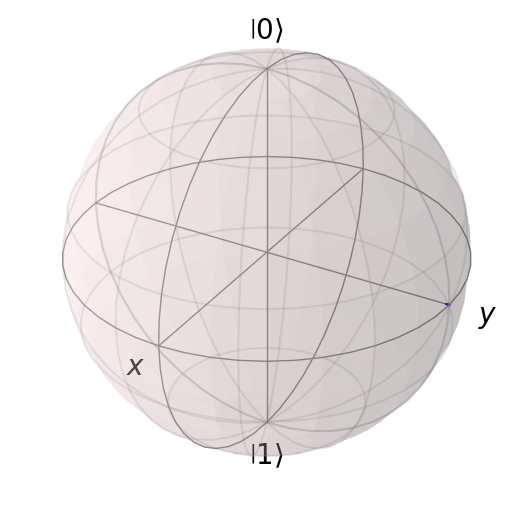

run end
6,run start


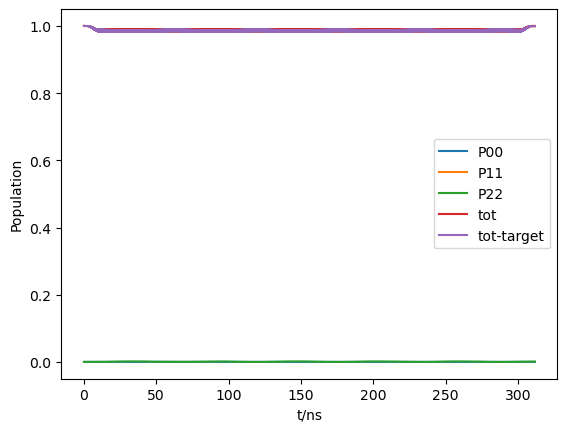

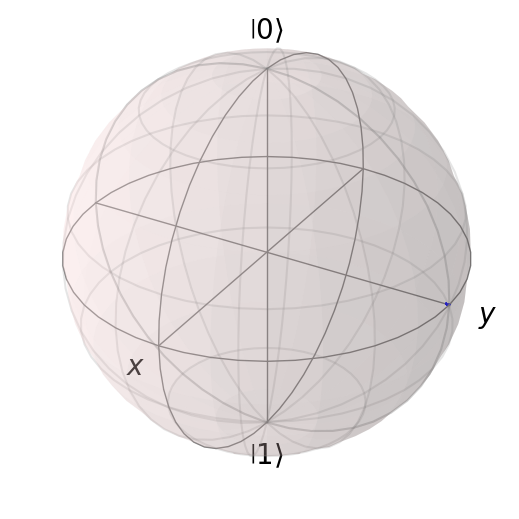

run end
7,run start


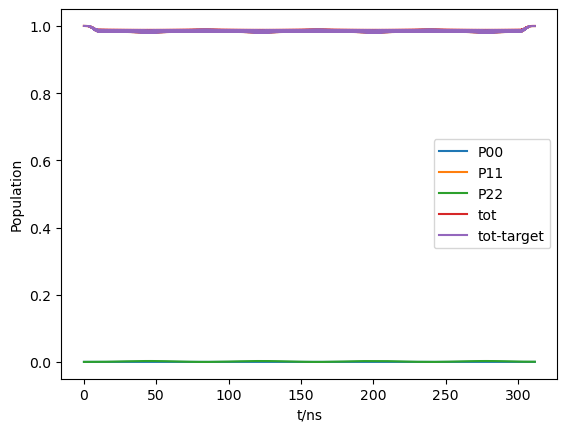

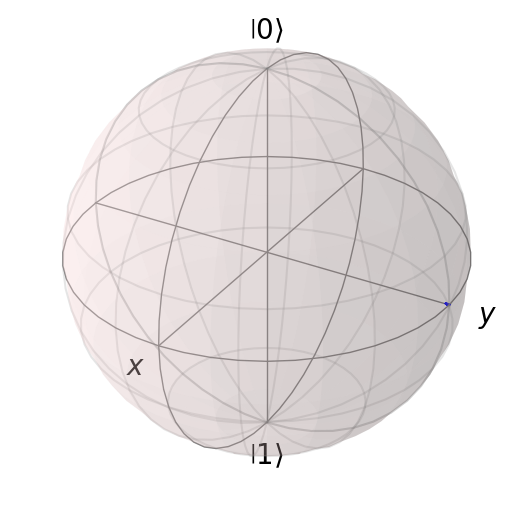

run end
8,run start


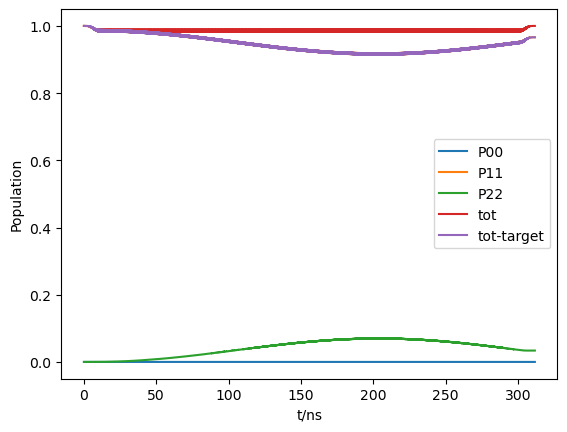

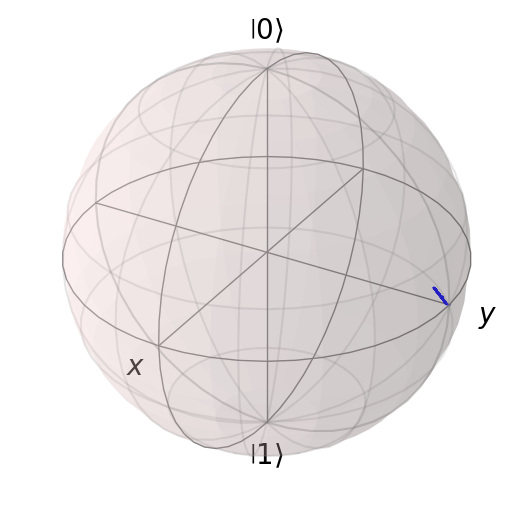

run end
9,run start


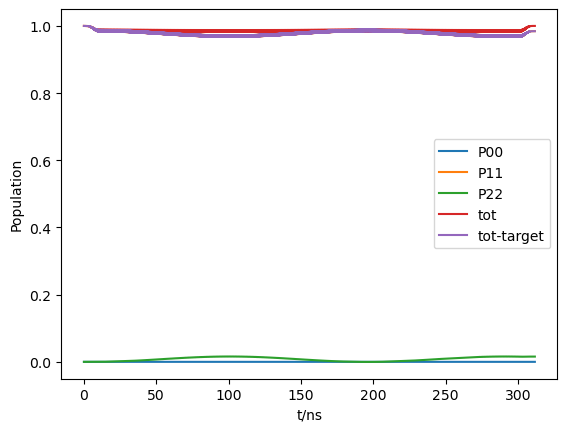

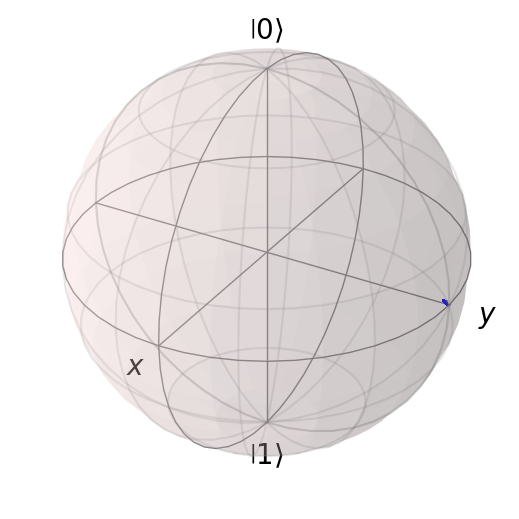

run end
10,run start


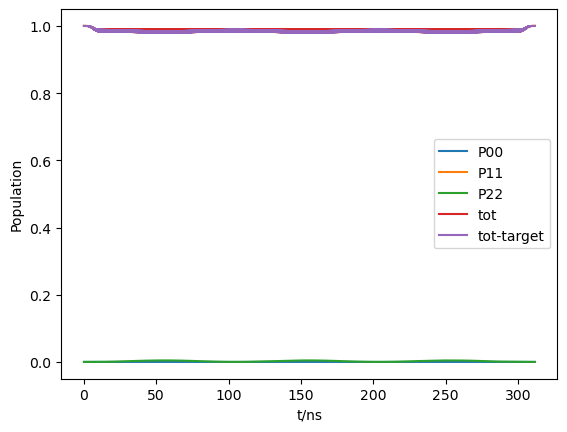

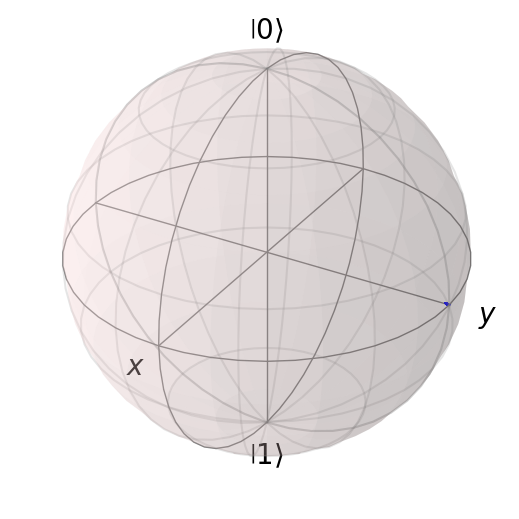

run end
11,run start


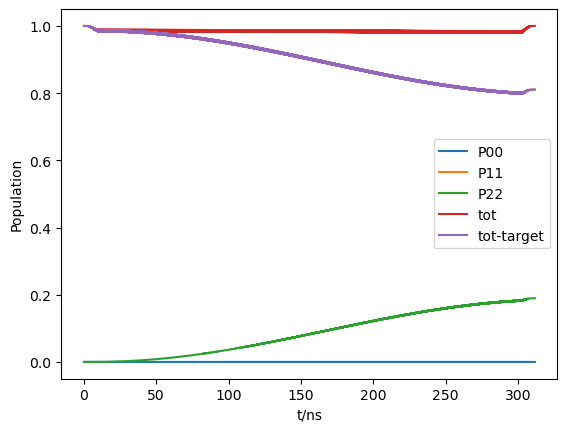

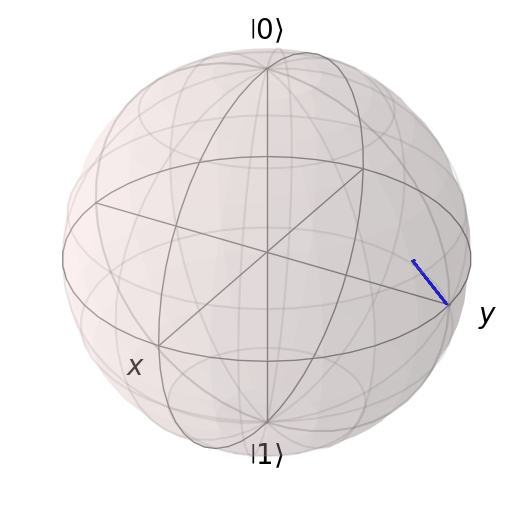

run end
12,run start


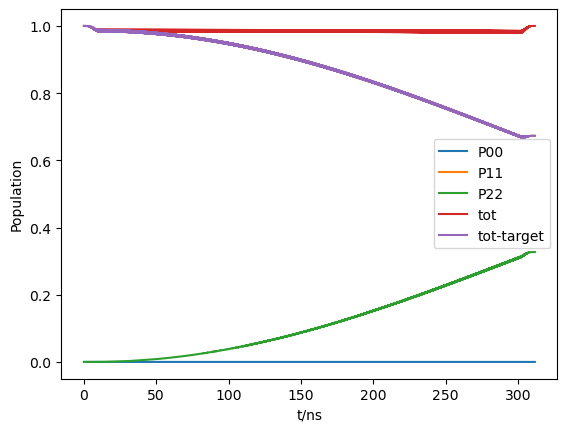

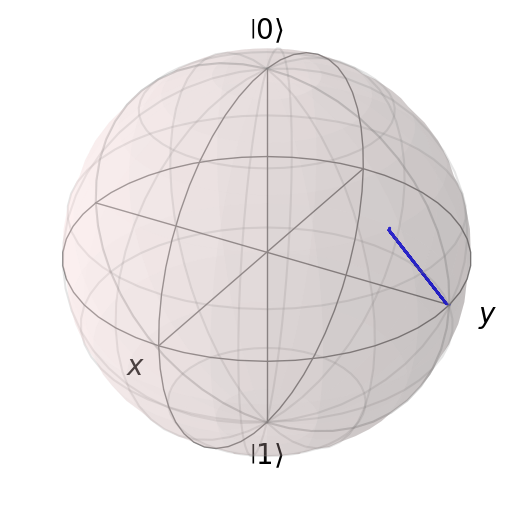

run end
13,run start


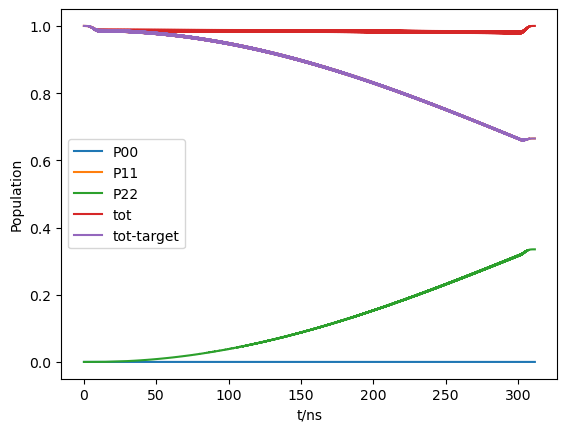

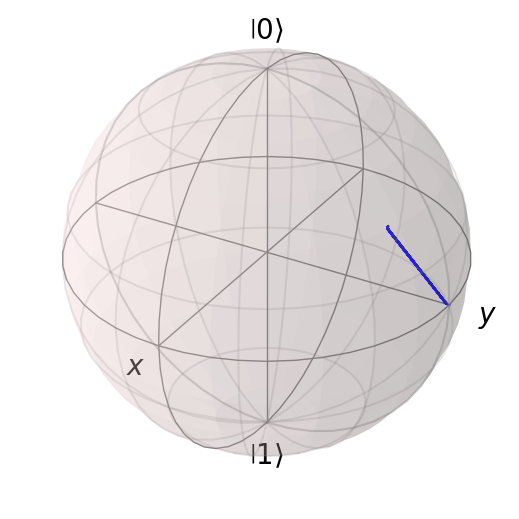

run end
14,run start


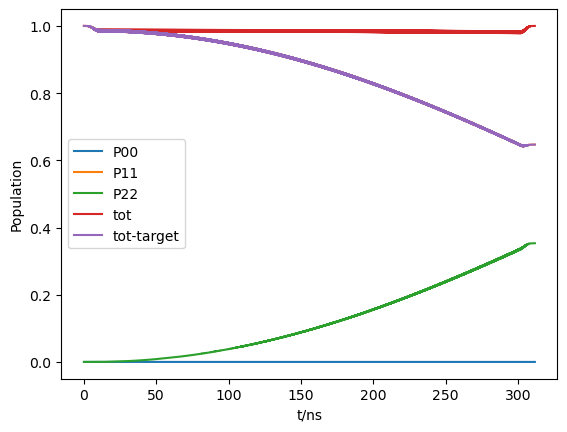

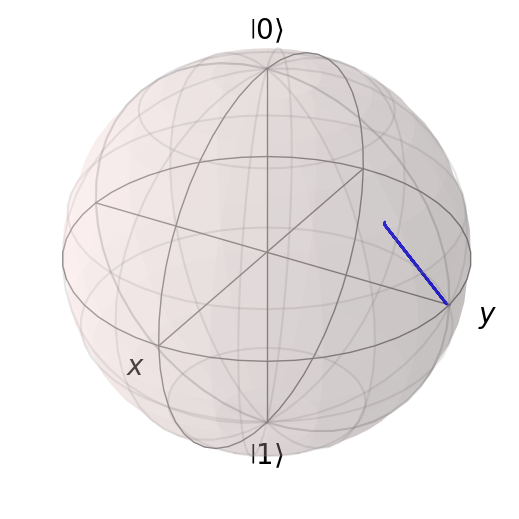

run end
15,run start


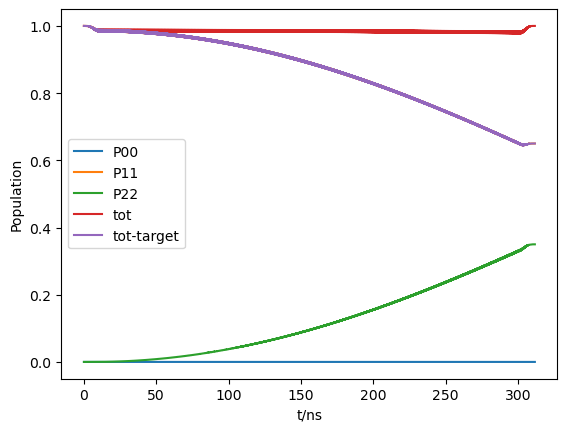

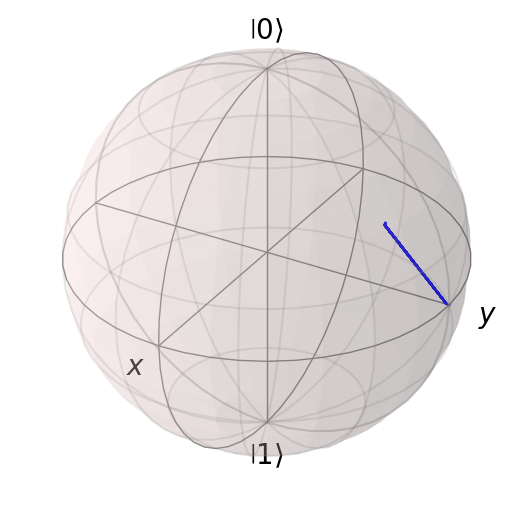

run end
16,run start


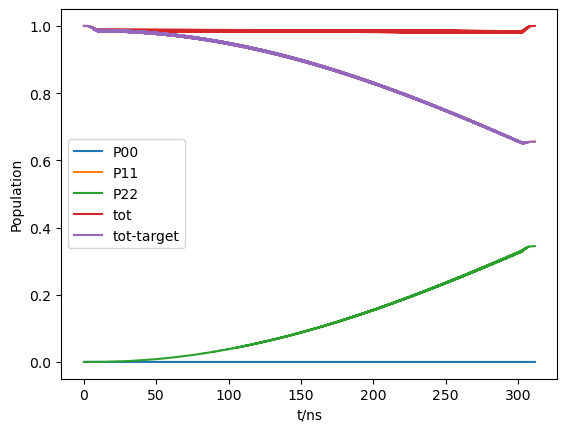

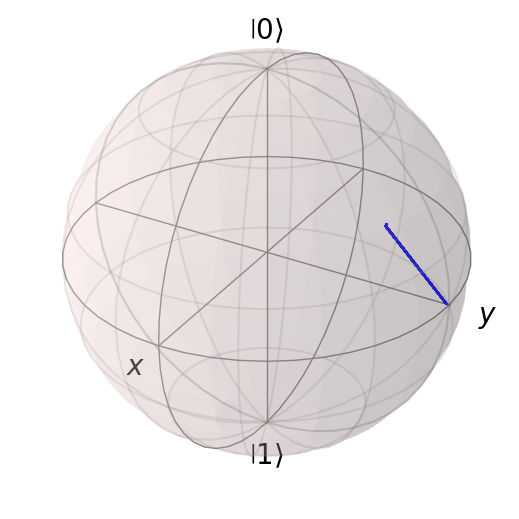

run end
17,run start


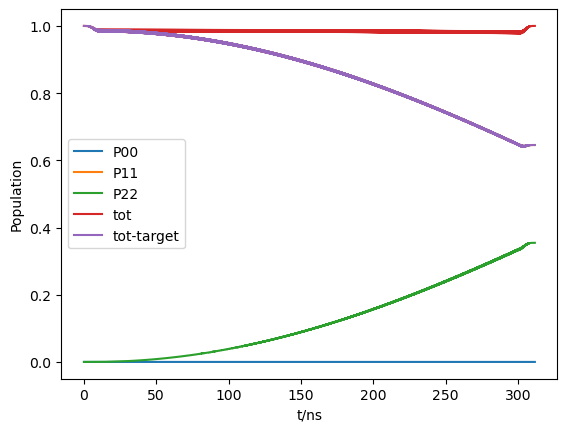

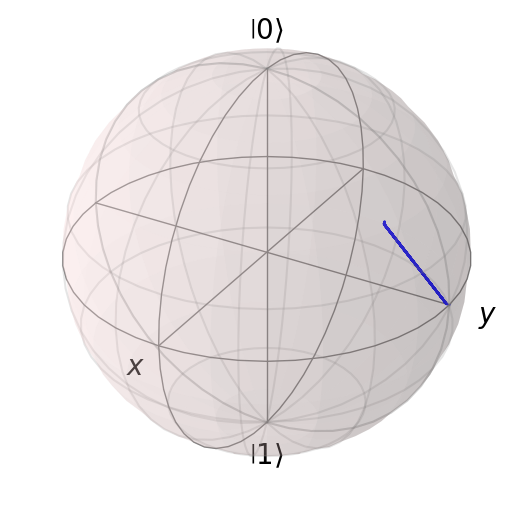

run end
18,run start


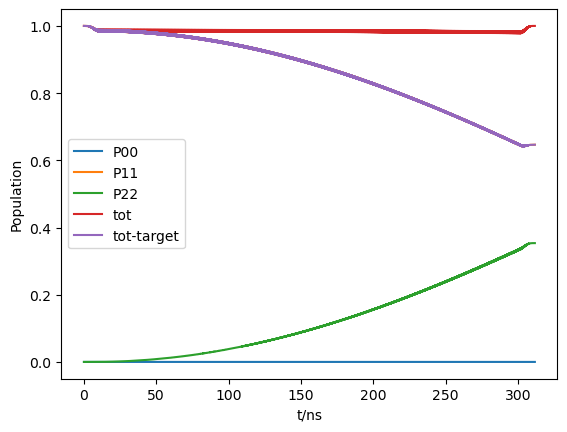

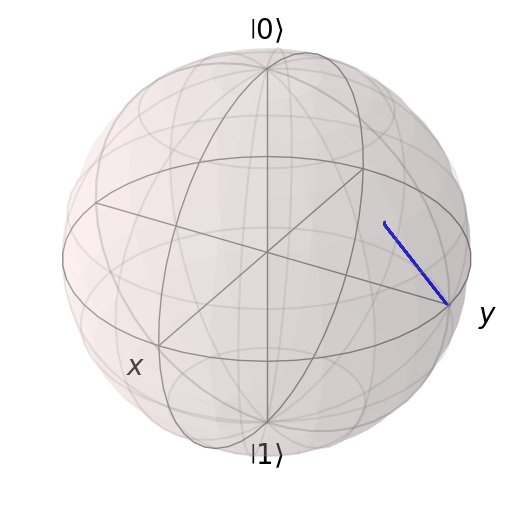

run end
19,run start


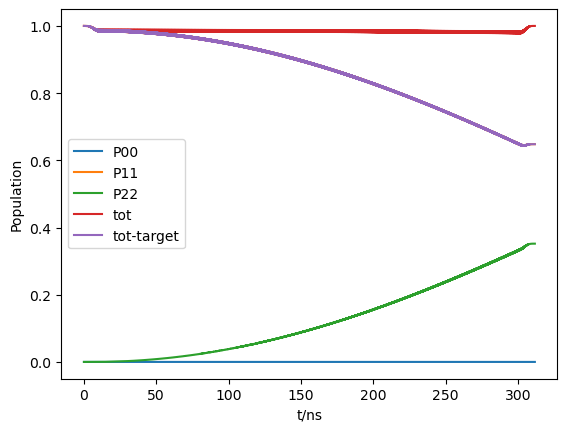

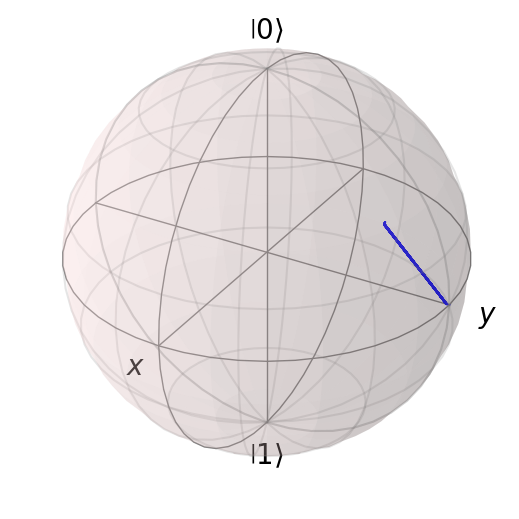

run end
20,run start


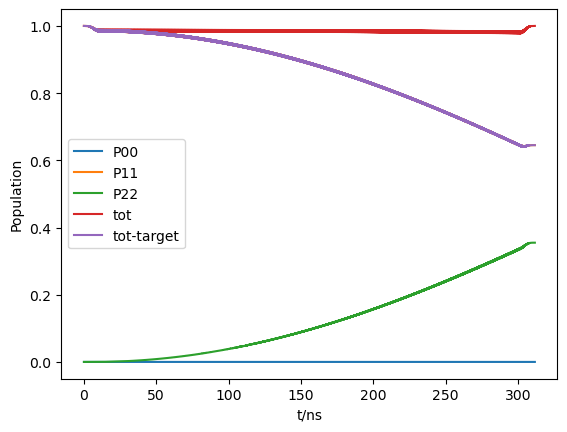

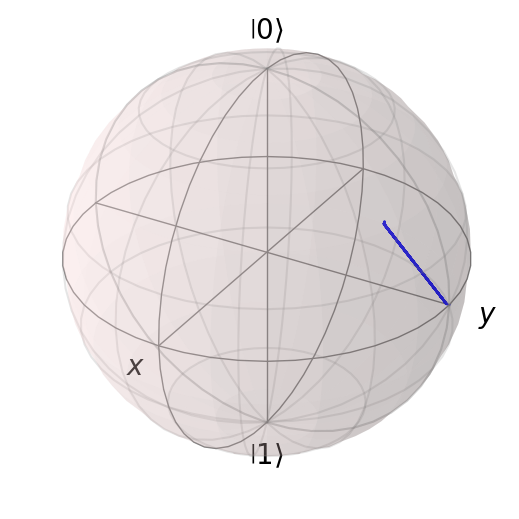

run end
21,run start


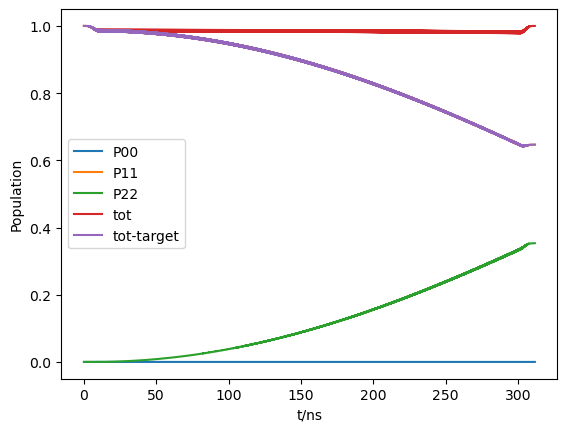

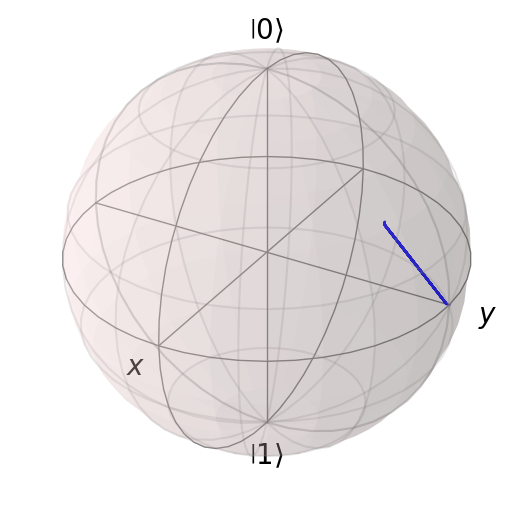

run end
22,run start


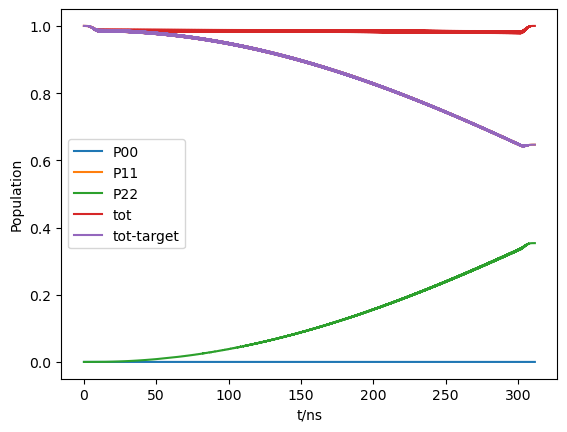

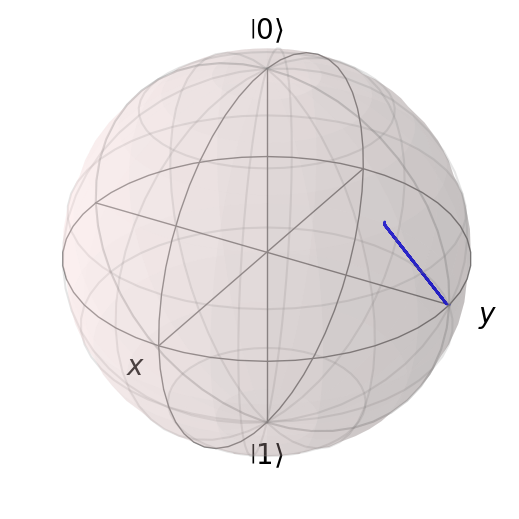

run end




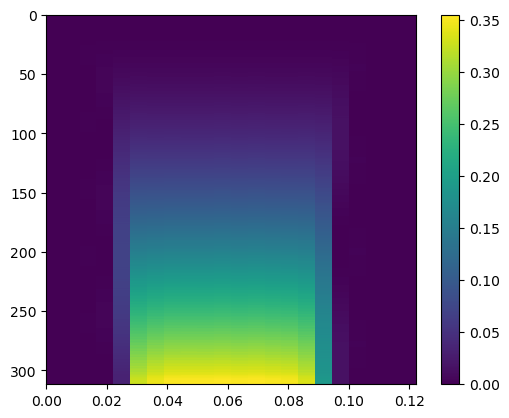

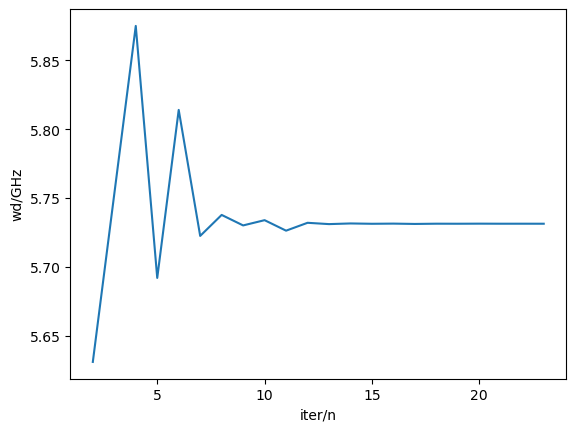

dpi=6.854845665337054e-06,w_match=5.731319558030517 
 auto_scan_scope end


[5.731319558030517,
 [array([[-3.63664993e-19, -3.63664993e-19, -3.63664993e-19, ...,
          -3.63664993e-19, -3.63664993e-19, -3.63664993e-19],
         [-1.43615098e-19,  1.24576709e-19, -3.35537544e-20, ...,
          -2.59238404e-19, -1.51976240e-19, -2.64740809e-19],
         [-2.89638946e-19, -5.73930996e-19, -4.20267308e-19, ...,
          -5.10403525e-20, -1.46576405e-19,  1.04271079e-19],
         ...,
         [-1.15747534e-07,  3.17612968e-05,  9.04961411e-04, ...,
           3.93046919e-07, -1.07680443e-08,  1.70090052e-08],
         [-1.15747518e-07,  3.17612968e-05,  9.04961411e-04, ...,
           3.93046945e-07, -1.07680572e-08,  1.70090081e-08],
         [-1.15747514e-07,  3.17612969e-05,  9.04961411e-04, ...,
           3.93046949e-07, -1.07680594e-08,  1.70090084e-08]]),
  5.691909234853666,
  5.814061852131287,
  100]]

In [ ]:
wd=[5.956000029067557 ,5.731319558030517 ]#single wave
# wd=[5.9550457117450755,5.738864629361385]#mix wave,in-step swap[1,1]
# wd=[5.940313438079269 ,5.748154312047415 ]#mix wave,single swap 11-22,sp=[1,1]
# wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
a=sideband(level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
           L=100,  wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[0,0.46617831709480284],
           rho0=1,  rho_tar=2,  pre_scan=True)
a.auto_scan_scope(sp=1,runplot=True)
# a.run(True)
# a.ksp_g
# a.d_eff_g
# a.s_g
# a.amp

auto_scan_scope start 
 sp=0
T for scan:203.9215898447998
iter_num=
1,run start


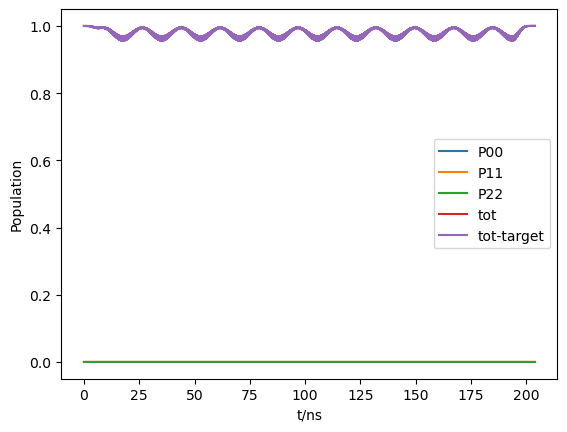

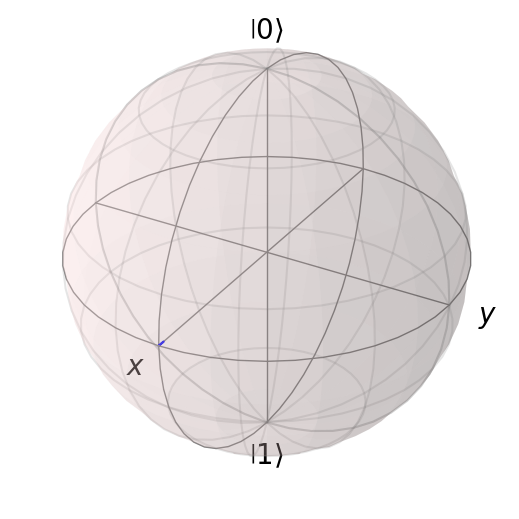

run end
2,run start


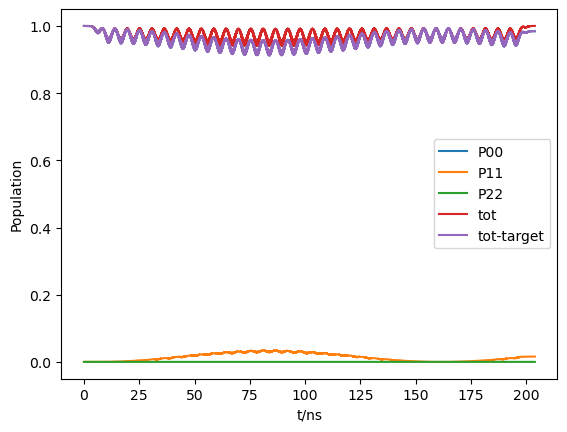

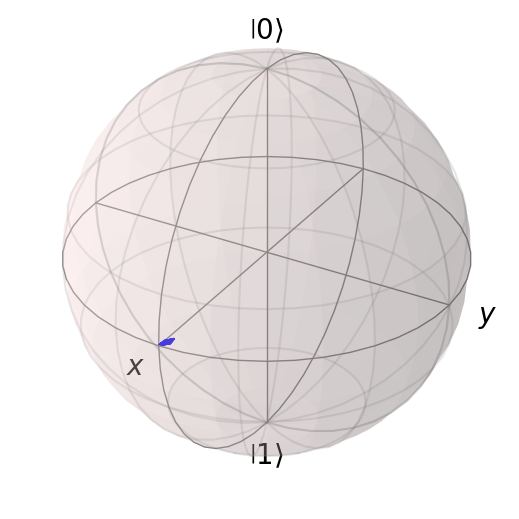

run end
3,run start


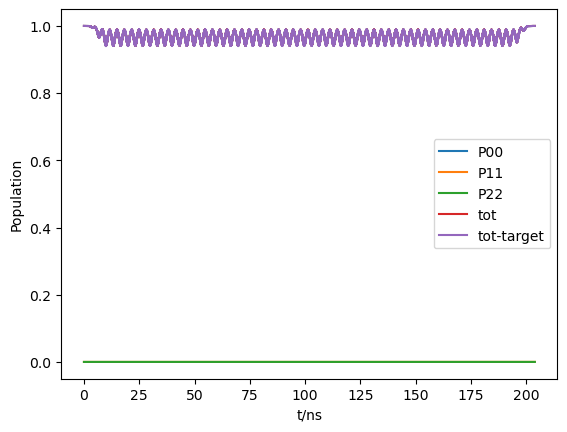

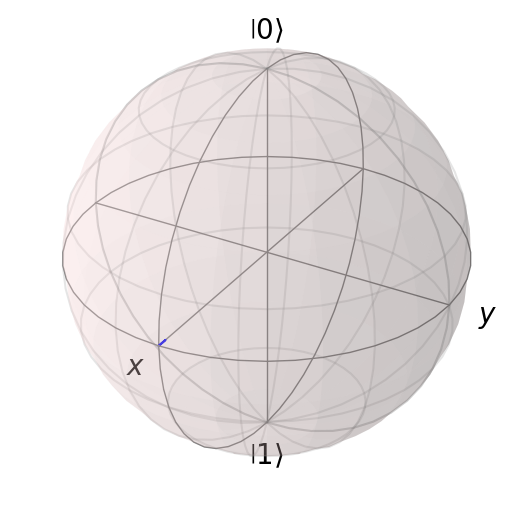

run end
4,run start


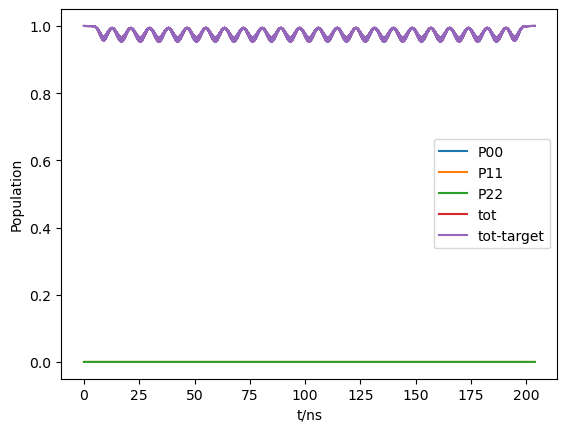

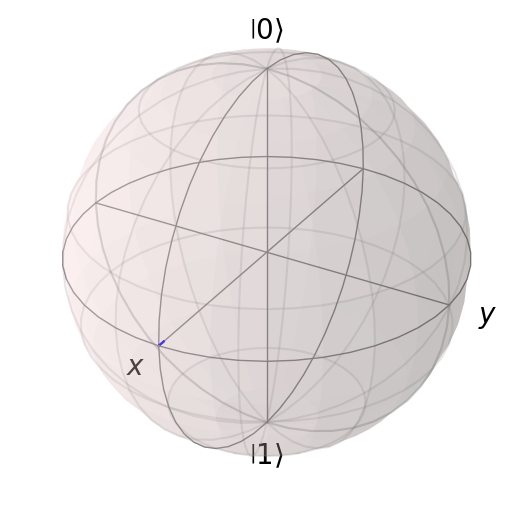

run end
5,run start


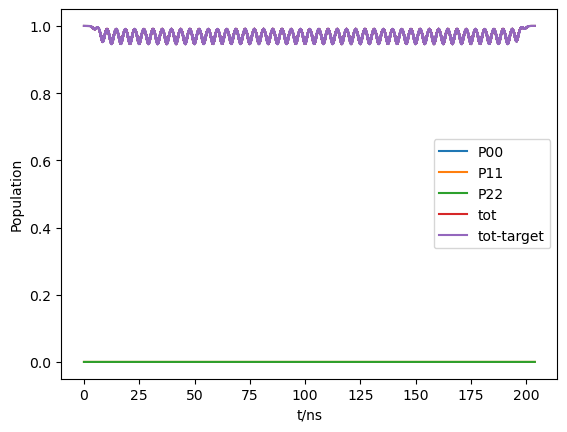

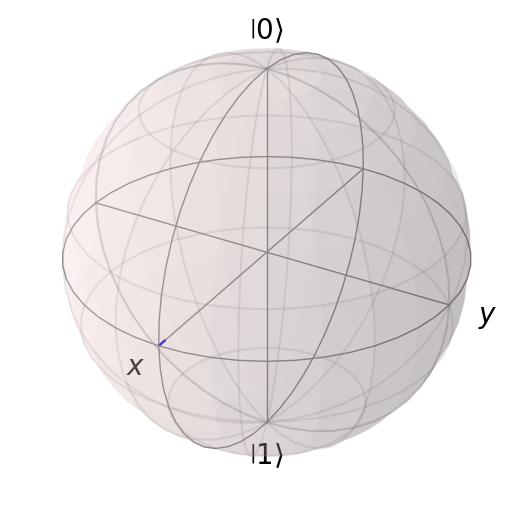

run end
6,run start


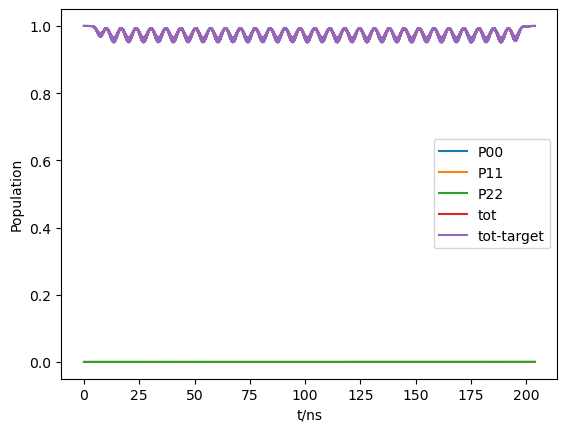

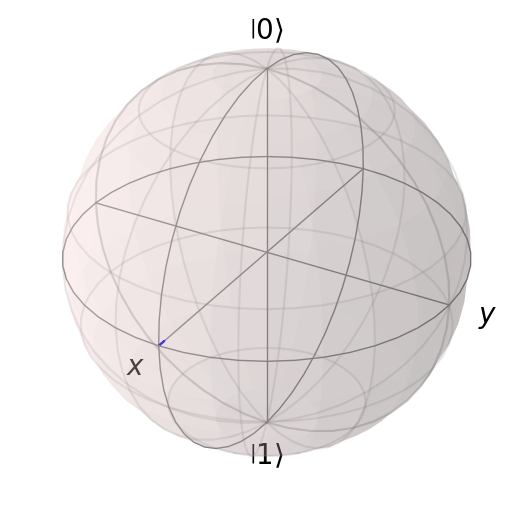

run end
7,run start


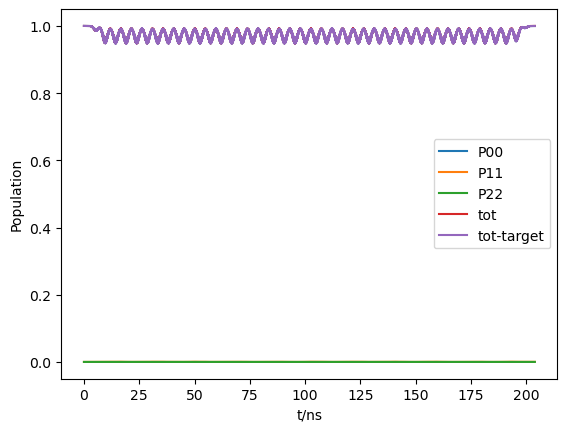

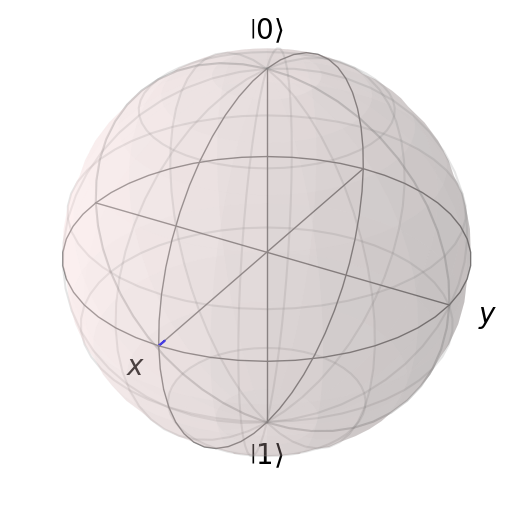

run end
8,run start


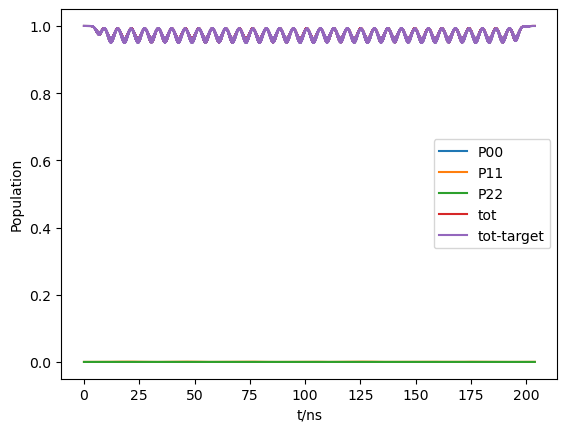

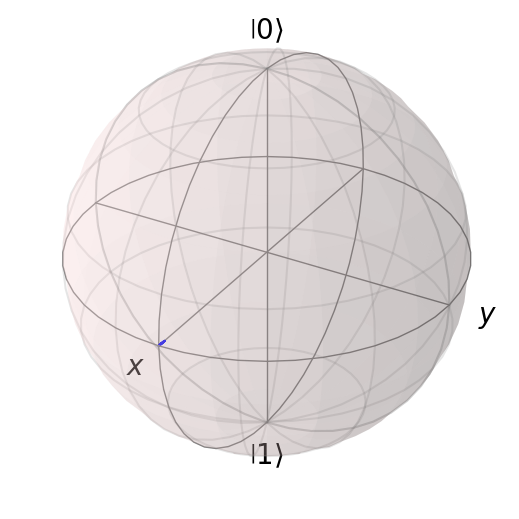

run end
9,run start


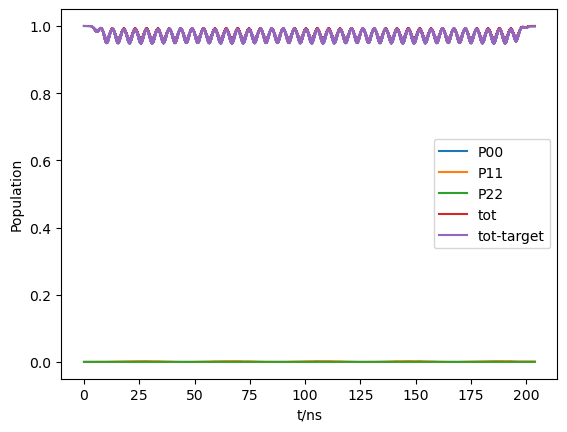

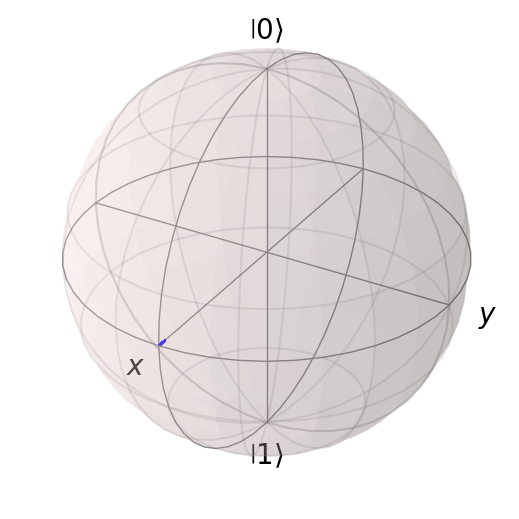

run end
10,run start


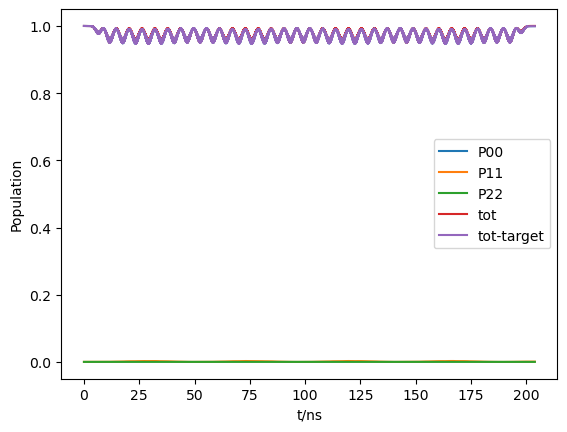

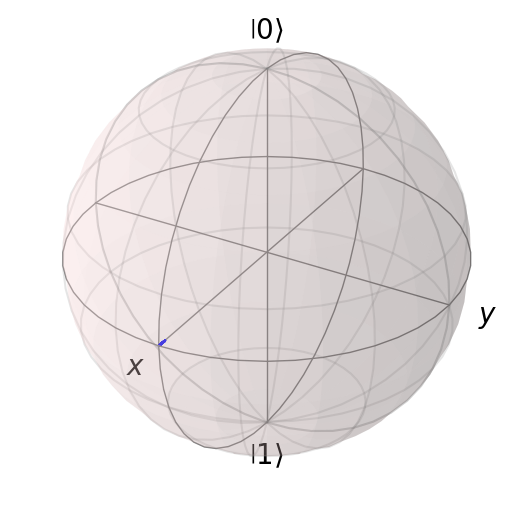

run end
11,run start


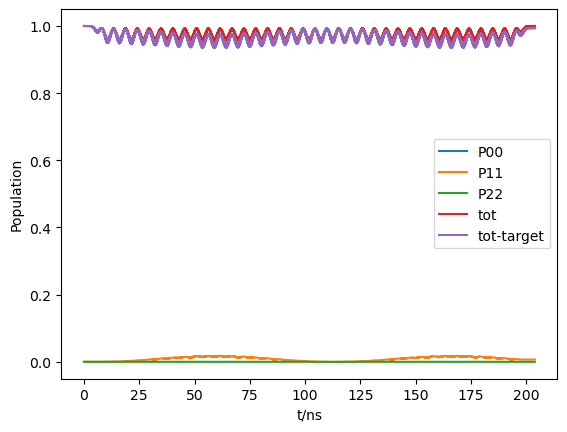

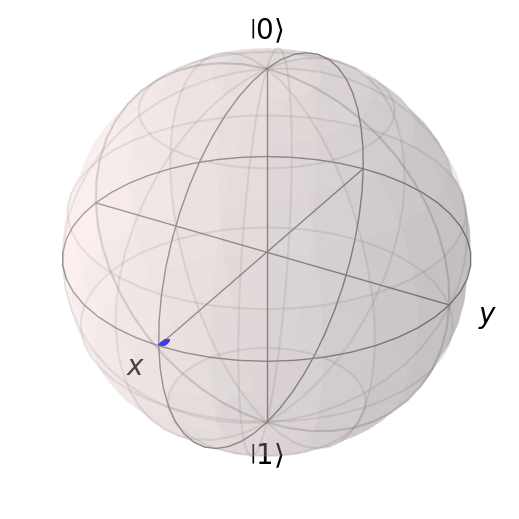

run end
12,run start


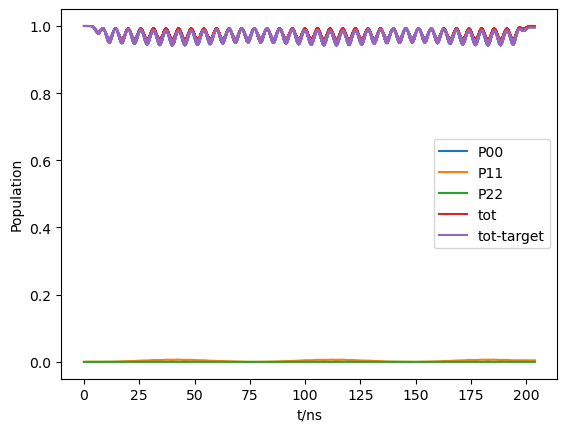

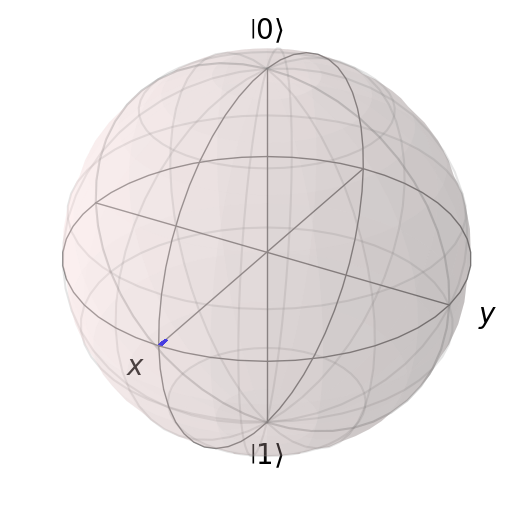

run end
13,run start


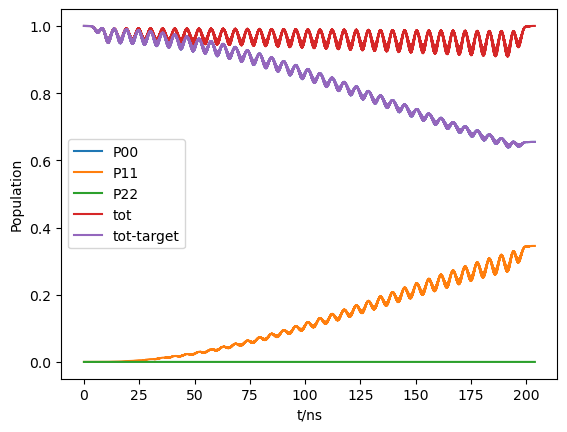

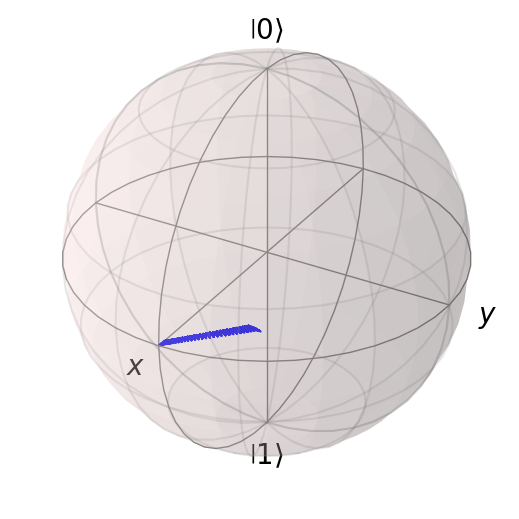

run end
14,run start


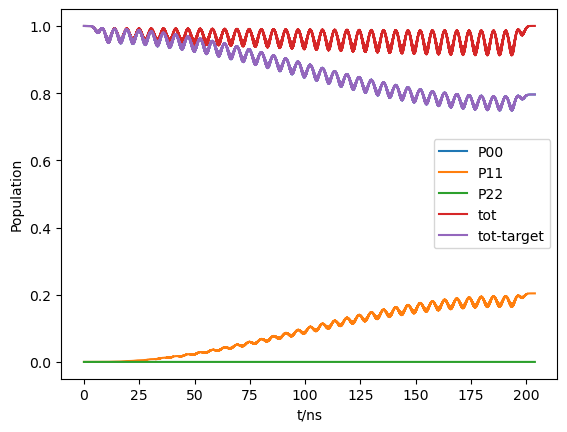

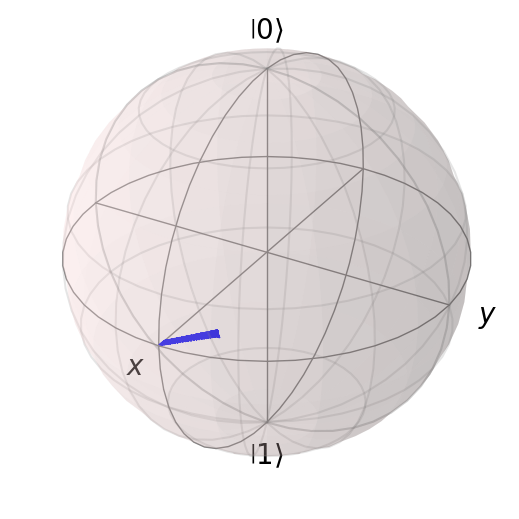

run end
15,run start


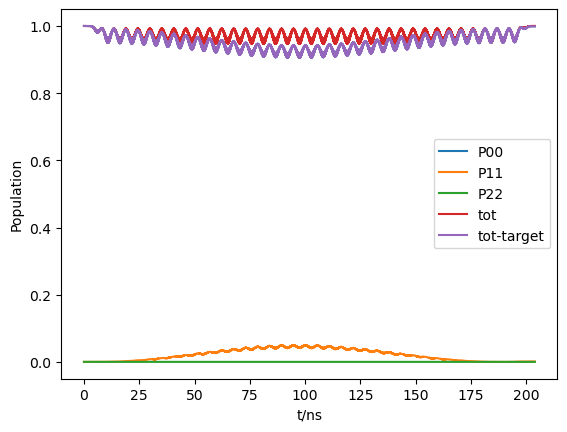

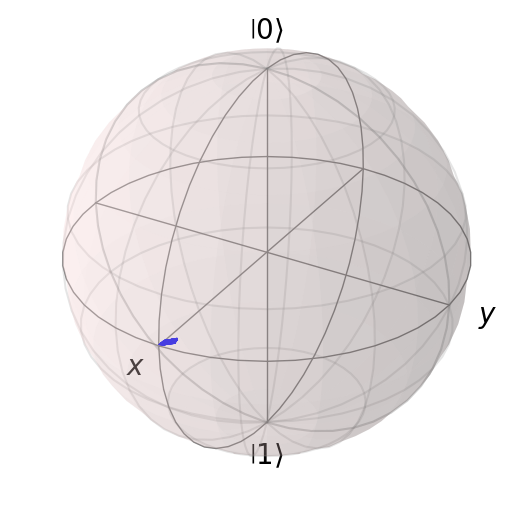

run end
16,run start


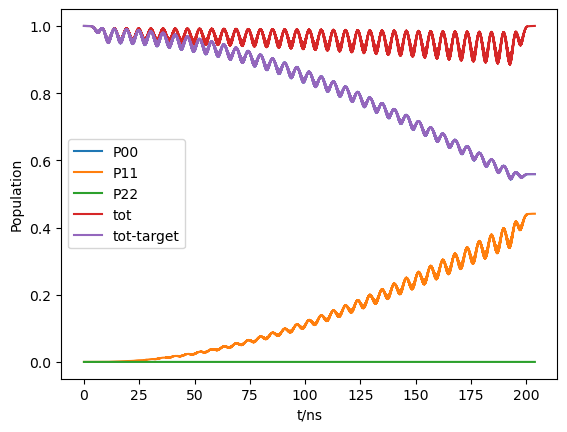

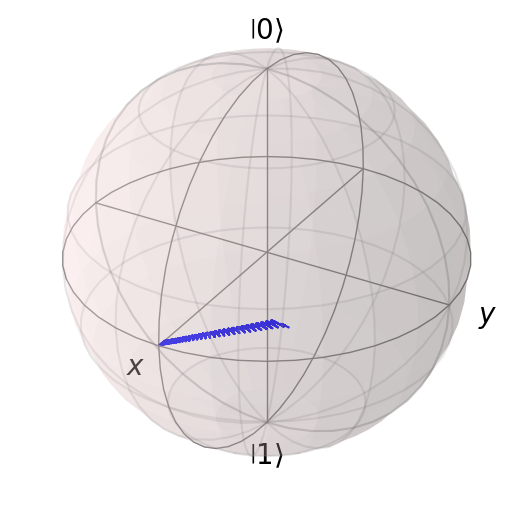

run end
17,run start


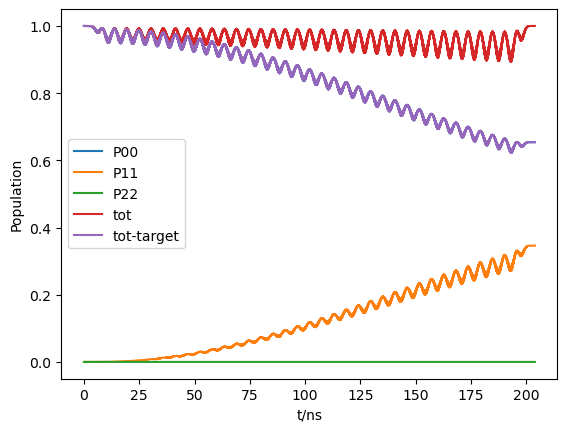

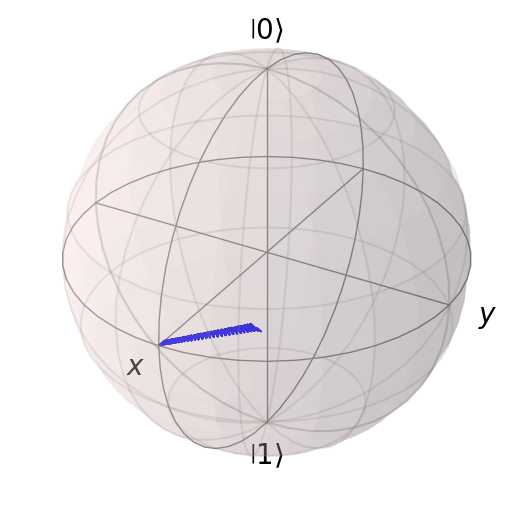

run end
18,run start


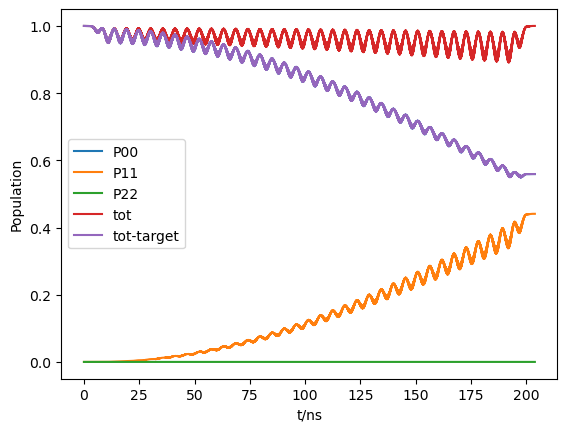

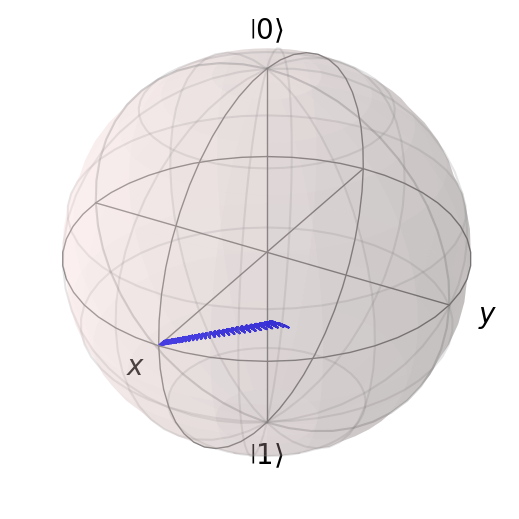

run end
19,run start


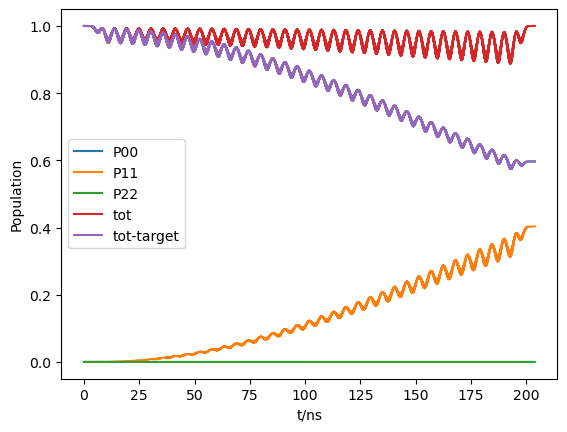

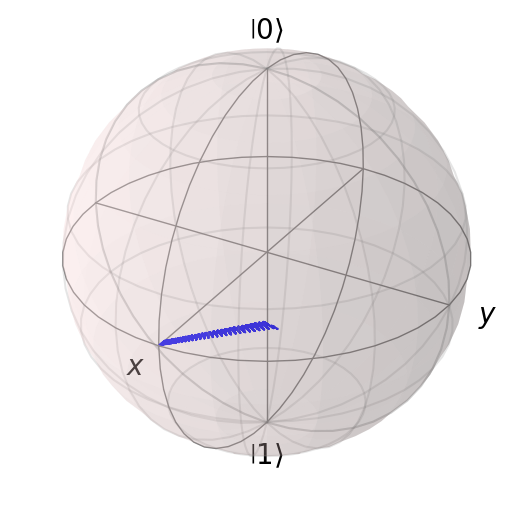

run end
20,run start


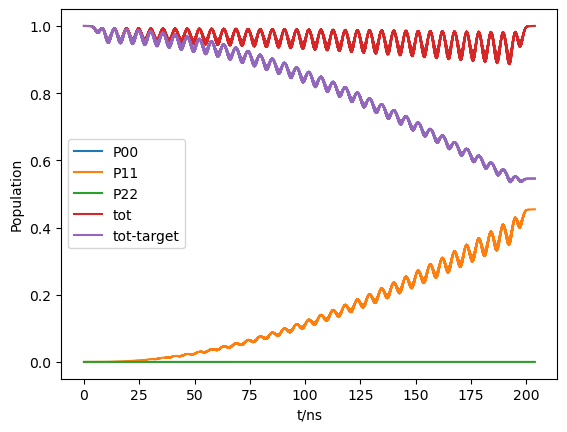

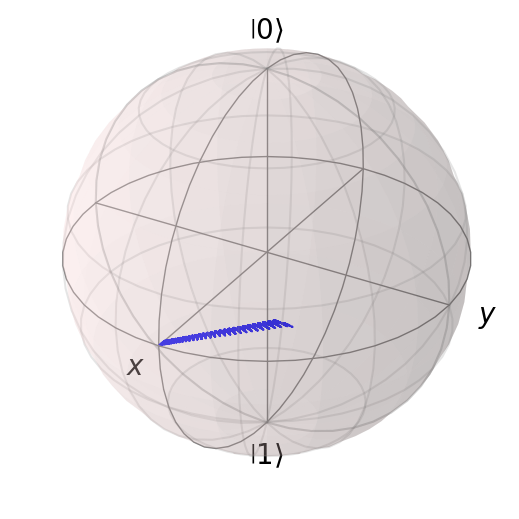

run end
21,run start


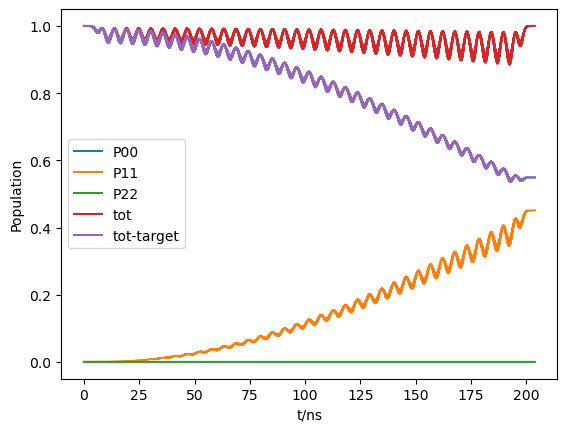

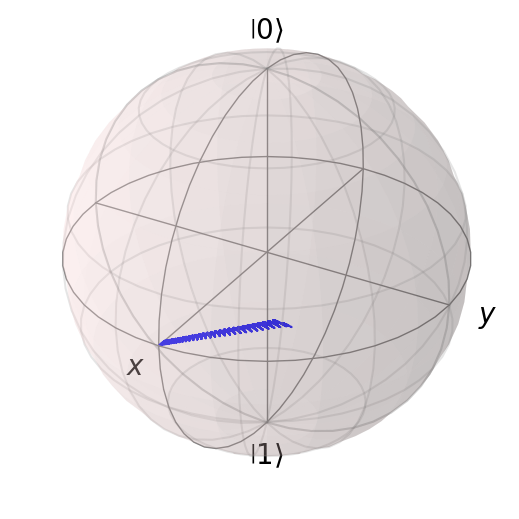

run end
22,run start


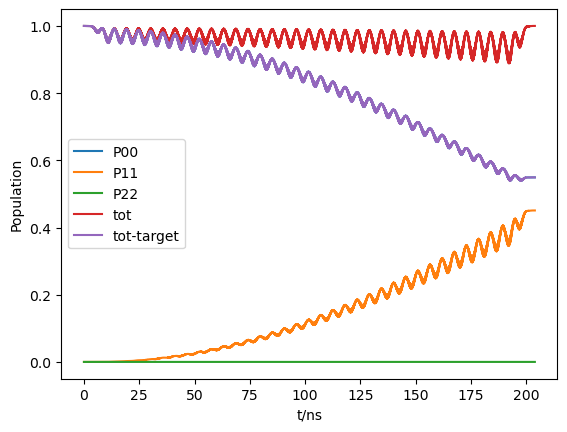

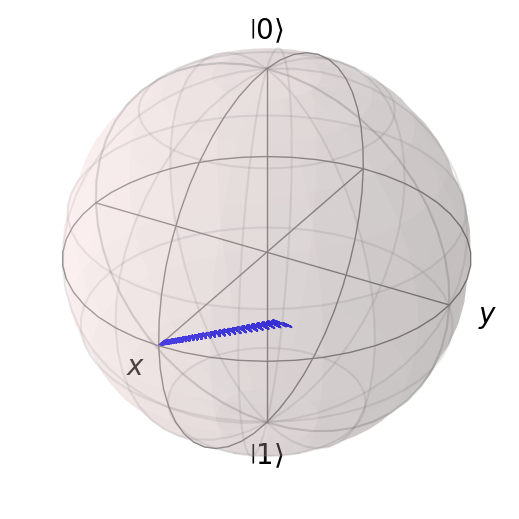

run end
23,run start


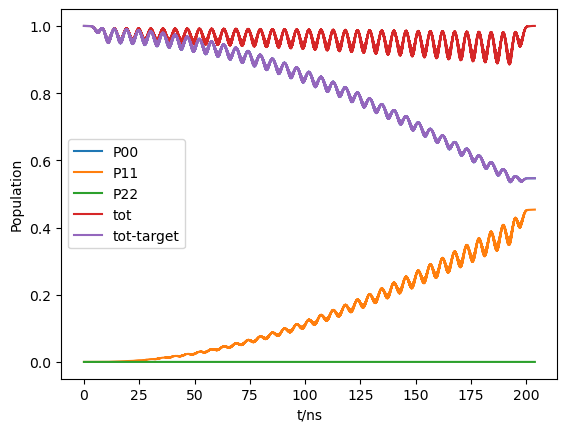

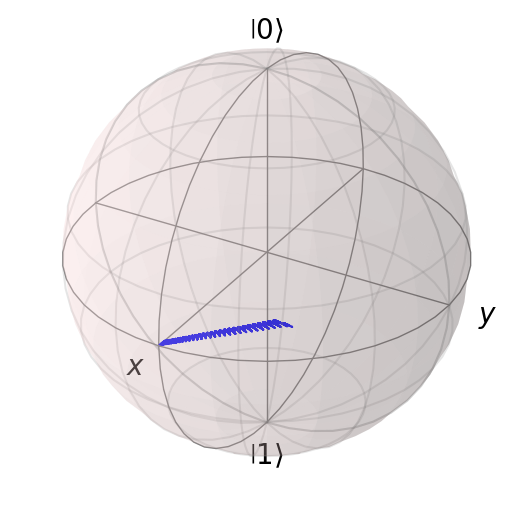

run end
24,run start


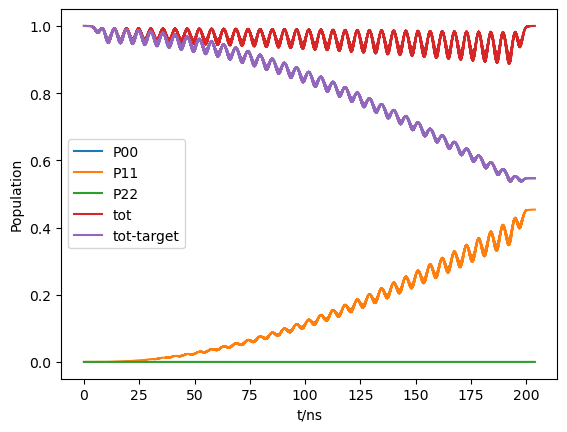

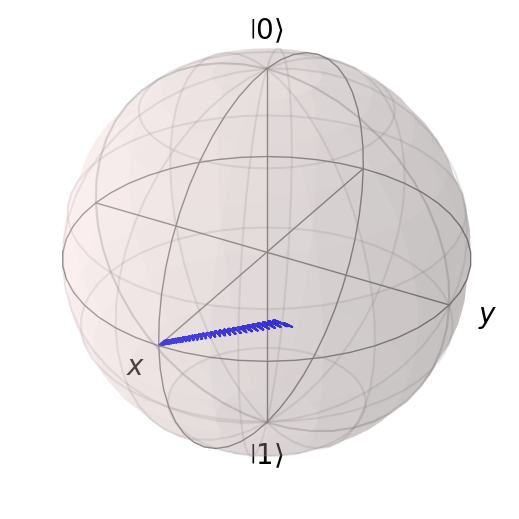

run end
25,run start


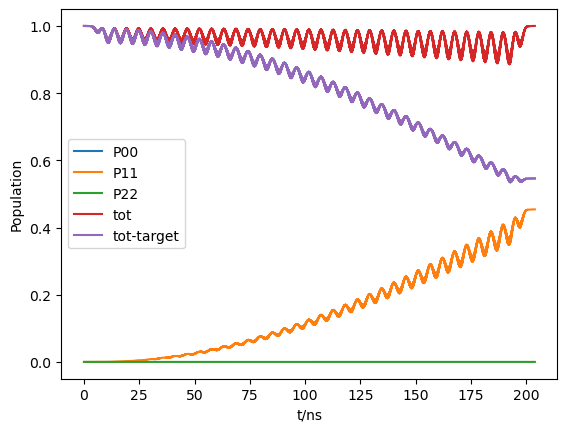

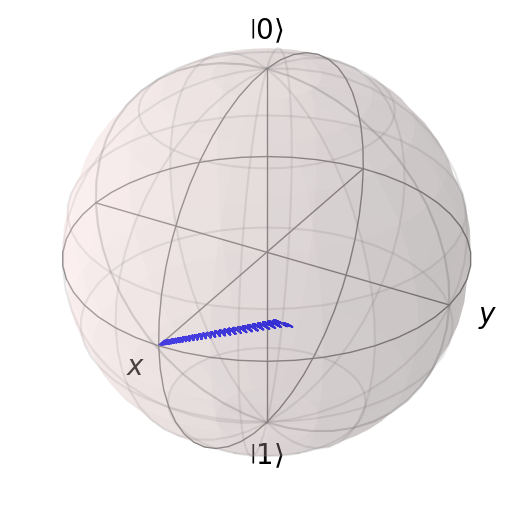

run end
26,run start


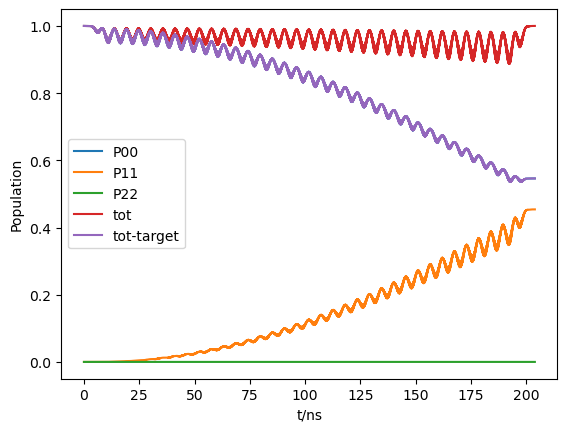

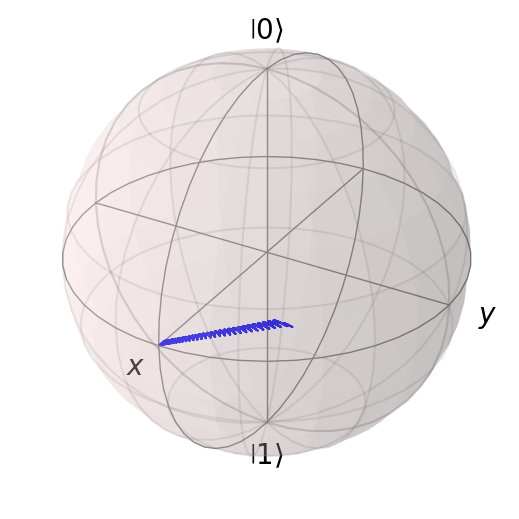

run end
27,run start


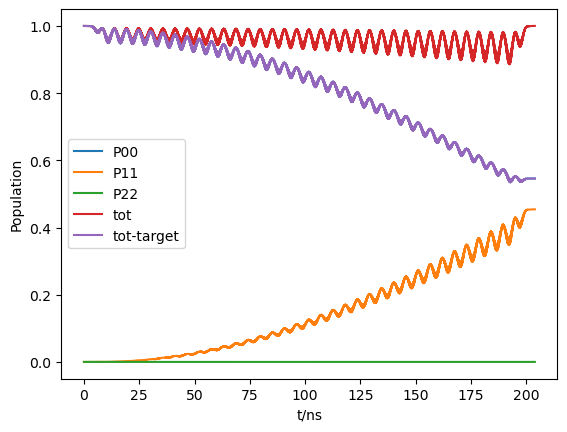

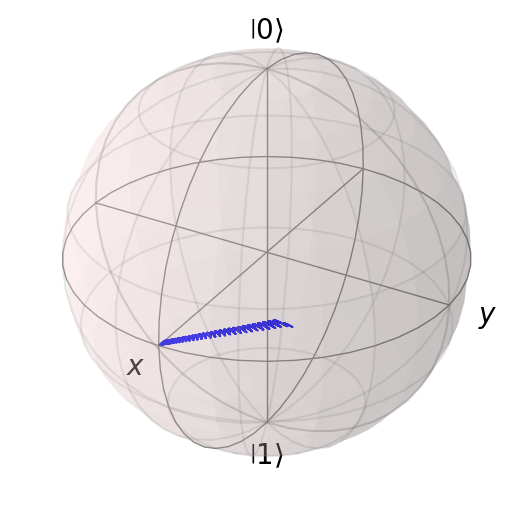

run end
28,run start


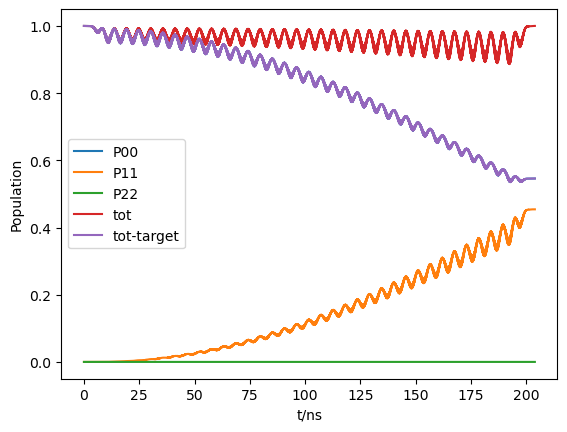

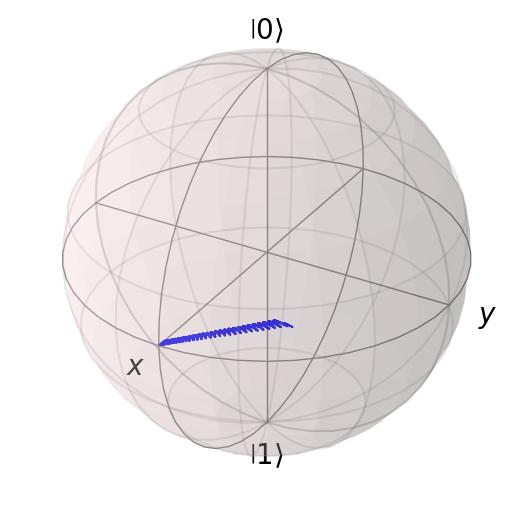

run end


[5.9550457117450755, 0.4542060431278153]


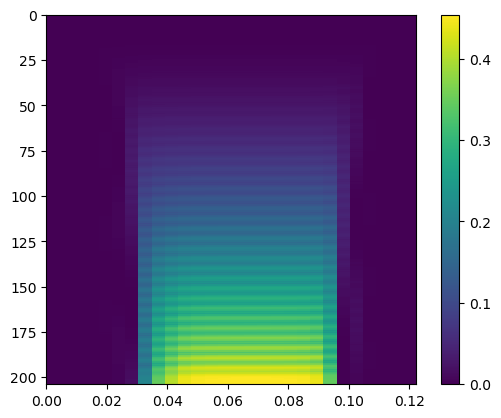

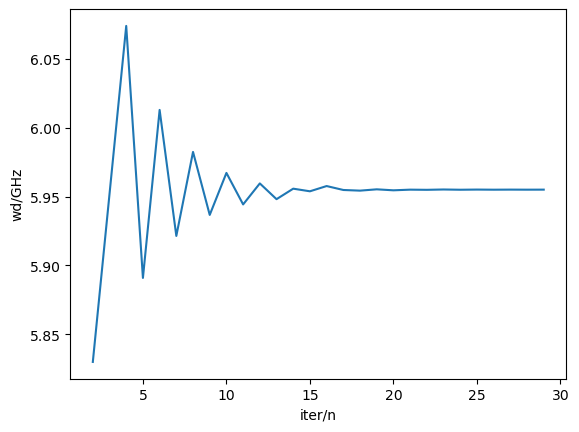

dpi=1.0874199171982355e-05,w_match=5.9550457117450755 
 auto_scan_scope end


[5.9550457117450755,
 [array([[-1.99547761e-20, -1.99547761e-20, -1.99547761e-20, ...,
          -1.99547761e-20, -1.99547761e-20, -1.99547761e-20],
         [-4.54687339e-20, -1.88333237e-20,  3.80369397e-20, ...,
           9.45623500e-21, -2.12455801e-21, -4.76456361e-20],
         [-3.10864600e-20,  3.13919919e-20,  1.66192138e-20, ...,
          -8.03013126e-21,  1.35072034e-20,  5.12843977e-21],
         ...,
         [-1.21531841e-07,  6.94886735e-06,  1.00920311e-05, ...,
           2.54156481e-04,  4.41218131e-05,  1.05980205e-04],
         [-1.21531836e-07,  6.94886684e-06,  1.00920310e-05, ...,
           2.54156481e-04,  4.41218143e-05,  1.05980204e-04],
         [-1.21531837e-07,  6.94886680e-06,  1.00920310e-05, ...,
           2.54156480e-04,  4.41218143e-05,  1.05980204e-04]]),
  5.890867871808201,
  6.013020489085822,
  100]]

In [ ]:
# wd=[5.944786800528401 ,5.752985543492477 ]#single wave
# wd=[5.9526748296470355,5.748154312047415]#mix wave,in-step swap[1,1]
# wd=[5.940313438079269 ,5.748154312047415 ]#mix wave,single swap 11-22,sp=[1,1]
wd=[5.9550457117450755  ,5.772985543492477 ]#mix wave,single swap 11-00,sp=[1,1],T~~880ns
a=sideband(level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
           L=1000,  wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
           rho0=0,  rho_tar=1,  pre_scan=True)
a.auto_scan_scope(sp=0,runplot=True)
# a.run(True)
# a.d_eff_g
# a.s_g
# a.amp

auto_scan_scope start 
 sp=1
T for scan:313.83470478497514
iter_num=
1,run start


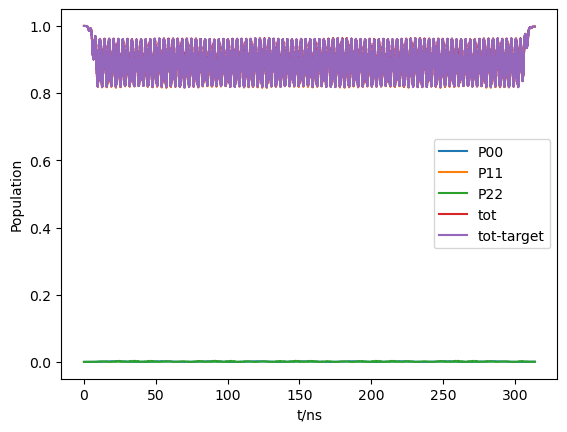

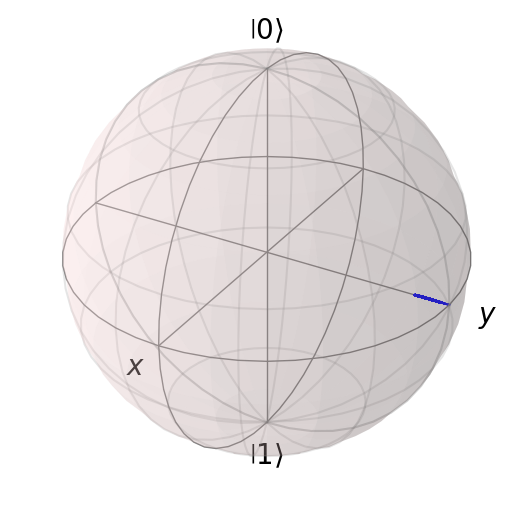

run end
2,run start


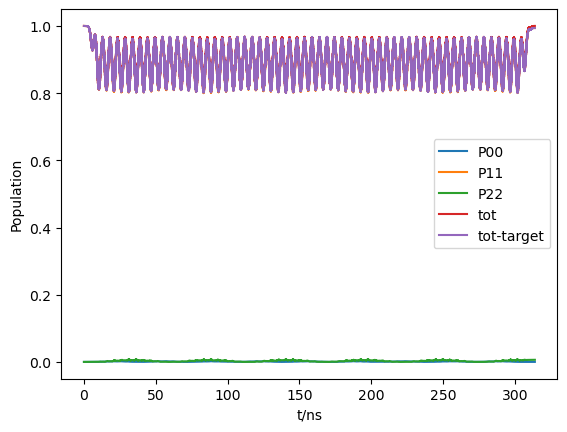

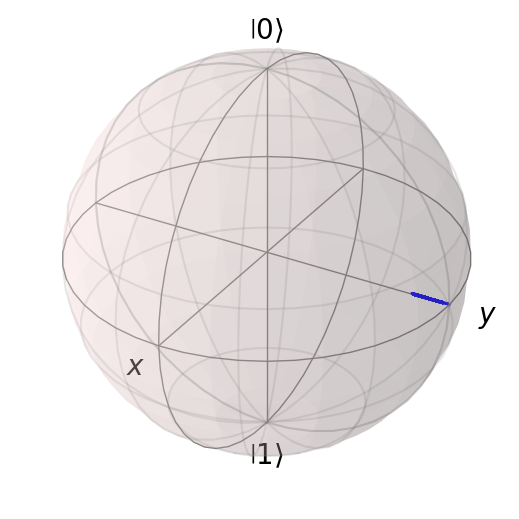

run end
3,run start


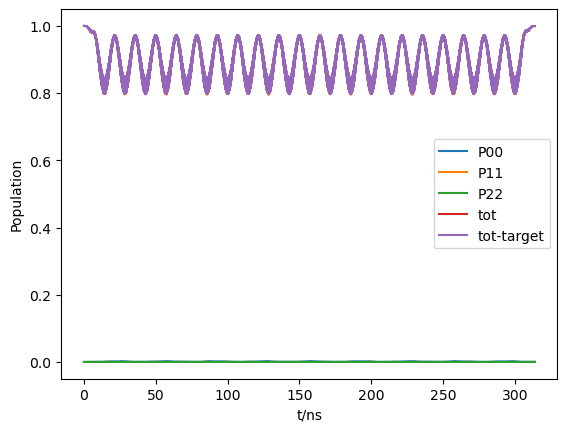

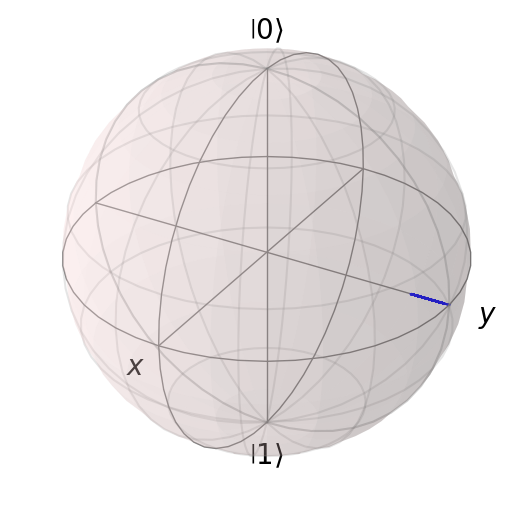

run end
4,run start


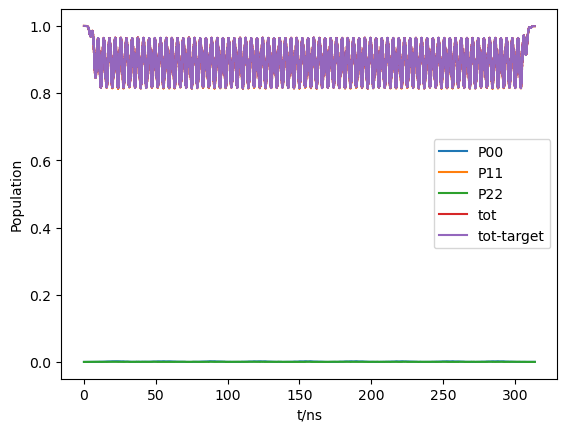

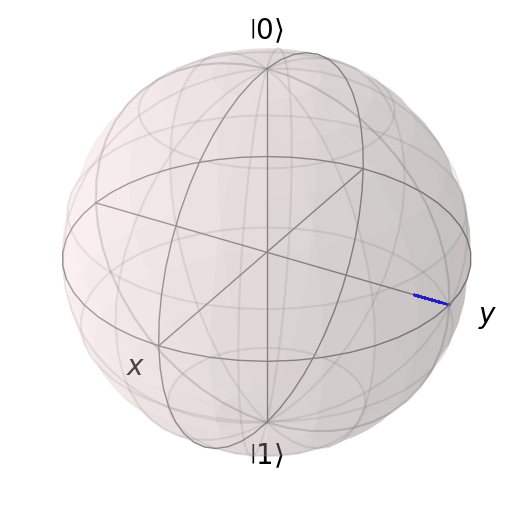

run end
5,run start


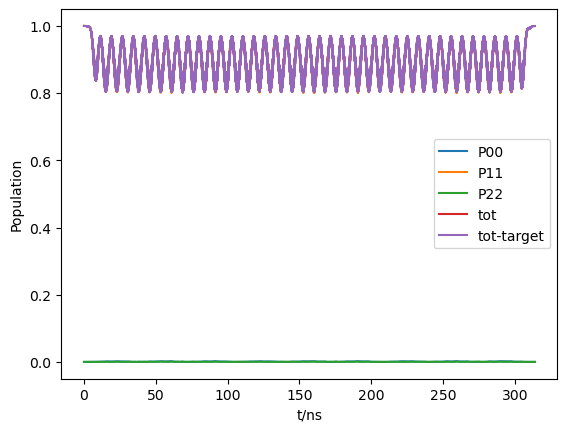

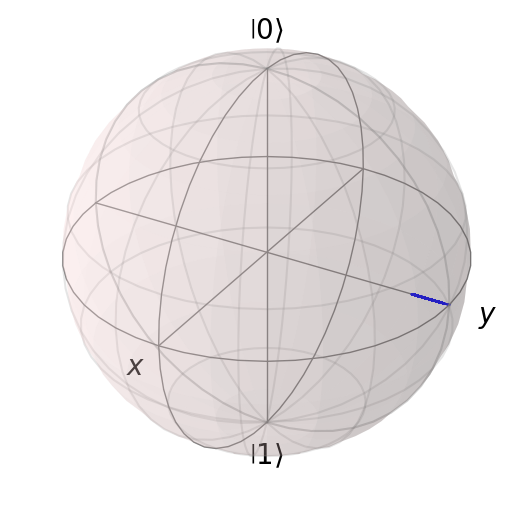

run end
6,run start


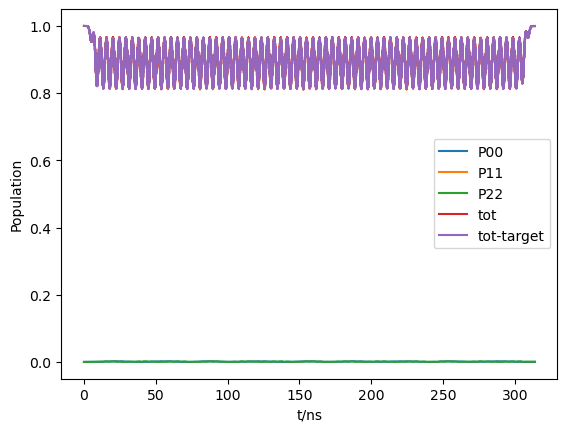

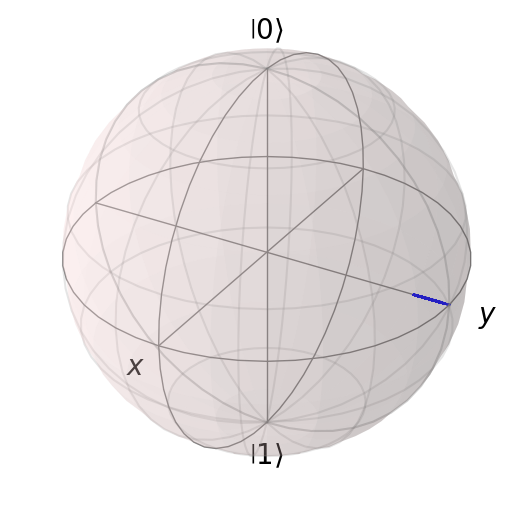

run end
7,run start


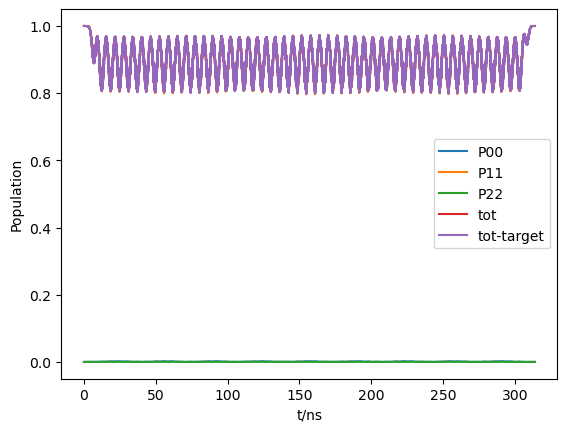

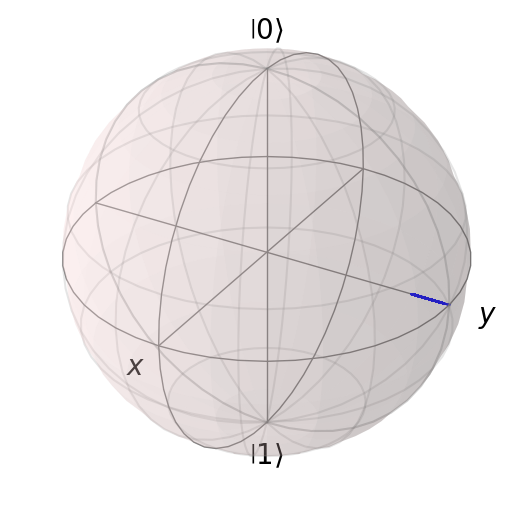

run end
8,run start


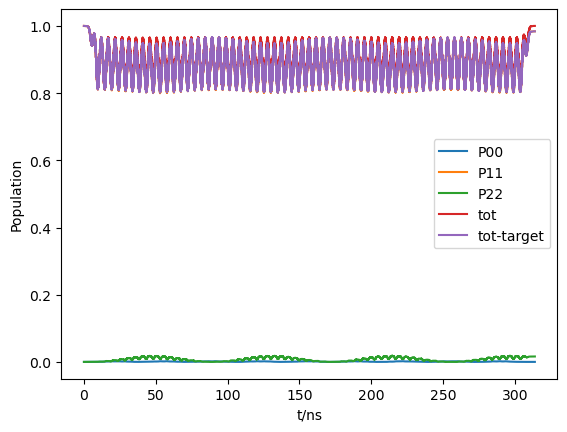

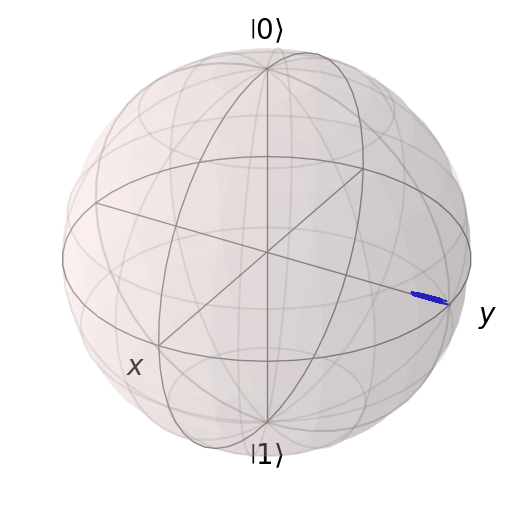

run end
9,run start


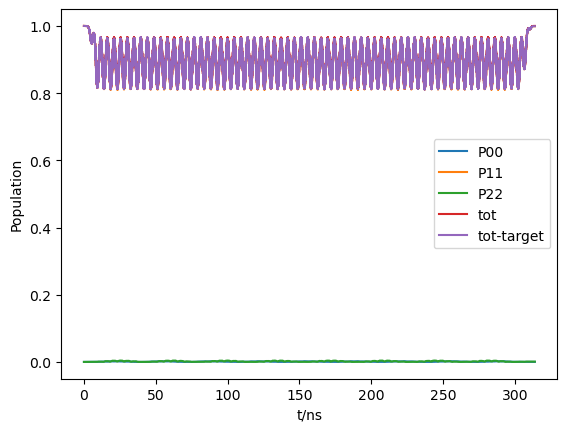

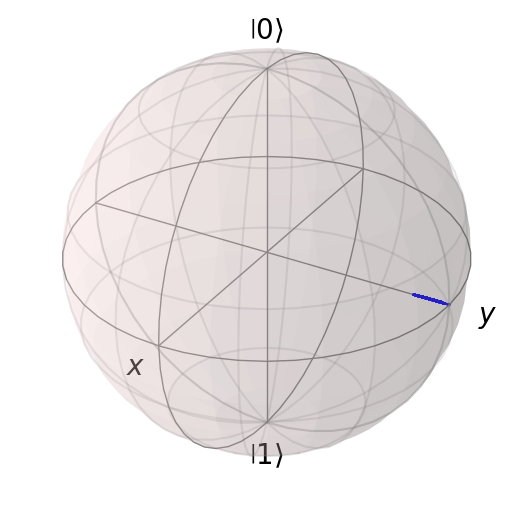

run end
10,run start


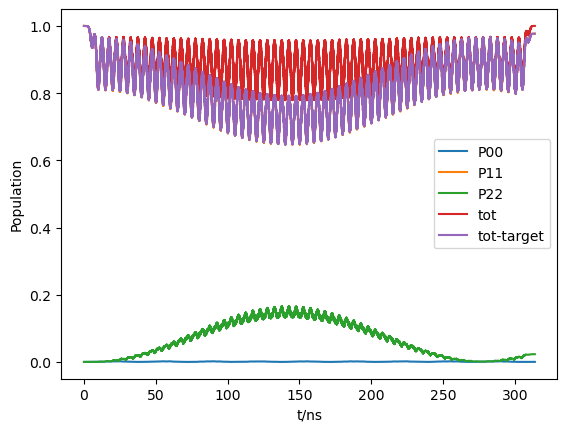

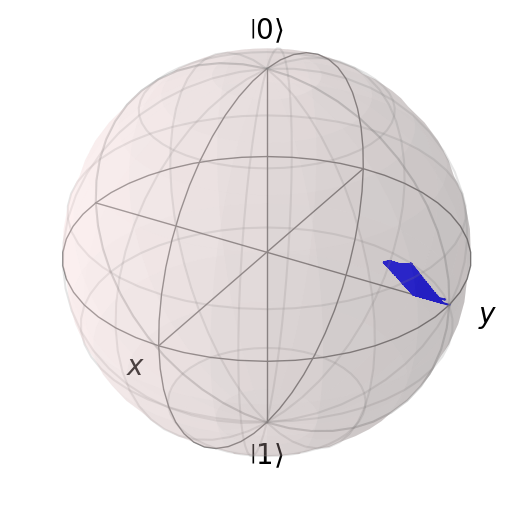

run end
11,run start


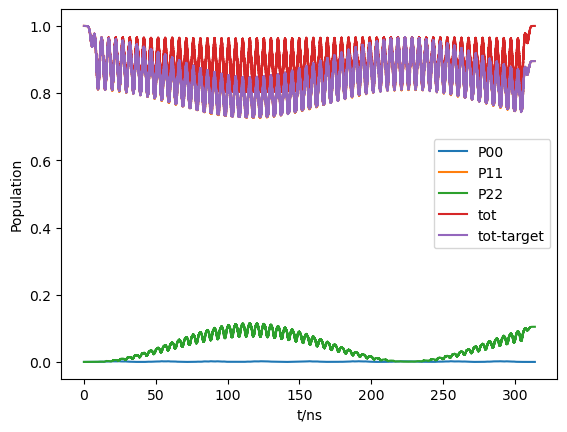

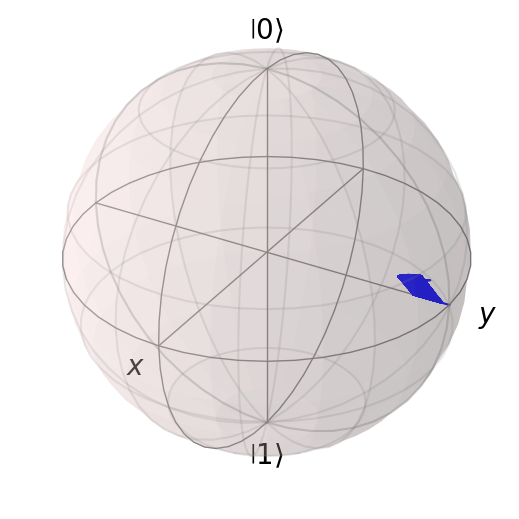

run end
12,run start


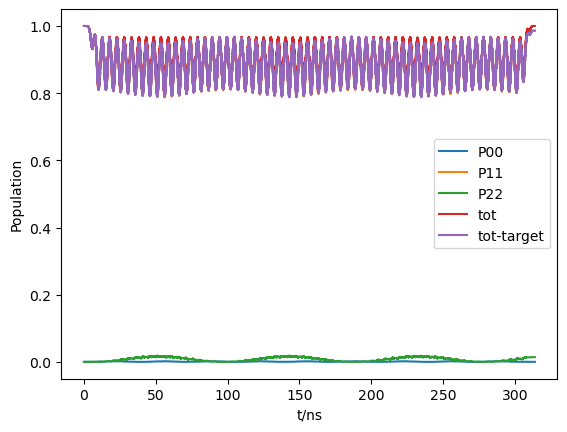

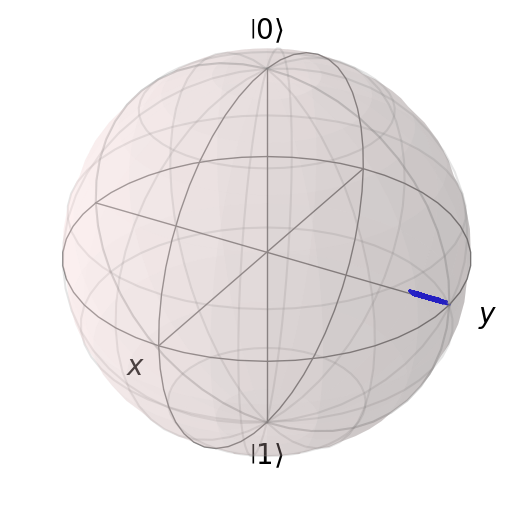

run end
13,run start


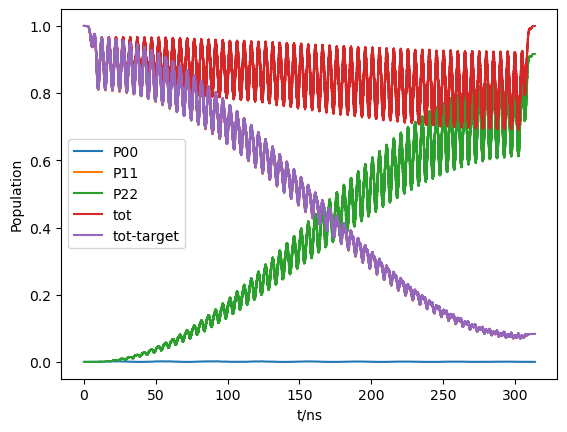

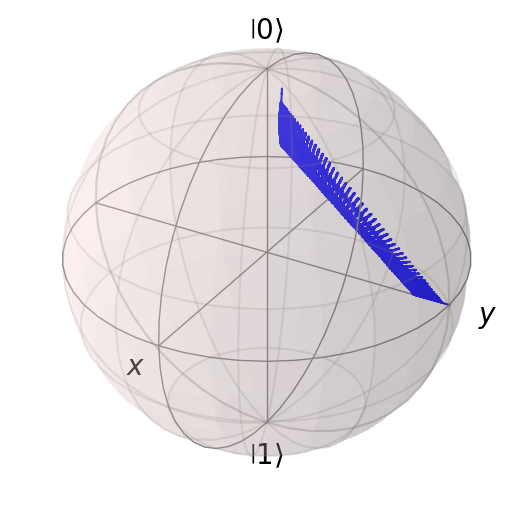

run end
14,run start


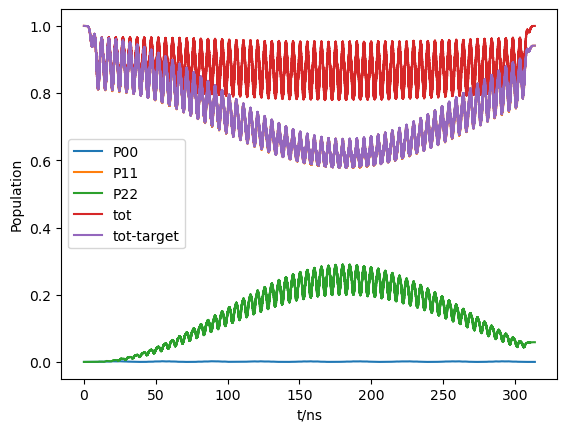

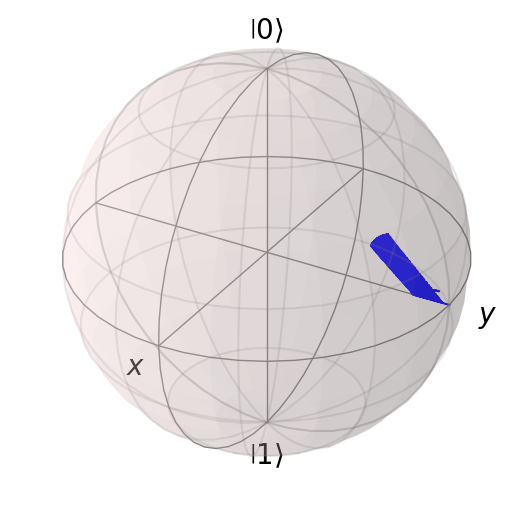

run end
15,run start


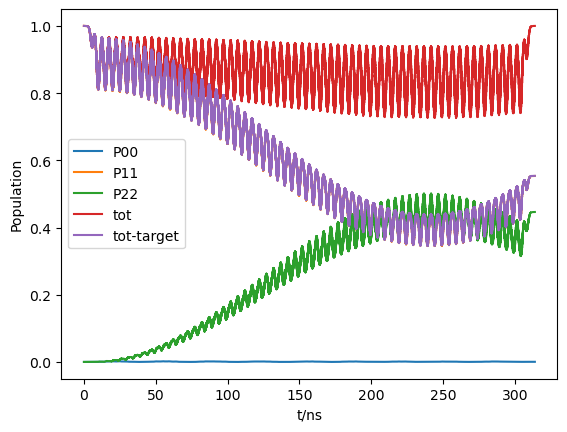

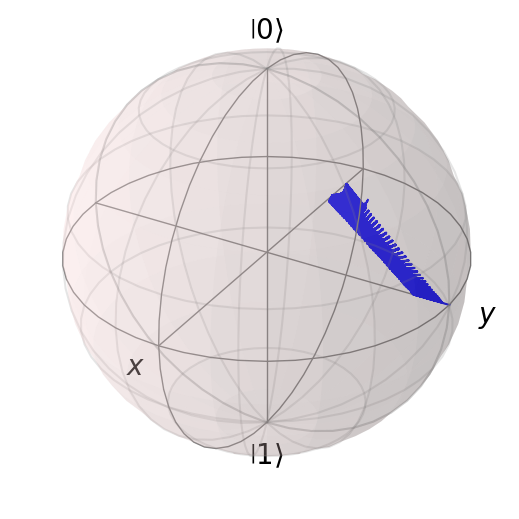

run end
16,run start


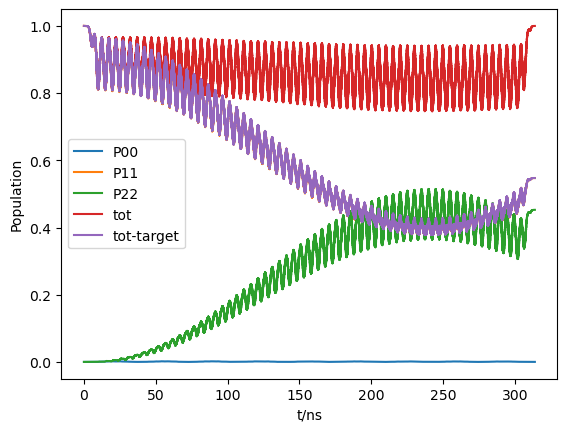

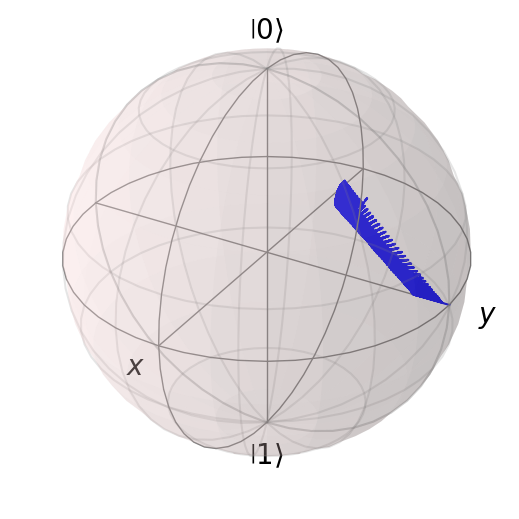

run end
17,run start


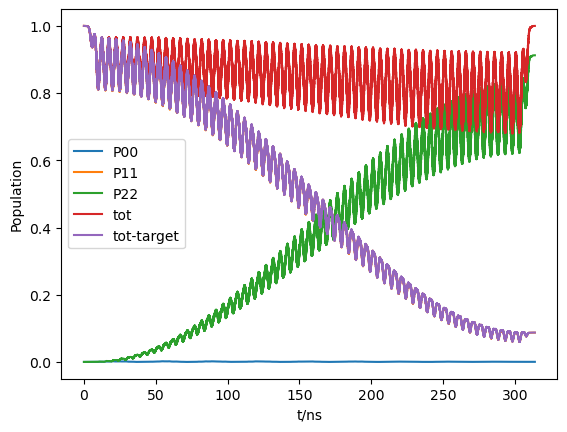

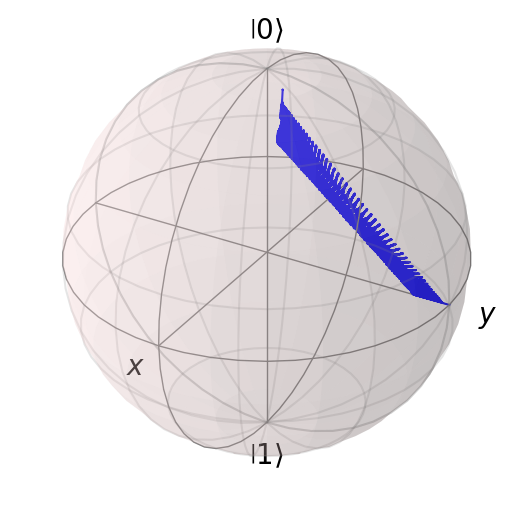

run end
18,run start


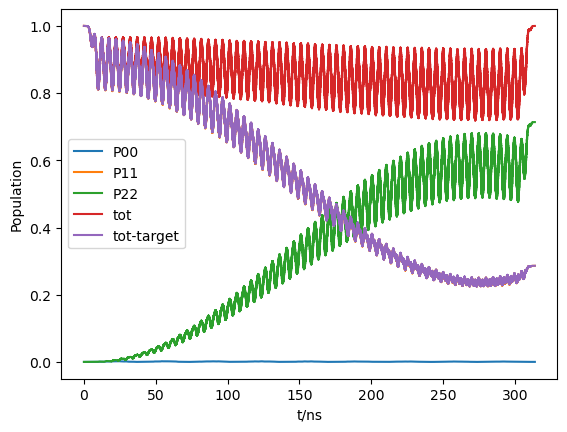

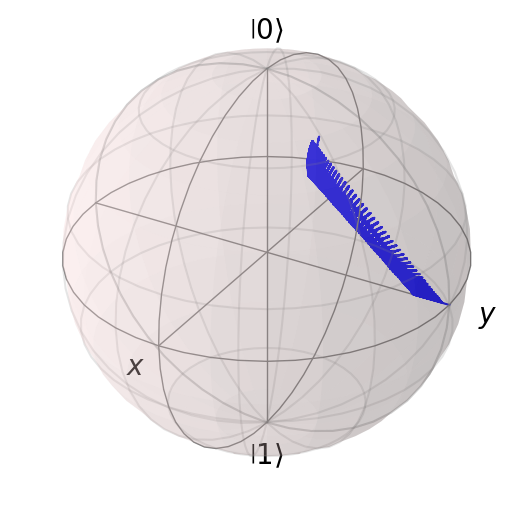

run end
19,run start


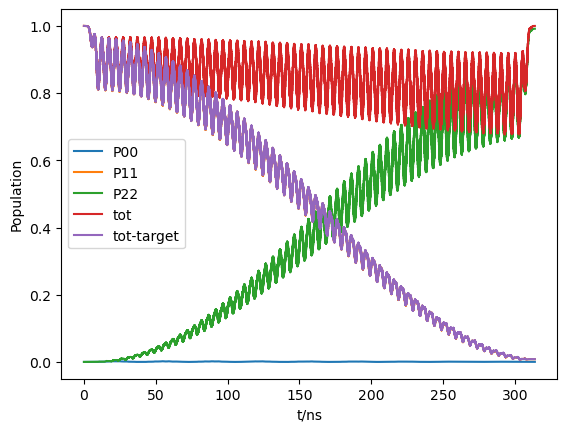

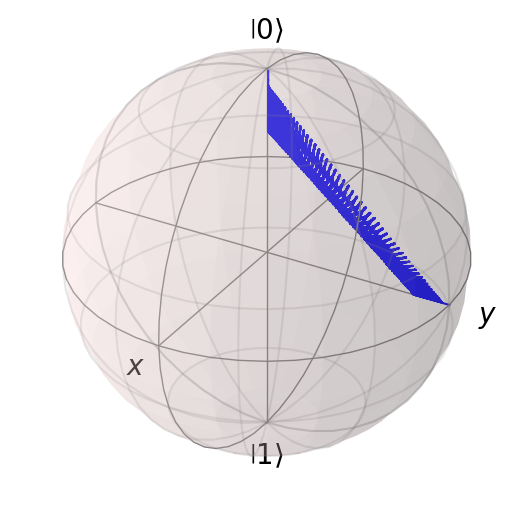

run end
20,run start


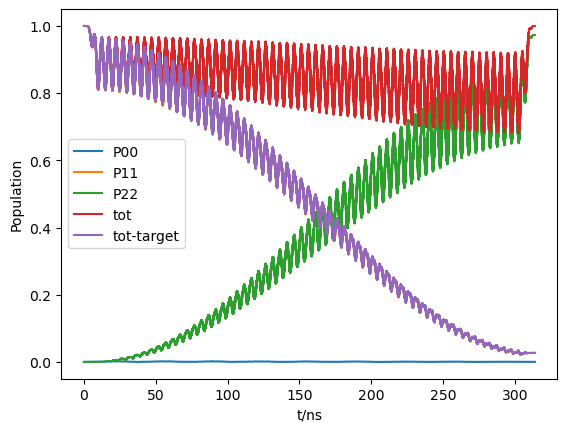

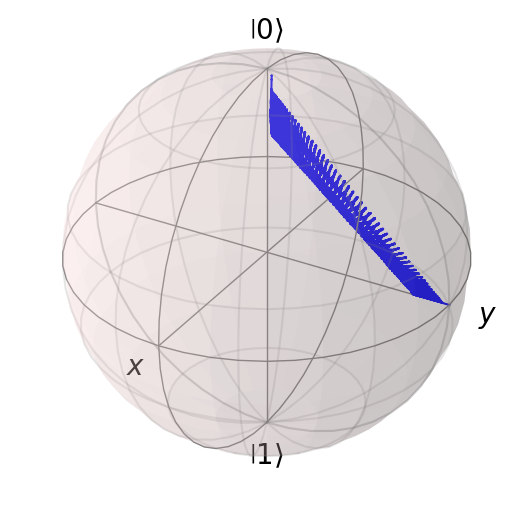

run end
21,run start


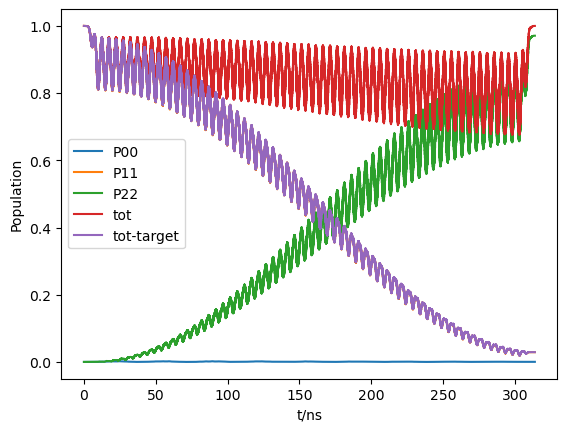

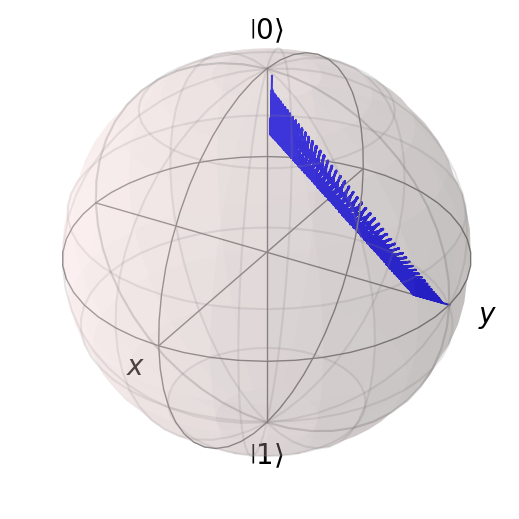

run end
22,run start


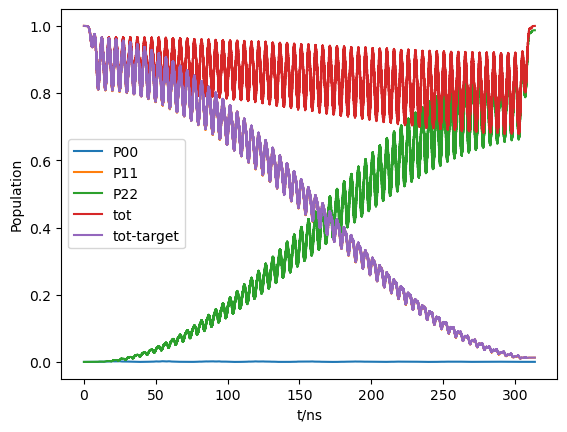

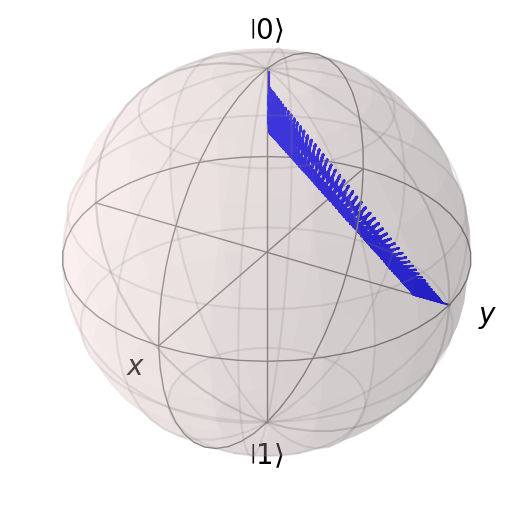

run end
23,run start


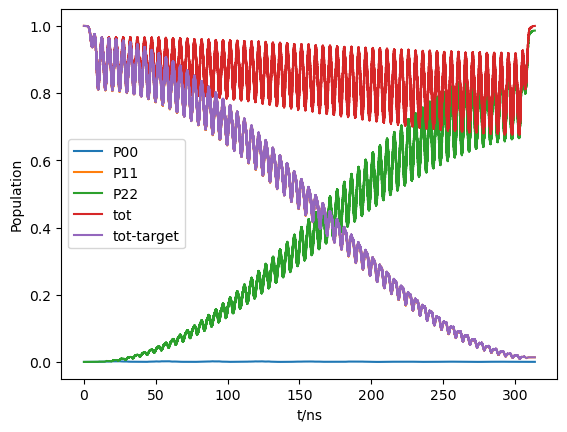

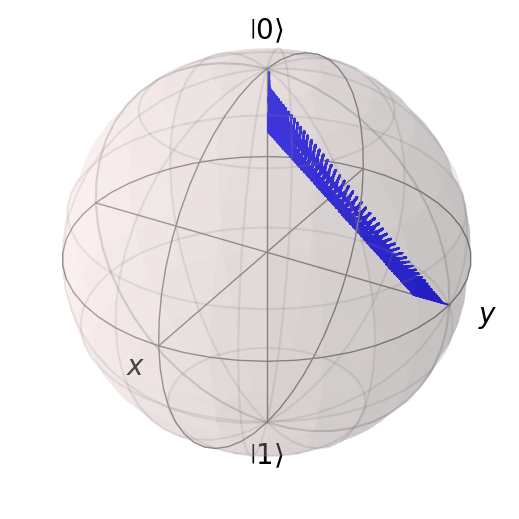

run end
24,run start


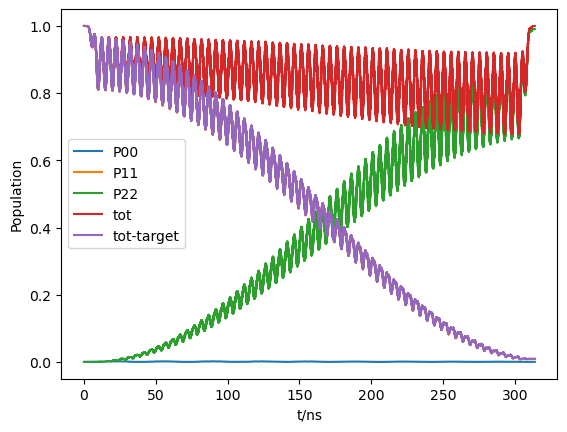

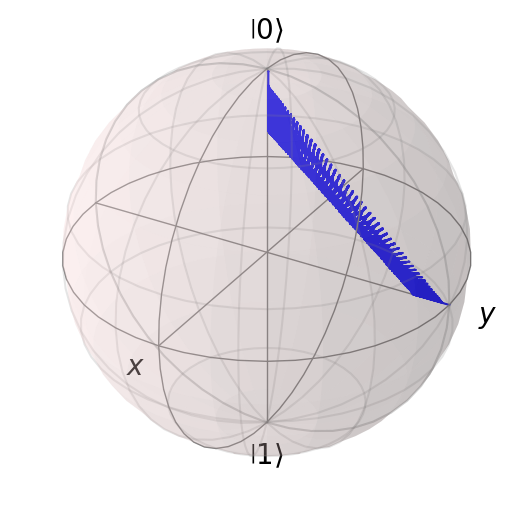

run end
25,run start


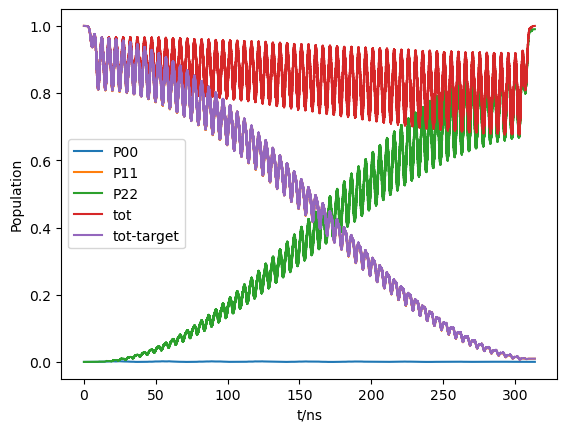

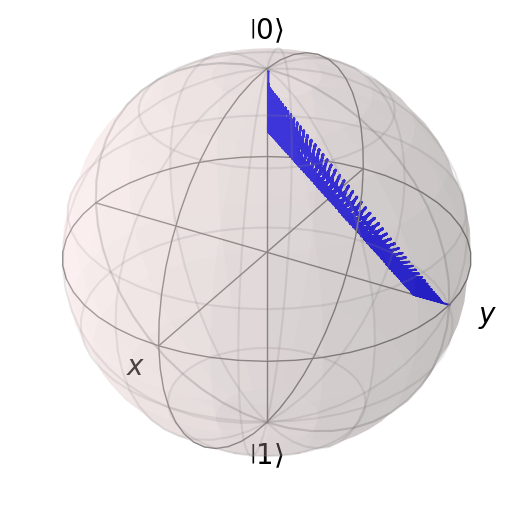

run end
26,run start


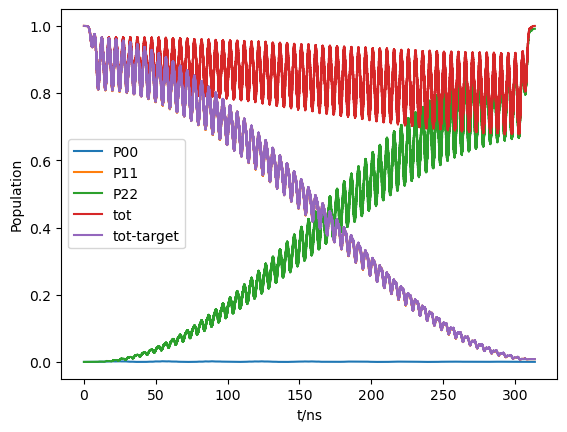

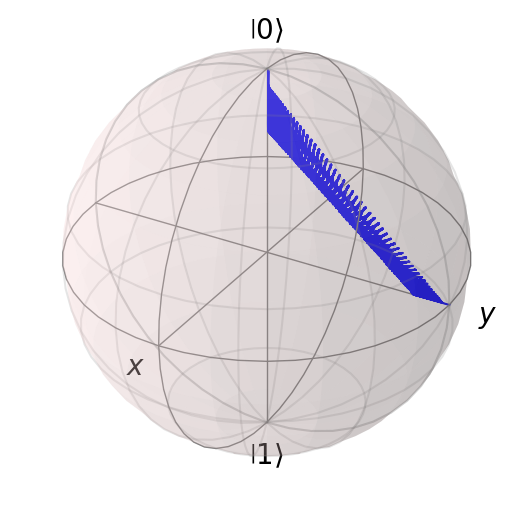

run end
27,run start


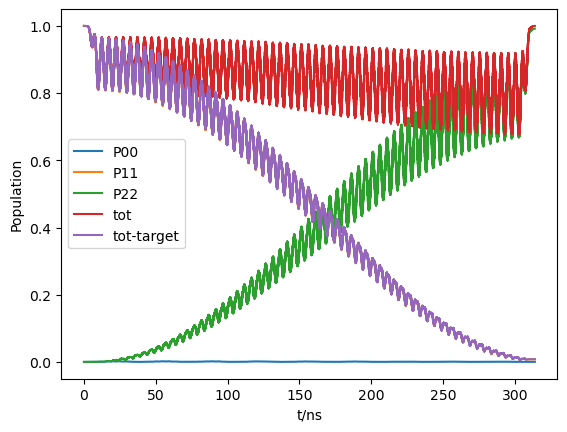

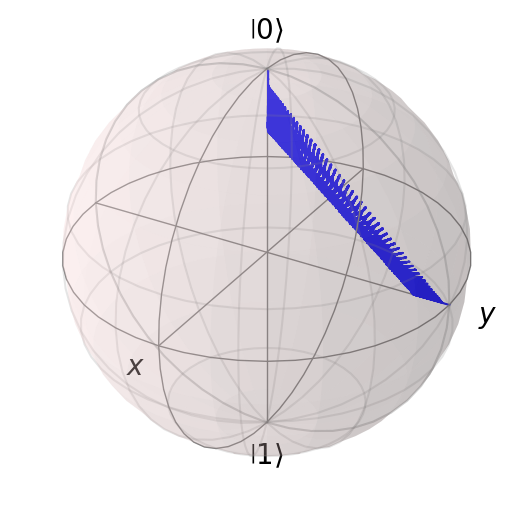

run end
28,run start


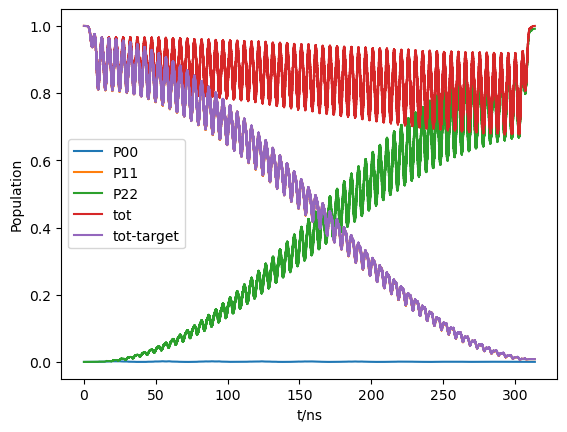

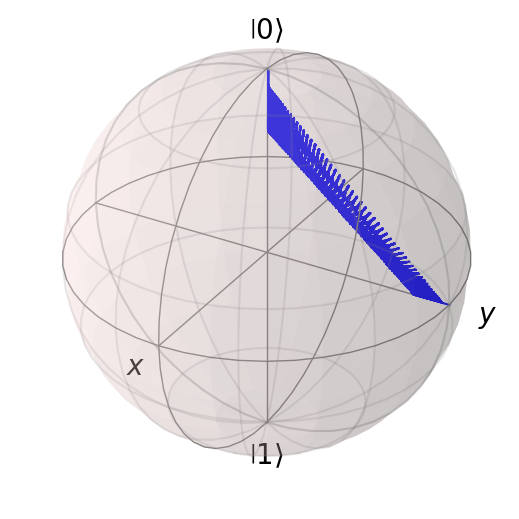

run end
29,run start


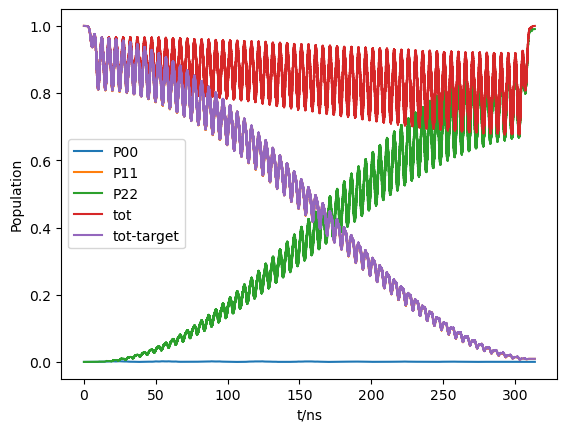

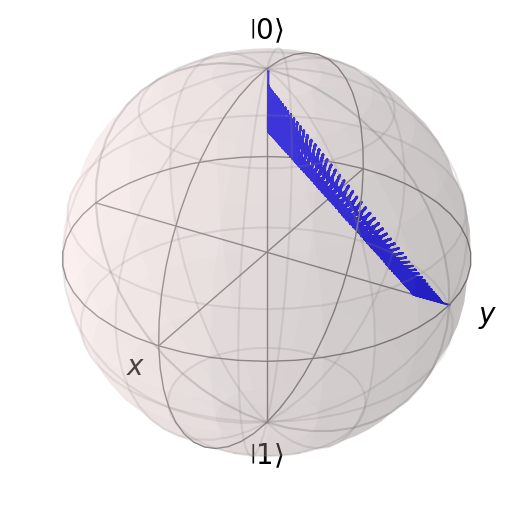

run end


[5.738864629361385, 0.9918866927636474]


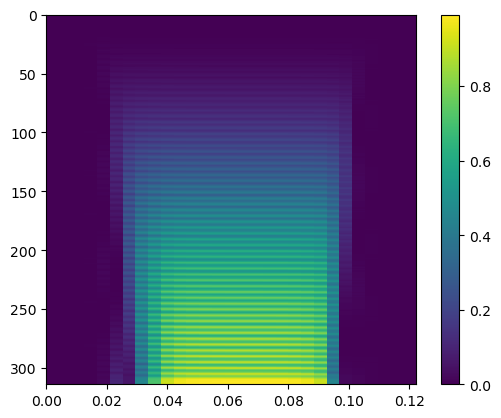

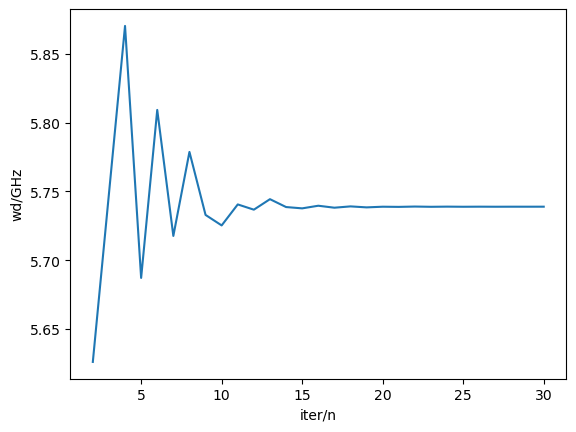

dpi=6.806547924499174e-06,w_match=5.738864629361385 
 auto_scan_scope end


[5.738864629361385,
 [array([[-3.63664993e-19, -3.63664993e-19, -3.63664993e-19, ...,
          -3.63664993e-19, -3.63664993e-19, -3.63664993e-19],
         [-4.80423191e-19, -3.17233691e-19, -7.05105298e-19, ...,
          -6.36995246e-19, -2.24208959e-19, -3.19364508e-19],
         [-5.74592741e-20, -4.55528363e-19, -5.17262507e-19, ...,
          -3.62248860e-19, -4.02916368e-19, -3.36255536e-19],
         ...,
         [ 6.50110933e-04,  3.01728378e-05,  5.47050925e-04, ...,
           5.27485514e-05,  1.30061439e-04, -1.11940260e-05],
         [ 6.50112086e-04,  3.01728720e-05,  5.47050866e-04, ...,
           5.27485058e-05,  1.30061491e-04, -1.11940258e-05],
         [ 6.50112076e-04,  3.01728771e-05,  5.47050866e-04, ...,
           5.27485094e-05,  1.30061487e-04, -1.11940258e-05]]),
  5.687078003408605,
  5.809230620686225,
  100]]

In [ ]:
# wd=[5.944786800528401 ,5.752985543492477 ]#single wave
# wd=[5.9526748296470355,5.748154312047415]#mix wave,[1,1]
wd=[5.940313438079269 ,5.738864629361385 ]#mix wave,single swap 11-22,sp=[1,1]，T~~140ns
a=sideband(level=4, t_edge=10,  w=[7,5],        yita=[0.3,0.3],  g=[0.15],
           L=200,   wd=wd,      phid=[0,0],     amp=0.3,         sp_direct=[1,0.46617831709480284],
           rho0=1,  rho_tar=2,  pre_scan=True)
a.auto_scan_scope(sp=1,runplot=True)
# a.run(True)
# a.d_eff_g
# a.s_g
# a.amp